*Projet de Machine learning*
- MEZUI ROTIMI Prince
- FEUDJIO Valdes

# BIBLIOTHEQUES


In [114]:
# Manipulate dataset
import pandas as pd
import numpy as np

# Preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import time
import warnings

# Dataviz
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import plot_tree
import graphviz

# Scikit-learn
## Evaluation
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, roc_auc_score, ConfusionMatrixDisplay, roc_curve, auc
from sklearn.model_selection import GridSearchCV

## Regression
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor

## Classification
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier, RandomForestClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier


# Désactiver les avertissements
warnings.filterwarnings("ignore")

# Graine aléatoire
rs = 241

# Fonction R2 ajusté
def R2_ajuste(y_true, y_pred, X):
    R2 = r2_score(y_true, y_pred)
    R2_ajuste = 1 - (1 - R2) * (len(y_true) - 1) / (len(y_true) - X.shape[1] - 1)
    return R2_ajuste

# JEU DE DONNEES

## Importation du jeu de données

**Descriptif du jeu de données :**

Ce jeu de données contient des informations sur les logements à Ames, une ville située dans l'État de l'Iowa, aux États-Unis, incluant des caractéristiques relatives aux propriétés résidentielles comme la superficie, le type de construction, et les finitions intérieures. 

> Nombre de variables : 80 caractéristiques + 1 cible

> Taille : 2 930 observations  

> Objectif pour la régression : Prédire le prix de vente des maisons (SalePrice). 
 
> Objectif pour la classification binaire : Prédire si le prix de vente dépasse un certain seuil défini.  

In [ ]:
# Loading dataset
data = pd.read_csv('AmesHousing.csv')
# print(data.info())

# Affichage de quelques lignes
data.head()

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,...,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,1,526301100,20,RL,141.0,31770,Pave,NaN,IR1,Lvl,...,0,NaN,NaN,NaN,0,5,2010,WD,Normal,215000
1,2,526350040,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,...,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal,105000
2,3,526351010,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,...,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal,172000
3,4,526353030,20,RL,93.0,11160,Pave,NaN,Reg,Lvl,...,0,NaN,NaN,NaN,0,4,2010,WD,Normal,244000
4,5,527105010,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,...,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal,189900


**Descriptif des variables :**

Le dataset AmesHousing contient 81 variables décrivant différentes caractéristiques des maisons, leurs environnements, et leurs prix de vente.
Voici les principales catégories de variables : 

> Cible  
- SalePrice : Prix de vente de la maison (en dollars).

> Informations générales  
- MSSubClass : Type de logement (identifiant numérique).  
- MSZoning : Catégorie de zonage pour l'utilisation des propriétés (par ex. résidentielle, industrielle).  
- LotFrontage : Longueur de façade de la propriété (en pieds).  
- LotArea : Surface totale du terrain (en pieds carrés).  
- Street : Type de rue d'accès (pavée ou gravier).  
- Alley : Type d'allée d'accès (si disponible).  
- LotShape : Forme générale de la propriété (par ex. régulière ou irrégulière).  
- LandContour : Niveau du terrain autour de la propriété.  
- Utilities : Services publics disponibles (par ex. électricité, gaz).  
- LotConfig : Configuration de la propriété (par ex. coin, intérieure).  
- LandSlope : Pente du terrain.  

> Informations sur les bâtiments  
- YearBuilt : Année de construction du logement.  
- YearRemodAdd : Année de la dernière rénovation ou amélioration.  
- OverallQual : Qualité globale de la maison (évaluée de 1 à 10).  
- OverallCond : Condition globale de la maison (évaluée de 1 à 10).  
- RoofStyle : Type de toit (par ex. à deux versants, plat).  
- RoofMatl : Matériau de la toiture.  
- Exterior1st : Matériau de revêtement extérieur (principal).  
- Exterior2nd : Matériau de revêtement extérieur (secondaire).  
- ExterQual : Qualité du revêtement extérieur.  
- ExterCond : Condition du revêtement extérieur.  
- Foundation : Type de fondation (par ex. béton coulé, briques).  

> Caractéristiques internes  
- BsmtQual : Hauteur sous plafond du sous-sol.  
- BsmtCond : Condition générale du sous-sol.  
- BsmtExposure : Degré d'exposition du sous-sol (fenêtres, etc.).  
- BsmtFinType1 : Qualité d'aménagement de la première zone finie du sous-sol.  
- BsmtFinSF1 : Surface finie du sous-sol pour la première zone (en pieds carrés).  
- BsmtFinType2 : Qualité d'aménagement de la seconde zone finie du sous-sol.  
- BsmtFinSF2 : Surface finie du sous-sol pour la seconde zone (en pieds carrés).  
- BsmtUnfSF : Surface non aménagée du sous-sol (en pieds carrés).  
- TotalBsmtSF : Surface totale du sous-sol (en pieds carrés).  
- Heating : Type de chauffage.  
- HeatingQC : Qualité et condition du système de chauffage.  
- CentralAir : Système de climatisation central (oui/non).  
- Electrical : Type de système électrique.  
- 1stFlrSF : Surface habitable du premier étage (en pieds carrés).  
- 2ndFlrSF : Surface habitable du deuxième étage (en pieds carrés).  
- LowQualFinSF : Surface aménagée de faible qualité (en pieds carrés).  
- GrLivArea : Surface habitable totale au-dessus du sol (en pieds carrés).  
- BsmtFullBath : Nombre de salles de bain complètes au sous-sol.  
- BsmtHalfBath : Nombre de demi-salles de bain au sous-sol.  
- FullBath : Nombre de salles de bain complètes au-dessus du sol.  
- HalfBath : Nombre de demi-salles de bain au-dessus du sol.  
- BedroomAbvGr : Nombre de chambres au-dessus du sol.  
- KitchenAbvGr : Nombre de cuisines au-dessus du sol.  
- KitchenQual : Qualité de la cuisine.  
- TotRmsAbvGrd : Nombre total de pièces au-dessus du sol (hors salles de bain).  
- Functional : État fonctionnel de la maison.  

> Caractéristiques extérieures  
- Fireplaces : Nombre de cheminées.  
- FireplaceQu : Qualité des cheminées.  
- GarageType : Type de garage.  
- GarageYrBlt : Année de construction du garage.  
- GarageFinish : Type d'aménagement intérieur du garage.  
- GarageCars : Capacité du garage en nombre de voitures.  
- GarageArea : Surface du garage (en pieds carrés).  
- GarageQual : Qualité du garage.  
- GarageCond : Condition générale du garage.  
- PavedDrive : Type d'allée pavée.  

> Autres informations  
- WoodDeckSF : Surface de la terrasse en bois (en pieds carrés).  
- OpenPorchSF : Surface du porche ouvert (en pieds carrés).  
- EnclosedPorch : Surface du porche fermé (en pieds carrés).  
- 3SsnPorch : Surface du porche trois saisons (en pieds carrés).  
- ScreenPorch : Surface du porche grillagé (en pieds carrés).  
- PoolArea : Surface de la piscine (en pieds carrés).  
- PoolQC : Qualité de la piscine.  
- Fence : Qualité de la clôture.  
- MiscFeature : Caractéristiques supplémentaires (par ex. cabane de jardin).  
- MiscVal : Valeur des caractéristiques supplémentaires (en dollars). 

## Preprocessing

### Gestion des valeurs manquantes

In [116]:
# suppression des colonnes avec trop de valeurs manquantes
nb_missing_values = data.isnull().sum()

# print(nb_missing_values[nb_missing_values > data.shape[0] * 0.1])

columns_to_delete = list(nb_missing_values[nb_missing_values > data.shape[0] * 0.1].index)
data = data.drop(columns_to_delete, axis=1)

In [117]:
# on supprime les lignes avec les valeurs manquantes restantes
data = data.dropna(subset=data.columns)
print(data.shape)

(2678, 75)


On se retrouve avec un jeu de données de 2678 observations et 75 variables dont la cible.

### Gestion des types des variables

In [118]:
# Gestion des colonnes non numériques -> One Hot Encoding
columns_str = data.select_dtypes(exclude=[np.number]).columns
data = pd.concat([
    data.drop(columns=columns_str, axis=1),
    pd.get_dummies(data[columns_str], drop_first=True)
], axis=1)


### Données d'entrainement et de test

> 80% des données attribués à l'entrainement des modèles - 16512 observations

> 20% des données attribués à l'évaluation des modèles - 4128 observations

In [119]:
X = data.drop('SalePrice', axis=1)
y = data['SalePrice']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=rs
)

### Cibles de Regression et de Classification

In [120]:
# Régression
y_train_reg = y_train
y_test_reg = y_test

print(y_train_reg.describe().round(2))

count      2142.00
mean     186953.09
std       79944.34
min       35000.00
25%      134600.00
50%      167570.00
75%      220000.00
max      755000.00
Name: SalePrice, dtype: float64


On définira 2 classes de classification :

> classe 1 : y=0 (logements dont le prix de vente est inférieure au seuil)

> classe 2 : y=1 (logements dont le prix de vente est supérieure au seuil)

In [121]:
# Classification binaire 
med = y.median()  # Seuil médian | en fonction de l'ecart type grand
y_train_class = (y_train > med).astype(int)
y_test_class = (y_test > med).astype(int)

print(f"Seuil = Prix de vente médian : {med:.0f} dollars\n")
print(y_train_class.value_counts())

Seuil = Prix de vente médian : 166650 dollars

SalePrice
1    1082
0    1060
Name: count, dtype: int64


# REGRESSION

## Statistiques descriptives et exploratoires

Explorons notre jeu de données afin d'avoir des à priiori sur le dataset dans le cadre de notre régression.

In [122]:
data_train_reg = X_train.copy()
data_train_reg['SalePrice'] = y_train_reg.values

In [123]:
data_train_reg.describe().round(2)

,Order,PID,MS SubClass,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Mas Vnr Area,BsmtFin SF 1,...,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,SalePrice
count,2142.00,2.142000e+03,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,...,2142.00,2142.00,2142.00,2142.00,2142.00,2142.0,2142.00,2142.00,2142.00,2142.00
mean,1464.42,7.072847e+08,56.67,10253.96,6.21,5.60,1973.08,1985.28,107.44,467.86,...,97.59,48.08,22.39,2.38,16.96,2.5,50.63,6.21,2007.78,186953.09
std,837.10,1.884288e+08,41.73,7871.20,1.35,1.08,29.53,20.39,181.30,461.76,...,127.37,65.82,64.92,24.34,58.08,38.1,590.31,2.73,1.30,79944.34
min,1.00,5.263011e+08,20.00,1300.00,2.00,1.00,1879.00,1950.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.0,0.00,1.00,2006.00,35000.00
25%,738.25,5.284478e+08,20.00,7542.50,5.00,5.00,1955.25,1967.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.0,0.00,4.00,2007.00,134600.00
50%,1479.50,5.354021e+08,50.00,9571.00,6.00,5.00,1976.00,1994.00,0.00,403.00,...,0.00,28.50,0.00,0.00,0.00,0.0,0.00,6.00,2008.00,167570.00
75%,2168.75,9.071311e+08,70.00,11693.50,7.00,6.00,2001.00,2004.00,176.00,763.00,...,173.00,72.00,0.00,0.00,0.00,0.0,0.00,8.00,2009.00,220000.00
max,2930.00,1.007100e+09,190.00,215245.00,10.00,9.00,2010.00,2010.00,1600.00,5644.00,...,1424.00,570.00,1012.00,508.00,576.00,800.0,17000.00,12.00,2010.00,755000.00


Order vs SalePrice : -0.03


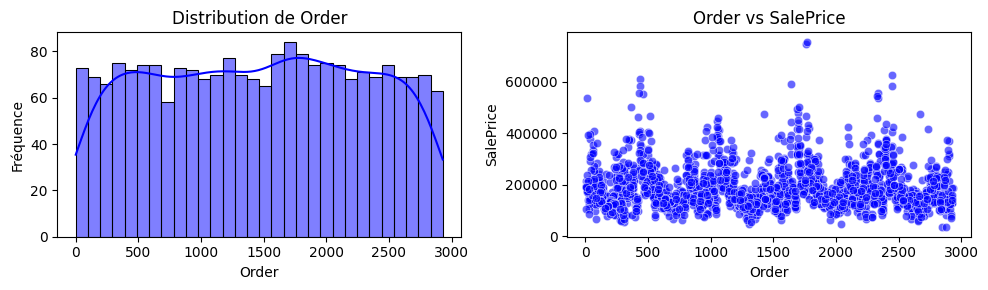

PID vs SalePrice : -0.21


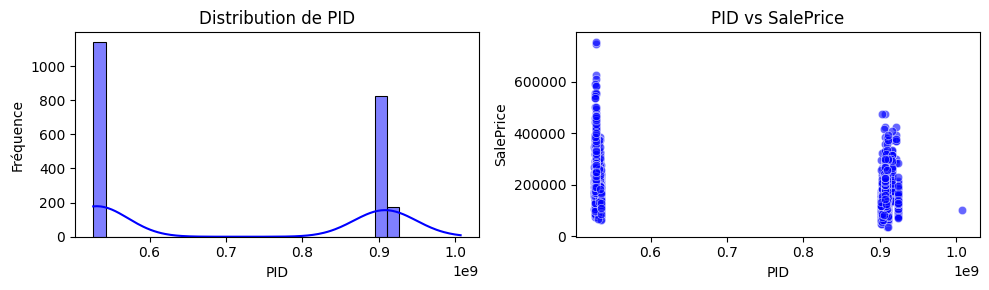

MS SubClass vs SalePrice : -0.06


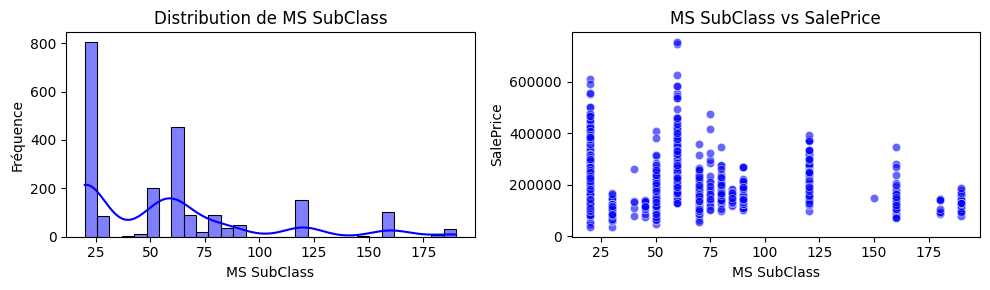

Lot Area vs SalePrice : 0.28


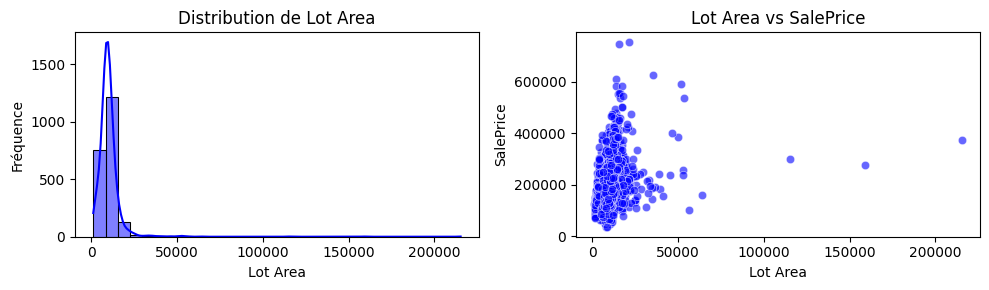

Overall Qual vs SalePrice : 0.80


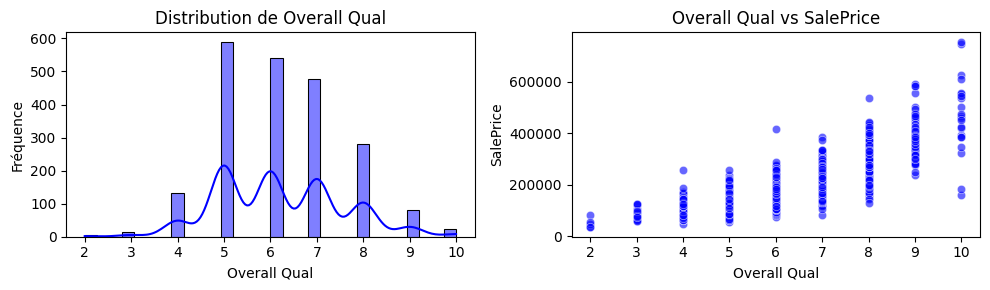

Overall Cond vs SalePrice : -0.14


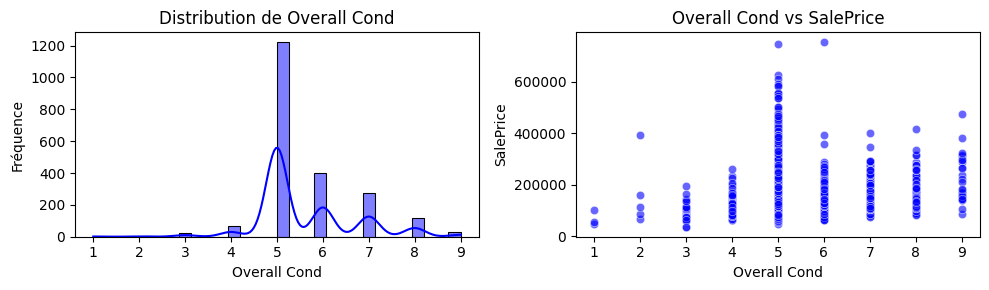

Year Built vs SalePrice : 0.54


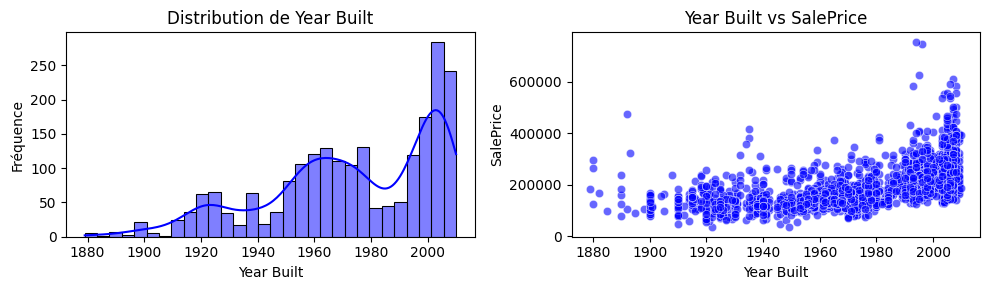

Year Remod/Add vs SalePrice : 0.53


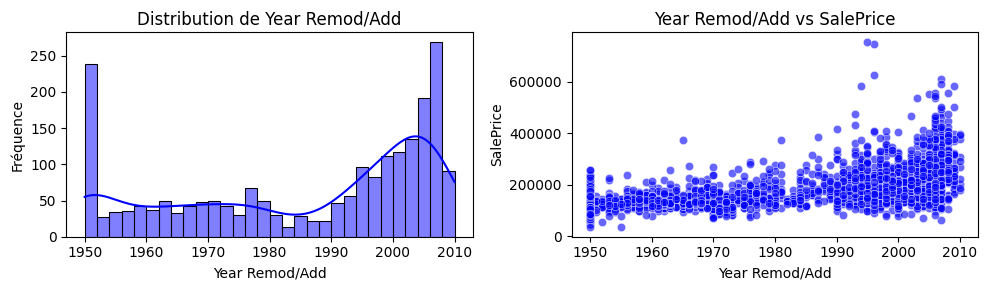

Mas Vnr Area vs SalePrice : 0.48


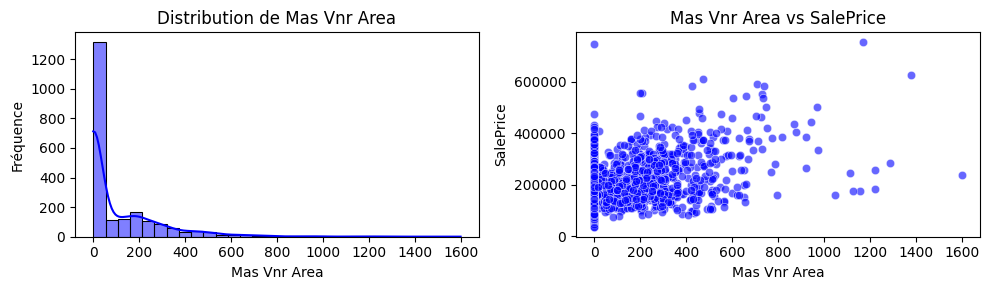

BsmtFin SF 1 vs SalePrice : 0.41


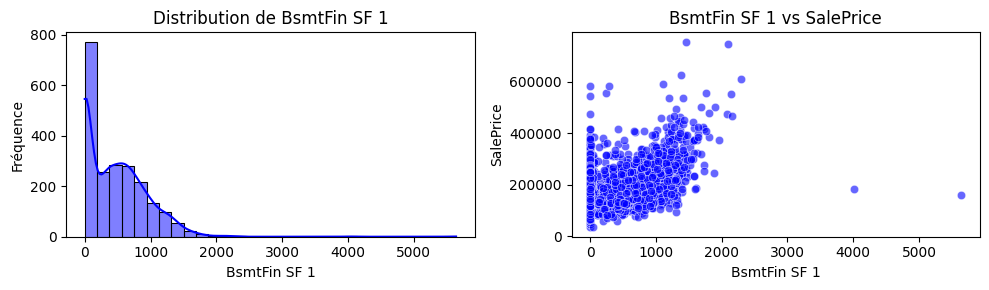

BsmtFin SF 2 vs SalePrice : 0.00


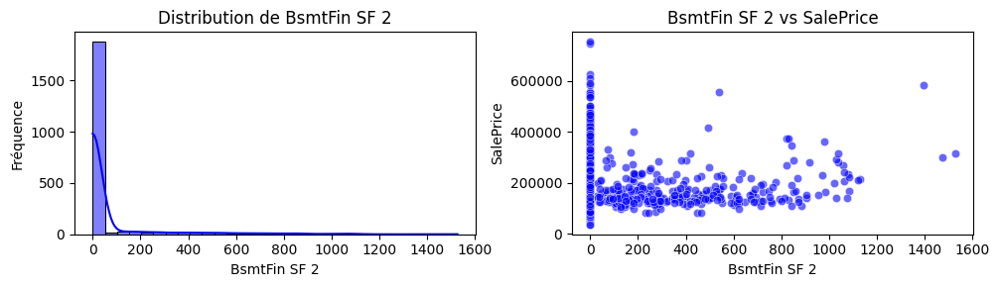

Bsmt Unf SF vs SalePrice : 0.16


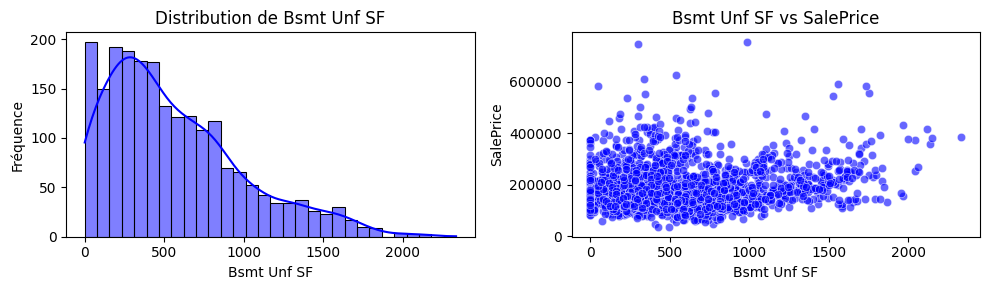

Total Bsmt SF vs SalePrice : 0.62


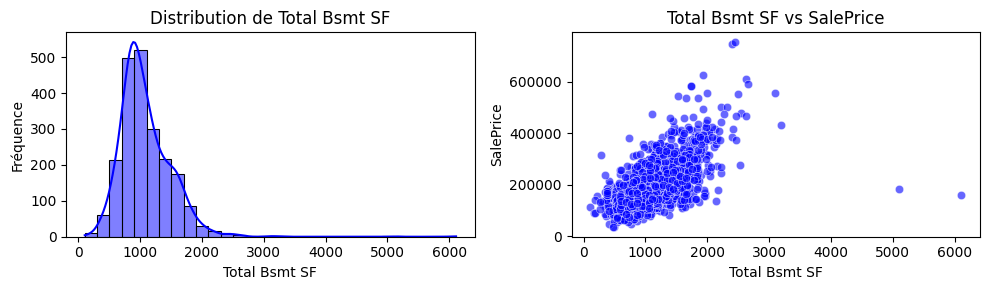

1st Flr SF vs SalePrice : 0.63


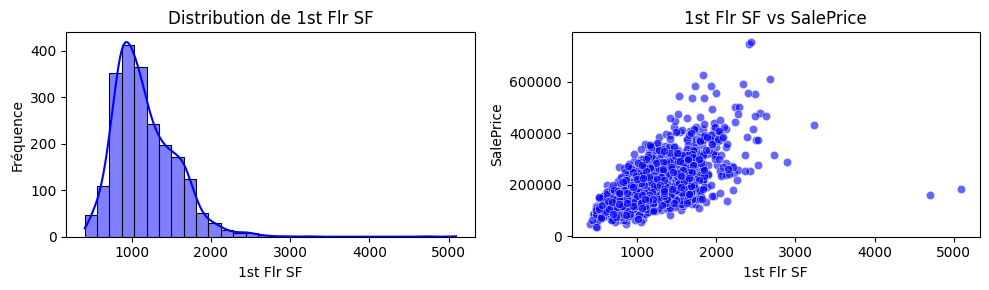

2nd Flr SF vs SalePrice : 0.29


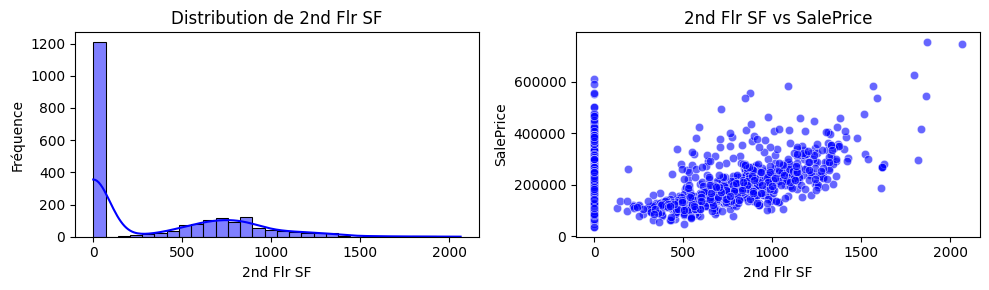

Low Qual Fin SF vs SalePrice : -0.02


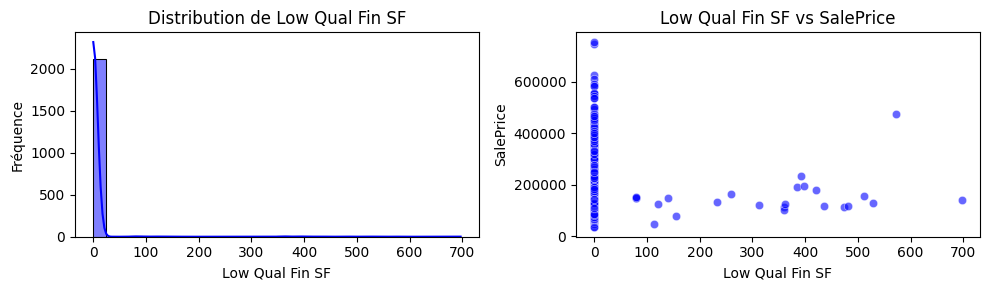

Gr Liv Area vs SalePrice : 0.73


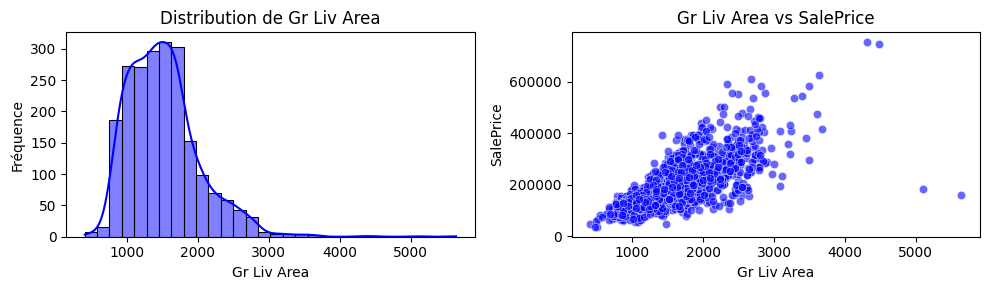

Bsmt Full Bath vs SalePrice : 0.26


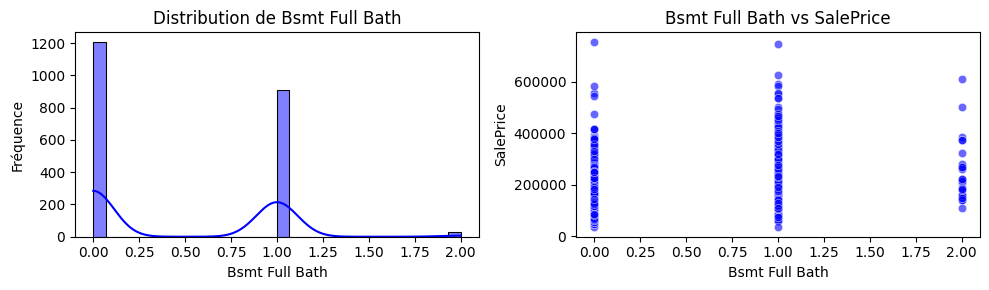

Bsmt Half Bath vs SalePrice : -0.03


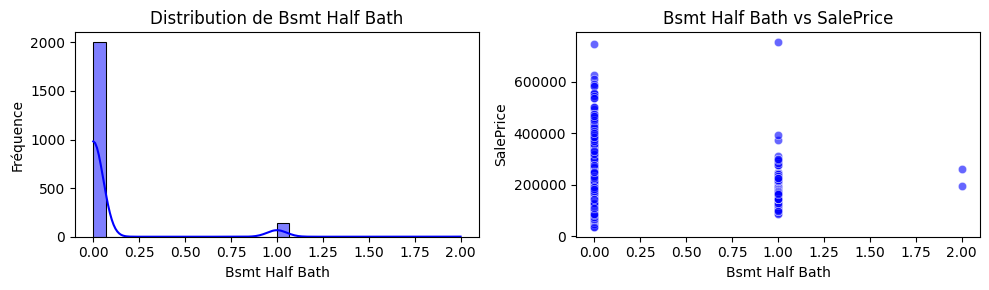

Full Bath vs SalePrice : 0.56


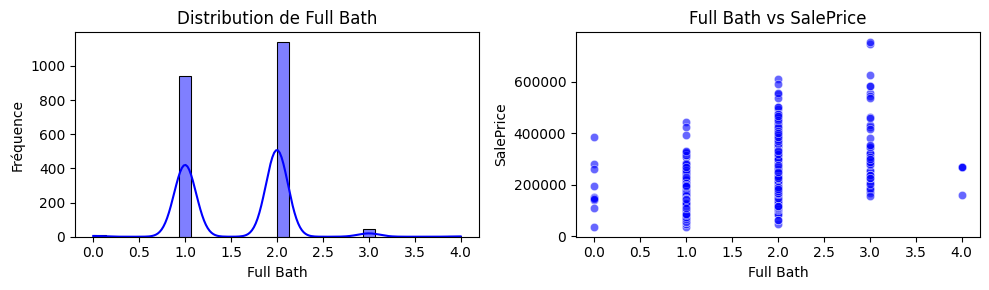

Half Bath vs SalePrice : 0.27


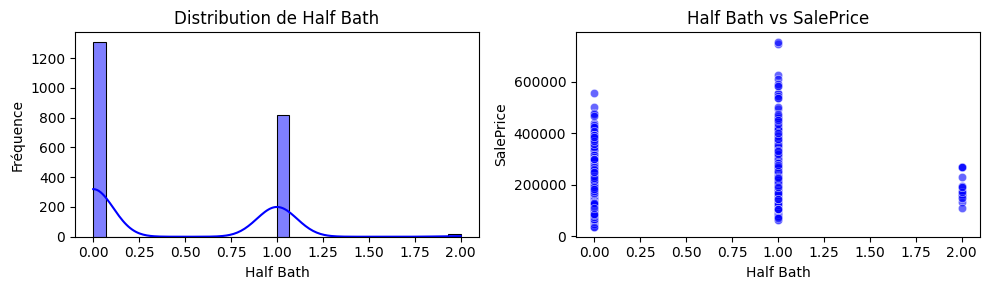

Bedroom AbvGr vs SalePrice : 0.16


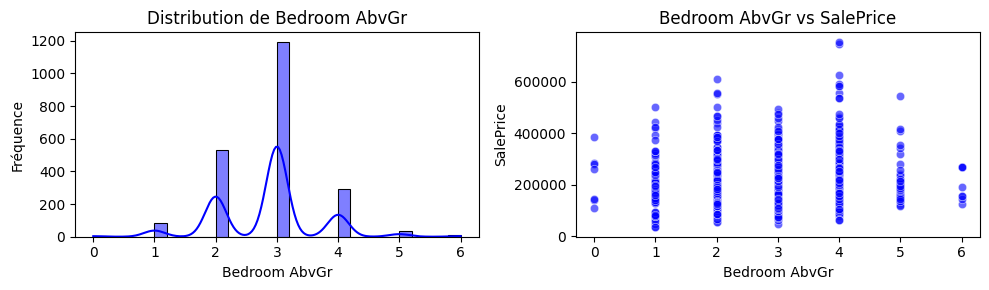

Kitchen AbvGr vs SalePrice : -0.07


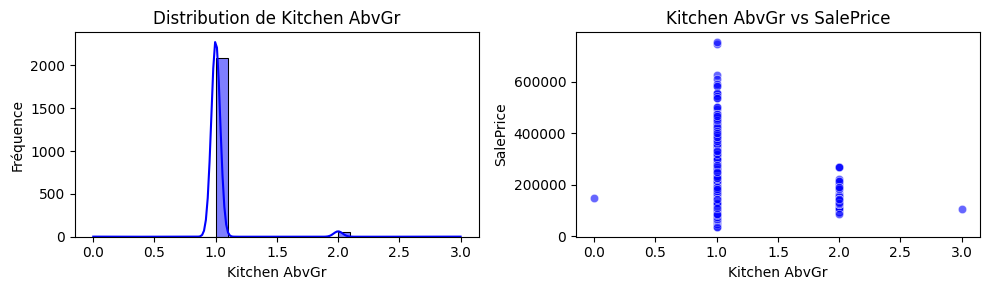

TotRms AbvGrd vs SalePrice : 0.52


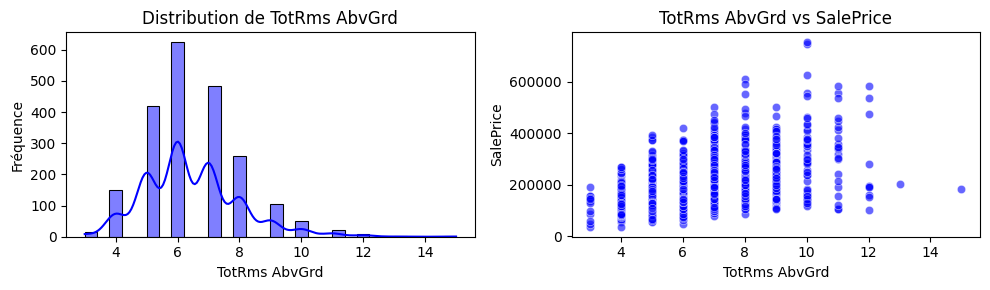

Fireplaces vs SalePrice : 0.46


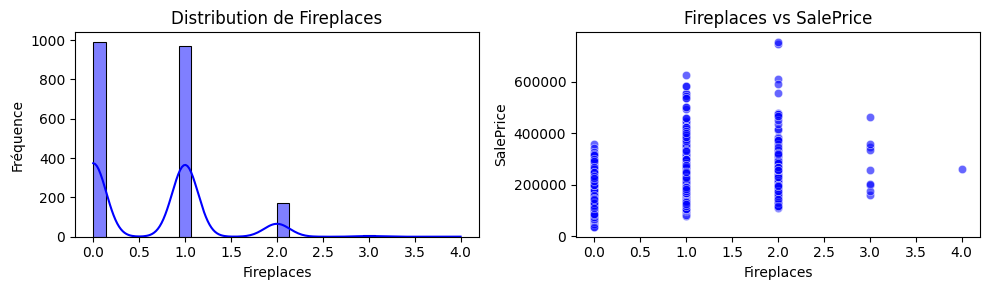

Garage Yr Blt vs SalePrice : 0.52


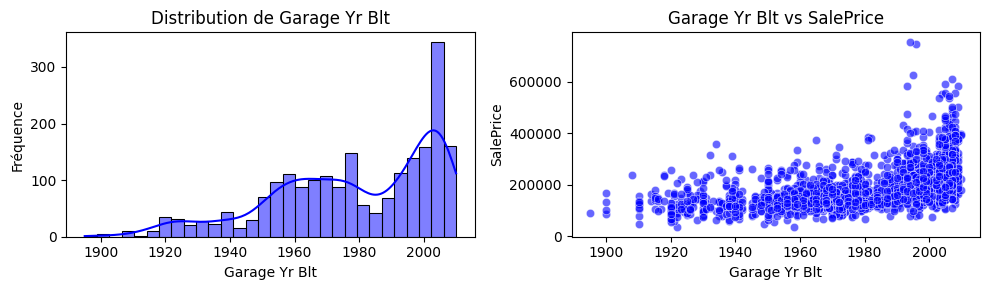

Garage Cars vs SalePrice : 0.65


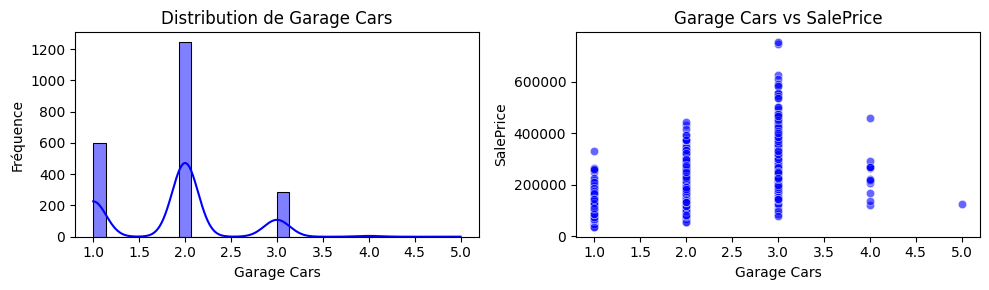

Garage Area vs SalePrice : 0.63


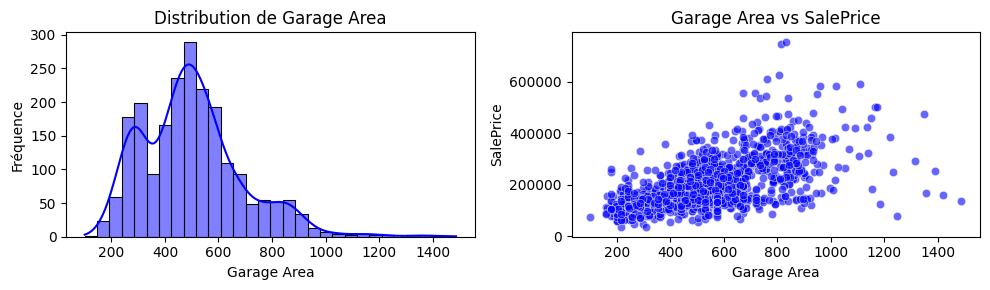

Wood Deck SF vs SalePrice : 0.33


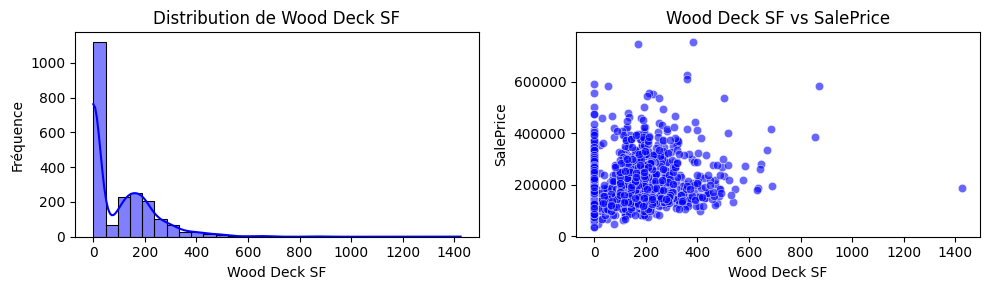

Open Porch SF vs SalePrice : 0.31


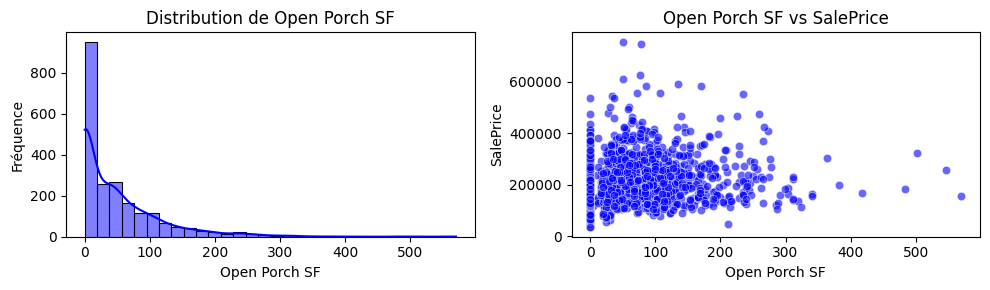

Enclosed Porch vs SalePrice : -0.13


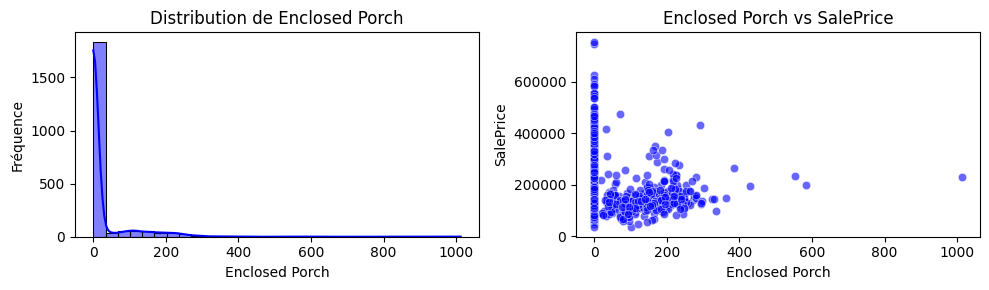

3Ssn Porch vs SalePrice : 0.03


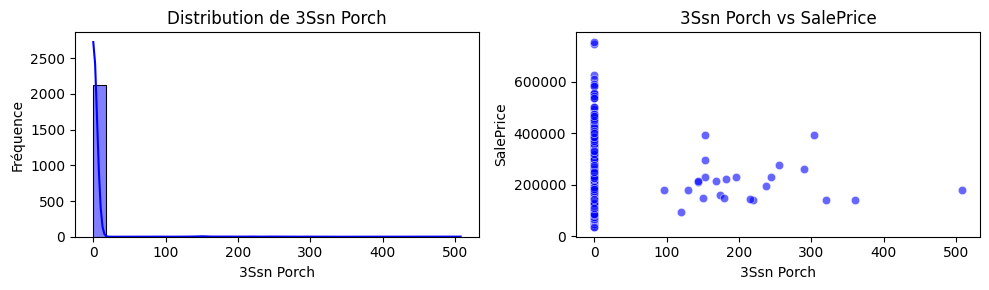

Screen Porch vs SalePrice : 0.10


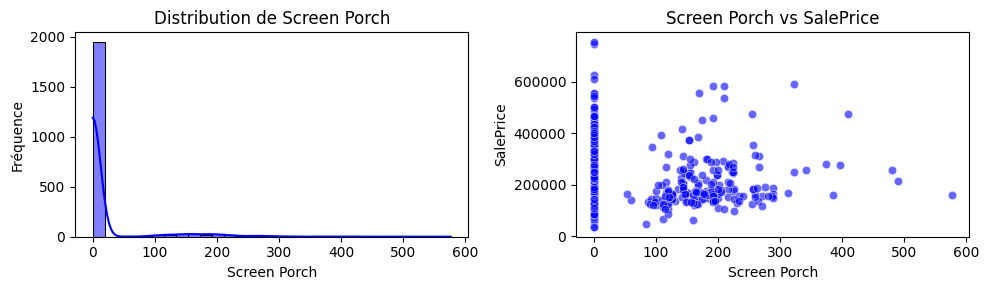

Pool Area vs SalePrice : 0.07


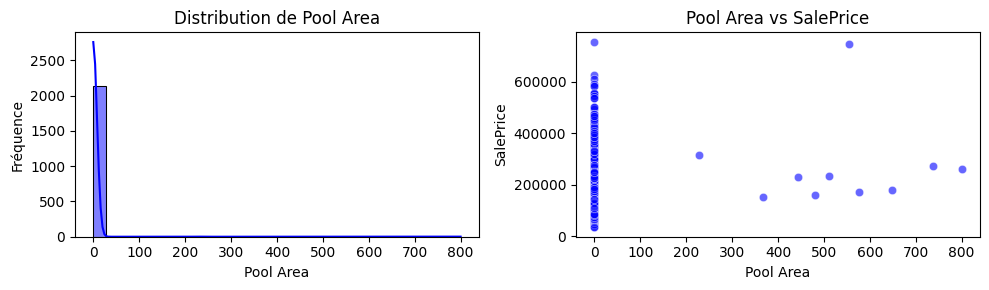

Misc Val vs SalePrice : -0.02


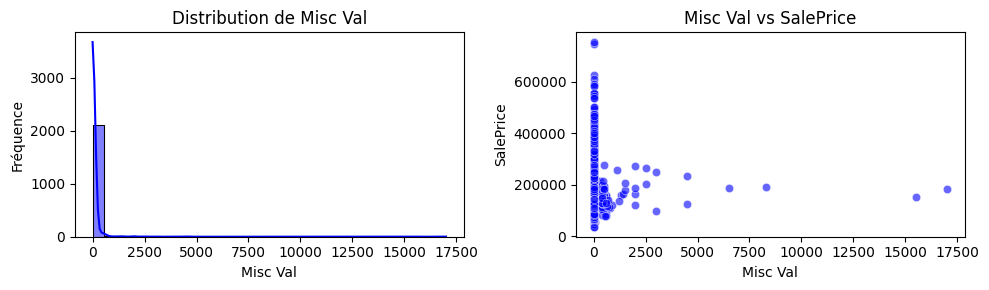

Mo Sold vs SalePrice : 0.03


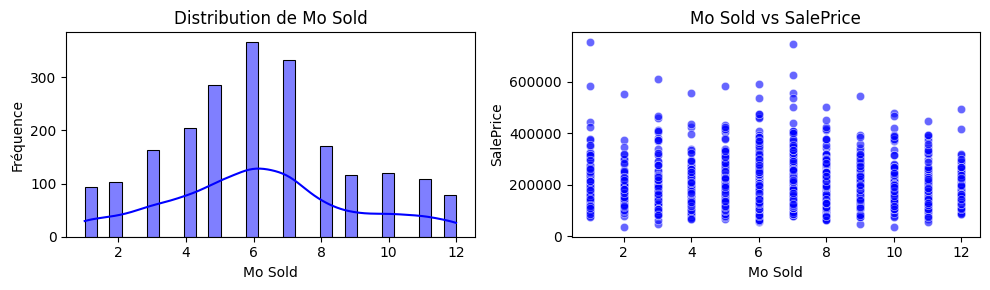

Yr Sold vs SalePrice : -0.03


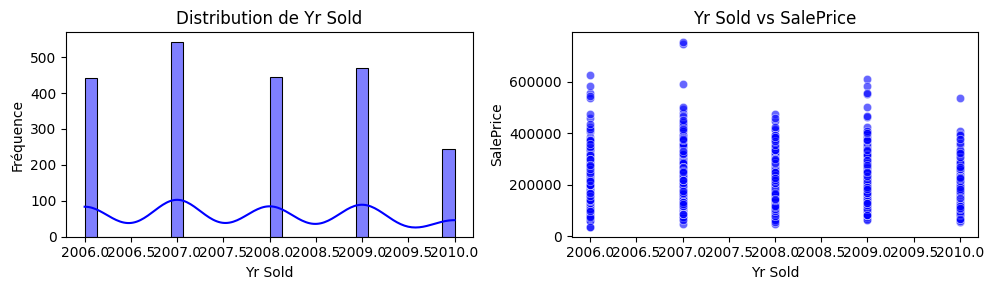

MS Zoning_FV vs SalePrice : 0.09


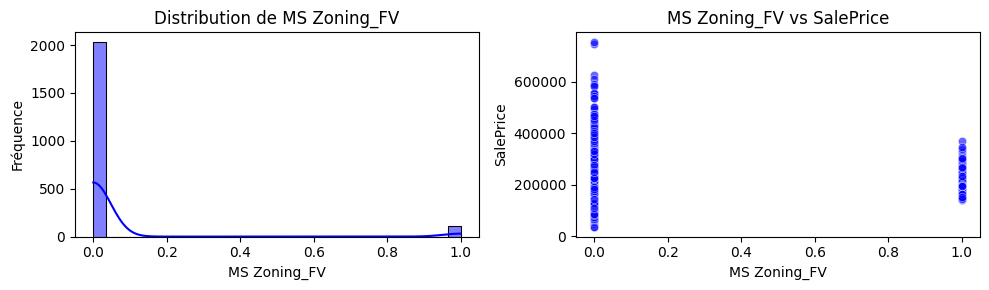

MS Zoning_I (all) vs SalePrice : -0.02


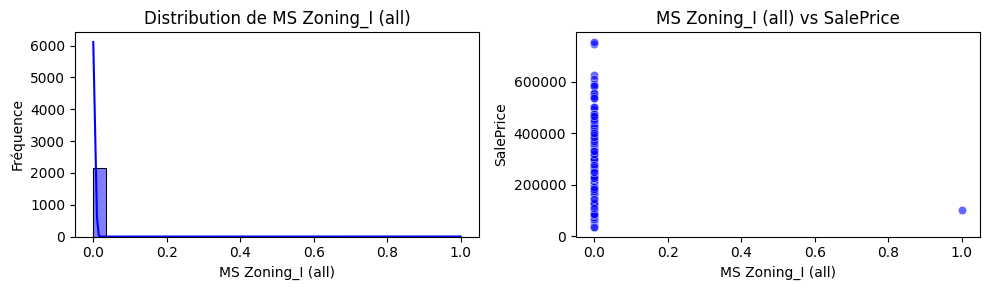

MS Zoning_RH vs SalePrice : -0.06


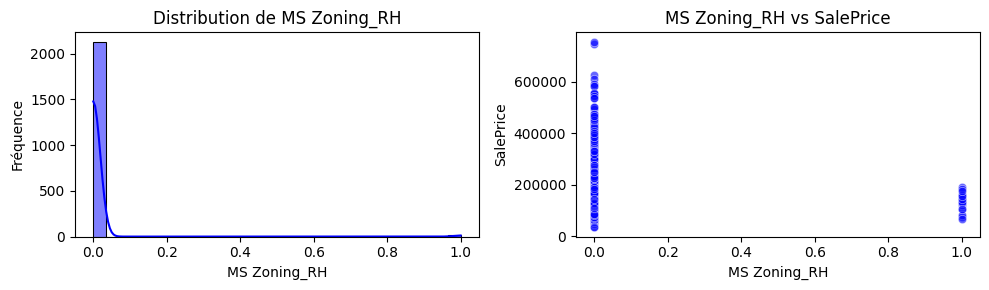

MS Zoning_RL vs SalePrice : 0.23


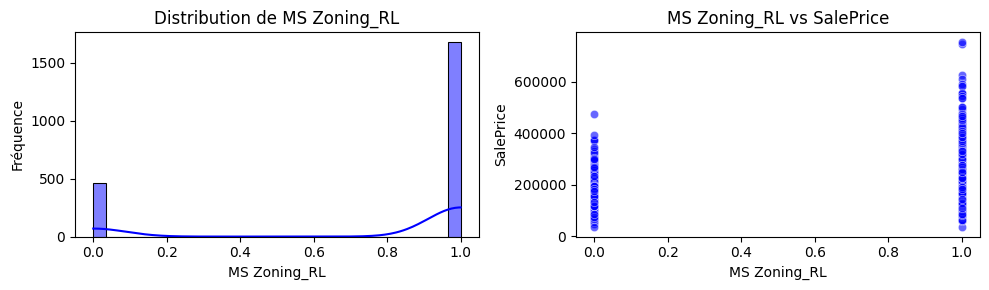

MS Zoning_RM vs SalePrice : -0.28


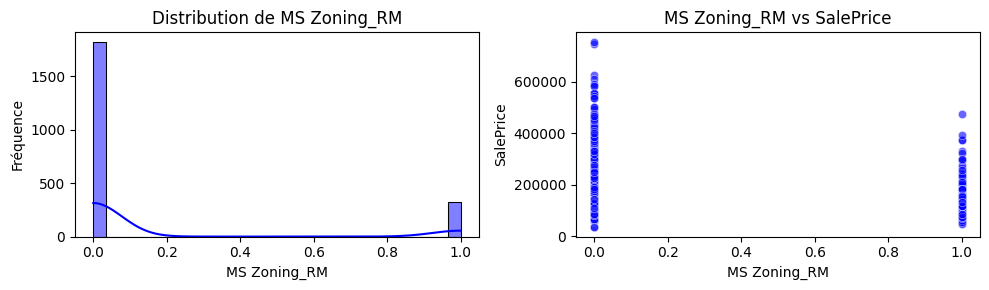

Street_Pave vs SalePrice : 0.06


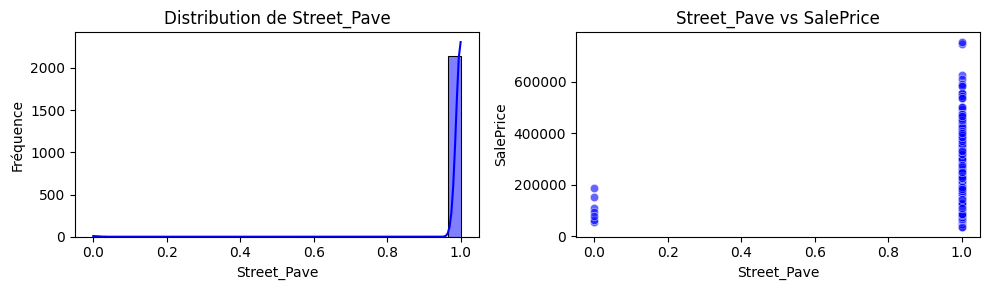

Lot Shape_IR2 vs SalePrice : 0.10


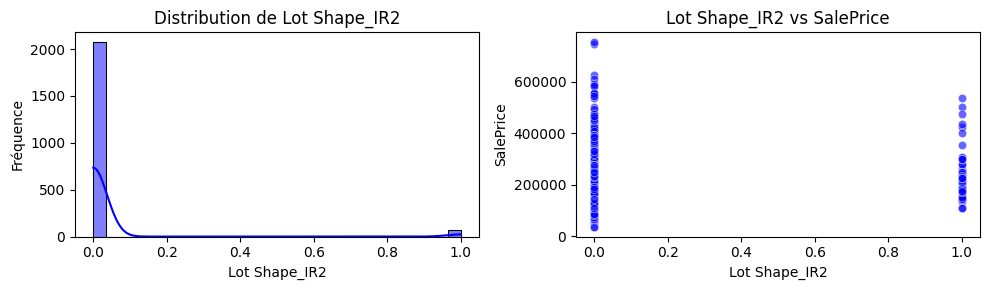

Lot Shape_IR3 vs SalePrice : 0.04


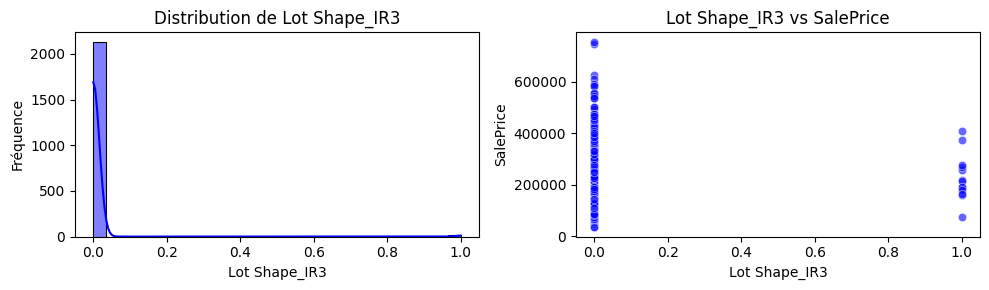

Lot Shape_Reg vs SalePrice : -0.29


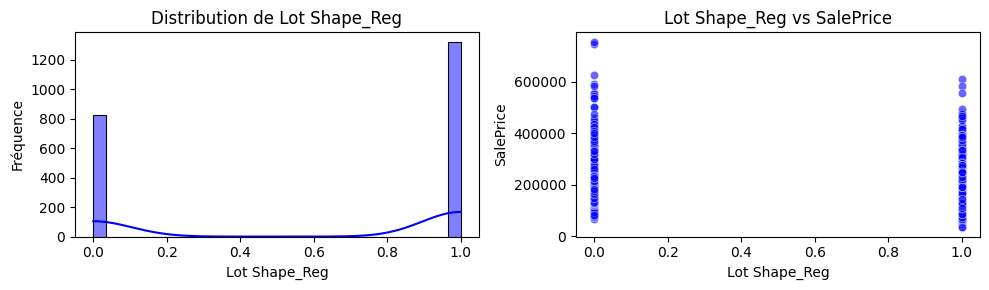

Land Contour_HLS vs SalePrice : 0.17


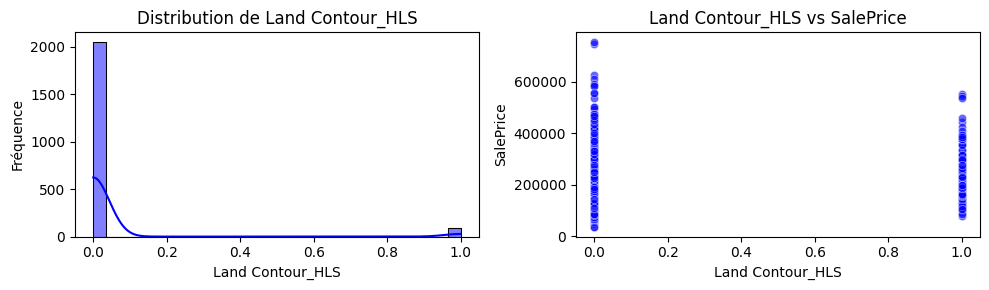

Land Contour_Low vs SalePrice : 0.04


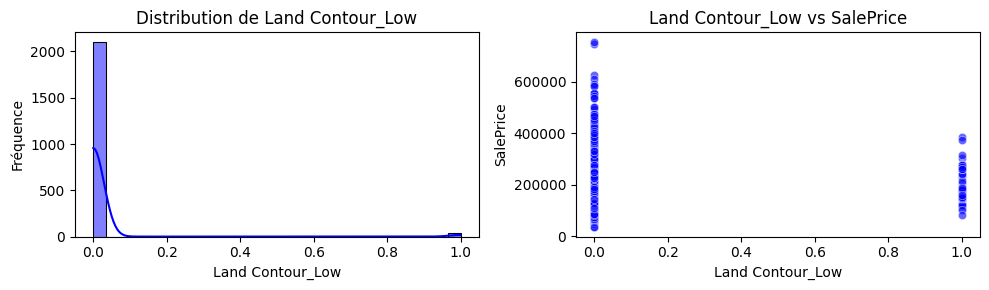

Land Contour_Lvl vs SalePrice : -0.08


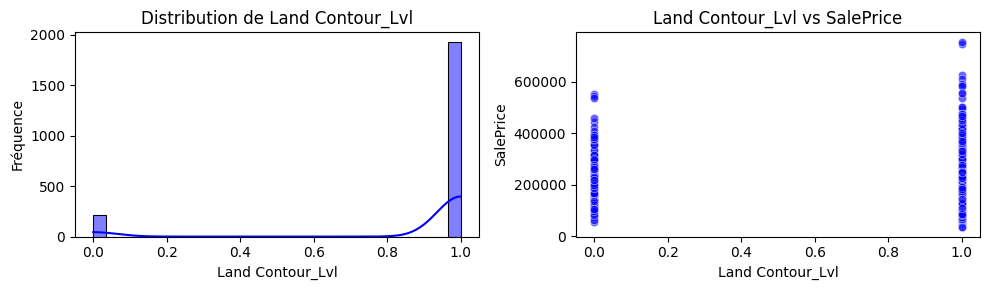

Utilities_NoSeWa vs SalePrice : -0.01


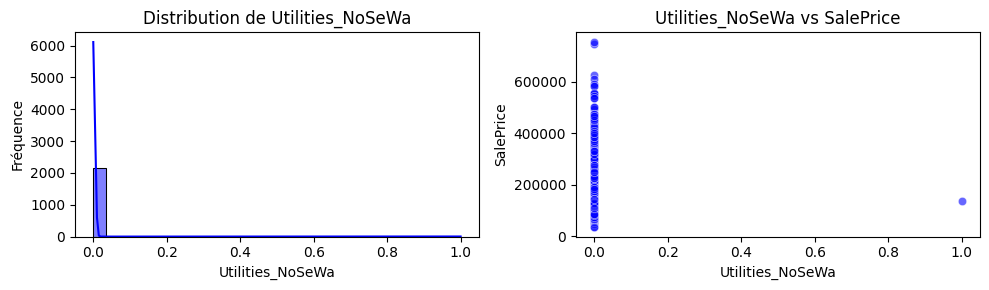

Utilities_NoSewr vs SalePrice : -0.02


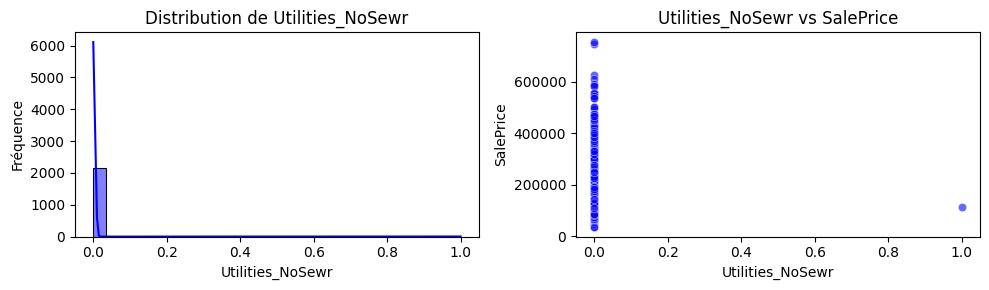

Lot Config_CulDSac vs SalePrice : 0.15


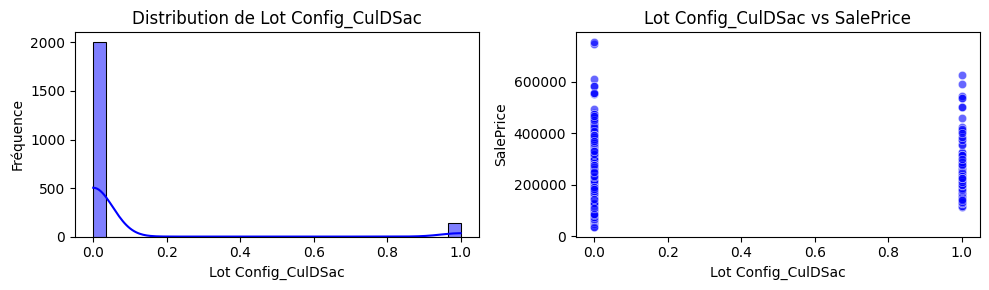

Lot Config_FR2 vs SalePrice : -0.02


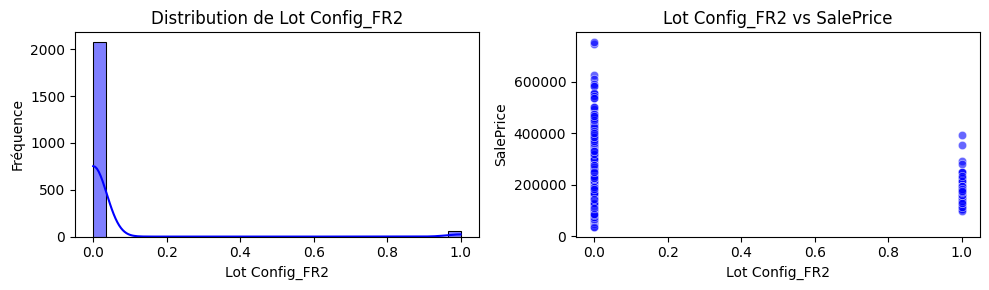

Lot Config_FR3 vs SalePrice : 0.01


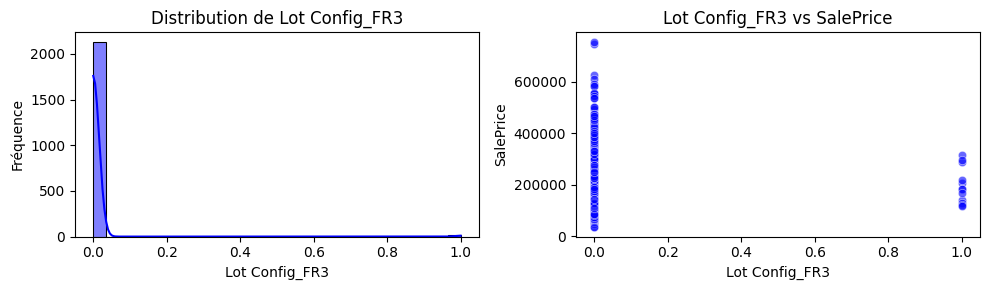

Lot Config_Inside vs SalePrice : -0.05


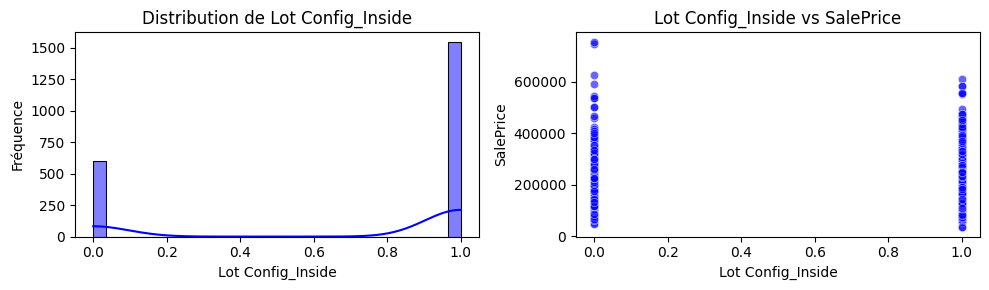

Land Slope_Mod vs SalePrice : 0.05


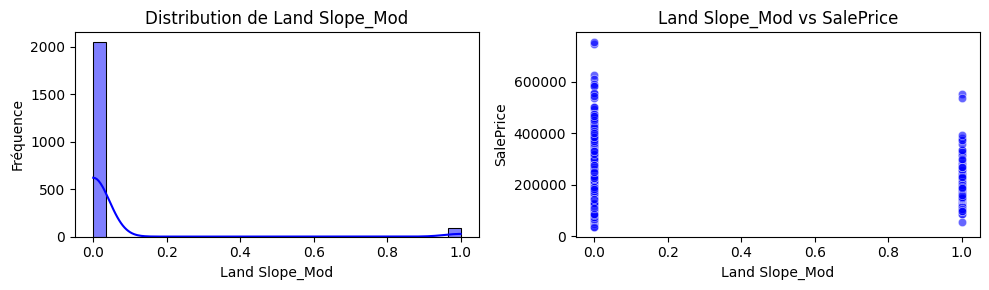

Land Slope_Sev vs SalePrice : 0.03


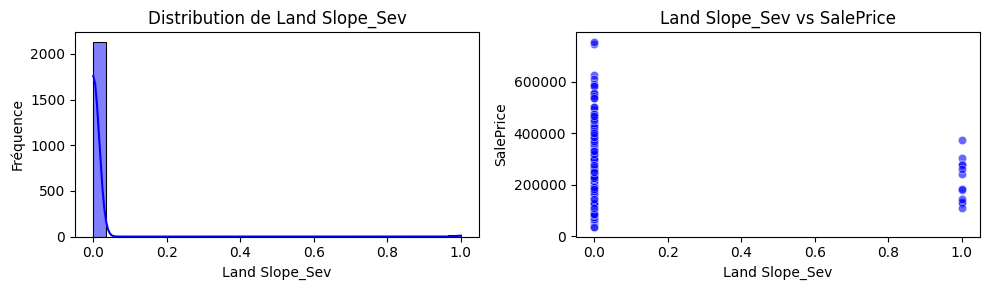

Neighborhood_Blueste vs SalePrice : -0.03


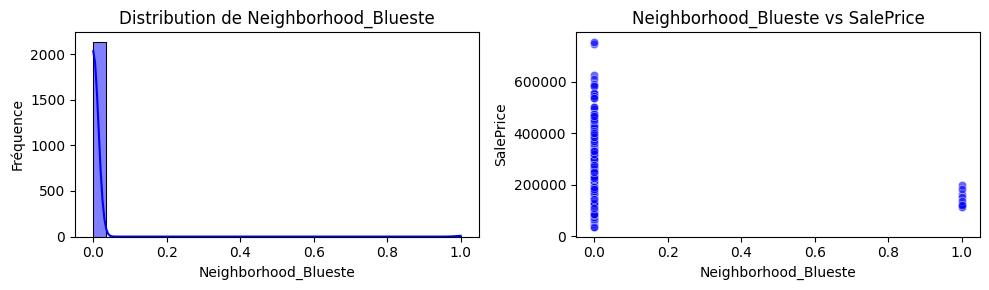

Neighborhood_BrDale vs SalePrice : -0.10


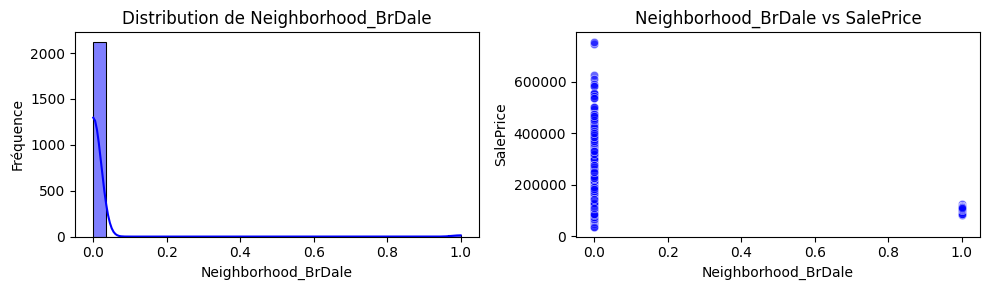

Neighborhood_BrkSide vs SalePrice : -0.13


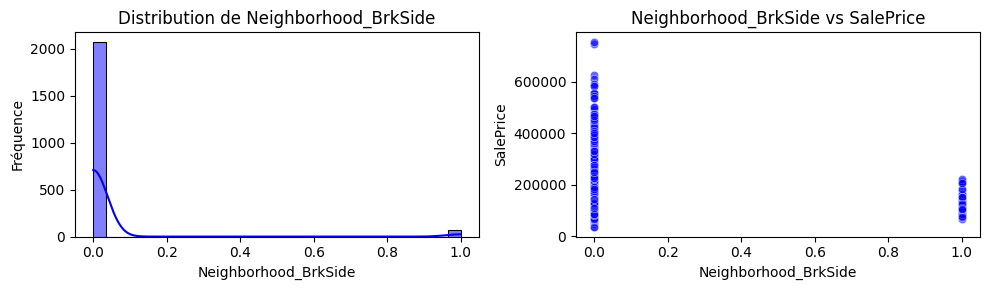

Neighborhood_ClearCr vs SalePrice : 0.04


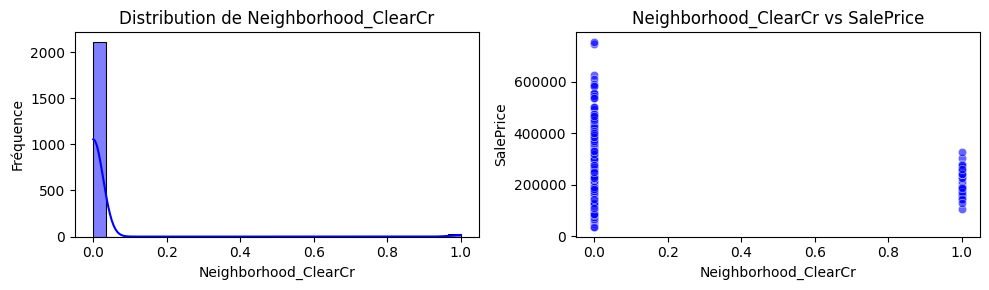

Neighborhood_CollgCr vs SalePrice : 0.07


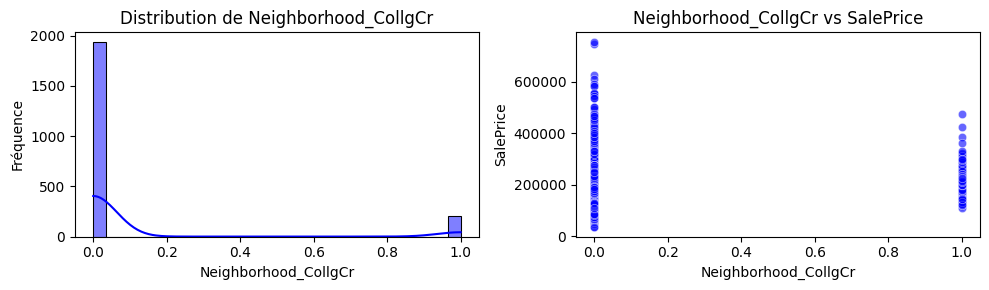

Neighborhood_Crawfor vs SalePrice : 0.08


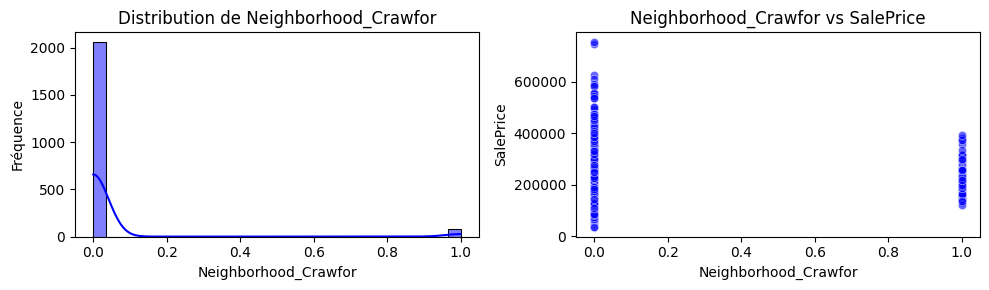

Neighborhood_Edwards vs SalePrice : -0.15


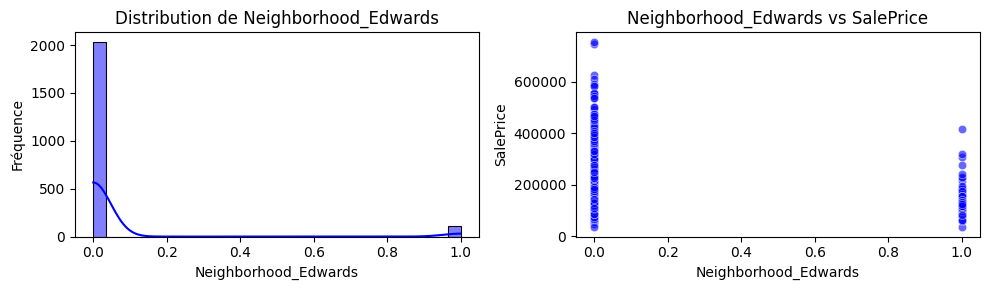

Neighborhood_Gilbert vs SalePrice : 0.01


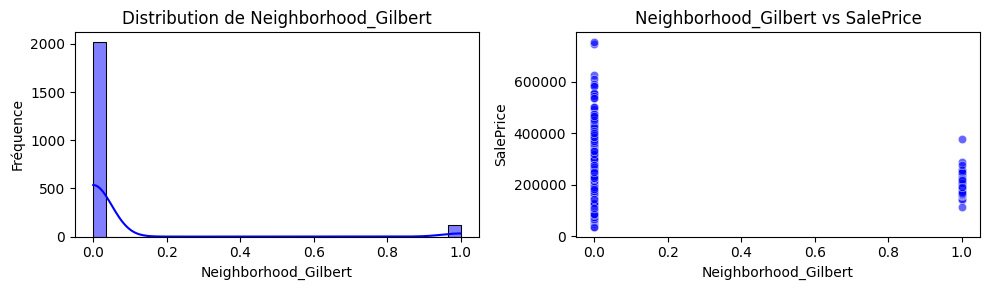

Neighborhood_Greens vs SalePrice : 0.00


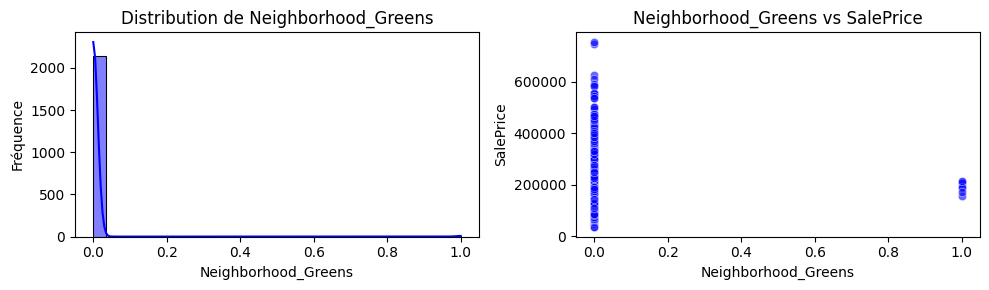

Neighborhood_GrnHill vs SalePrice : 0.04


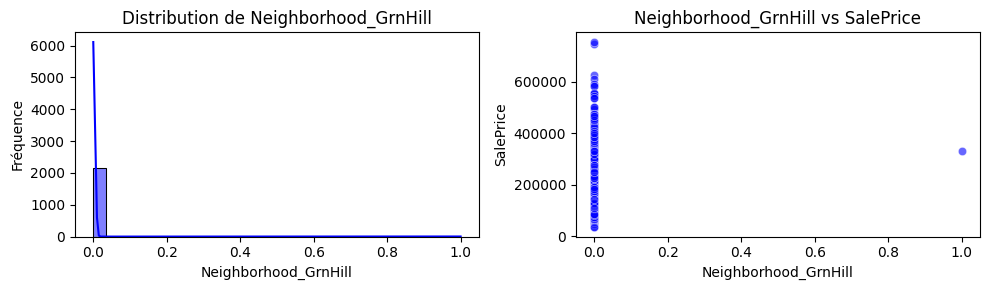

Neighborhood_IDOTRR vs SalePrice : -0.16


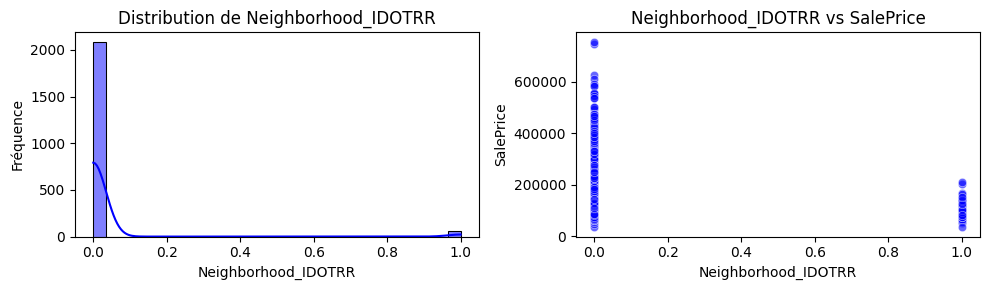

Neighborhood_Landmrk vs SalePrice : -0.01


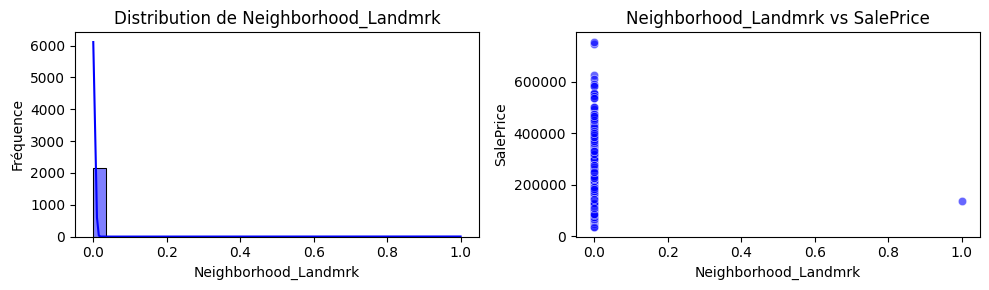

Neighborhood_MeadowV vs SalePrice : -0.11


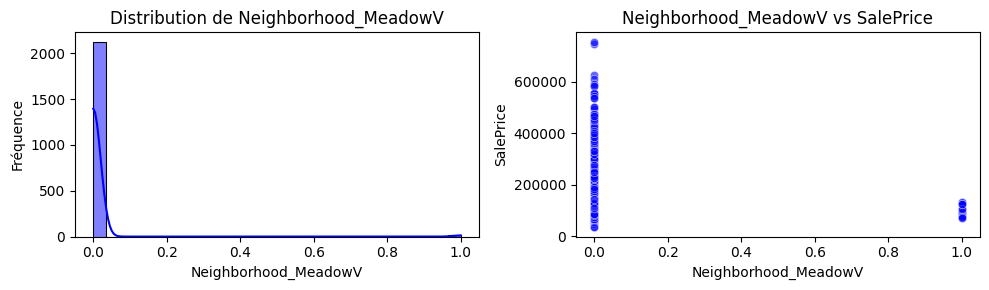

Neighborhood_Mitchel vs SalePrice : -0.05


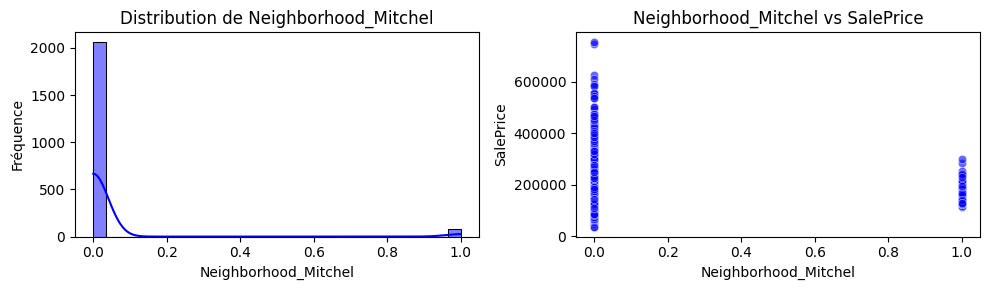

Neighborhood_NAmes vs SalePrice : -0.22


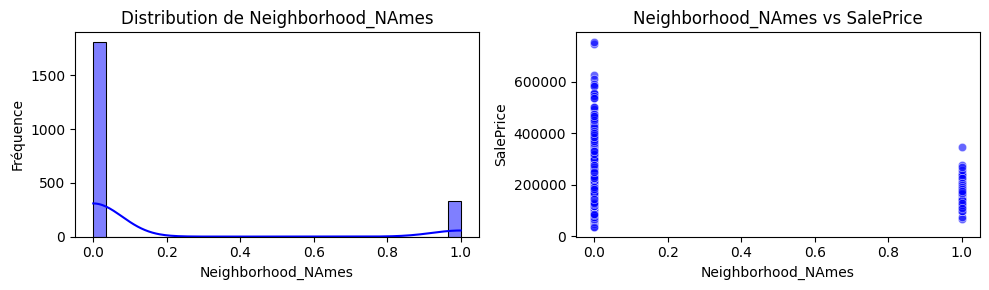

Neighborhood_NPkVill vs SalePrice : -0.05


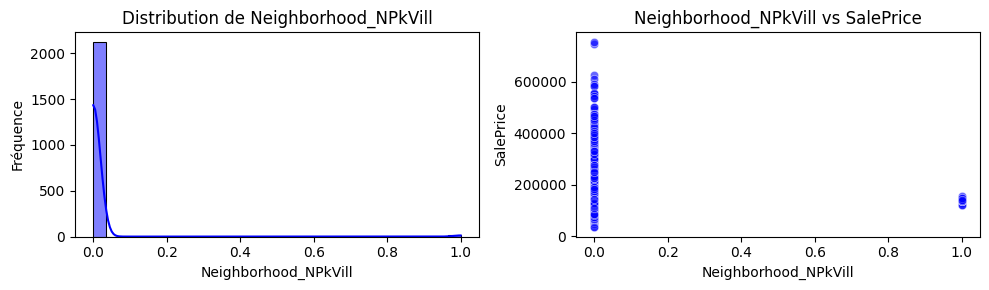

Neighborhood_NWAmes vs SalePrice : -0.00


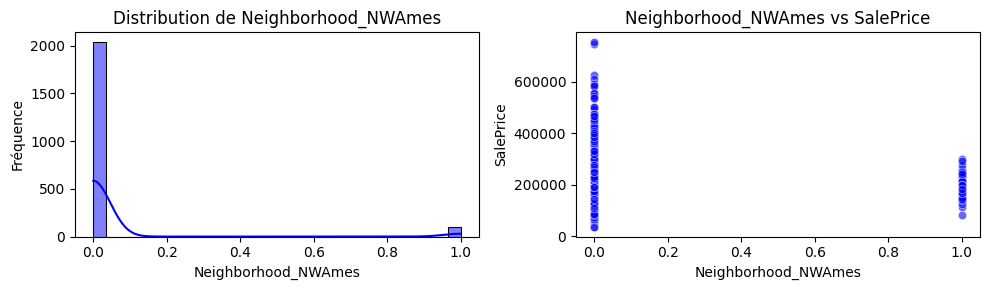

Neighborhood_NoRidge vs SalePrice : 0.31


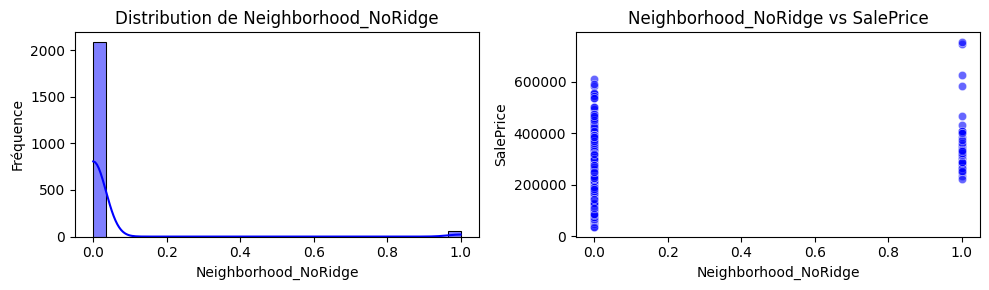

Neighborhood_NridgHt vs SalePrice : 0.42


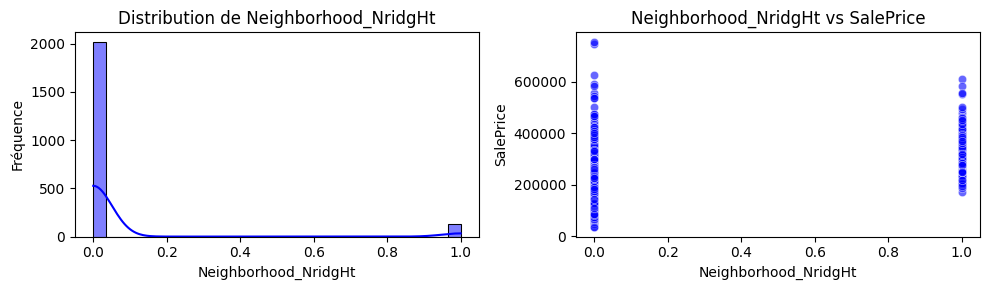

Neighborhood_OldTown vs SalePrice : -0.20


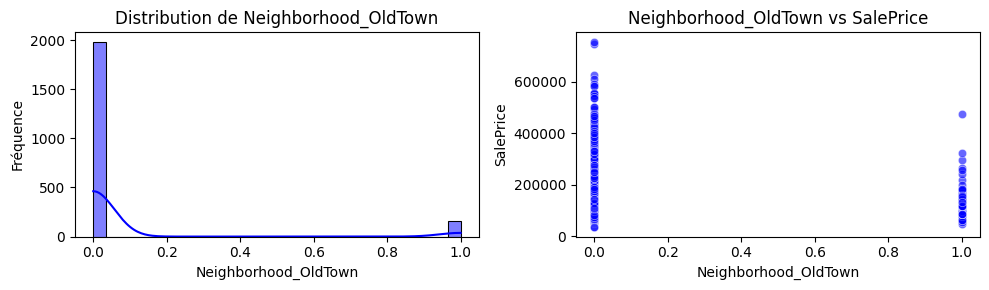

Neighborhood_SWISU vs SalePrice : -0.07


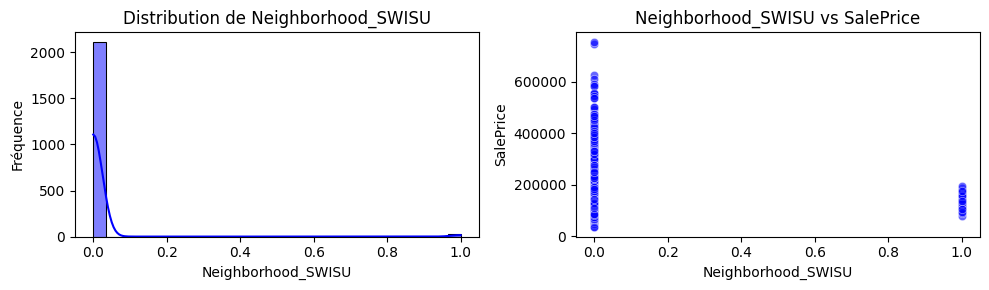

Neighborhood_Sawyer vs SalePrice : -0.14


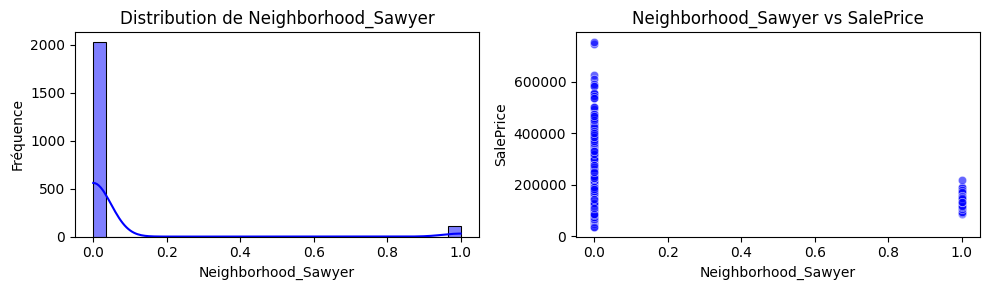

Neighborhood_SawyerW vs SalePrice : 0.01


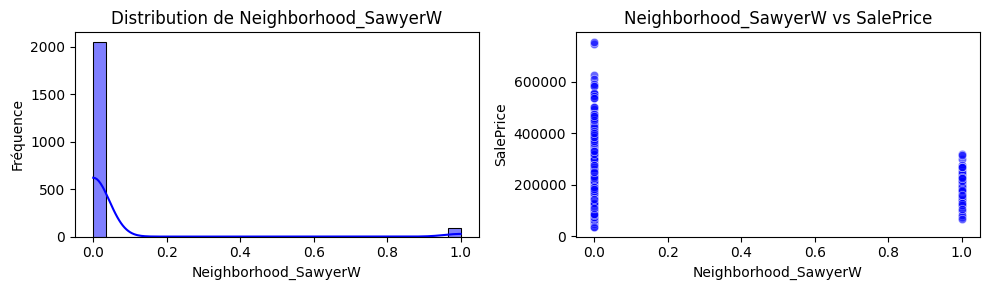

Neighborhood_Somerst vs SalePrice : 0.13


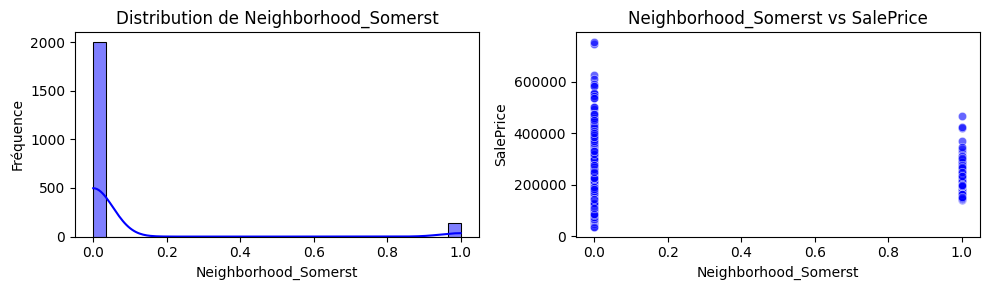

Neighborhood_StoneBr vs SalePrice : 0.24


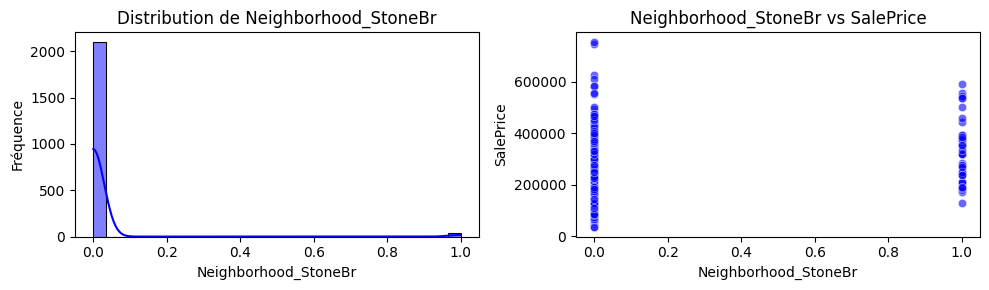

Neighborhood_Timber vs SalePrice : 0.13


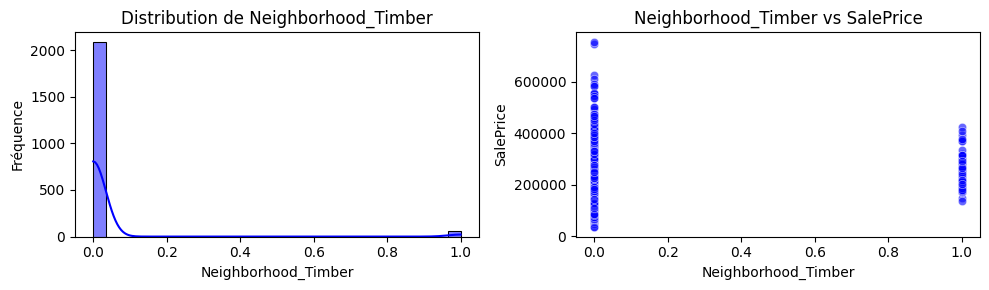

Neighborhood_Veenker vs SalePrice : 0.08


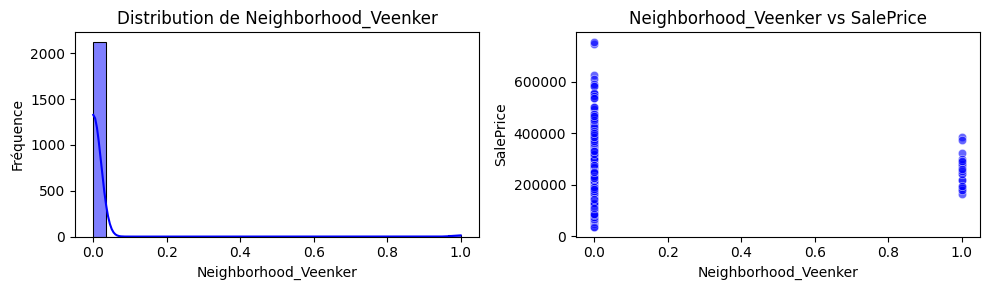

Condition 1_Feedr vs SalePrice : -0.11


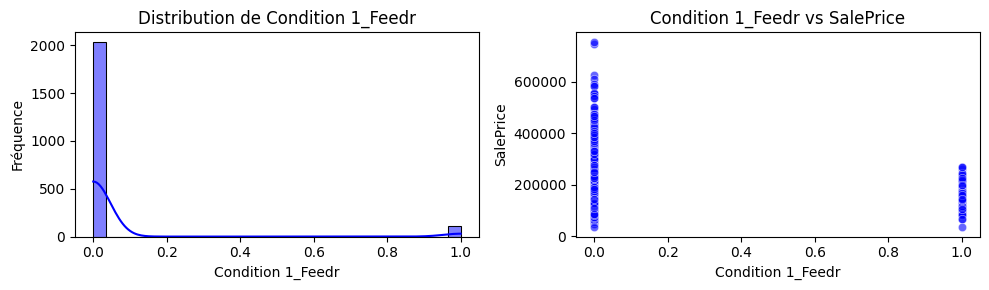

Condition 1_Norm vs SalePrice : 0.10


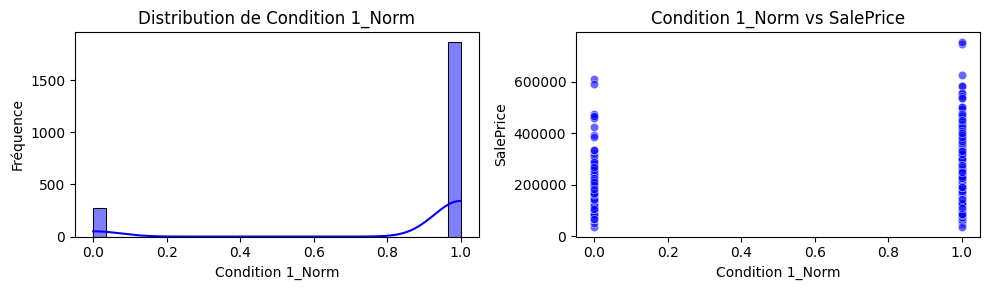

Condition 1_PosA vs SalePrice : 0.07


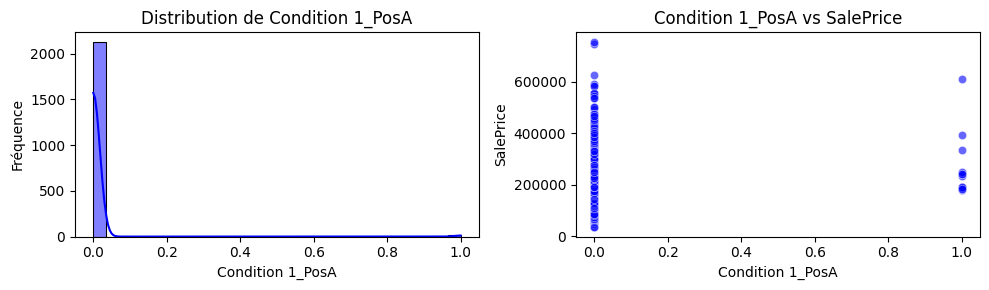

Condition 1_PosN vs SalePrice : 0.10


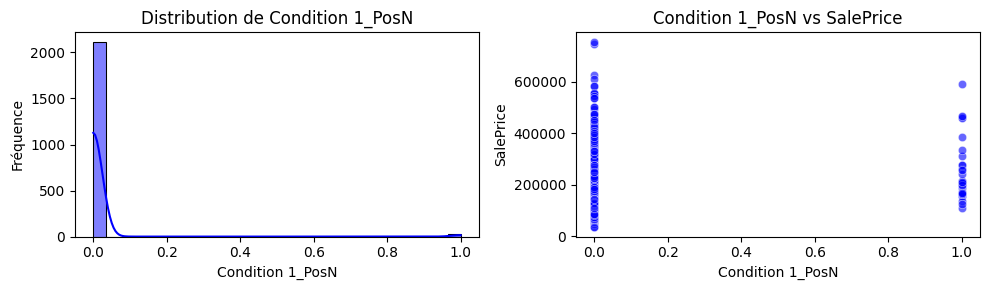

Condition 1_RRAe vs SalePrice : -0.05


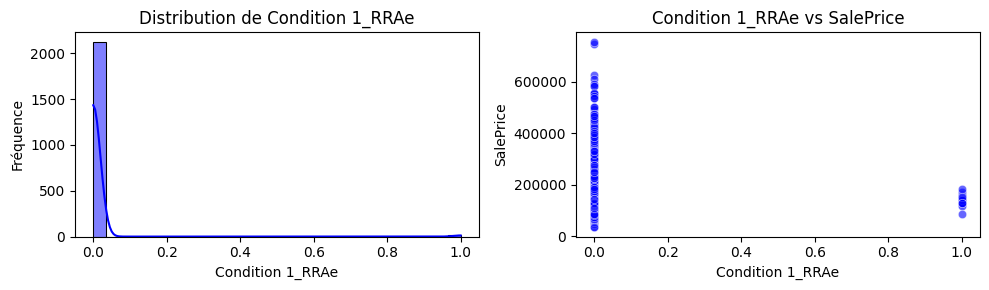

Condition 1_RRAn vs SalePrice : -0.02


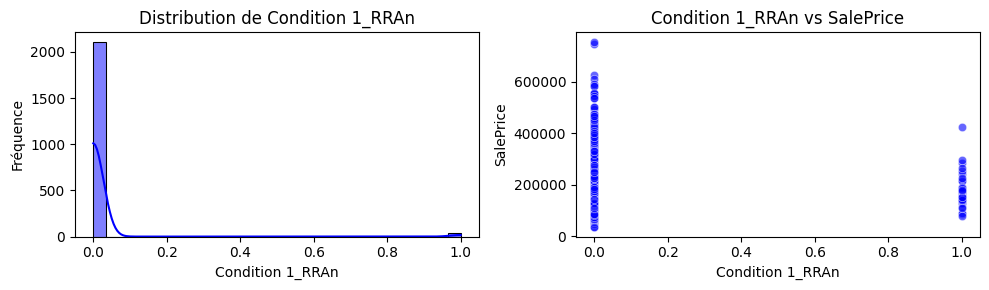

Condition 1_RRNe vs SalePrice : -0.03


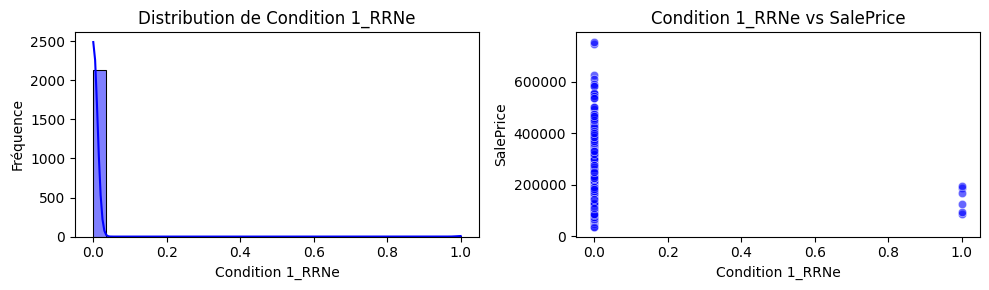

Condition 1_RRNn vs SalePrice : -0.00


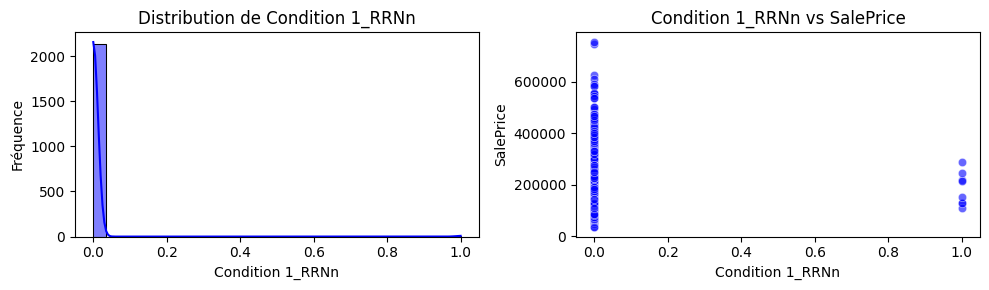

Condition 2_Feedr vs SalePrice : -0.05


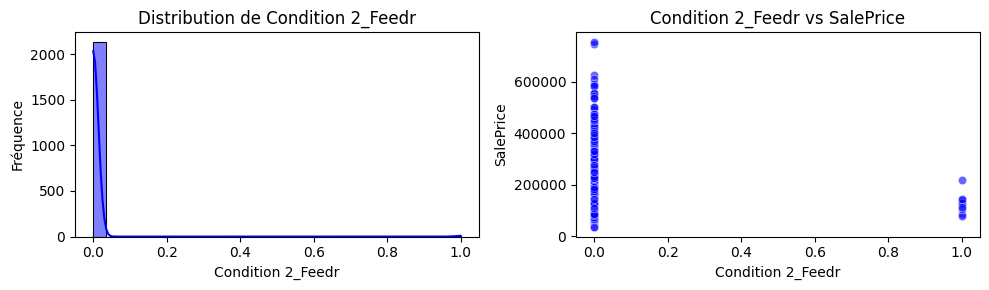

Condition 2_Norm vs SalePrice : -0.02


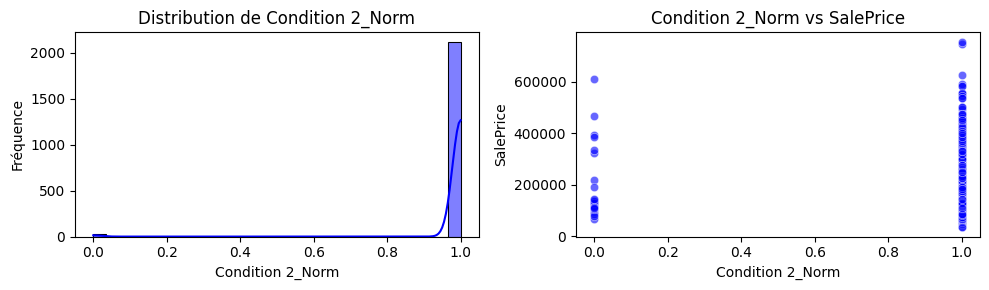

Condition 2_PosA vs SalePrice : 0.12


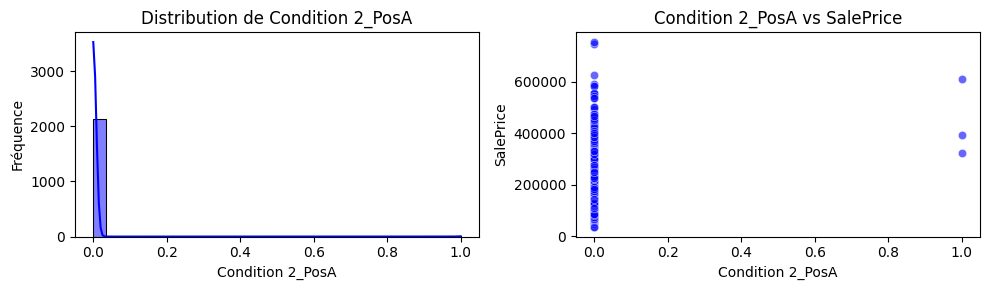

Condition 2_PosN vs SalePrice : 0.10


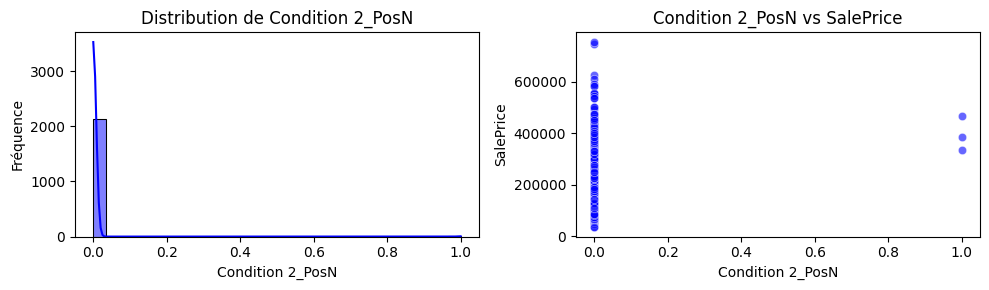

Condition 2_RRAe vs SalePrice : 0.00


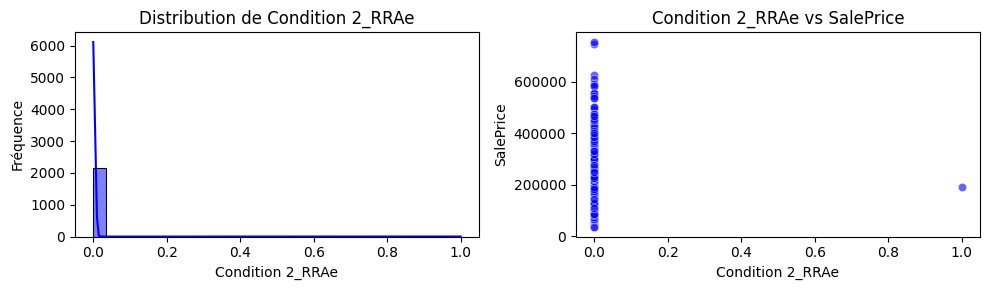

Condition 2_RRAn vs SalePrice : -0.01


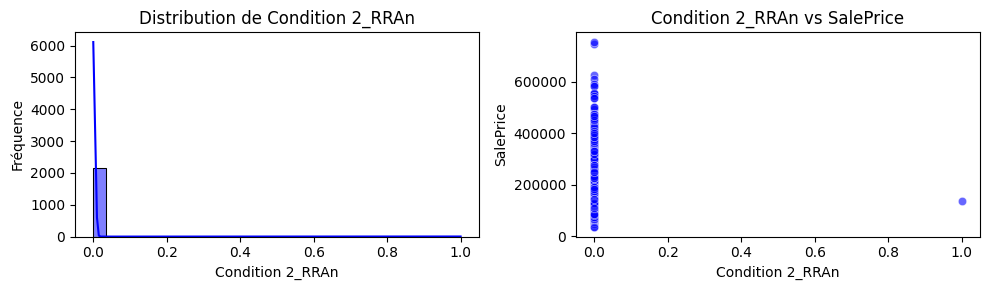

Condition 2_RRNn vs SalePrice : -0.03


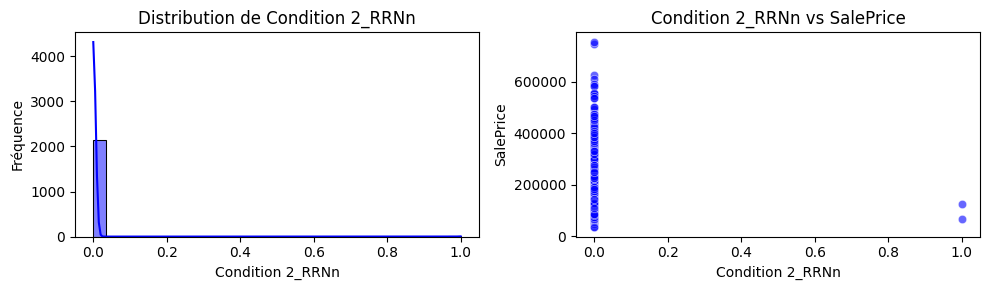

Bldg Type_2fmCon vs SalePrice : -0.09


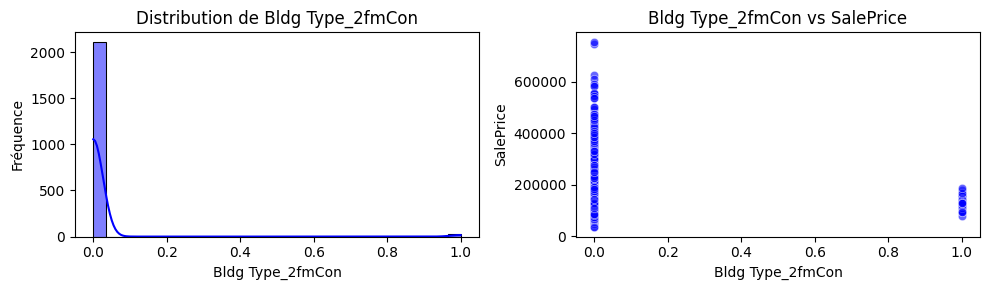

Bldg Type_Duplex vs SalePrice : -0.05


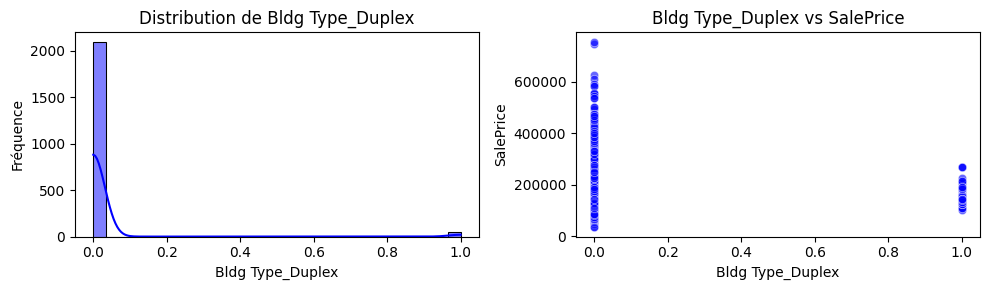

Bldg Type_Twnhs vs SalePrice : -0.11


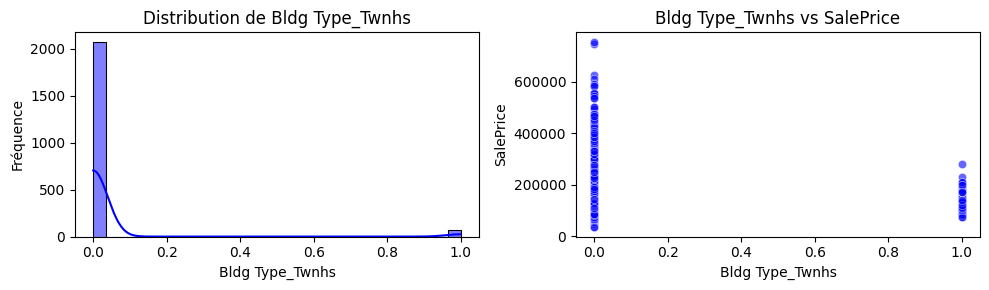

Bldg Type_TwnhsE vs SalePrice : 0.03


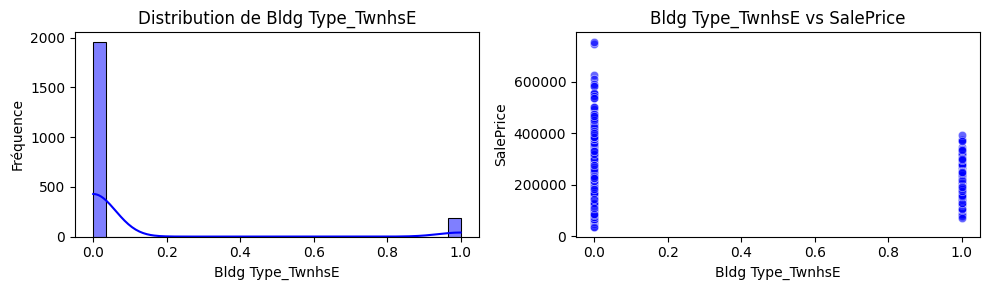

House Style_1.5Unf vs SalePrice : -0.07


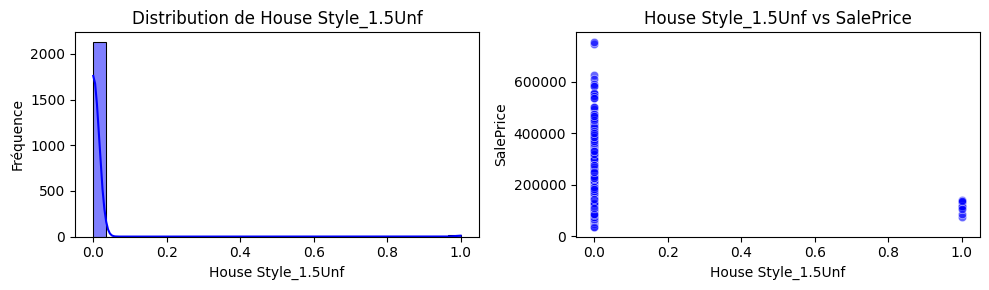

House Style_1Story vs SalePrice : -0.04


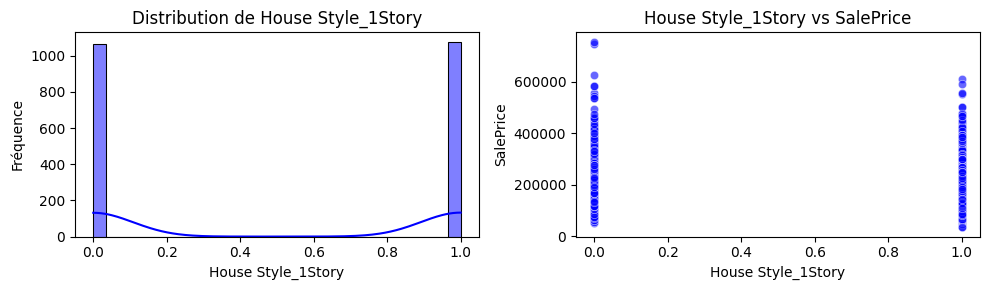

House Style_2.5Fin vs SalePrice : 0.04


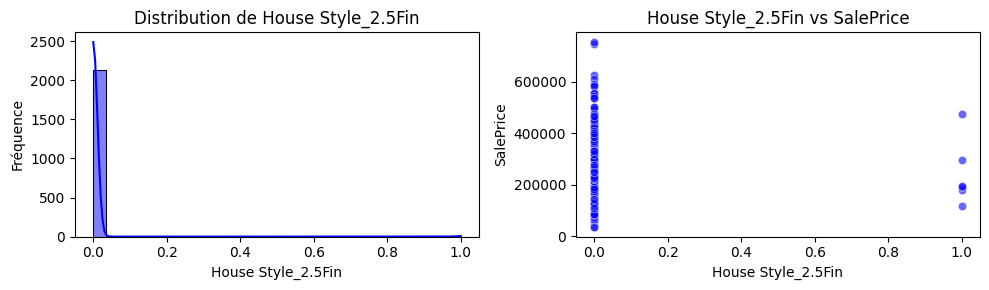

House Style_2.5Unf vs SalePrice : -0.00


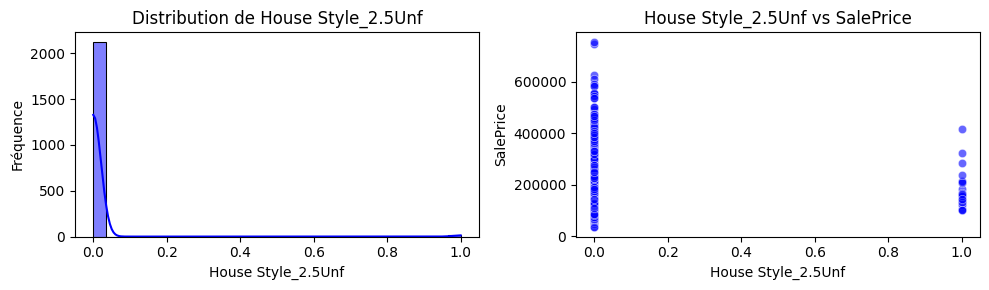

House Style_2Story vs SalePrice : 0.21


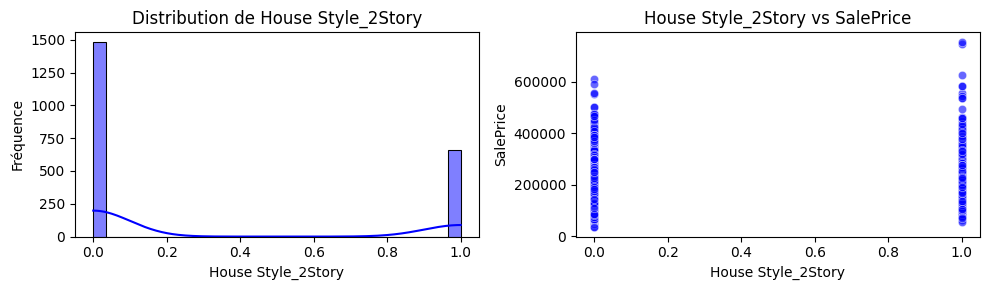

House Style_SFoyer vs SalePrice : -0.07


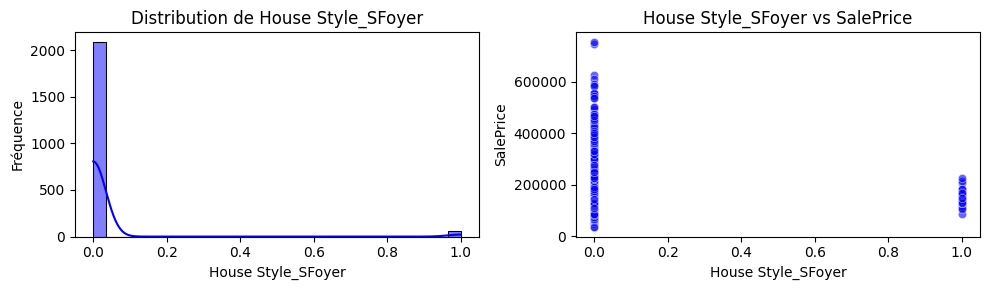

House Style_SLvl vs SalePrice : -0.05


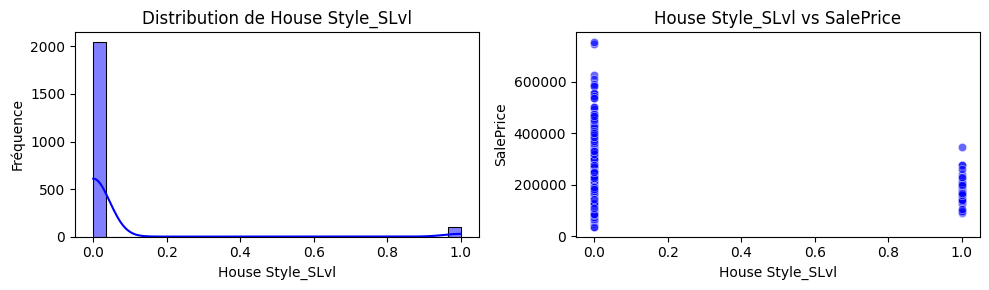

Roof Style_Gable vs SalePrice : -0.27


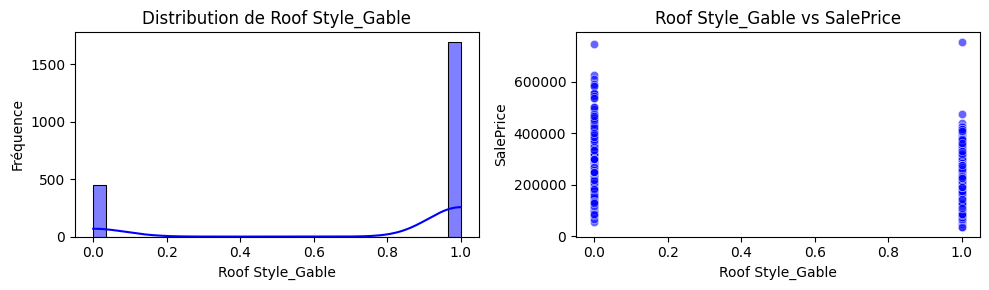

Roof Style_Gambrel vs SalePrice : -0.04


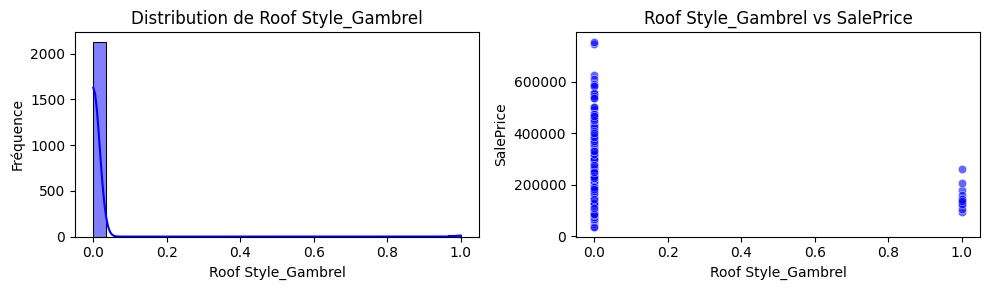

Roof Style_Hip vs SalePrice : 0.28


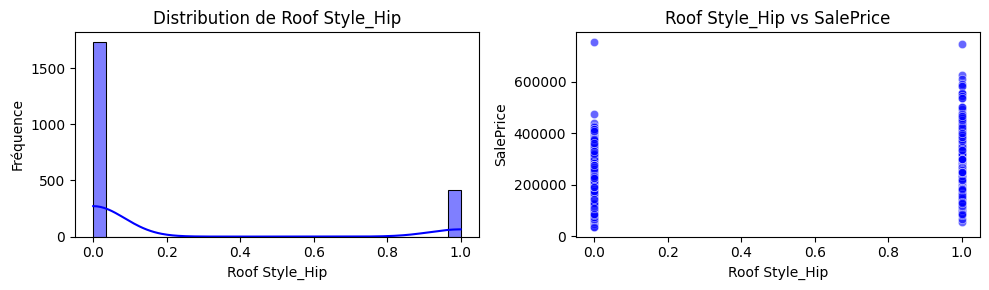

Roof Style_Mansard vs SalePrice : -0.00


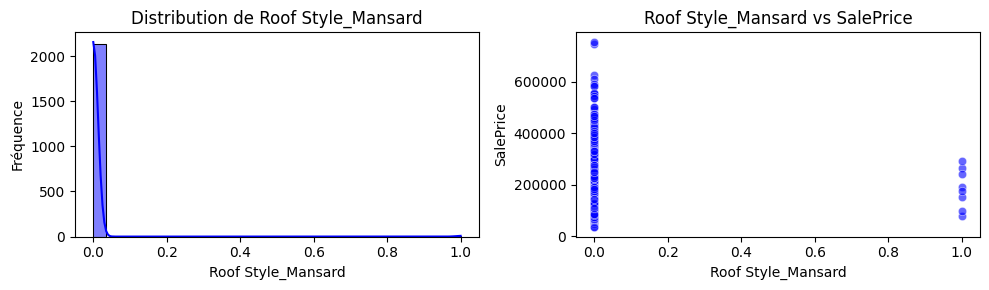

Roof Style_Shed vs SalePrice : 0.02


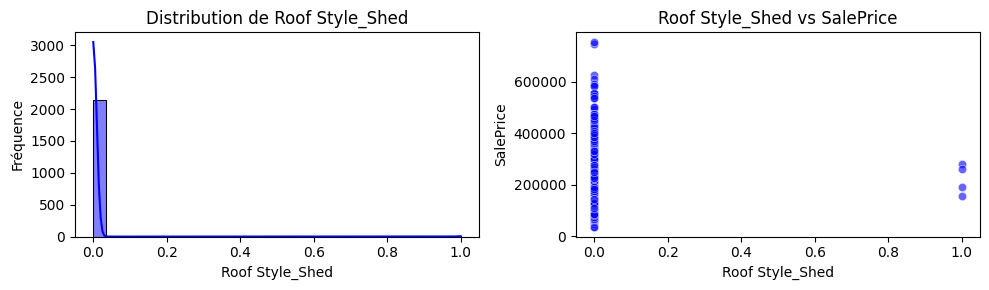

Roof Matl_CompShg vs SalePrice : -0.09


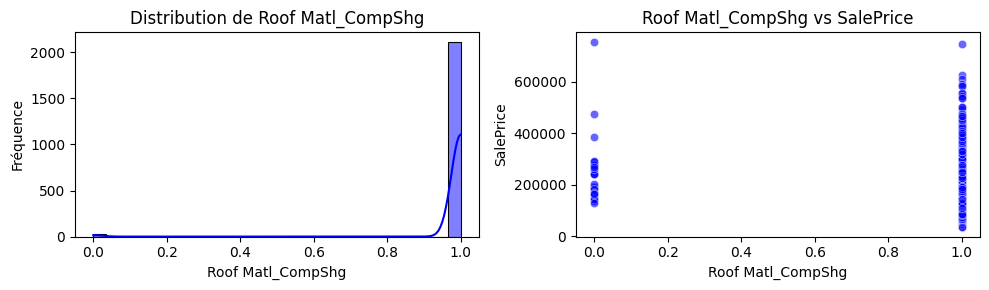

Roof Matl_Membran vs SalePrice : 0.01


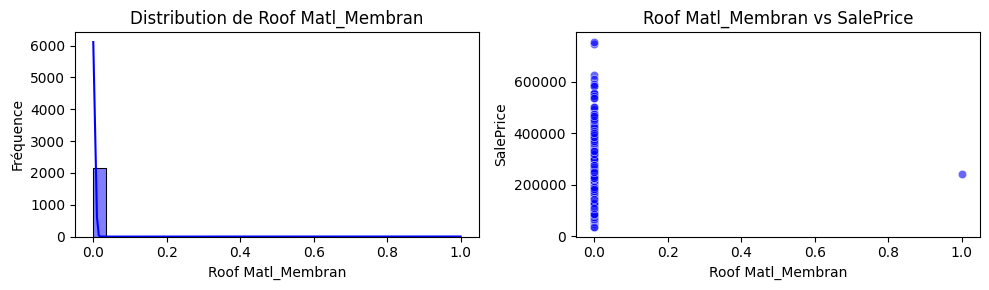

Roof Matl_Metal vs SalePrice : -0.00


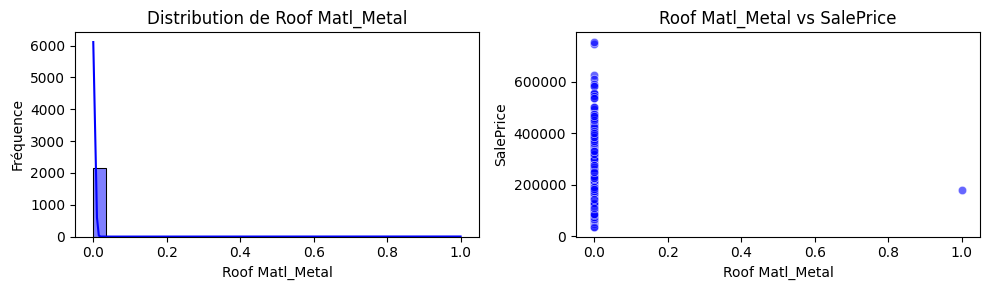

Roof Matl_Roll vs SalePrice : -0.01


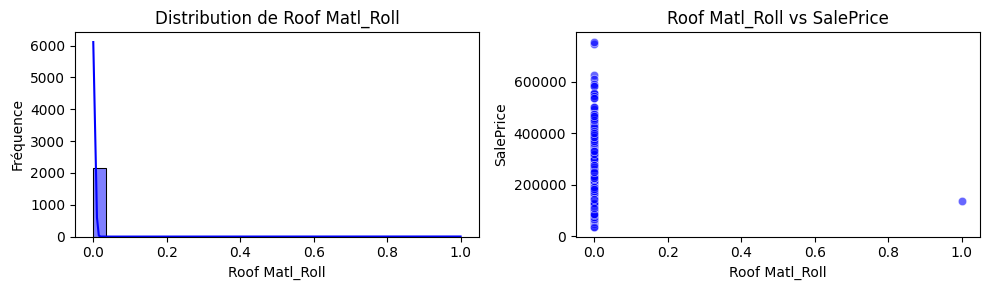

Roof Matl_Tar&Grv vs SalePrice : 0.01


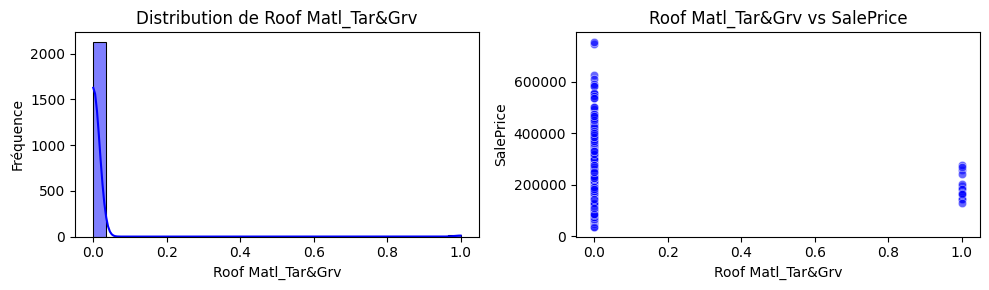

Roof Matl_WdShake vs SalePrice : 0.05


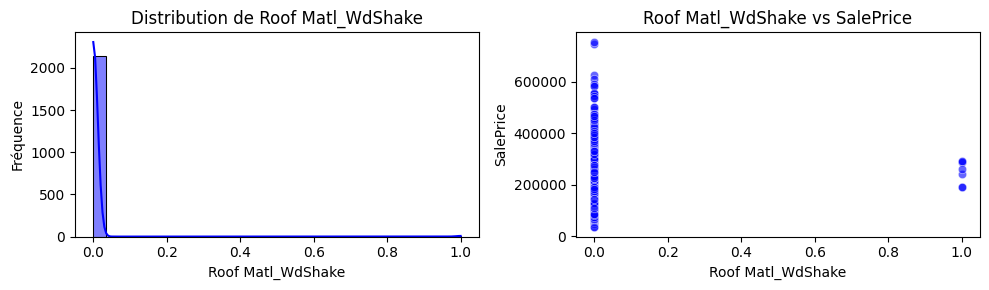

Roof Matl_WdShngl vs SalePrice : 0.15


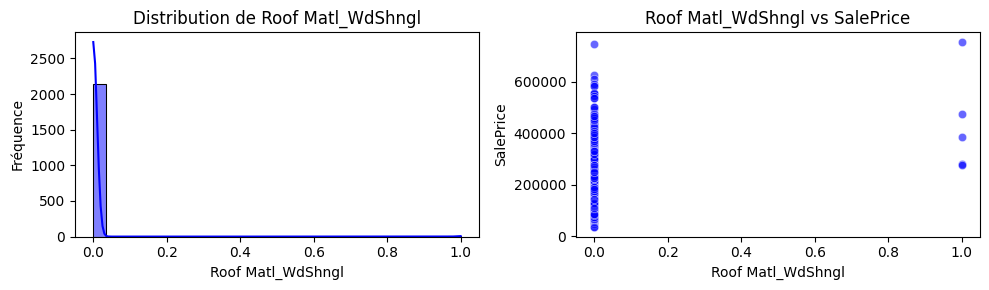

Exterior 1st_BrkComm vs SalePrice : -0.01


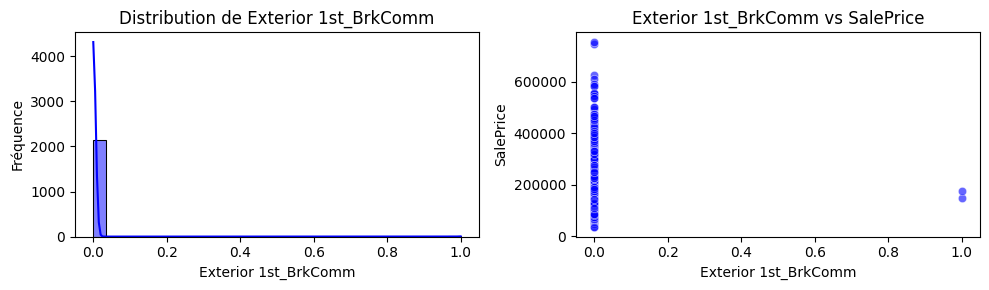

Exterior 1st_BrkFace vs SalePrice : 0.05


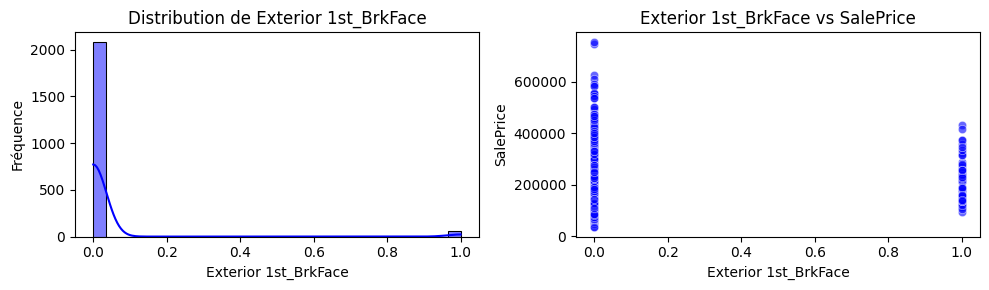

Exterior 1st_CBlock vs SalePrice : -0.02


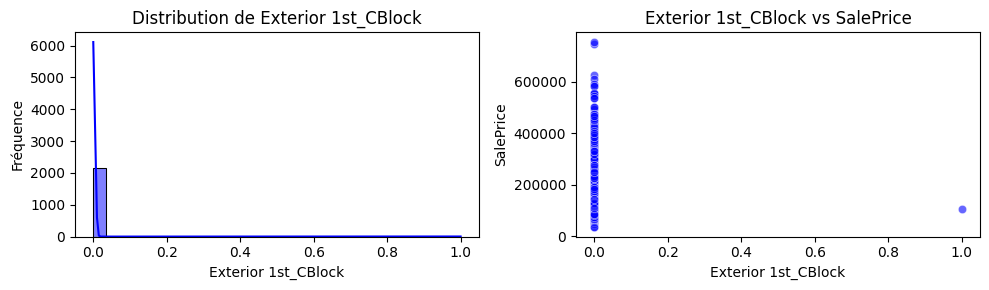

Exterior 1st_CemntBd vs SalePrice : 0.18


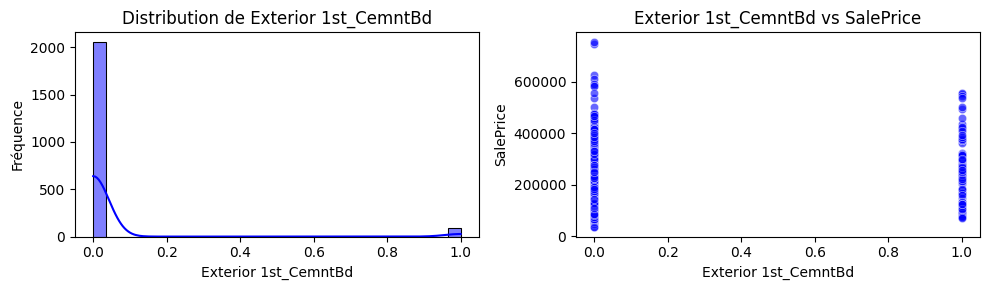

Exterior 1st_HdBoard vs SalePrice : -0.12


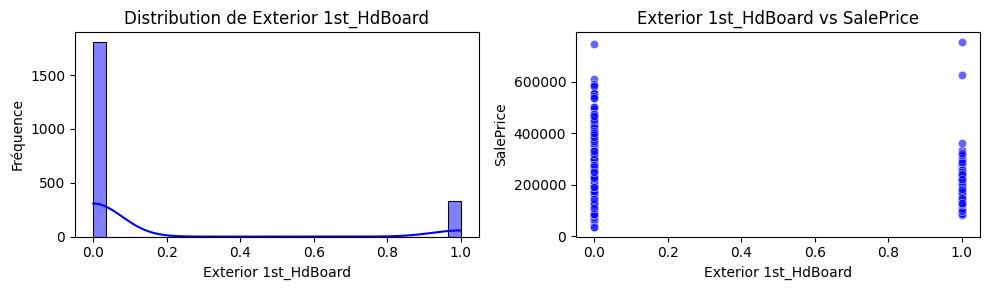

Exterior 1st_ImStucc vs SalePrice : 0.02


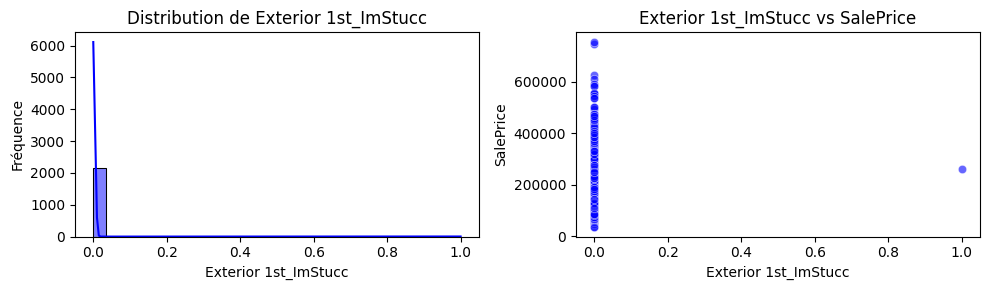

Exterior 1st_MetalSd vs SalePrice : -0.17


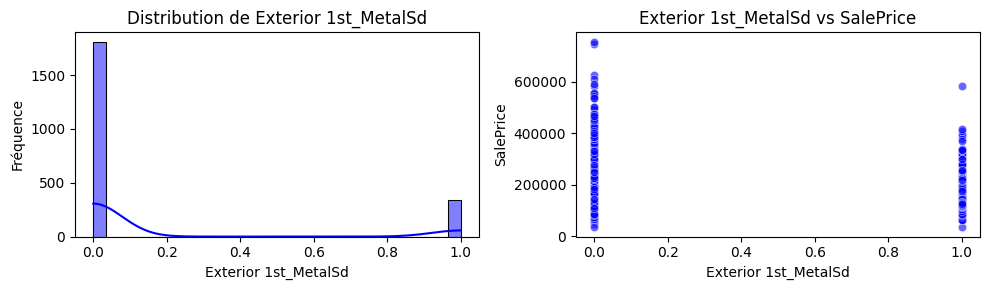

Exterior 1st_Plywood vs SalePrice : -0.06


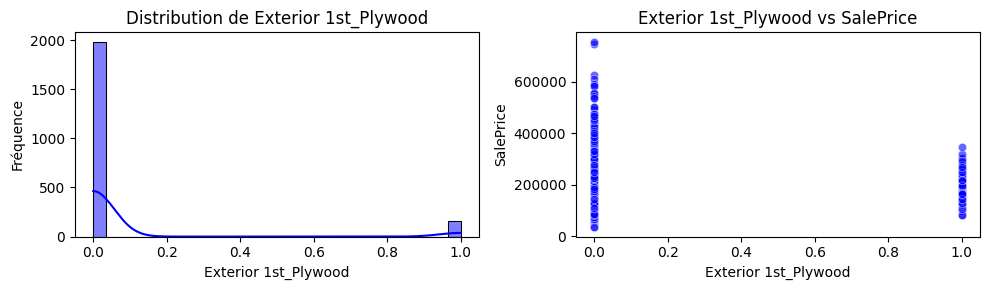

Exterior 1st_Stone vs SalePrice : 0.03


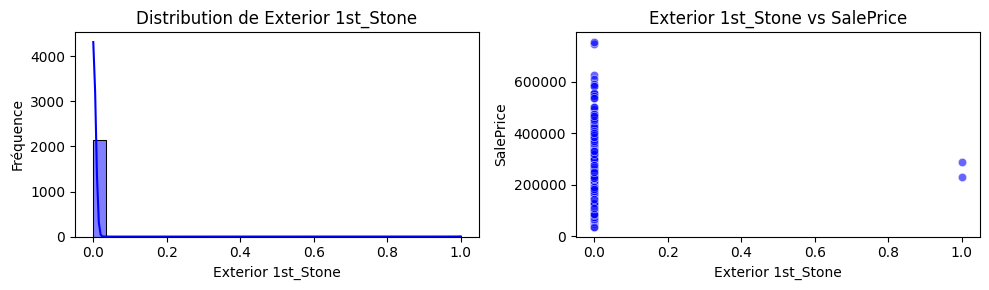

Exterior 1st_Stucco vs SalePrice : -0.04


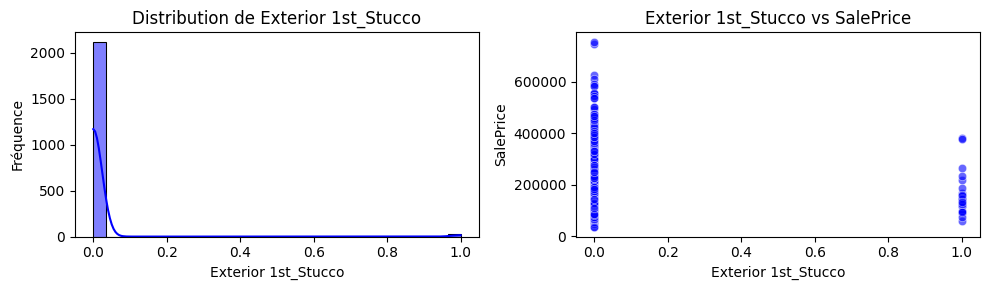

Exterior 1st_VinylSd vs SalePrice : 0.32


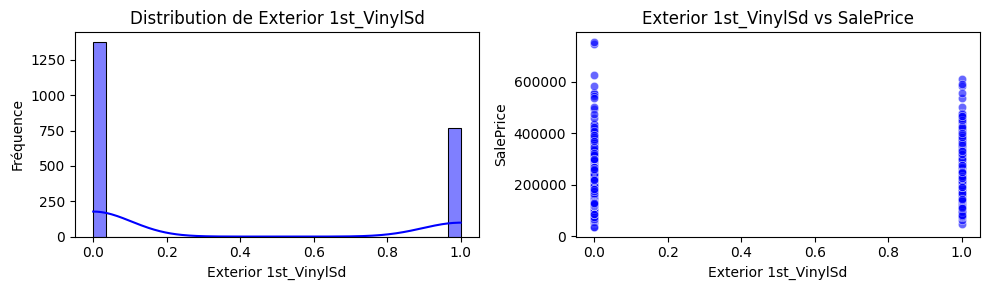

Exterior 1st_Wd Sdng vs SalePrice : -0.16


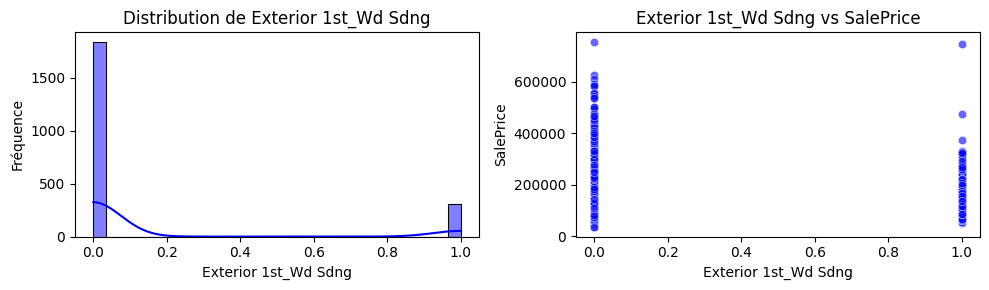

Exterior 1st_WdShing vs SalePrice : -0.03


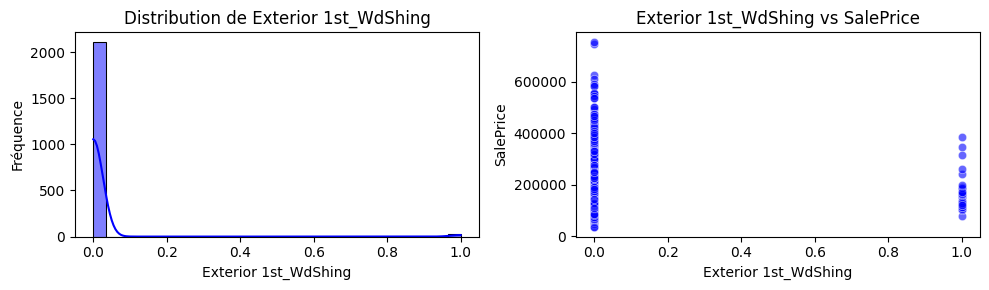

Exterior 2nd_AsphShn vs SalePrice : -0.01


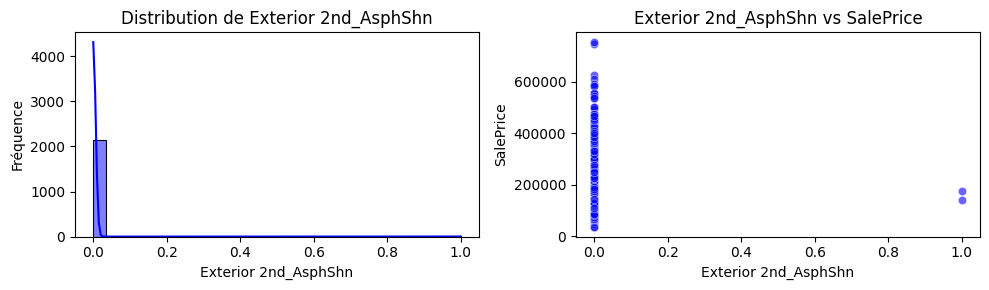

Exterior 2nd_Brk Cmn vs SalePrice : -0.05


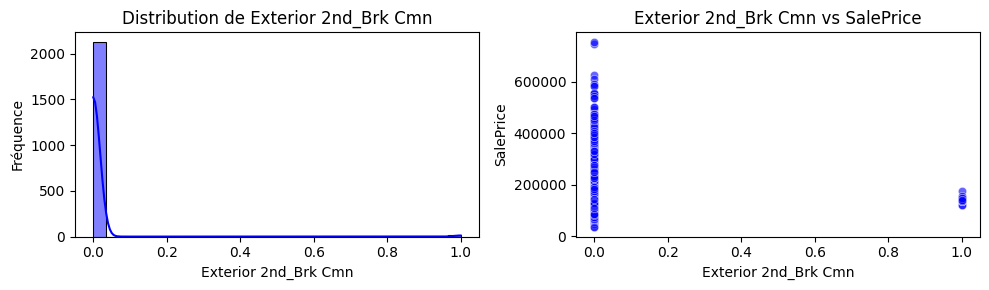

Exterior 2nd_BrkFace vs SalePrice : 0.03


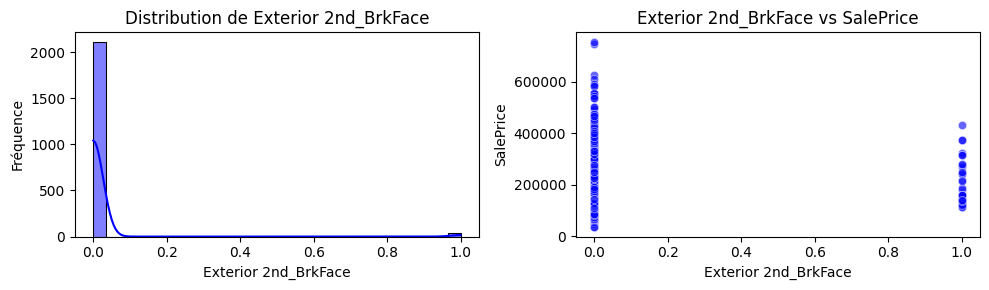

Exterior 2nd_CBlock vs SalePrice : -0.02


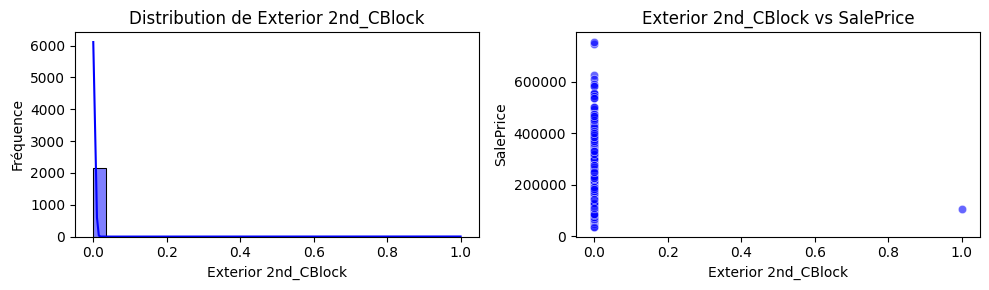

Exterior 2nd_CmentBd vs SalePrice : 0.17


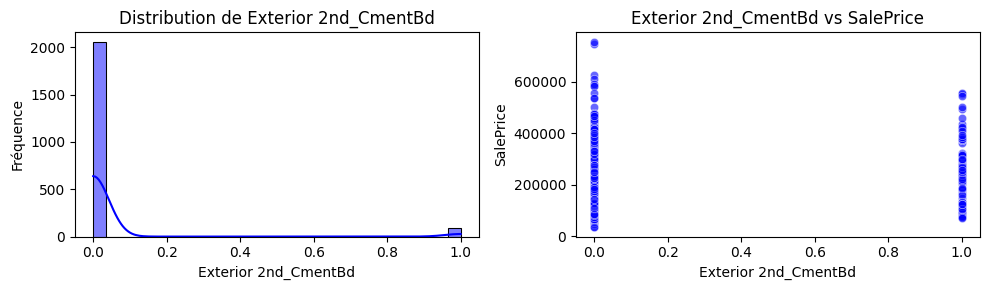

Exterior 2nd_HdBoard vs SalePrice : -0.11


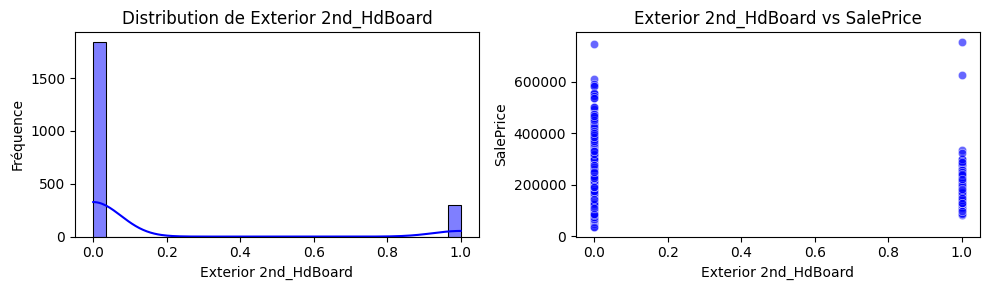

Exterior 2nd_ImStucc vs SalePrice : 0.06


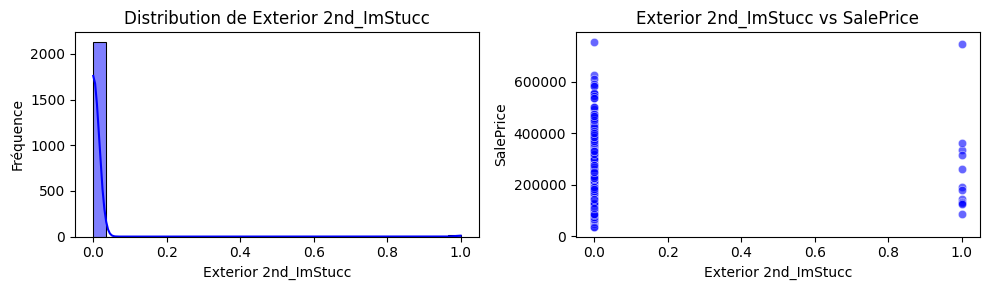

Exterior 2nd_MetalSd vs SalePrice : -0.16


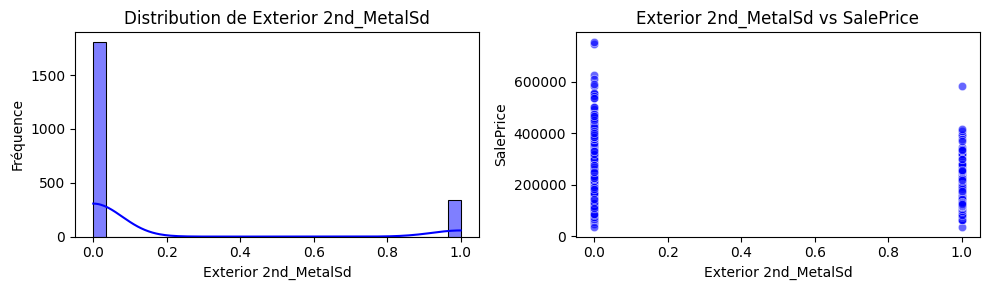

Exterior 2nd_Other vs SalePrice : 0.04


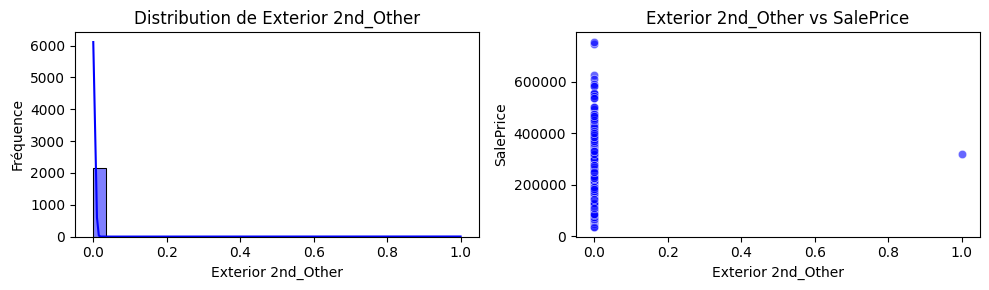

Exterior 2nd_Plywood vs SalePrice : -0.07


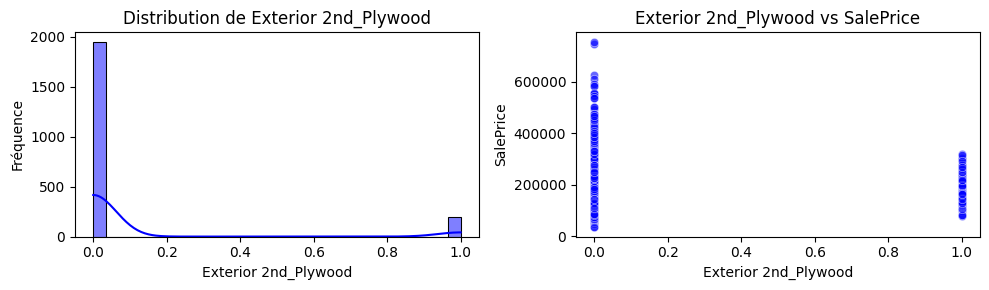

Exterior 2nd_Stone vs SalePrice : 0.01


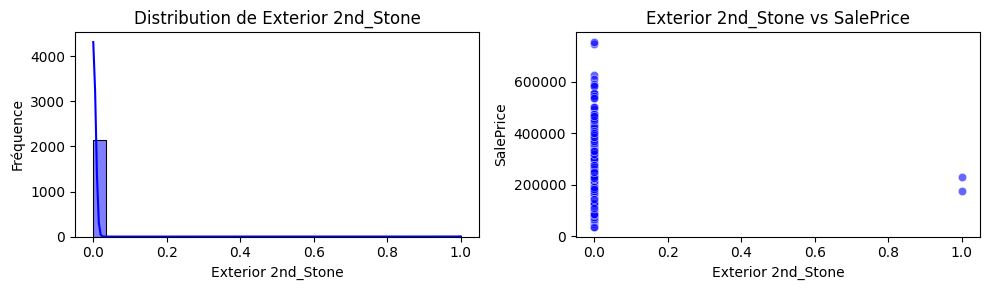

Exterior 2nd_Stucco vs SalePrice : -0.05


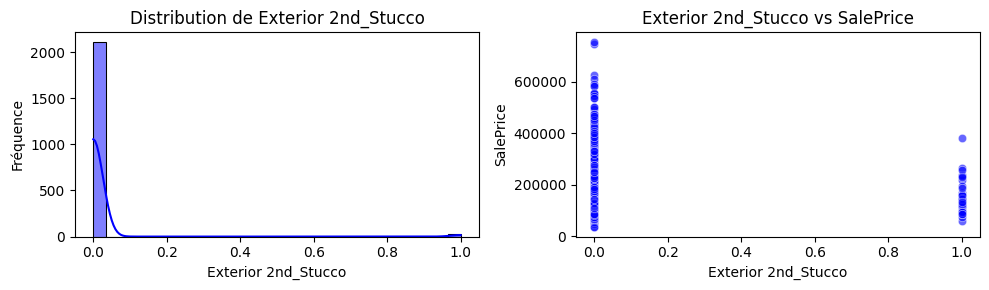

Exterior 2nd_VinylSd vs SalePrice : 0.32


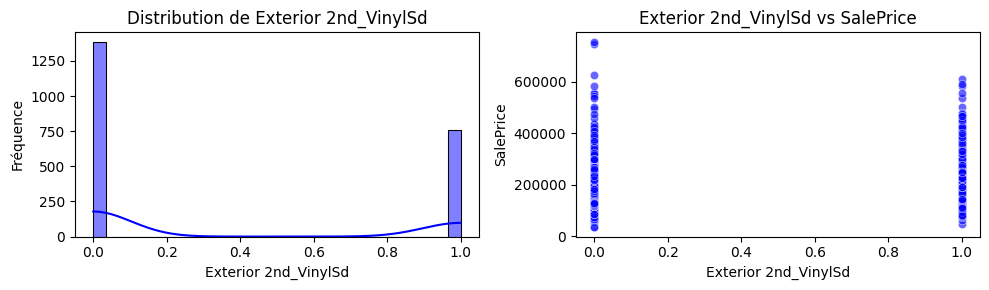

Exterior 2nd_Wd Sdng vs SalePrice : -0.16


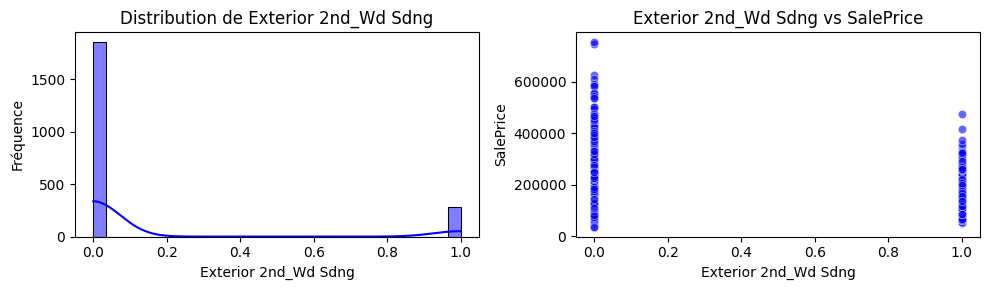

Exterior 2nd_Wd Shng vs SalePrice : -0.04


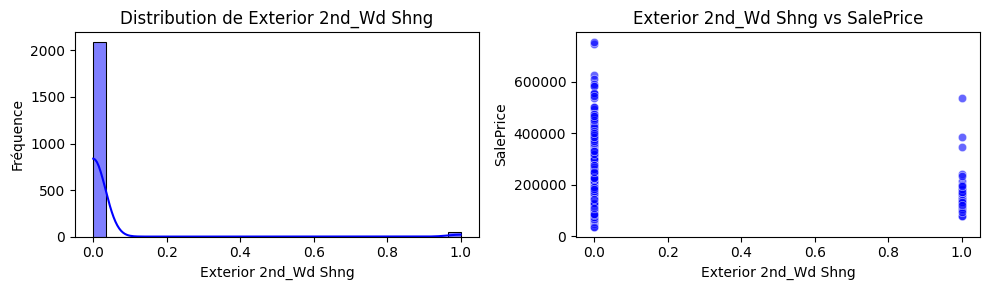

Exter Qual_Fa vs SalePrice : -0.09


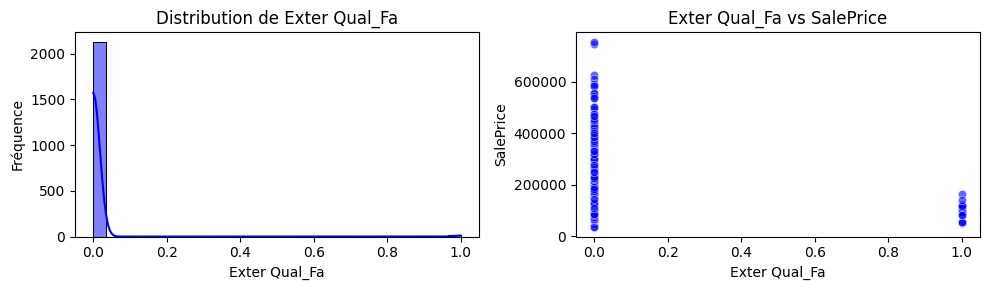

Exter Qual_Gd vs SalePrice : 0.44


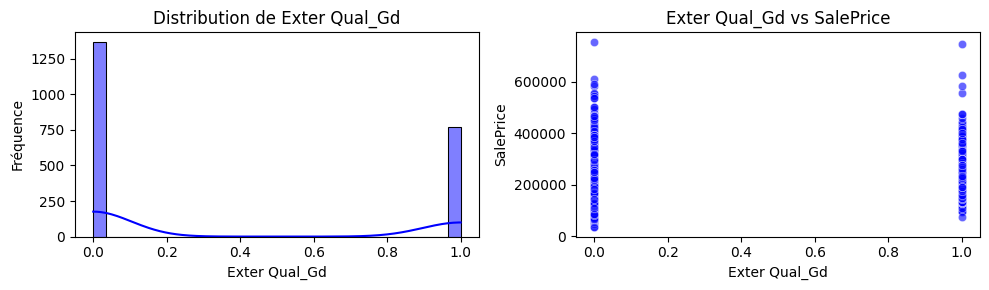

Exter Qual_TA vs SalePrice : -0.60


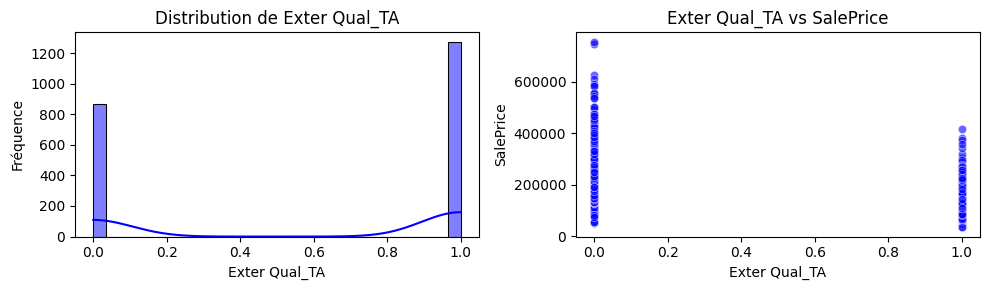

Exter Cond_Fa vs SalePrice : -0.09


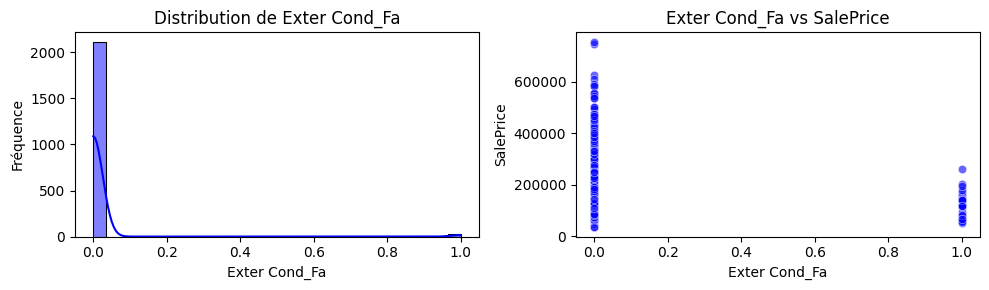

Exter Cond_Gd vs SalePrice : -0.06


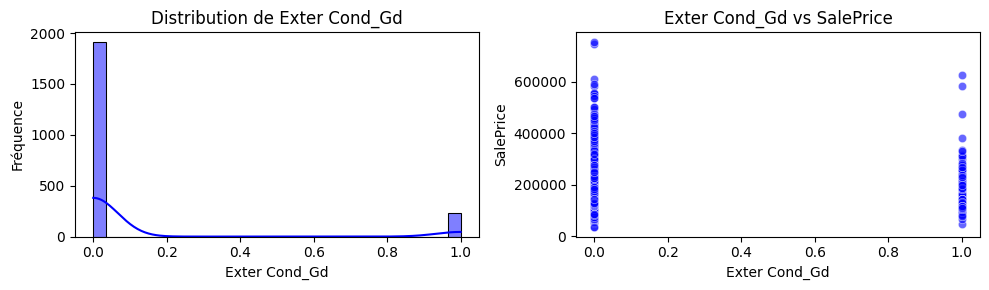

Exter Cond_Po vs SalePrice : -0.01


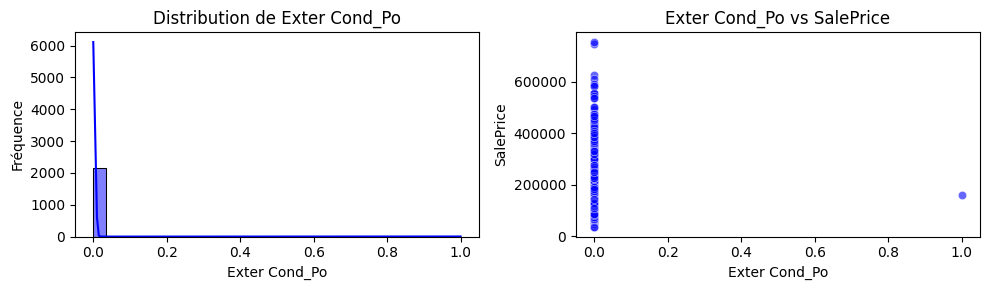

Exter Cond_TA vs SalePrice : 0.08


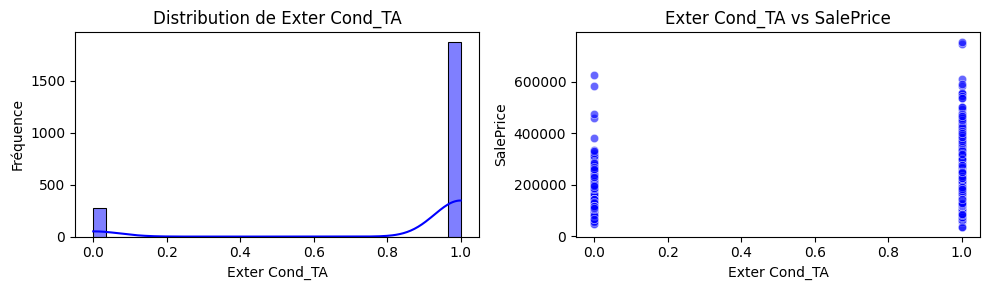

Foundation_CBlock vs SalePrice : -0.38


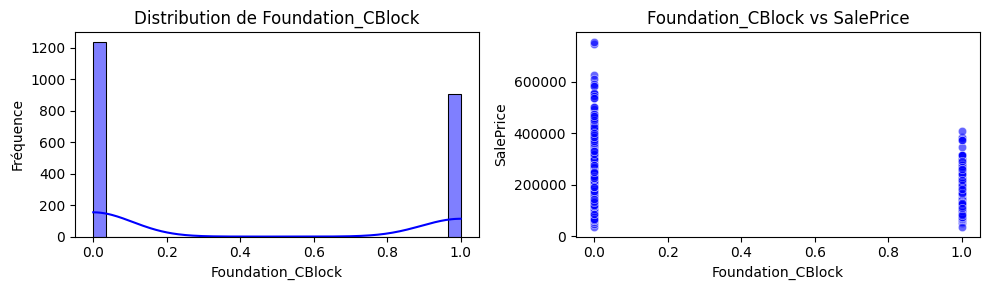

Foundation_PConc vs SalePrice : 0.52


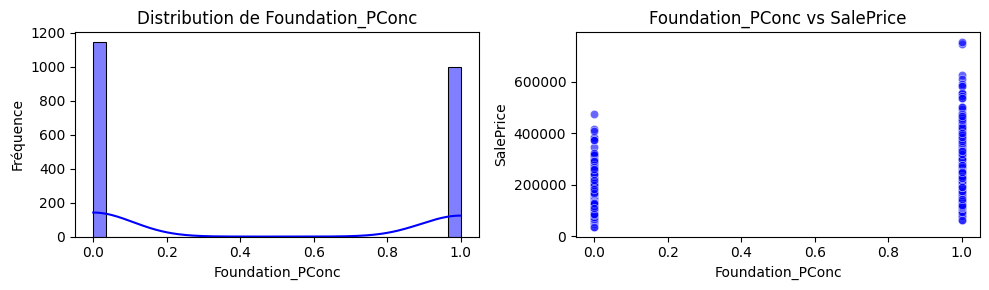

Foundation_Stone vs SalePrice : -0.03


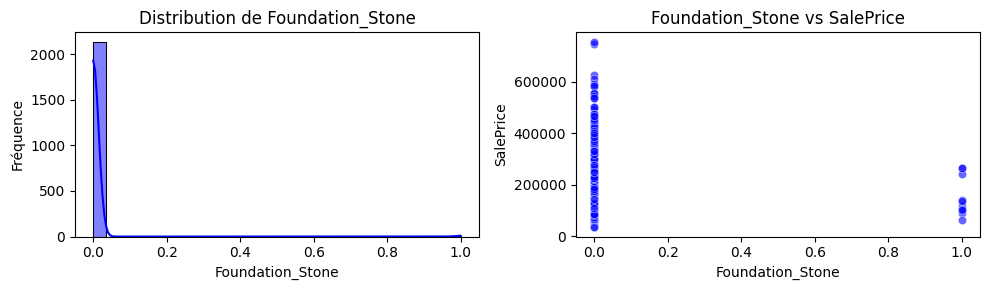

Foundation_Wood vs SalePrice : -0.00


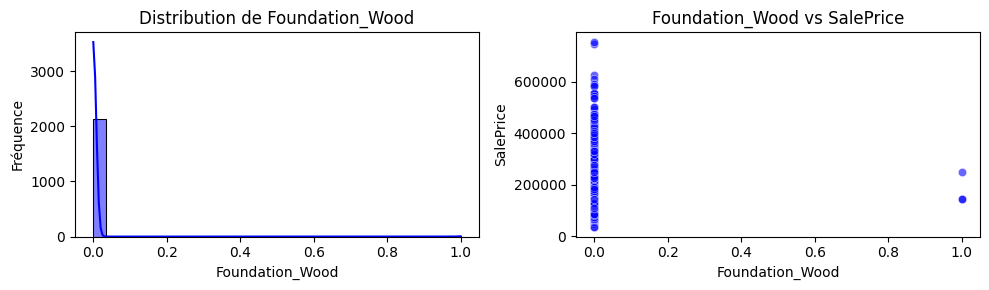

Bsmt Qual_Fa vs SalePrice : -0.16


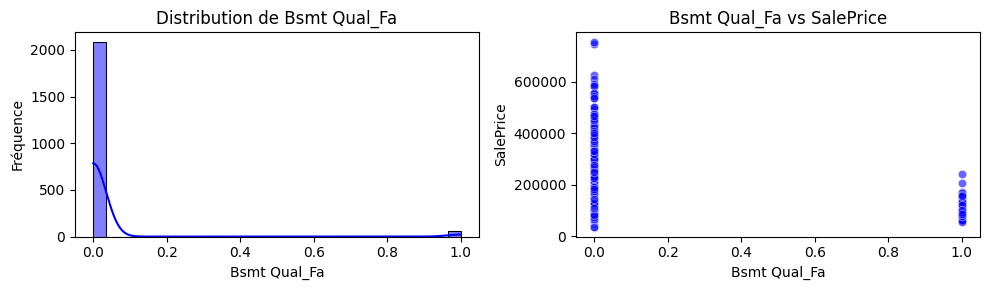

Bsmt Qual_Gd vs SalePrice : 0.19


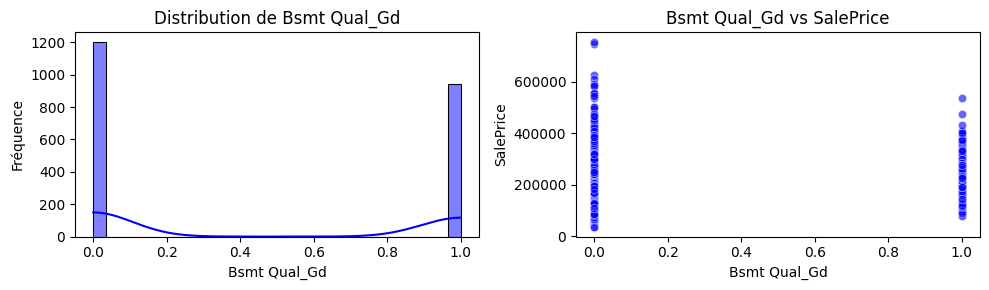

Bsmt Qual_Po vs SalePrice : -0.04


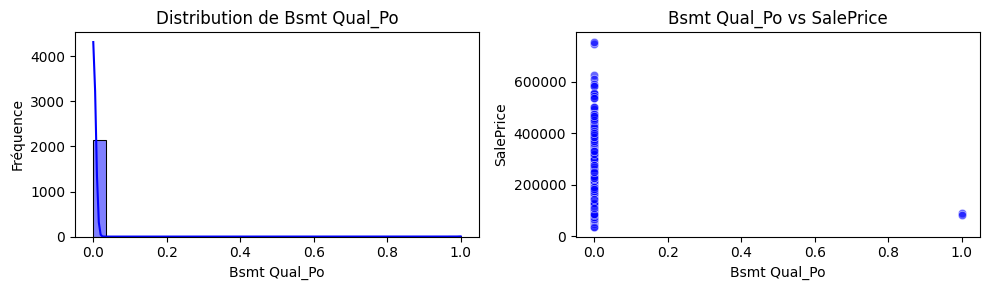

Bsmt Qual_TA vs SalePrice : -0.49


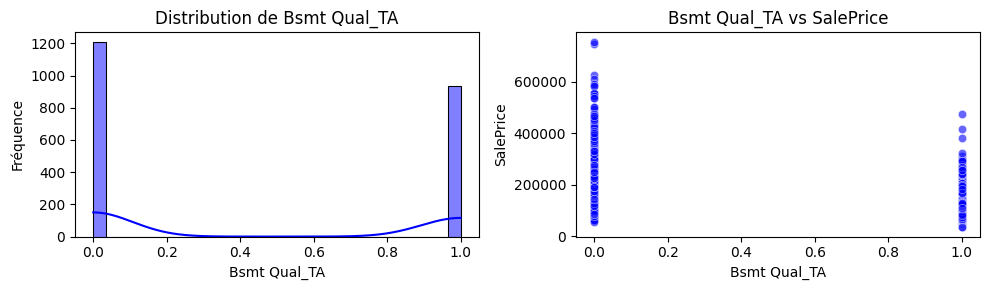

Bsmt Cond_Fa vs SalePrice : -0.13


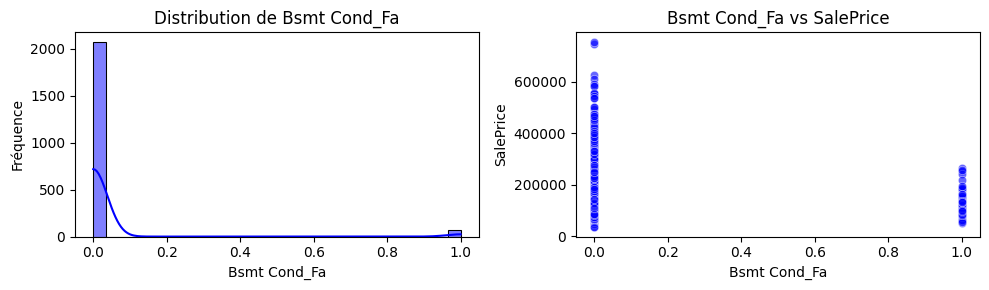

Bsmt Cond_Gd vs SalePrice : 0.07


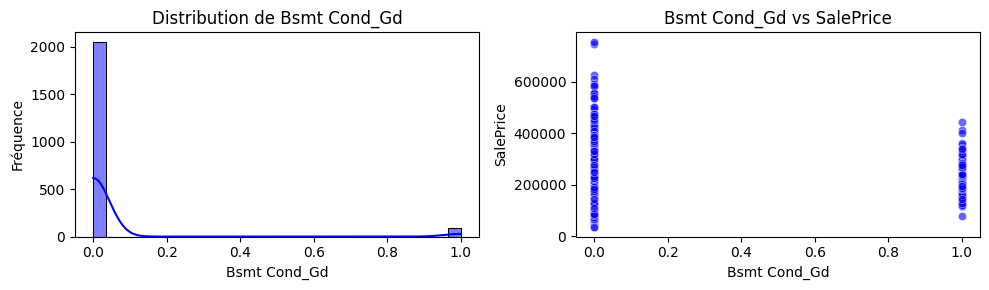

Bsmt Cond_Po vs SalePrice : -0.03


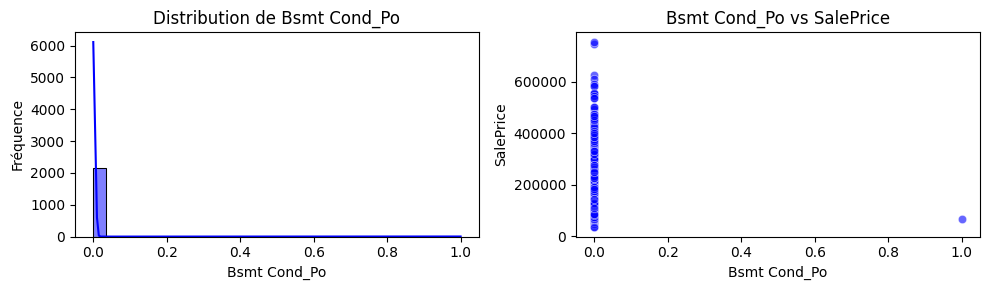

Bsmt Cond_TA vs SalePrice : 0.04


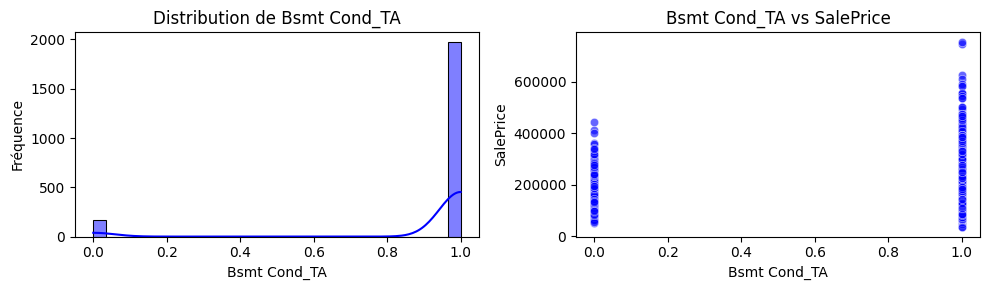

Bsmt Exposure_Gd vs SalePrice : 0.36


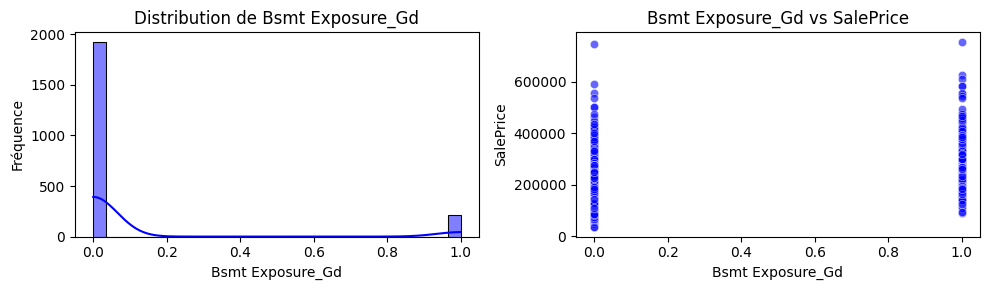

Bsmt Exposure_Mn vs SalePrice : 0.01


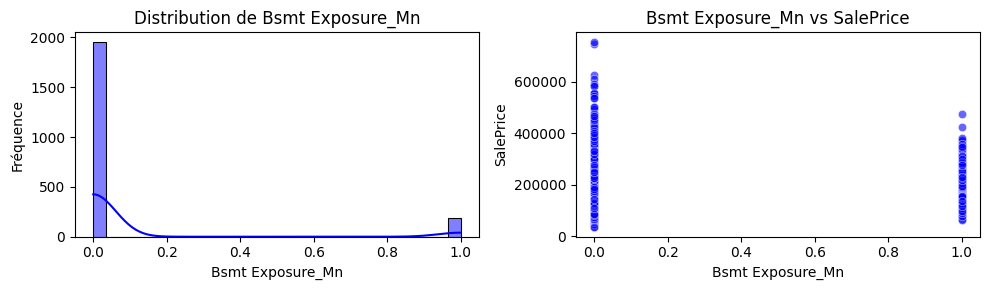

Bsmt Exposure_No vs SalePrice : -0.34


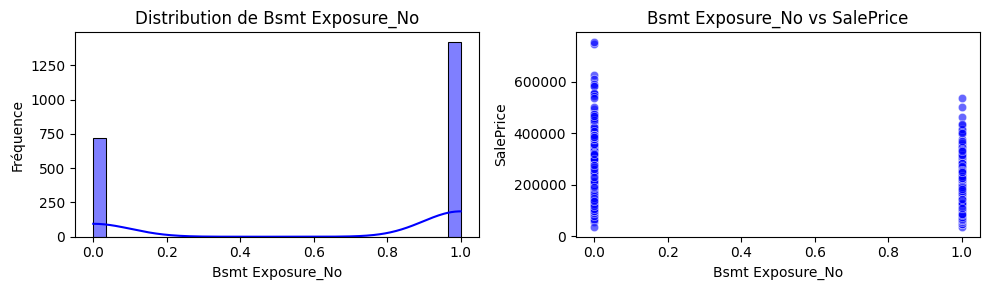

BsmtFin Type 1_BLQ vs SalePrice : -0.13


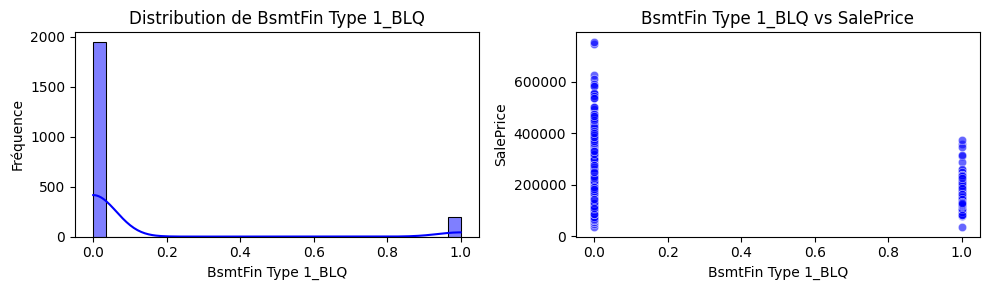

BsmtFin Type 1_GLQ vs SalePrice : 0.45


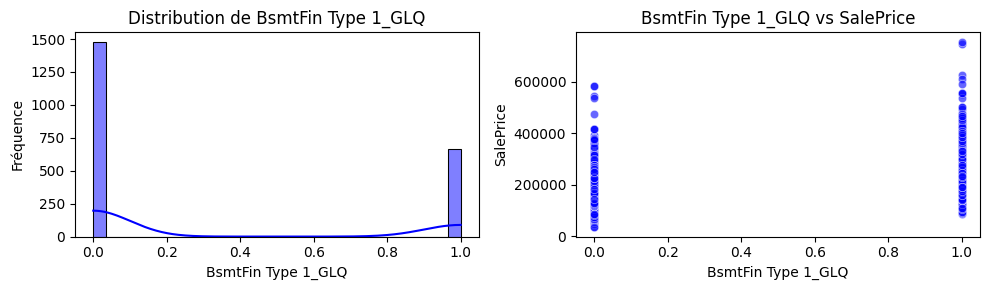

BsmtFin Type 1_LwQ vs SalePrice : -0.08


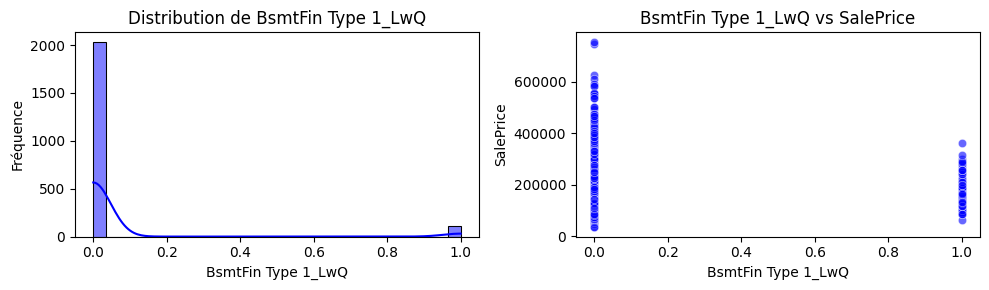

BsmtFin Type 1_Rec vs SalePrice : -0.18


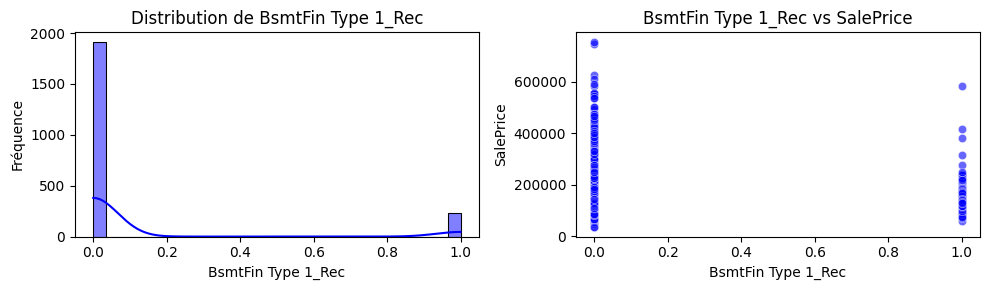

BsmtFin Type 1_Unf vs SalePrice : -0.11


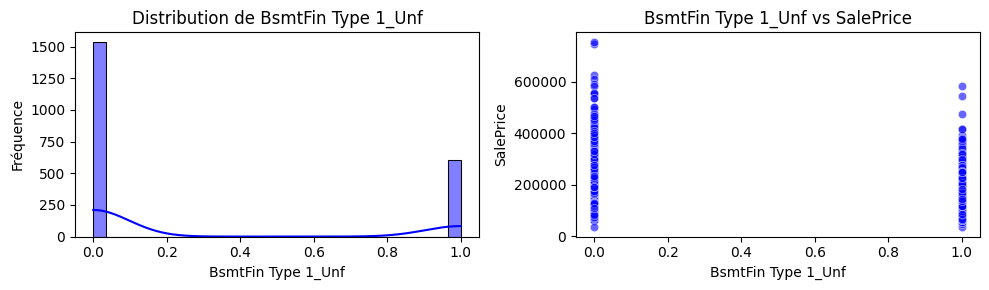

BsmtFin Type 2_BLQ vs SalePrice : -0.05


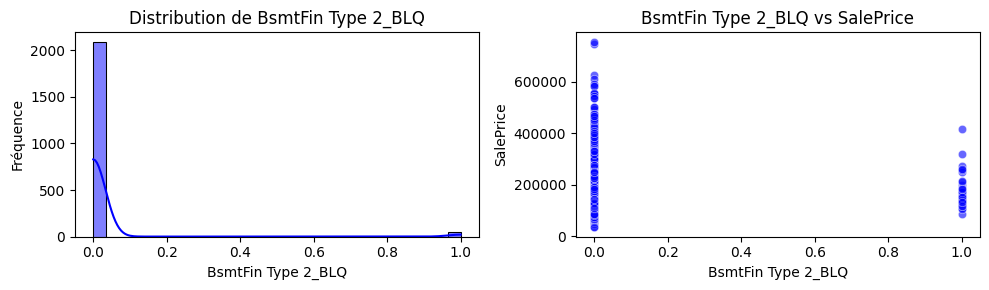

BsmtFin Type 2_GLQ vs SalePrice : 0.05


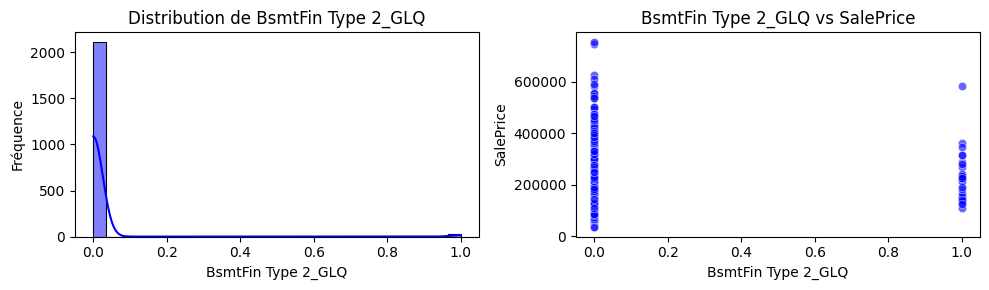

BsmtFin Type 2_LwQ vs SalePrice : -0.06


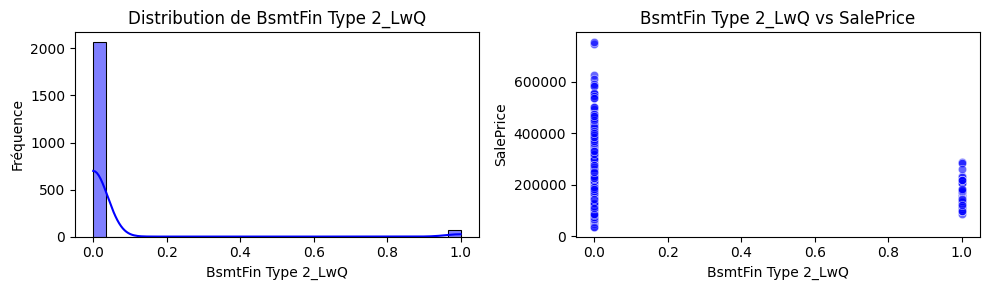

BsmtFin Type 2_Rec vs SalePrice : -0.04


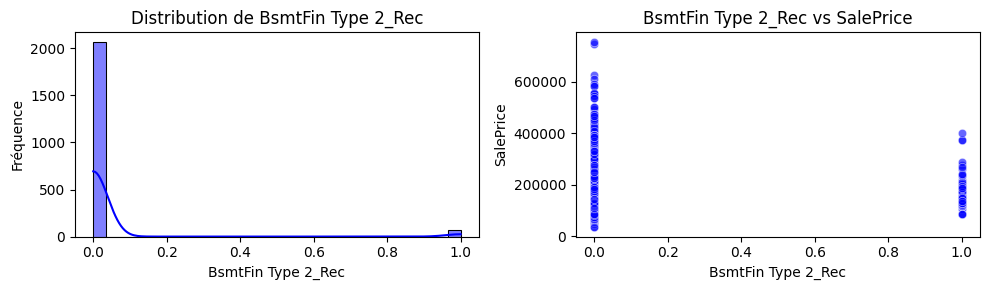

BsmtFin Type 2_Unf vs SalePrice : 0.06


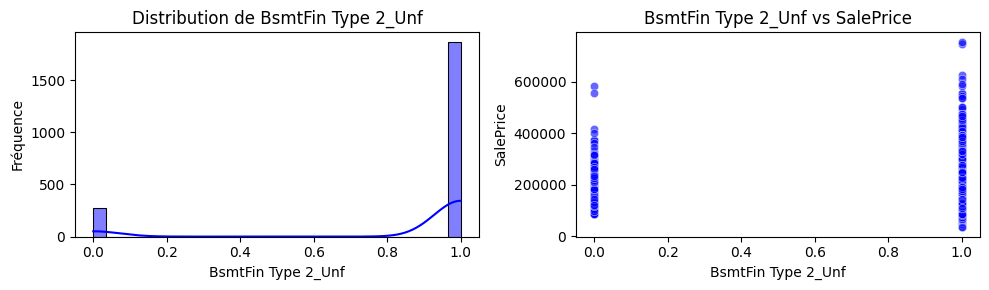

Heating_GasW vs SalePrice : -0.02


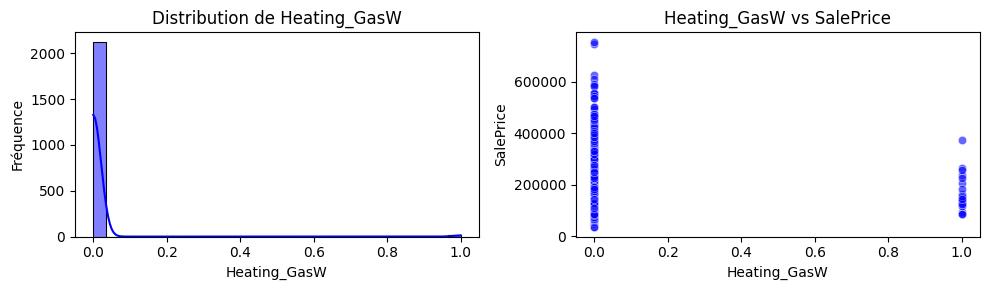

Heating_Grav vs SalePrice : -0.03


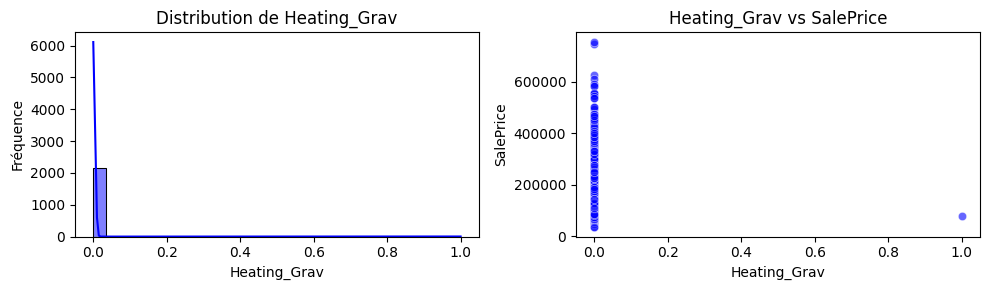

Heating_OthW vs SalePrice : -0.02


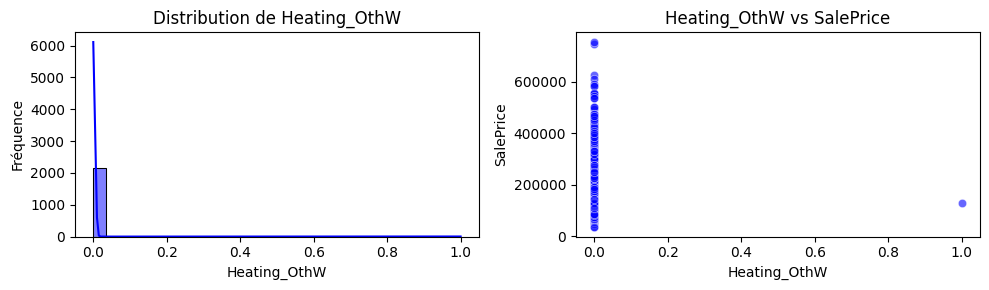

Heating QC_Fa vs SalePrice : -0.10


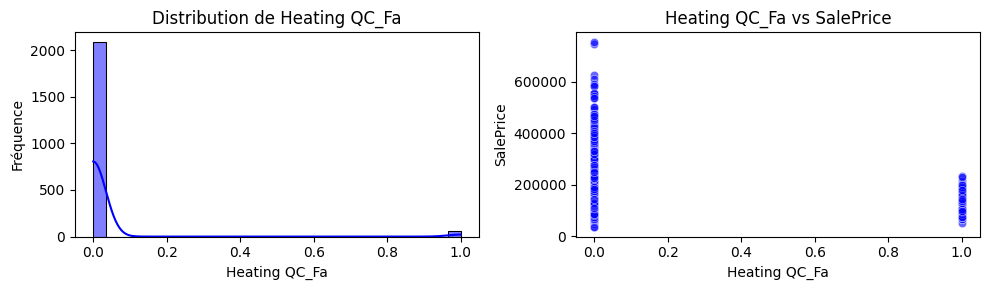

Heating QC_Gd vs SalePrice : -0.13


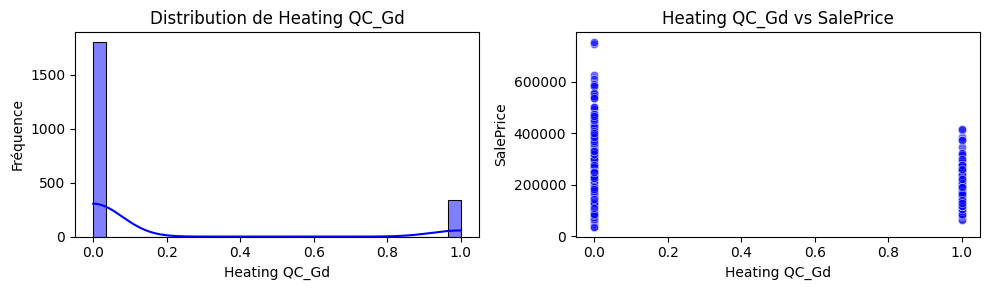

Heating QC_Po vs SalePrice : -0.03


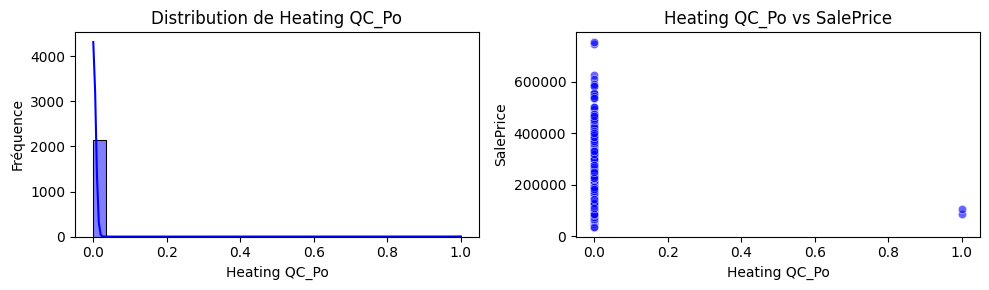

Heating QC_TA vs SalePrice : -0.35


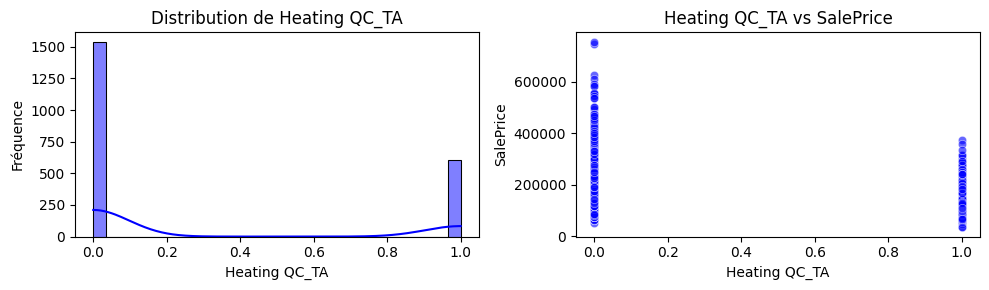

Central Air_Y vs SalePrice : 0.20


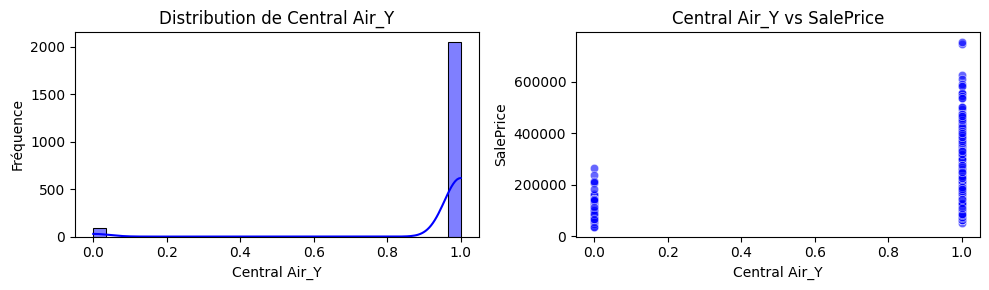

Electrical_FuseF vs SalePrice : -0.10


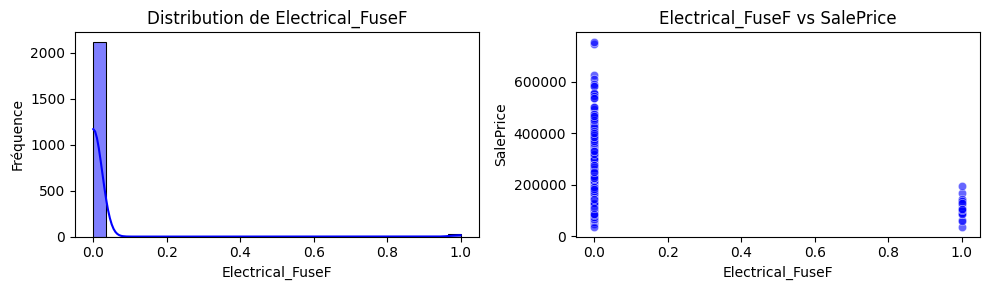

Electrical_FuseP vs SalePrice : -0.05


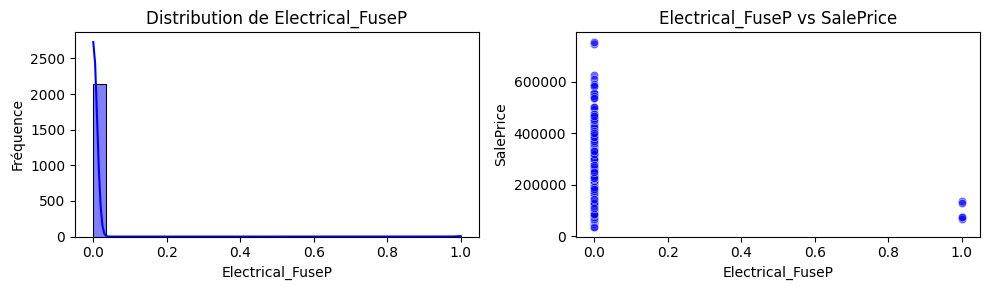

Electrical_Mix vs SalePrice : -0.03


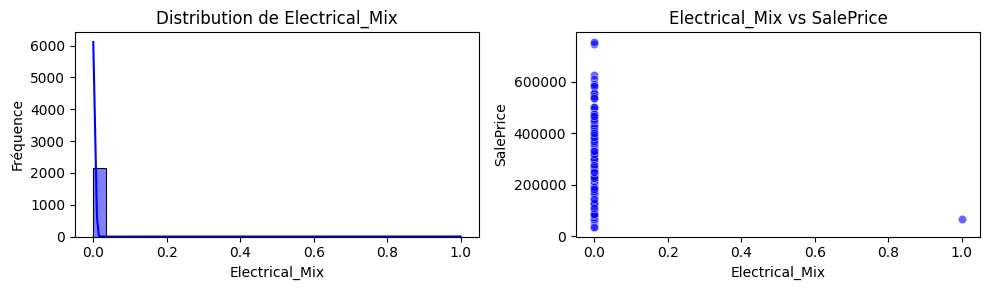

Electrical_SBrkr vs SalePrice : 0.23


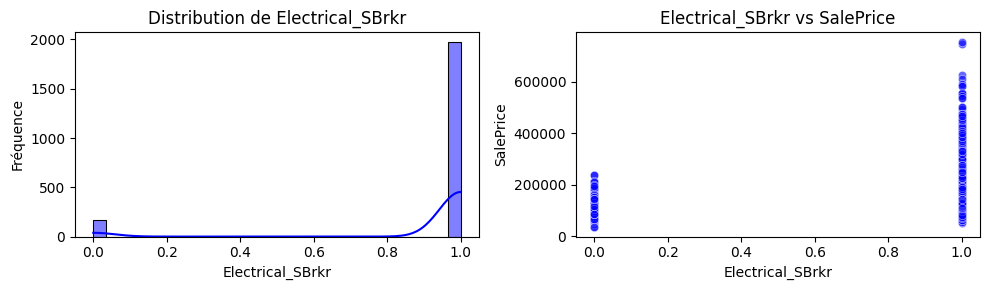

Kitchen Qual_Fa vs SalePrice : -0.12


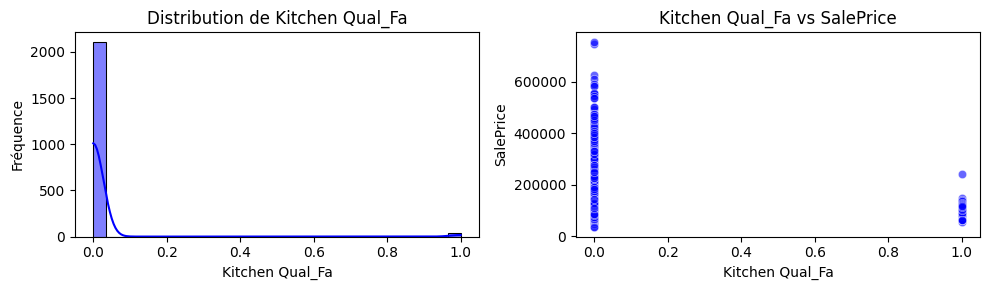

Kitchen Qual_Gd vs SalePrice : 0.29


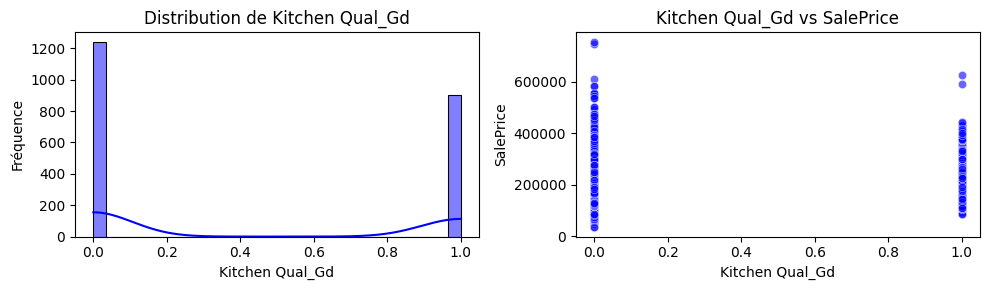

Kitchen Qual_Po vs SalePrice : -0.02


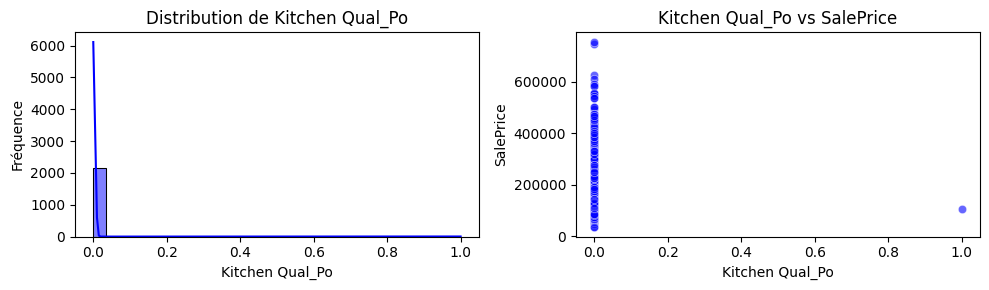

Kitchen Qual_TA vs SalePrice : -0.53


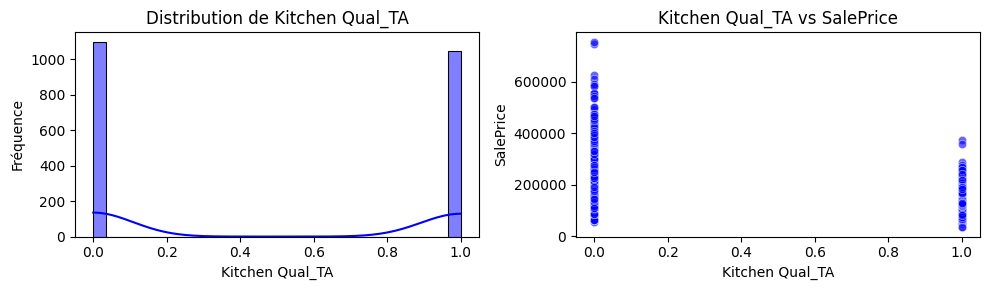

Functional_Maj2 vs SalePrice : -0.05


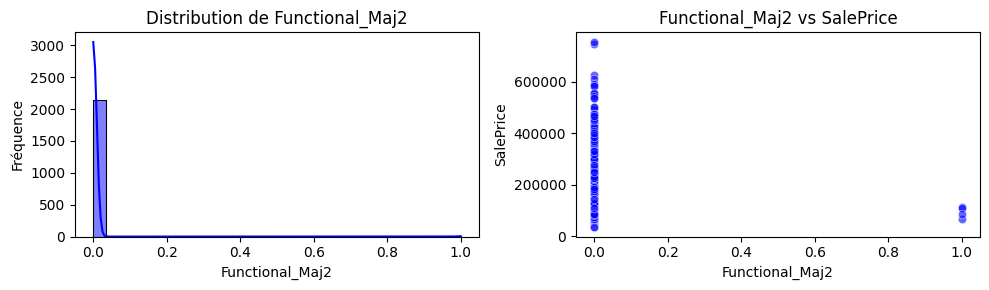

Functional_Min1 vs SalePrice : -0.05


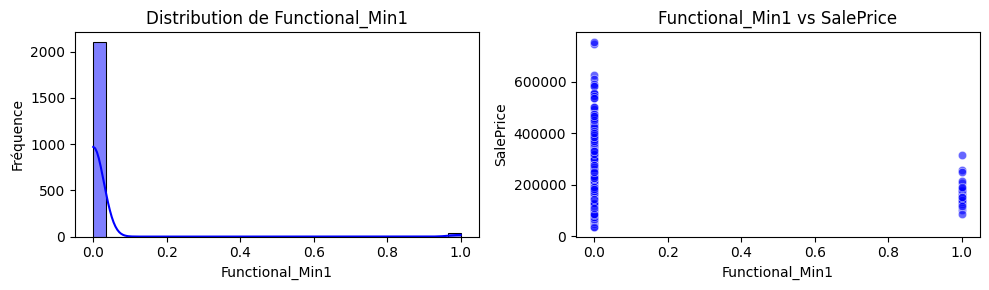

Functional_Min2 vs SalePrice : -0.05


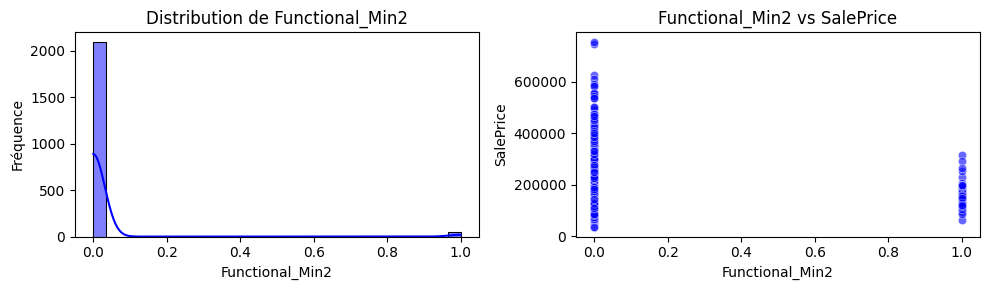

Functional_Mod vs SalePrice : -0.01


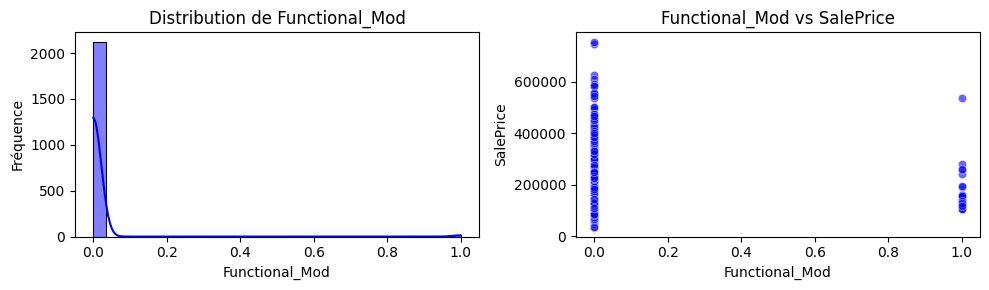

Functional_Sal vs SalePrice : -0.04


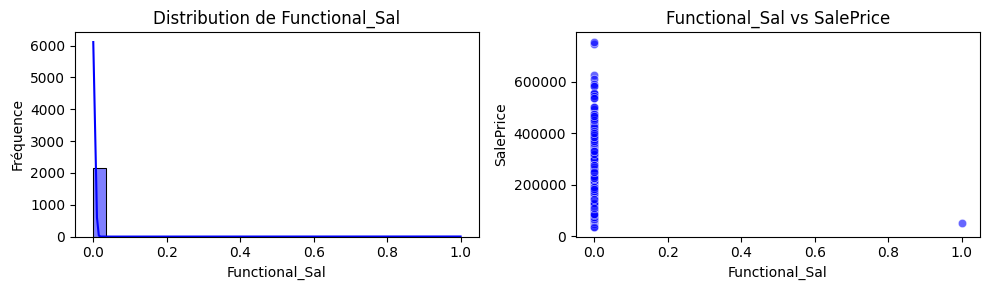

Functional_Sev vs SalePrice : -0.02


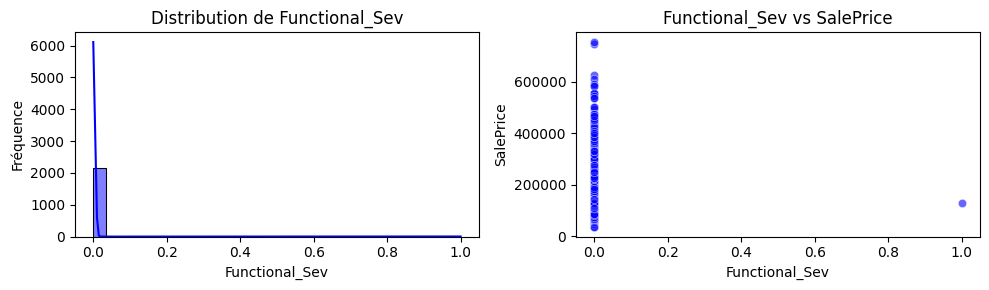

Functional_Typ vs SalePrice : 0.08


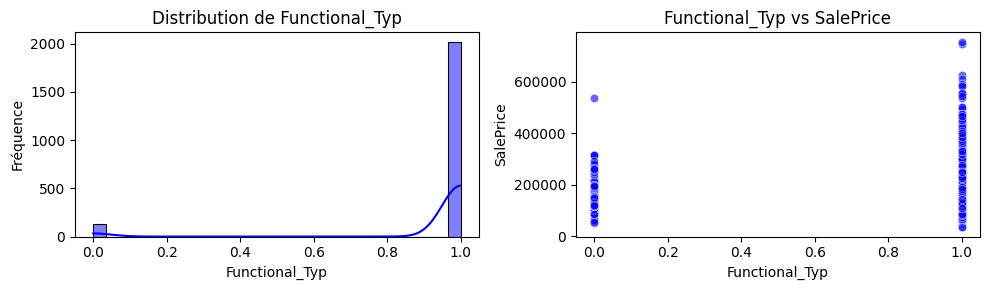

Garage Type_Attchd vs SalePrice : 0.29


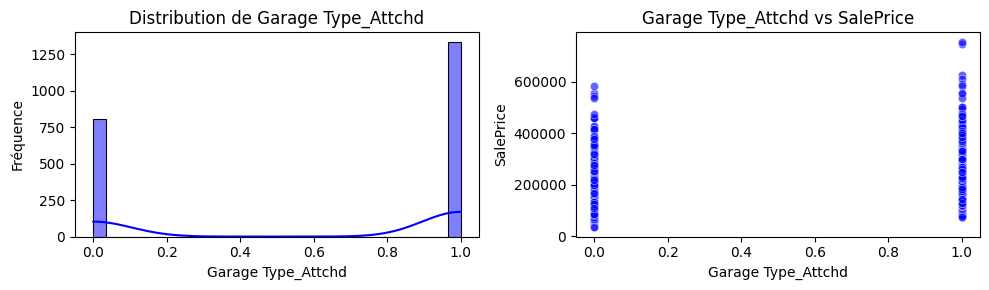

Garage Type_Basment vs SalePrice : -0.05


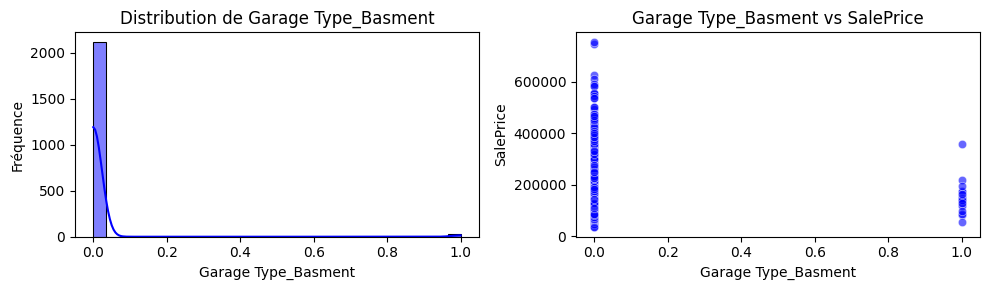

Garage Type_BuiltIn vs SalePrice : 0.22


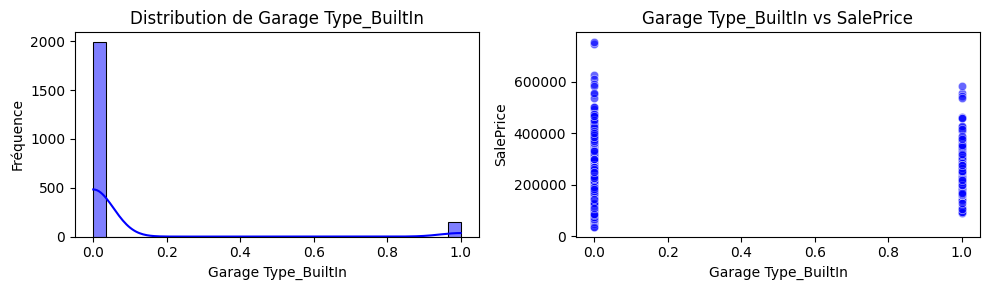

Garage Type_CarPort vs SalePrice : -0.07


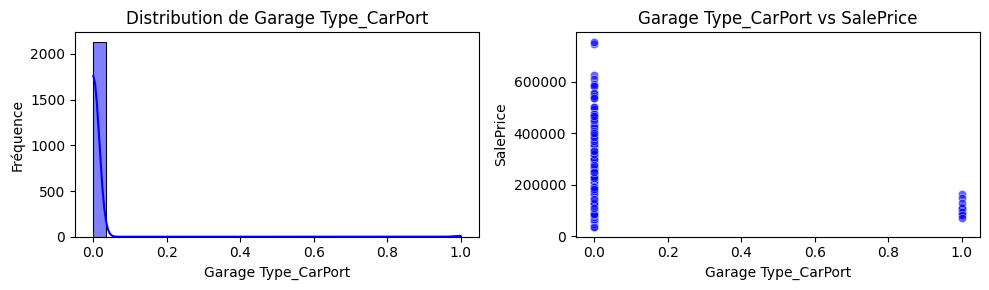

Garage Type_Detchd vs SalePrice : -0.41


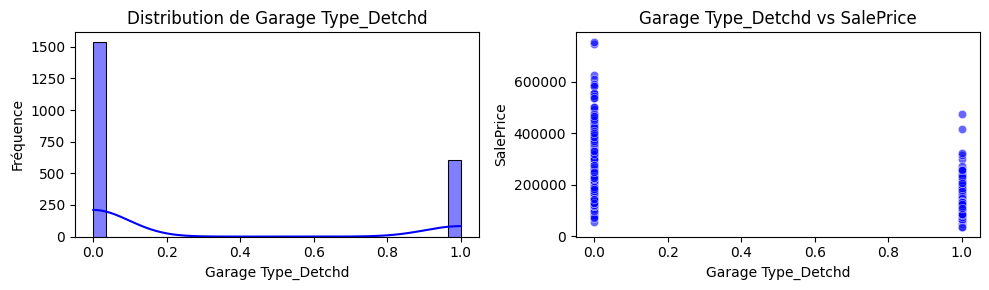

Garage Finish_RFn vs SalePrice : 0.15


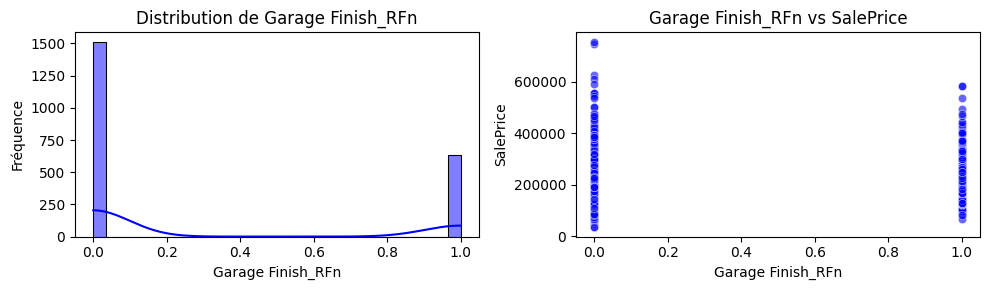

Garage Finish_Unf vs SalePrice : -0.50


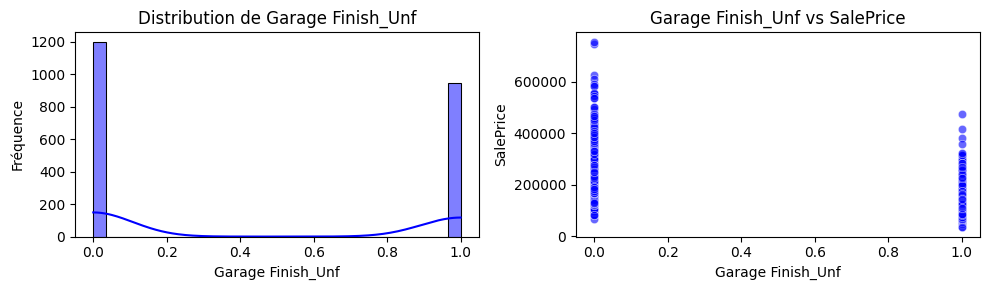

Garage Qual_Fa vs SalePrice : -0.19


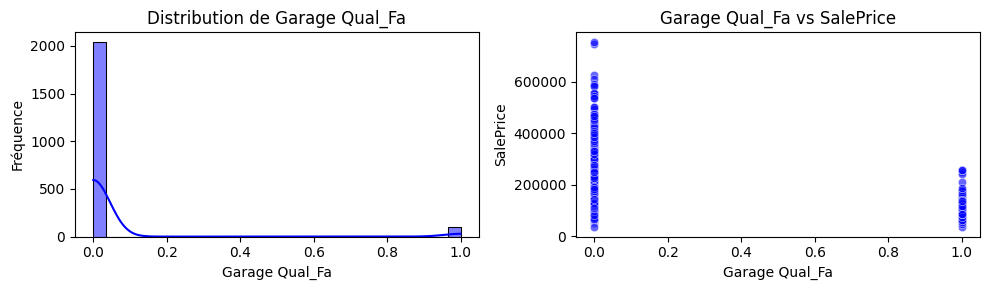

Garage Qual_Gd vs SalePrice : 0.09


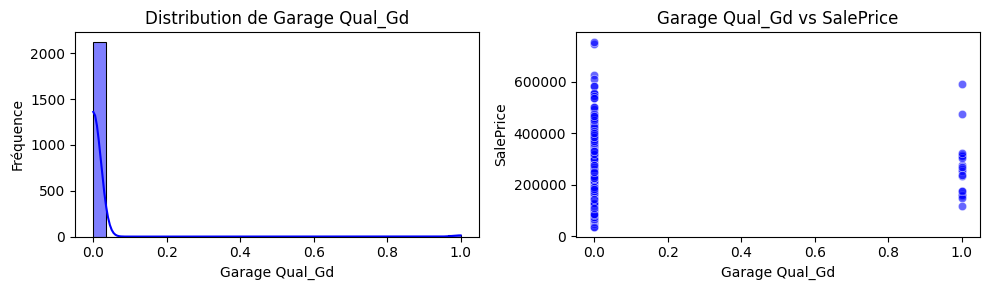

Garage Qual_Po vs SalePrice : -0.05


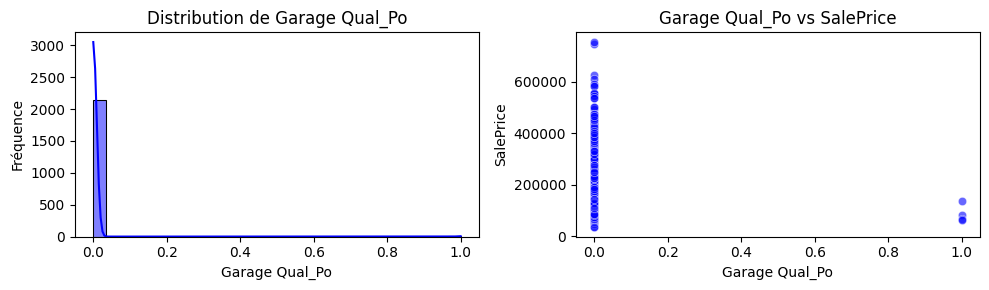

Garage Qual_TA vs SalePrice : 0.14


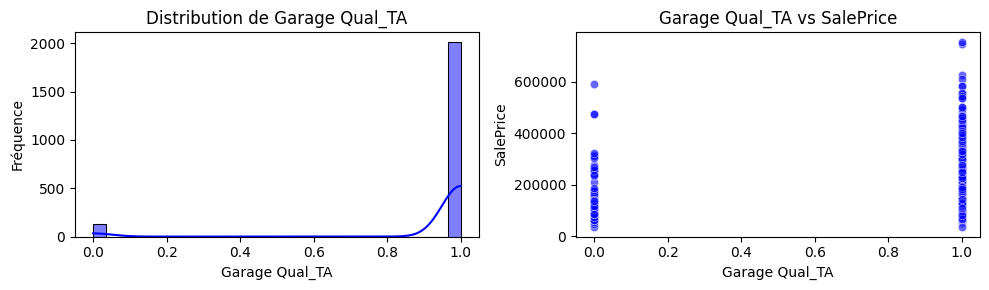

Garage Cond_Fa vs SalePrice : -0.15


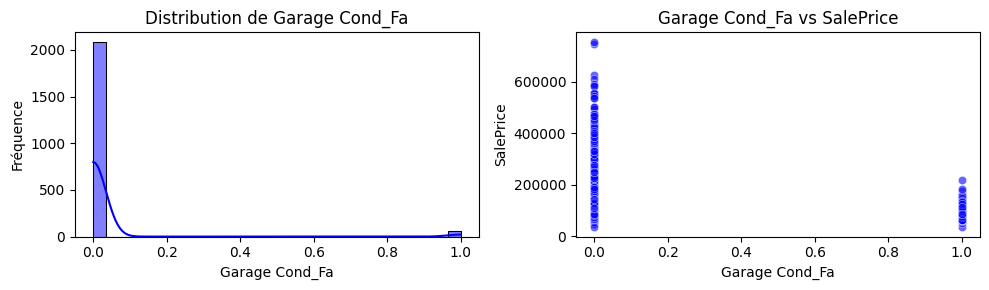

Garage Cond_Gd vs SalePrice : 0.01


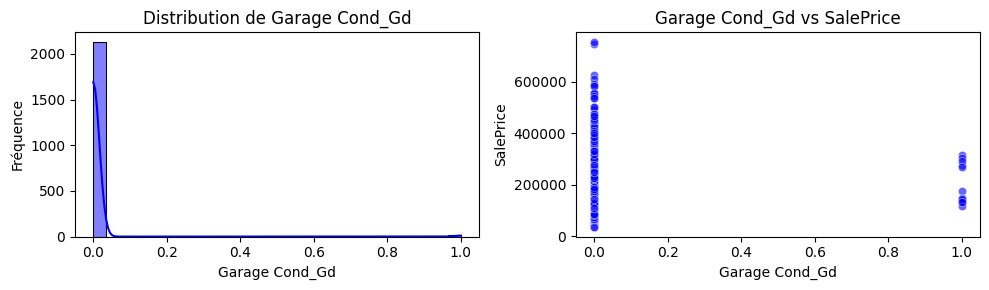

Garage Cond_Po vs SalePrice : -0.07


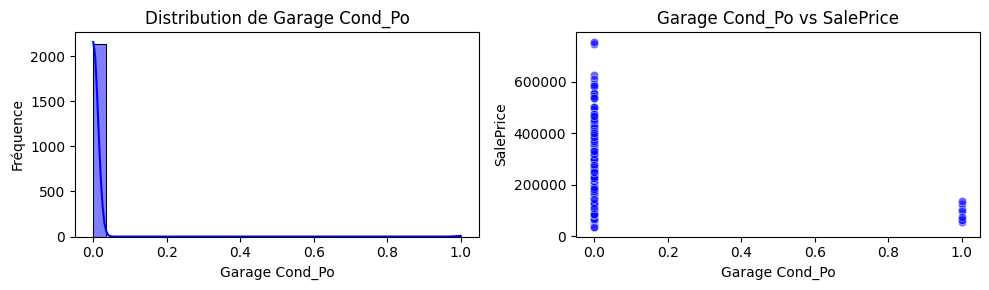

Garage Cond_TA vs SalePrice : 0.15


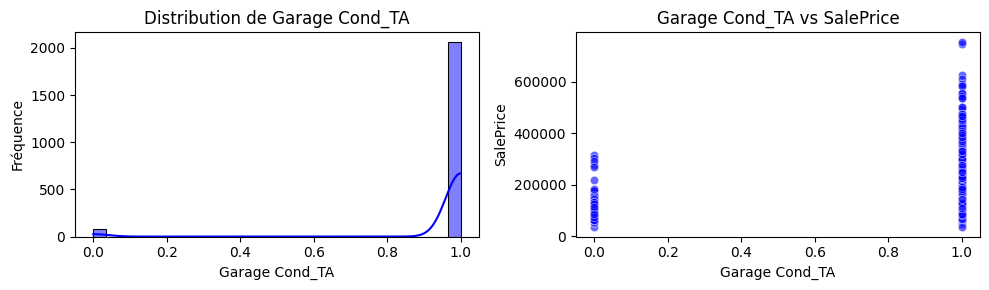

Paved Drive_P vs SalePrice : -0.09


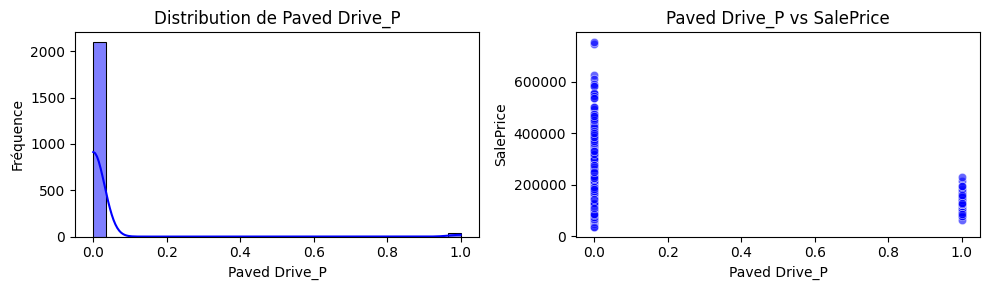

Paved Drive_Y vs SalePrice : 0.22


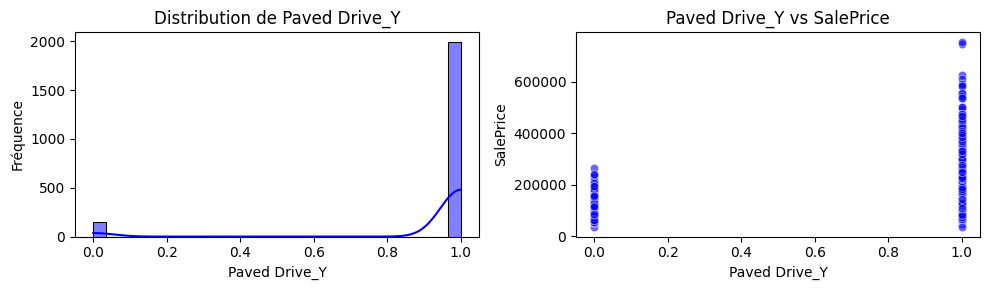

Sale Type_CWD vs SalePrice : 0.00


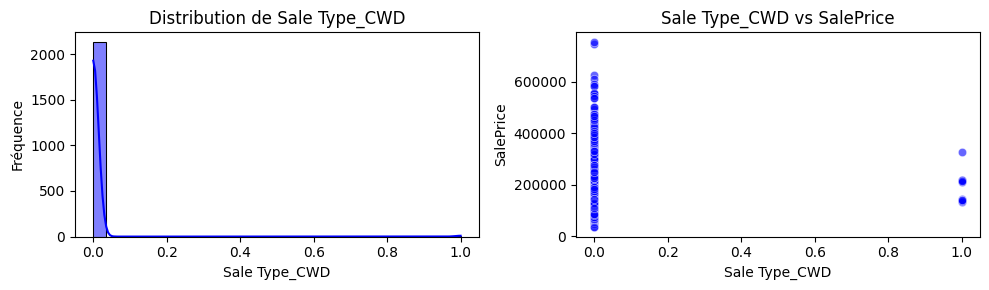

Sale Type_Con vs SalePrice : 0.03


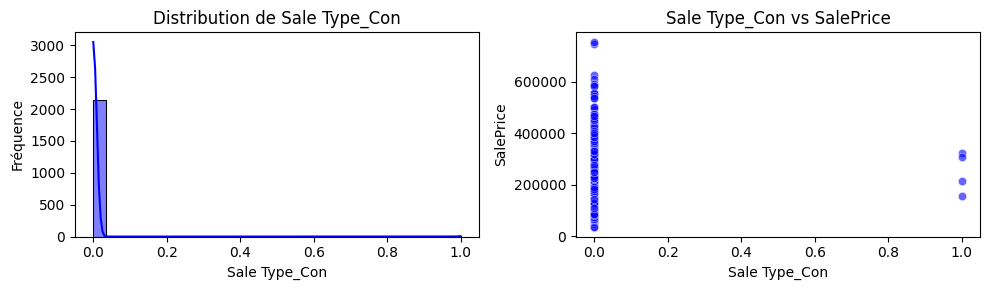

Sale Type_ConLD vs SalePrice : -0.05


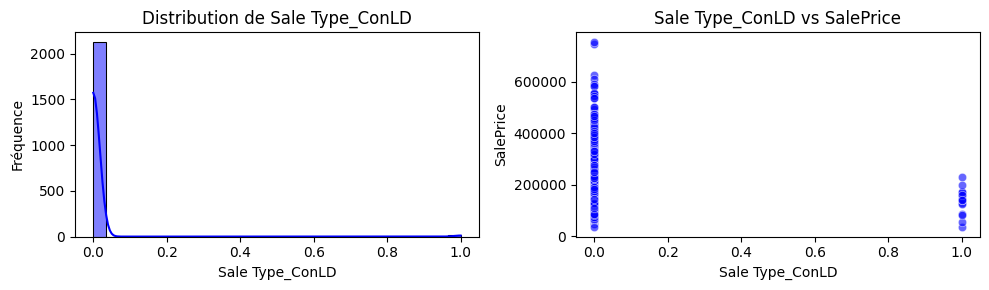

Sale Type_ConLI vs SalePrice : -0.03


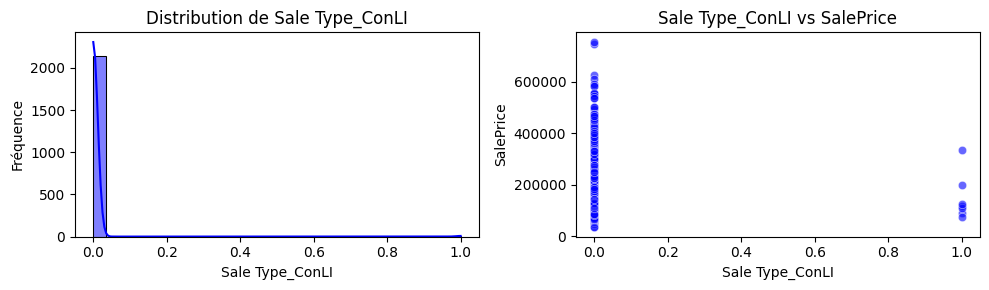

Sale Type_ConLw vs SalePrice : -0.03


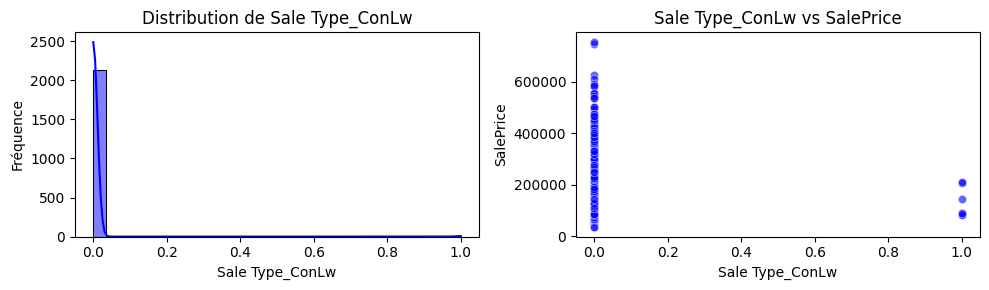

Sale Type_New vs SalePrice : 0.35


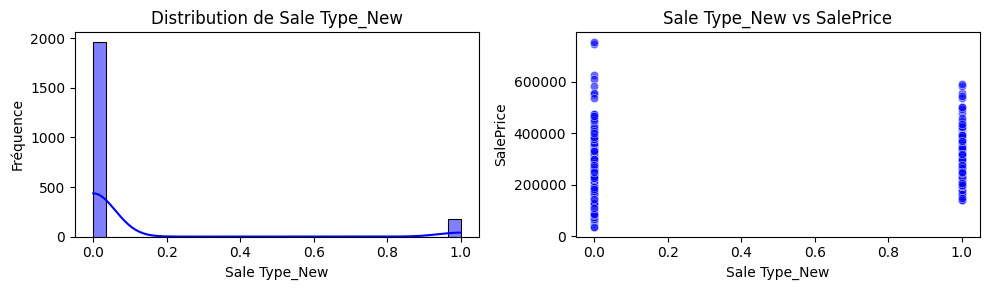

Sale Type_Oth vs SalePrice : -0.02


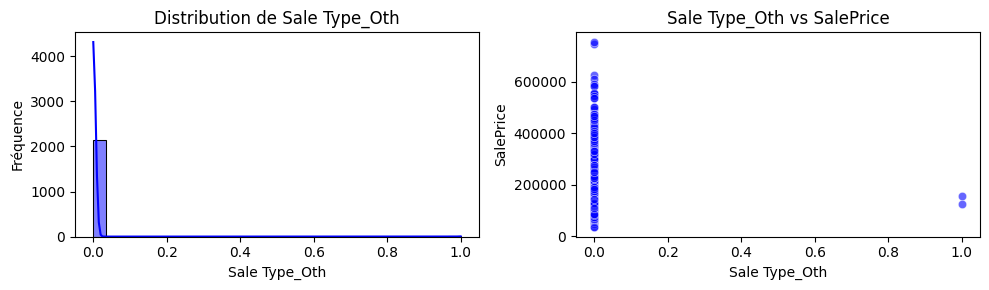

Sale Type_VWD vs SalePrice : -0.01


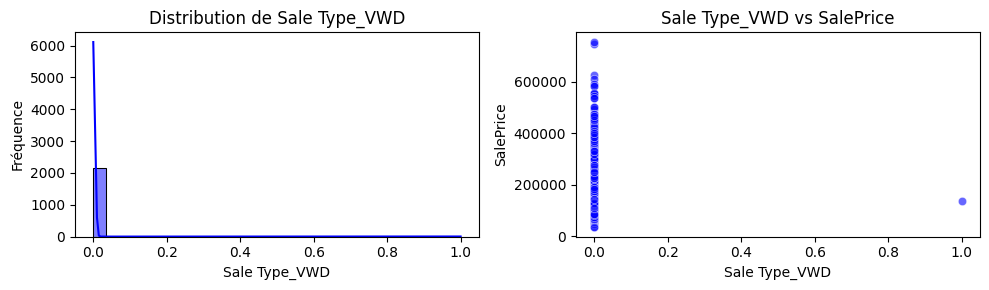

Sale Type_WD  vs SalePrice : -0.21


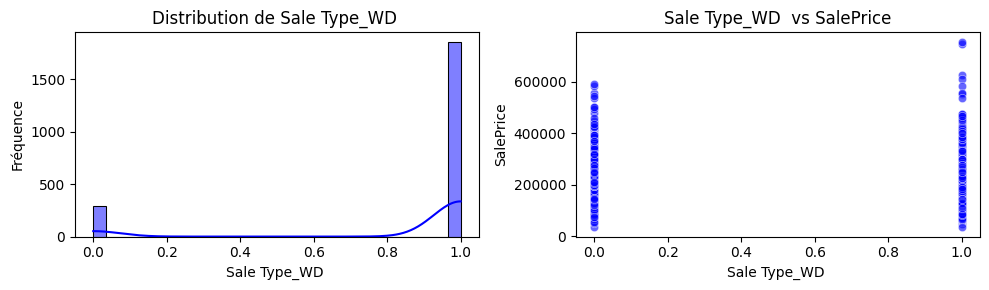

Sale Condition_AdjLand vs SalePrice : -0.04


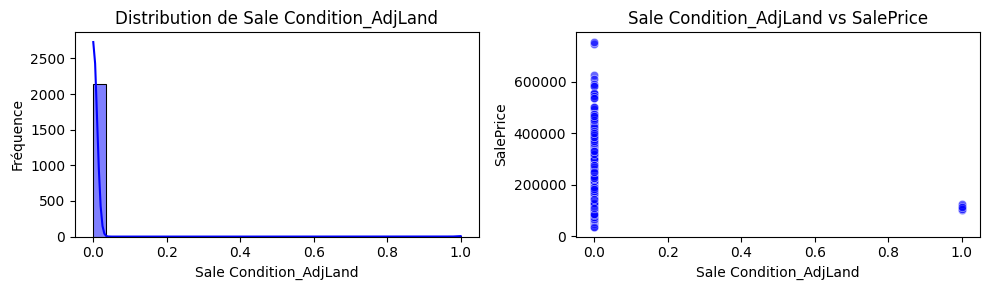

Sale Condition_Alloca vs SalePrice : -0.01


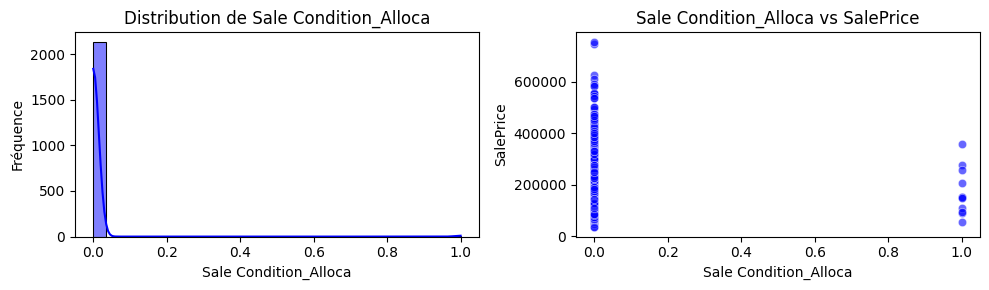

Sale Condition_Family vs SalePrice : -0.04


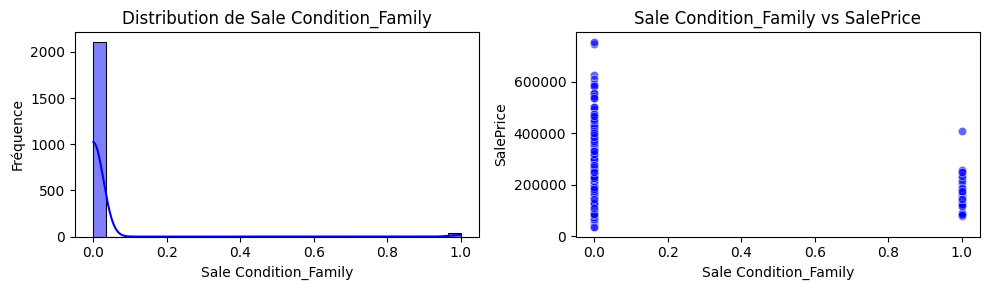

Sale Condition_Normal vs SalePrice : -0.17


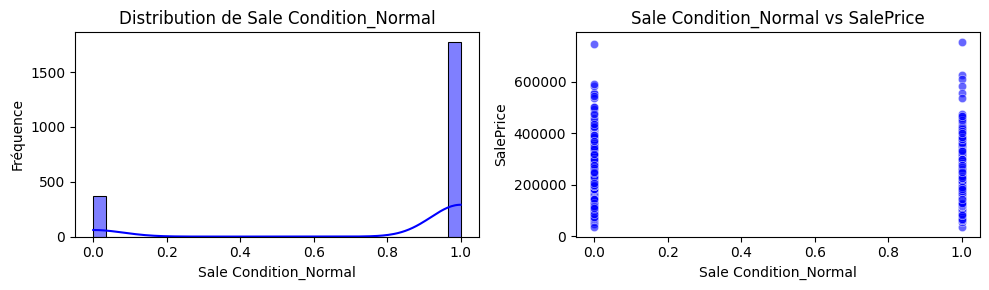

Sale Condition_Partial vs SalePrice : 0.35


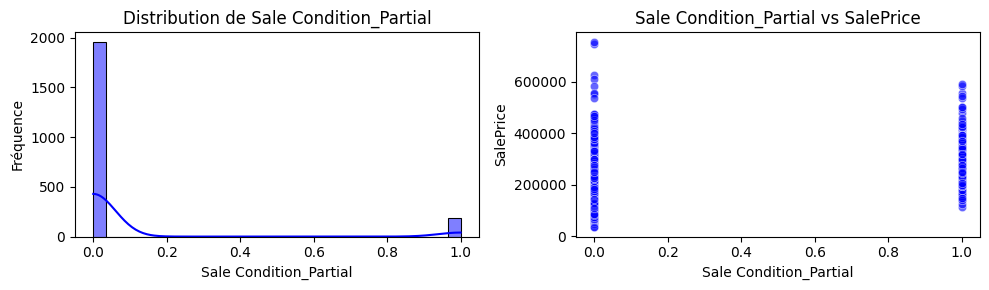

In [124]:
# Visualisation des variables
features = [col for col in data_train_reg.columns if col != 'SalePrice']
target = 'SalePrice'

for var in features:
    # Corrélation Variable~Cible
    corr_value = data_train_reg[[var, target]].corr().iloc[0, 1]
    print(f'{var} vs {target} : {corr_value:.2f}')

    # Figure : Hist+scatter
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 3))

    # Histogramme de la distribution de la variable
    sns.histplot(data_train_reg[var], ax=axes[0], kde=True, color='blue', bins=30)
    axes[0].set_title(f'Distribution de {var}', fontsize=12)
    axes[0].set_xlabel(var, fontsize=10)
    axes[0].set_ylabel('Fréquence', fontsize=10)
    
    # Nuage de points Variable~Cible
    sns.scatterplot(x=data_train_reg[var], y=data_train_reg[target], ax=axes[1], color='blue', alpha=0.6)
    axes[1].set_title(f'{var} vs {target}', fontsize=12)
    axes[1].set_xlabel(var, fontsize=10)
    axes[1].set_ylabel(target, fontsize=10)
    
    plt.tight_layout()
    plt.show()


In [125]:
# Calcul des corrélations avec la cible
correlations = data_train_reg.corr()
correlations = correlations['SalePrice'].sort_values(key=abs, ascending=False)
print(correlations)

SalePrice              1.000000
Overall Qual           0.795689
Gr Liv Area            0.728177
Garage Cars            0.647425
Garage Area            0.630009
                         ...   
Sale Type_CWD          0.001698
Condition 2_RRAe       0.000824
Condition 1_RRNn      -0.000610
Neighborhood_NWAmes   -0.000271
Roof Style_Mansard    -0.000014
Name: SalePrice, Length: 237, dtype: float64


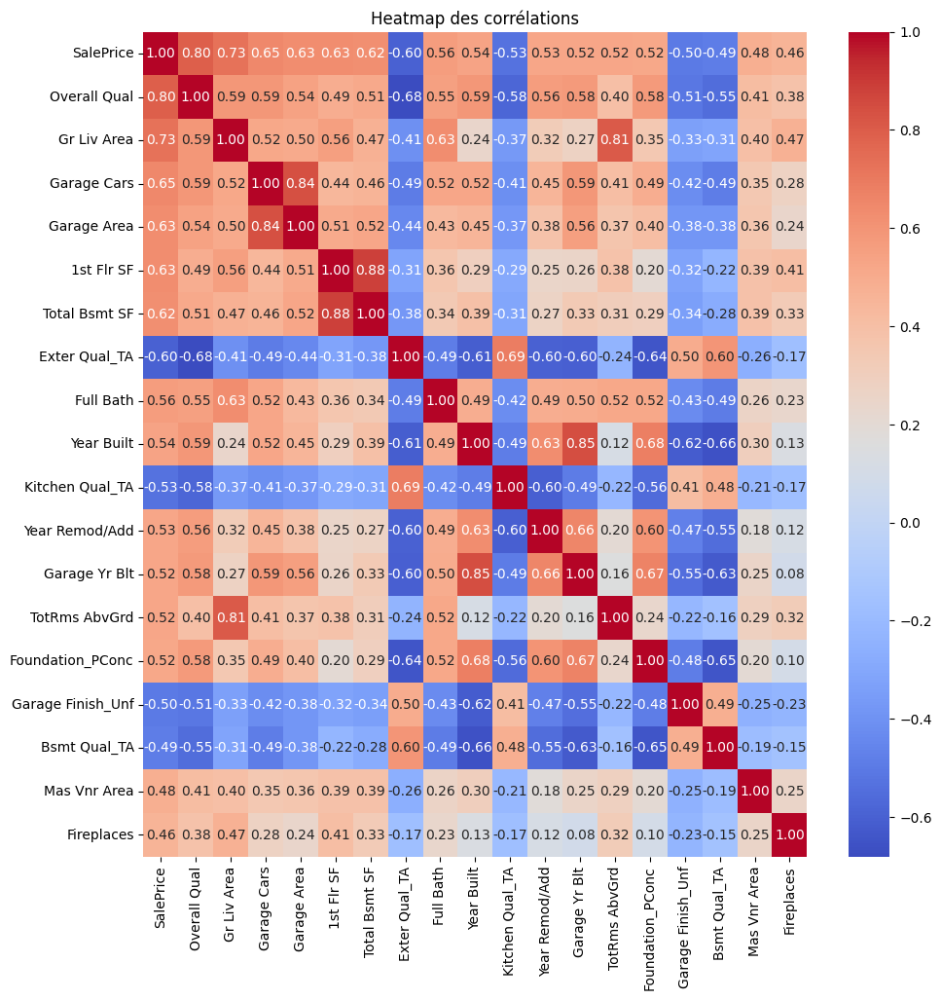

In [126]:
# Filtre des variables dont la corrélation avec SalePrice est sup à +/-0.6
correlations_filtered = correlations[correlations.abs() > 0.45]

# Extraire les noms des variables
variables_to_plot = correlations_filtered.index

# Créer une matrice de corrélation pour ces variables
correlation_matrix_filtered = data_train_reg[variables_to_plot].corr()

# Création de la heatmap
plt.figure(figsize=(11, 11))
sns.heatmap(correlation_matrix_filtered, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Heatmap des corrélations')
plt.show()

## Modèles de regression

### Regression linéaire

La régression linéaire est un modèle statistique qui cherche à établir une relation linéaire entre une ou plusieurs variables explicatives (X) et une variable cible continue (y). Son objectif est de trouver les coefficients qui minimisent l'erreur entre les prédictions et les valeurs réelles.  

En général, la régression linéaire fonctionne bien pour des problèmes où la relation entre les variables est approximativement linéaire et où les données ne présentent pas de complexité trop élevée (pas de relations non linéaires ou d'interactions complexes). Elle est simple, interprétable et rapide à entraîner, mais peut être limitée si les données ont une structure plus complexe.  

La formule du modèle est :  
$$ 
    y = \beta_0 + \beta_1 X_1 + \beta_2 X_2 + \dots + \beta_n X_n + \epsilon 
$$ 
où :  
- $ y $ est la variable cible,  
- $ \beta_0 $ est l'ordonnée à l'origine,  
- $ \beta_1, \beta_2, \dots, \beta_n $ sont les coefficients des variables explicatives $ X_1, X_2, \dots, X_n $,  
- $ \epsilon $ représente l'erreur résiduelle.

In [127]:
# Fitting du modèle
LR = LinearRegression()
start_time = time.time() # Démarrer le chronomètre
LR.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Prédiction et évaluation
y_LR = LR.predict(X_test)
R2_LR = r2_score(y_test_reg, y_LR)
R2_ajuste_LR = R2_ajuste(y_test_reg, y_LR, X_test)
RMSE_LR = np.sqrt(mean_squared_error(y_test_reg, y_LR))
time_LR = end_time - start_time

print("-- REGRESSION LINEAIRE --")
print(f"R2 : {R2_LR:.3f}")
print(f"R2 ajusté : {R2_ajuste_LR:.3f}")
print(f"RMSE : {RMSE_LR:.3f}")
print(f"Temps d'entraînement : {time_LR:.3f} secondes")

-- REGRESSION LINEAIRE --
R2 : 0.853
R2 ajusté : 0.737
RMSE : 29769.019
Temps d'entraînement : 0.053 secondes


-- COEFFICIENTS --


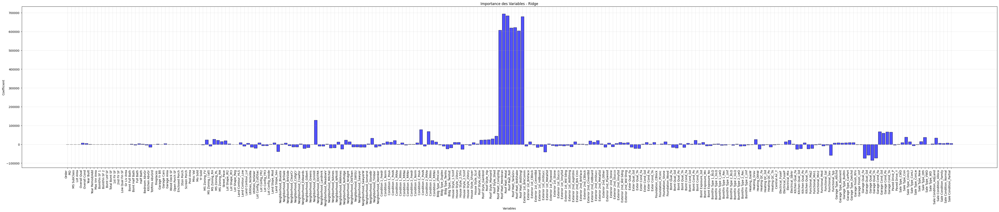

In [128]:
# Coefficients
coefs_LR = pd.Series(LR.coef_, index=X_train.columns)
print("-- COEFFICIENTS --")
# print(coefs_LR)

plt.figure(figsize=(60, 10))
plt.bar(X_train.columns, coefs_LR, color="blue", alpha=0.7, edgecolor="k")
plt.title("Importance des Variables - Ridge")
plt.xlabel("Variables")
plt.ylabel("Coefficient")
plt.xticks(rotation=90, ha="right")
plt.grid(alpha=0.3)
plt.show()

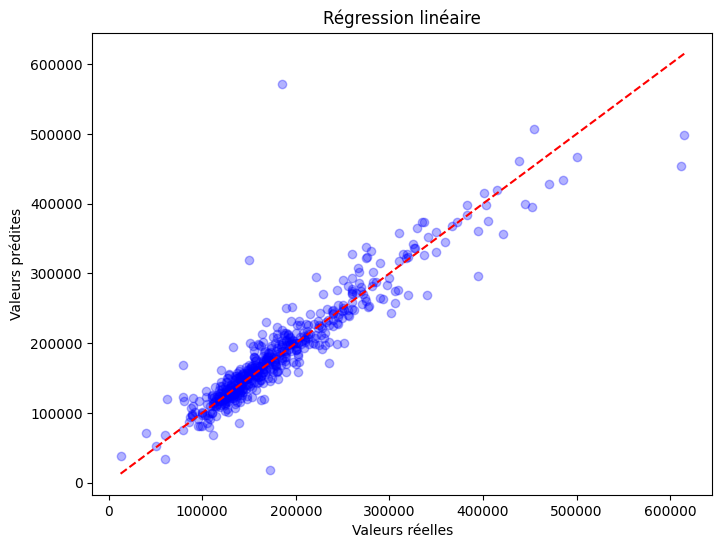

In [129]:
# Visualisation des prédictions
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_LR, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('Régression linéaire')
plt.show()

### Ridge

La régression Ridge est une extension de la régression linéaire qui intègre une régularisation $L2$ pour éviter le sur-ajustement. Elle ajoute une pénalité sur la magnitude des coefficients, contrôlée par un hyperparamètre $\alpha$. L'équation du modèle s'écrit :  

$$ y = \beta_0 + \beta_1 X_1 + \dots + \beta_n X_n + \alpha \sum_{i=1}^n \beta_i^2 $$  

Ici, plusieurs valeurs de $\alpha$ ont été testées ($[0.1, 1, 5, 10]$).

Ce modèle fonctionne particulièrement bien lorsque les données présentent une multicolinéarité ou un grand nombre de variables. Il réduit le risque de sur-ajustement tout en maintenant une bonne performance prédictive.

In [130]:
# Hyperparamètres à tester
alpha = [0.1, 1, 5, 10]

# Fitting du modèle avec le nouveau paramètre store_cv_results
Ridge = RidgeCV(alphas=alpha, store_cv_results=True)
start_time = time.time() # Démarrer le chronomètre
Ridge.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Meilleur alpha
print("-- RIDGE --")
print(f"Meilleur alpha : {Ridge.alpha_}\n")

# Prédiction et évaluation
y_Ridge = Ridge.predict(X_test)
R2_ridge = r2_score(y_test_reg, y_Ridge)
R2_ajuste_ridge = R2_ajuste(y_test_reg, y_Ridge, X_test)
RMSE_ridge = np.sqrt(mean_squared_error(y_test_reg, y_Ridge))
time_ridge = end_time - start_time

print(f"R2 : {R2_ridge:.3f}")
print(f"R2 ajusté : {R2_ajuste_ridge:.3f}")
print(f"RMSE : {RMSE_ridge:.3f}")
print(f"Temps d'entraînement : {time_ridge:.3f} secondes")

-- RIDGE --
Meilleur alpha : 5.0

R2 : -1555127.422
R2 ajusté : -2782586.645
RMSE : 96857312.130
Temps d'entraînement : 0.079 secondes


-- COEFFICIENTS RIDGE --


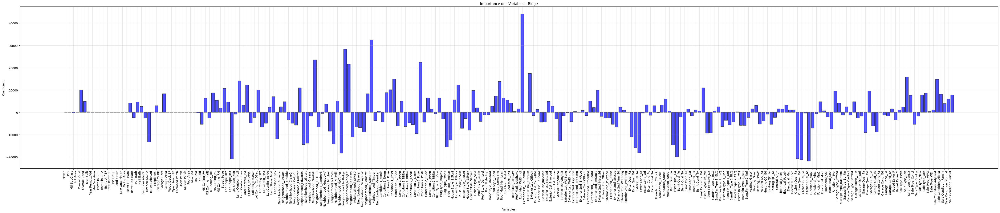

In [131]:
# Coefficients associés
coefs_ridge = pd.Series(Ridge.coef_, index=X_train.columns)
print("-- COEFFICIENTS RIDGE --")
# print(coefs_ridge)

plt.figure(figsize=(60, 10))
plt.bar(X_train.columns, coefs_ridge, color="blue", alpha=0.7, edgecolor="k")
plt.title("Importance des Variables - Ridge")
plt.xlabel("Variables")
plt.ylabel("Coefficient")
plt.xticks(rotation=90, ha="right")
plt.grid(alpha=0.3)
plt.show()

Le graphique illustre l'importance des variables dans le modèle de régression Ridge en affichant les coefficients associés à chaque variable. Contrairement au Lasso, Ridge ne réduit pas les coefficients à zéro, mais les pénalise pour éviter qu'ils ne deviennent trop grands, ce qui aide à gérer la multicolinéarité.

On observe que certaines variables ont des coefficients plus élevés, indiquant qu'elles ont une influence plus significative sur la prédiction. D'autres variables ont des coefficients plus faibles, ce qui suggère qu'elles contribuent moins à la prédiction.

Ces résultats mettent en évidence la capacité de Ridge à équilibrer l'importance des variables tout en maintenant une certaine stabilité dans le modèle. Cependant, il serait intéressant de comparer ces coefficients avec ceux d'autres modèles pour valider leur importance et leur robustesse.

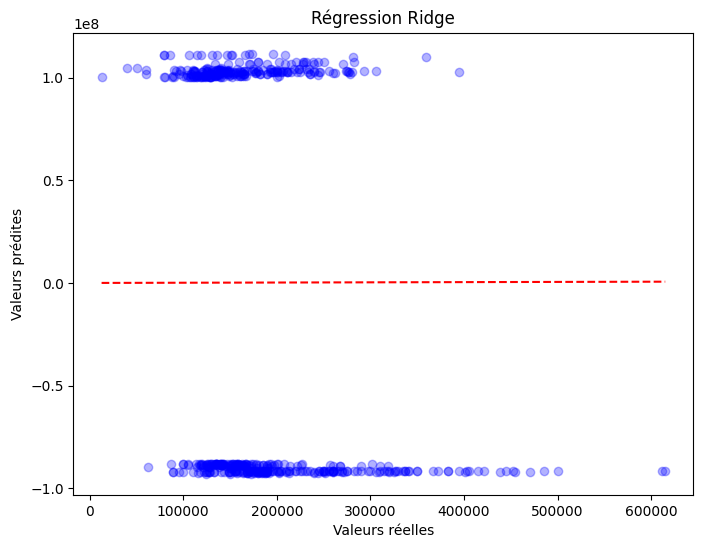

In [132]:
# Visualisation des prédictions Ridge
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_Ridge, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('Régression Ridge')
plt.show()

Ces résultats suggèrent que le modèle Ridge fonctionne raisonnablement bien pour ce jeu de données, en particulier grâce à la régularisation L2 qui aide à gérer la multicolinéarité et à réduire le surajustement. Cependant, il pourrait être amélioré en ajustant davantage l'hyperparamètre de régularisation ou en explorant d'autres modèles pour mieux capturer les relations complexes dans les données.

### Lasso

La régression Lasso est une variante de la régression linéaire qui utilise une régularisation $L1$ pour pénaliser la somme des valeurs absolues des coefficients. Cela a pour effet de réduire certains coefficients à zéro, permettant ainsi une sélection automatique des variables. L'équation du modèle est :  

$$ y = \beta_0 + \beta_1 X_1 + \dots + \beta_n X_n + \alpha \sum_{i=1}^n |\beta_i| $$  

Plusieurs valeurs de $\alpha$ ont été testées ($[0.1, 0.5, 1, 10, 25, 50, 75, 100]$).  

Ce modèle est particulièrement utile pour les jeux de données avec un grand nombre de variables, car il permet de simplifier le modèle en éliminant les variables non pertinentes.

In [133]:
# Hyperparamètres à tester
alpha = [0.1, 0.5, 1, 10, 25, 50, 75, 100]

# Fitting du modèle
Lasso = LassoCV(alphas=alpha, max_iter=15000, random_state=rs)
start_time = time.time() # Démarrer le chronomètre
Lasso.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Meilleur alpha
print("-- LASSO --")
print(f"Meilleur alpha : {Lasso.alpha_}\n")

# Prédiction et évaluation
y_lasso = Lasso.predict(X_test)
R2_lasso = r2_score(y_test_reg, y_lasso)
R2_ajuste_lasso = R2_ajuste(y_test_reg, y_lasso, X_test)
RMSE_lasso = np.sqrt(mean_squared_error(y_test_reg, y_lasso))
time_lasso = end_time - start_time

print(f"R2 : {R2_lasso:.3f}")
print(f"R2 ajusté : {R2_ajuste_lasso:.3f}")
print(f"RMSE : {RMSE_lasso:.3f}")
print(f"Temps d'entraînement : {time_lasso:.3f} secondes")

-- LASSO --
Meilleur alpha : 50.0

R2 : 0.854
R2 ajusté : 0.739
RMSE : 29660.891
Temps d'entraînement : 3.500 secondes


-- COEFFICIENTS LASSO --


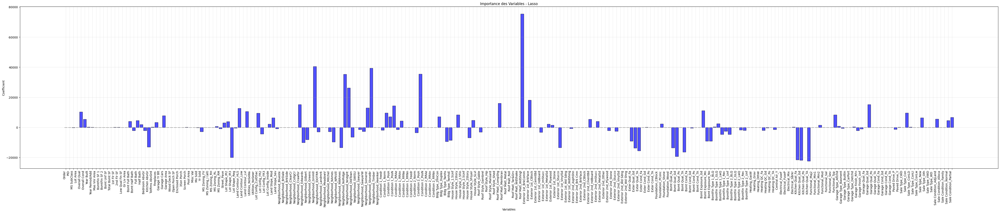

In [134]:
# Coefficients
coefs_lasso = pd.Series(Lasso.coef_, index=X_train.columns)
print("-- COEFFICIENTS LASSO --")
# print(coefs_lasso)

plt.figure(figsize=(60, 10))
plt.bar(X_train.columns, coefs_lasso, color="blue", alpha=0.7, edgecolor="k")
plt.title("Importance des Variables - Lasso")
plt.xlabel("Variables")
plt.ylabel("Coefficient")
plt.xticks(rotation=90, ha="right")
plt.grid(alpha=0.3)
plt.show()


Le graphique illustre l'importance des variables dans le modèle de régression Lasso en affichant les coefficients associés à chaque variable. Les coefficients non nuls indiquent les variables que le modèle a jugées importantes pour la prédiction, tandis que les coefficients nuls correspondent aux variables éliminées par la régularisation L1.

On observe que certaines variables ont des coefficients significatifs, ce qui suggère qu'elles jouent un rôle clé dans la prédiction. D'autres variables ont des coefficients nuls ou proches de zéro, indiquant qu'elles ont été pénalisées par le modèle et ne contribuent pas significativement à la prédiction.

Ces résultats mettent en évidence la capacité du Lasso à sélectionner automatiquement les variables les plus pertinentes, ce qui peut simplifier l'interprétation du modèle et réduire le risque de surajustement. Cependant, il serait intéressant de comparer ces coefficients avec ceux d'autres modèles pour valider leur importance et leur stabilité.

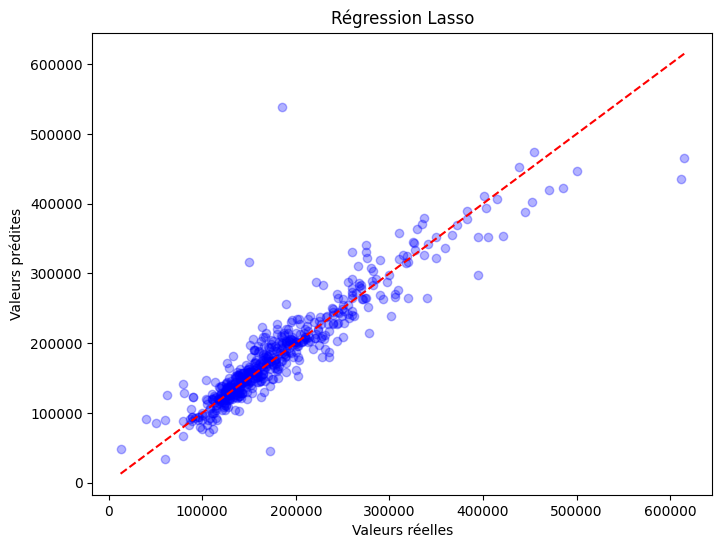

In [135]:
# Visualisation des prédictions Lasso
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_lasso, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('Régression Lasso')
plt.show()


Ces résultats suggèrent que le modèle Lasso fonctionne raisonnablement bien pour ce jeu de données, en particulier en réduisant la complexité du modèle grâce à la régularisation L1. Cependant, il pourrait être amélioré en ajustant davantage l'hyperparamètre de régularisation ou en explorant d'autres modèles pour mieux capturer les relations complexes dans les données.

### Arbre de décision

L'arbre de décision pour la régression est un modèle non paramétrique qui divise récursivement l'espace des données en sous-ensembles homogènes en fonction des variables explicatives. Chaque division est choisie pour minimiser l'erreur de prédiction, ce qui permet de créer une structure arborescente où chaque feuille représente une prédiction.  

Ce modèle est intuitif et facile à interpréter, mais il a tendance à surajuster les données d'entraînement s'il n'est pas régularisé. Il fonctionne bien pour des données avec des relations non linéaires ou des interactions complexes entre les variables.  

In [136]:
# Création et entraînement du modèle
Tree_reg = DecisionTreeRegressor(random_state=rs)
start_time = time.time() # Démarrer le chronomètre
Tree_reg.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Prédiction et évaluation
y_tree = Tree_reg.predict(X_test)
R2_tree = r2_score(y_test_reg, y_tree)
R2_ajuste_tree = R2_ajuste(y_test_reg, y_tree, X_test)
RMSE_tree = np.sqrt(mean_squared_error(y_test_reg, y_tree))
time_tree = end_time - start_time

print("-- ARBRE DE DECISION --")
print(f"R2 : {R2_tree:.3f}")
print(f"R2 ajusté : {R2_ajuste_tree:.3f}")
print(f"RMSE : {RMSE_tree:.3f}")
print(f"Temps d'entraînement : {time_tree:.3f} secondes")

-- ARBRE DE DECISION --
R2 : 0.781
R2 ajusté : 0.608
RMSE : 36335.884
Temps d'entraînement : 0.075 secondes


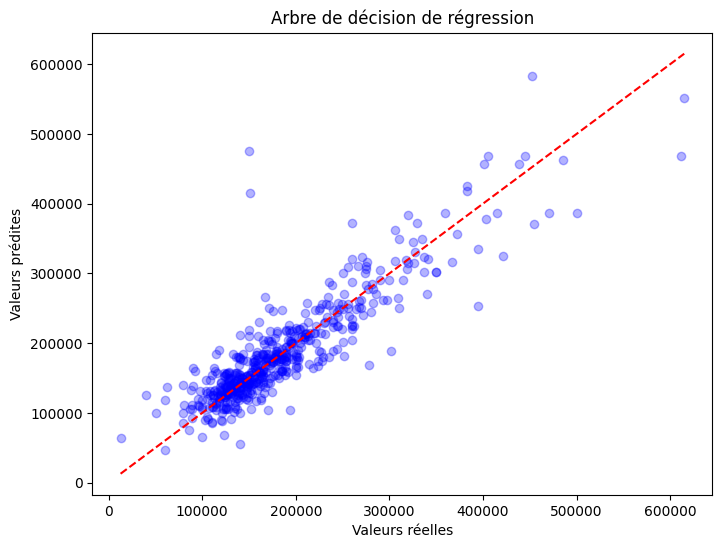

In [137]:
# Visualisation des prédictions
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_tree, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('Arbre de décision de régression')
plt.show()

Ces résultats suggèrent que le modèle d'arbre de décision fonctionne raisonnablement bien pour ce jeu de données, mais il pourrait être amélioré en ajustant des hyperparamètres tels que la profondeur maximale de l'arbre pour éviter le surajustement. Il serait également intéressant de comparer ces résultats avec d'autres modèles pour évaluer si l'arbre de décision est le meilleur choix pour cette tâche.

### K plus proches voisins

Le modèle K-Nearest Neighbors (KNN) pour la régression est un algorithme non paramétrique qui prédit la valeur de la variable cible en calculant la moyenne des $k$ plus proches voisins dans l'espace des variables explicatives. Ici, $k$ est fixé à 3, ce qui signifie que les prédictions sont basées sur les 3 observations les plus similaires dans l'ensemble d'entraînement.  

Ce modèle est simple et flexible, mais il peut être sensible à la dimensionnalité des données et à l'échelle des variables. Il fonctionne bien pour des jeux de données de petite à moyenne taille où les relations locales entre les variables sont importantes.

In [138]:
# Création et entraînement du modèle
knn_reg = KNeighborsRegressor(n_neighbors=3)
start_time = time.time() # Démarrer le chronomètre
knn_reg.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Prédiction et évaluation
y_knn = knn_reg.predict(X_test)
R2_knn = r2_score(y_test_reg, y_knn)
R2_ajuste_knn = R2_ajuste(y_test_reg, y_knn, X_test)
RMSE_knn = np.sqrt(mean_squared_error(y_test_reg, y_knn))
time_knn = end_time - start_time

print("-- K PLUS PROCHES VOISINS --")
print(f"R2 : {R2_knn:.3f}")
print(f"R2 ajusté : {R2_ajuste_knn:.3f}")
print(f"RMSE : {RMSE_knn:.3f}")
print(f"Temps d'entraînement : {time_knn:.3f} secondes")

-- K PLUS PROCHES VOISINS --
R2 : 0.707
R2 ajusté : 0.476
RMSE : 42019.995
Temps d'entraînement : 0.007 secondes


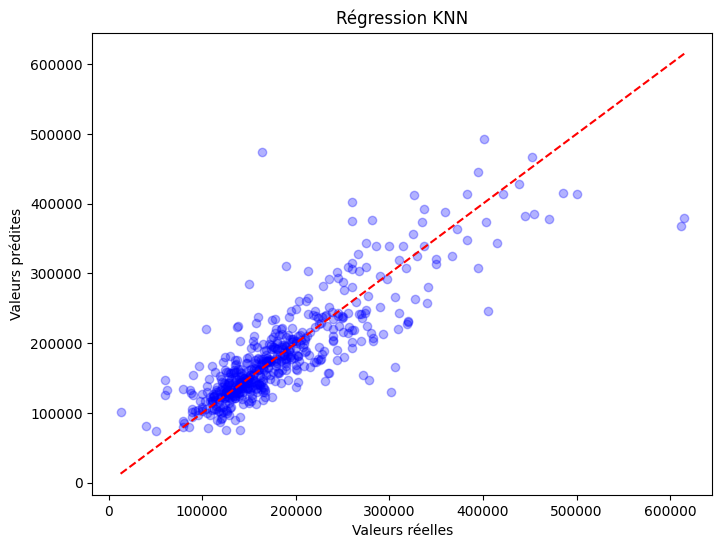

In [139]:
# Visualisation des prédictions
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_knn, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('Régression KNN')
plt.show()

Ces résultats suggèrent que le modèle KNN fonctionne raisonnablement bien pour ce jeu de données, mais il pourrait être amélioré en ajustant le nombre de voisins (k) ou en normalisant les variables pour de meilleures performances. Il serait également intéressant de comparer ces résultats avec d'autres modèles pour évaluer si KNN est le meilleur choix pour cette tâche.

### Machine à vecteurs de support

Le modèle de Support Vector Regression (SVR) est une méthode puissante pour la régression, basée sur les machines à vecteurs de support. Il cherche à trouver une fonction qui maximise la marge tout en minimisant l'erreur de prédiction. Ici, nous utilisons un noyau RBF (Radial Basis Function), qui est flexible et adapté à des données non linéaires.  

Étant donné la complexité et le coût computationnel des SVM, nous avons limité la recherche d'hyperparamètres à $C = 1000$ (contrôle du compromis entre la marge et l'erreur) et testé différentes valeurs de $\gamma$ ($[0.01, 0.1, 1]$) pour ajuster l'influence des points individuels.

In [140]:
# Définition de la grille d'hyperparamètres
param_grid = {
    'C': [1000],
    'gamma': [0.01, 0.1, 1],
    'kernel': ['rbf']
}

# Recherche des meilleurs hyperparamètres
grid_search = GridSearchCV(SVR(), param_grid, cv=5, scoring='r2')  # Utilisation de SVR() directement
start_time = time.time()  # Démarrer le chronomètre
grid_search.fit(X_train, y_train_reg)
end_time = time.time()  # Arrêter le chronomètre

# Meilleurs hyperparamètres trouvés
print(f"Meilleurs hyperparamètres : {grid_search.best_params_}")

# Utilisation du meilleur modèle
svr_model = grid_search.best_estimator_  # Utilisation d'un nom différent pour le modèle
svr_model.fit(X_train, y_train_reg)

# Prédiction et évaluation
y_svr = svr_model.predict(X_test)
R2_svr = r2_score(y_test_reg, y_svr)
R2_ajuste_svr = R2_ajuste(y_test_reg, y_svr, X_test)  # Assure-toi que la fonction R2_ajuste est définie
RMSE_svr = np.sqrt(mean_squared_error(y_test_reg, y_svr))
time_svr = end_time - start_time

# Résultats
print("-- SVM REGRESSION --")
print(f"R2 : {R2_svr:.3f}")
print(f"R2 ajusté : {R2_ajuste_svr:.3f}")
print(f"RMSE : {RMSE_svr:.3f}")
print(f"Temps d'entraînement : {time_svr:.3f} secondes")

Meilleurs hyperparamètres : {'C': 1000, 'gamma': 0.1, 'kernel': 'rbf'}
-- SVM REGRESSION --
R2 : -0.046
R2 ajusté : -0.871
RMSE : 79424.098
Temps d'entraînement : 9.707 secondes


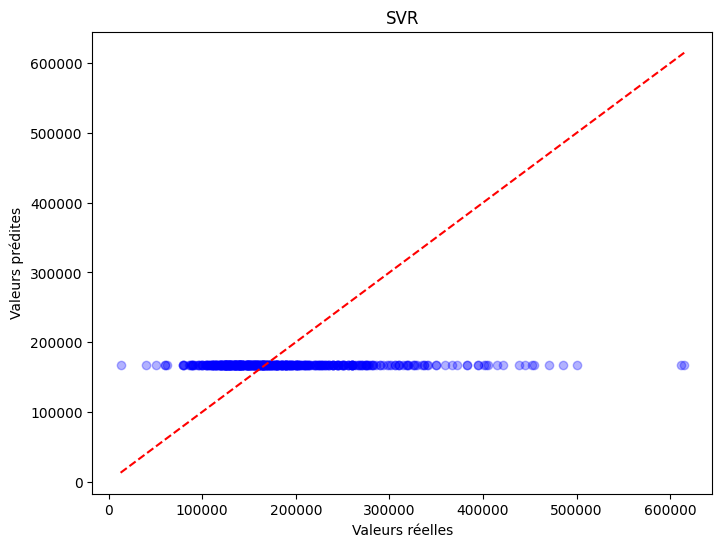

In [141]:
# Visualisation des prédictions SVR
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_svr, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('SVR')
plt.show()

Le graphique suggère que le modèle SVR a du mal à capturer parfaitement la variabilité des données, surtout pour les valeurs extrêmes. Cela pourrait être dû à la complexité des relations dans les données ou aux limites du choix des hyperparamètres. Il serait intéressant d'explorer d'autres modèles ou d'ajuster davantage les hyperparamètres pour améliorer la précision des prédictions, en particulier pour les valeurs plus élevées.

### Adaboost

Le modèle AdaBoost (Adaptive Boosting) est une méthode d'ensemble qui combine plusieurs modèles faibles (généralement des arbres de décision) pour créer un modèle plus robuste. Il ajuste les poids des observations mal prédites à chaque itération, permettant au modèle de se concentrer sur les cas difficiles.  

Une recherche par grille a été effectuée pour optimiser deux hyperparamètres clés :  
- `n_estimators` : le nombre de modèles faibles à combiner ($[100, 200, 300]$).  
- `learning_rate` : le taux d'apprentissage, qui contrôle la contribution de chaque modèle ($[0.001, 0.1, 0.5, 1]$).  

In [142]:
# Définir la grille d'hyperparamètres
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.001, 0.1, 0.5, 1]
}

# Utiliser GridSearchCV pour trouver les meilleurs hyperparamètres
grid_search = GridSearchCV(estimator=AdaBoostRegressor(random_state=rs), param_grid=param_grid, cv=5, scoring='r2')
start_time = time.time() # Démarrer le chronomètre
grid_search.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Afficher les meilleurs hyperparamètres
print("-- ADA BOOST --")
print(f"Meilleurs paramètres : {grid_search.best_params_}")

# Utiliser les meilleurs hyperparamètres pour le modèle final
ADA = grid_search.best_estimator_

# Prédiction et évaluation
y_ada = ADA.predict(X_test)
R2_ada = r2_score(y_test_reg, y_ada)
R2_ajuste_ada = R2_ajuste(y_test_reg, y_ada, X_test)
RMSE_ada = np.sqrt(mean_squared_error(y_test_reg, y_ada))
time_ada = end_time - start_time

print(f"R2 : {R2_ada:.3f}")
print(f"R2 ajusté : {R2_ajuste_ada:.3f}")
print(f"RMSE : {RMSE_ada:.3f}")
print(f"Temps d'exécution : {time_ada:.3f} secondes")

-- ADA BOOST --
Meilleurs paramètres : {'learning_rate': 0.1, 'n_estimators': 200}
R2 : 0.834
R2 ajusté : 0.703
RMSE : 31630.632
Temps d'exécution : 151.725 secondes


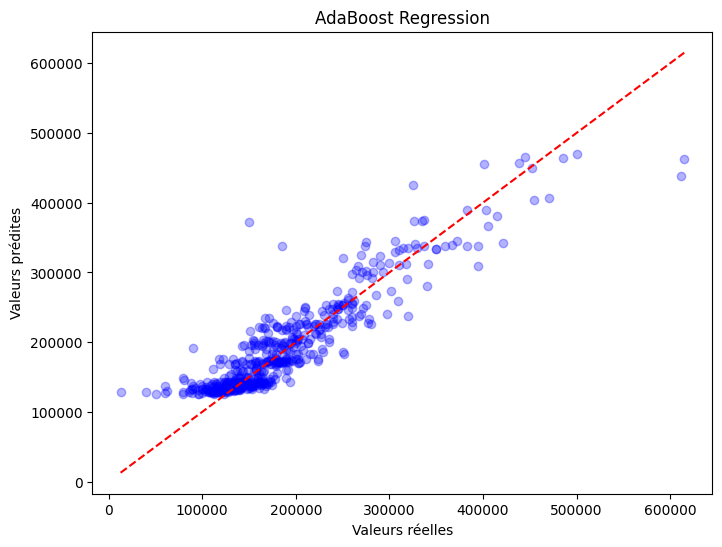

In [143]:
# Affichage des prédictions contre les valeurs réelles
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_ada, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('AdaBoost Regression')
plt.show()

Ces résultats suggèrent que le modèle AdaBoost fonctionne raisonnablement bien pour ce jeu de données, en particulier grâce à sa capacité à combiner plusieurs modèles faibles pour améliorer la performance globale. Cependant, il pourrait être amélioré en ajustant davantage les hyperparamètres, tels que le nombre d'estimateurs ou le taux d'apprentissage, pour mieux capturer les relations complexes dans les données. Il serait également intéressant de comparer ces résultats avec d'autres modèles d'ensemble pour évaluer si AdaBoost est le meilleur choix pour cette tâche.

### Gradient boosting

Le modèle de Gradient Boosting est une méthode d'ensemble puissante qui construit séquentiellement des arbres de décision, chaque arbre corrigeant les erreurs résiduelles du précédent. Il est particulièrement efficace pour capturer des relations complexes et non linéaires dans les données.  

Une recherche par grille a été effectuée pour optimiser trois hyperparamètres clés :  
- `n_estimators` : le nombre d'arbres à construire ($[100, 250, 500]$).  
- `learning_rate` : le taux d'apprentissage, qui contrôle la contribution de chaque arbre ($[0.01, 0.1, 0.5]$).  
- `max_depth` : la profondeur maximale de chaque arbre ($[1, 3, 5]$).  

In [144]:
# Définir la grille d'hyperparamètres
param_grid = {
    'n_estimators': [100, 250, 500],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [1, 3, 5]
}

# Utiliser GridSearchCV pour trouver les meilleurs hyperparamètres
grid_search = GridSearchCV(estimator=GradientBoostingRegressor(random_state=rs), param_grid=param_grid, cv=5, scoring='r2')
start_time = time.time() # Démarrer le chronomètre
grid_search.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Afficher les meilleurs hyperparamètres
print("-- GRADIENT BOOSTING --")
print(f"Meilleurs paramètres : {grid_search.best_params_}")

# Utiliser les meilleurs hyperparamètres pour le modèle final
GB = grid_search.best_estimator_

# Prédiction et évaluation
y_gb = GB.predict(X_test)
R2_gb = r2_score(y_test_reg, y_gb)
R2_ajuste_gb = R2_ajuste(y_test_reg, y_gb, X_test)
RMSE_gb = np.sqrt(mean_squared_error(y_test_reg, y_gb))
time_gb = end_time - start_time

print(f"R2 : {R2_gb:.3f}")
print(f"R2 ajusté : {R2_ajuste_gb:.3f}")
print(f"RMSE : {RMSE_gb:.3f}")
print(f"Temps d'exécution : {time_gb:.3f} secondes")


-- GRADIENT BOOSTING --
Meilleurs paramètres : {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
R2 : 0.890
R2 ajusté : 0.802
RMSE : 25813.637
Temps d'exécution : 438.798 secondes


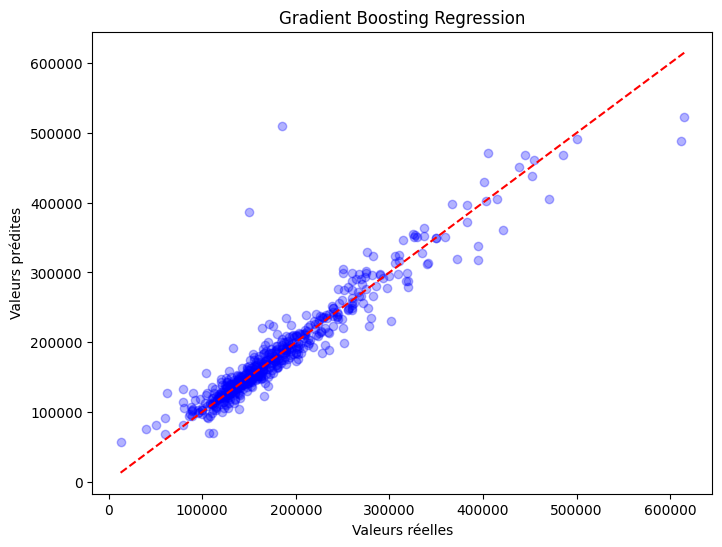

In [145]:
# Affichage des prédictions contre les valeurs réelles
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_gb, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('Gradient Boosting Regression')
plt.show()

Ces résultats suggèrent que le modèle Gradient Boosting fonctionne bien pour ce jeu de données, en particulier grâce à sa capacité à capturer des relations complexes et non linéaires. Cependant, il pourrait être amélioré en ajustant davantage les hyperparamètres, tels que le nombre d'estimateurs ou la profondeur maximale des arbres, pour mieux gérer les valeurs extrêmes. Il serait également intéressant de comparer ces résultats avec d'autres modèles d'ensemble pour évaluer si Gradient Boosting est le meilleur choix pour cette tâche.

### XGBoosting

Le modèle XGBoost (eXtreme Gradient Boosting) est une méthode d'ensemble avancée qui utilise une technique de boosting pour améliorer les performances prédictives. Il est particulièrement efficace pour gérer des données complexes et volumineuses, grâce à son optimisation poussée et sa gestion des interactions entre les variables.  

Une recherche par grille a été effectuée pour optimiser trois hyperparamètres clés :  
- `n_estimators` : le nombre d'arbres à construire ($[100, 250, 500]$).  
- `learning_rate` : le taux d'apprentissage, qui contrôle la contribution de chaque arbre ($[0.01, 0.1, 0.5]$).  
- `max_depth` : la profondeur maximale de chaque arbre ($[3, 5, 7]$).  

En conclusion, XGBoost est un modèle puissant pour ce type de problème, mais il est important de peser le compromis entre performance et temps de calcul. Il serait intéressant de comparer ces résultats avec d'autres modèles d'ensemble pour évaluer si XGBoost est le meilleur choix pour cette tâche.

In [146]:
# Définir la grille d'hyperparamètres
param_grid = {
    'n_estimators': [100, 250, 500],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7]
}

# Utiliser GridSearchCV pour trouver les meilleurs hyperparamètres
grid_search = GridSearchCV(estimator=XGBRegressor(random_state=rs), param_grid=param_grid, cv=5, scoring='r2')
start_time = time.time() # Démarrer le chronomètre
grid_search.fit(X_train, y_train_reg)
end_time = time.time() # Arrêter le chronomètre

# Afficher les meilleurs hyperparamètres
print("-- XGBOOST --")
print(f"Meilleurs paramètres : {grid_search.best_params_}")

# Utiliser les meilleurs hyperparamètres pour le modèle final
XGB = grid_search.best_estimator_

# Prédiction et évaluation
y_xgb = XGB.predict(X_test)
R2_xgb = r2_score(y_test_reg, y_xgb)
R2_ajuste_xgb = R2_ajuste(y_test_reg, y_xgb, X_test)
RMSE_xgb = np.sqrt(mean_squared_error(y_test_reg, y_xgb))
time_xgb = end_time - start_time

print(f"R2 : {R2_xgb:.3f}")
print(f"R2 ajusté : {R2_ajuste_xgb:.3f}")
print(f"RMSE : {RMSE_xgb:.3f}")
print(f"Temps d'exécution : {time_xgb:.3f} secondes")


-- XGBOOST --
Meilleurs paramètres : {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500}
R2 : 0.898
R2 ajusté : 0.817
RMSE : 24814.129
Temps d'exécution : 96.197 secondes


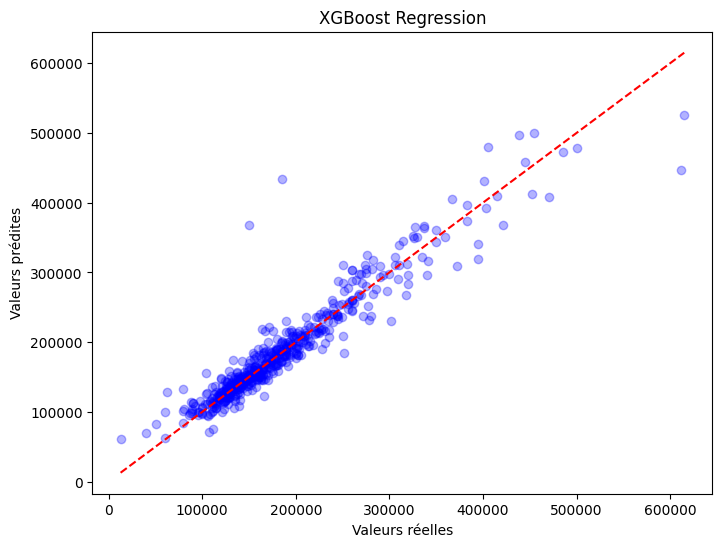

In [147]:
# Affichage des prédictions contre les valeurs réelles
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_xgb, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('XGBoost Regression')
plt.show()

Ces résultats suggèrent que le modèle XGBoost fonctionne bien pour ce jeu de données, en particulier grâce à sa capacité à gérer des relations complexes et à optimiser les performances grâce à des techniques avancées comme le boosting. Cependant, il pourrait être amélioré en ajustant davantage les hyperparamètres, tels que le nombre d'estimateurs ou le taux d'apprentissage, pour mieux gérer les valeurs extrêmes. Il serait également intéressant de comparer ces résultats avec d'autres modèles d'ensemble pour évaluer si XGBoost est le meilleur choix pour cette tâche.

### LightBoost

In [148]:
# Définir la grille d'hyperparamètres
param_grid = {
    'n_estimators': [100, 250, 500],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7],
    'num_leaves': [31, 50, 100]  # Nombre de feuilles dans un arbre
}

# Utiliser GridSearchCV pour trouver les meilleurs hyperparamètres
grid_search = GridSearchCV(estimator=LGBMRegressor(random_state=rs, verbose=-1), param_grid=param_grid, cv=5, scoring='r2')
start_time = time.time()  # Démarrer le chronomètre
grid_search.fit(X_train, y_train_reg)
end_time = time.time()  # Arrêter le chronomètre

# Afficher les meilleurs hyperparamètres
print("-- LIGHTGBM --")
print(f"Meilleurs paramètres : {grid_search.best_params_}")

# Utiliser les meilleurs hyperparamètres pour le modèle final
LGBM = grid_search.best_estimator_

# Prédiction et évaluation
y_lgbm = LGBM.predict(X_test)
R2_lgbm = r2_score(y_test_reg, y_lgbm)
R2_ajuste_lgbm = R2_ajuste(y_test_reg, y_lgbm, X_test)
RMSE_lgbm = np.sqrt(mean_squared_error(y_test_reg, y_lgbm))
time_lgbm = end_time - start_time

print(f"R2 : {R2_lgbm:.3f}")
print(f"R2 ajusté : {R2_ajuste_lgbm:.3f}")
print(f"RMSE : {RMSE_lgbm:.3f}")
print(f"Temps d'exécution : {time_lgbm:.3f} secondes")

-- LIGHTGBM --
Meilleurs paramètres : {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'num_leaves': 31}
R2 : 0.894
R2 ajusté : 0.811
RMSE : 25255.469
Temps d'exécution : 45.781 secondes


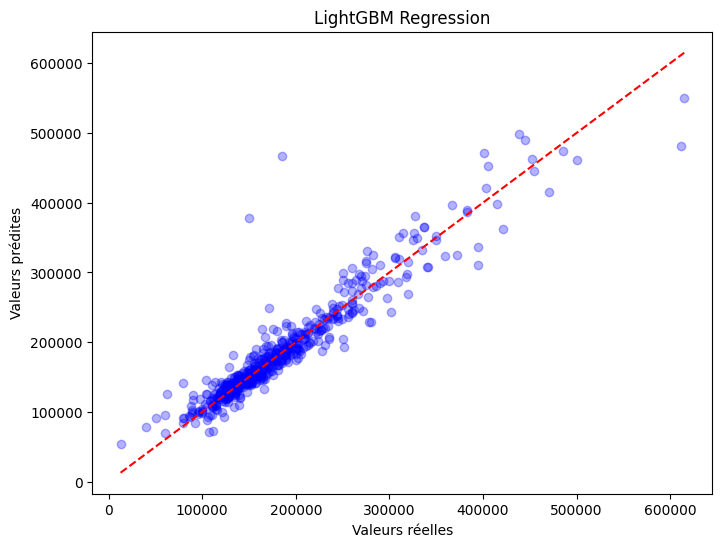

In [149]:
# Affichage des prédictions contre les valeurs réelles
plt.figure(figsize=(8, 6))
plt.scatter(y_test_reg, y_lgbm, color='blue', alpha=0.3)
plt.plot([y_test_reg.min(), y_test_reg.max()], [y_test_reg.min(), y_test_reg.max()], 'r--')
plt.xlabel('Valeurs réelles')
plt.ylabel('Valeurs prédites')
plt.title('LightGBM Regression')
plt.show()


Ces résultats suggèrent que le modèle LightGBM fonctionne bien pour ce jeu de données, en particulier grâce à sa capacité à gérer des relations complexes et à optimiser les performances grâce à des techniques avancées comme le boosting. Cependant, il pourrait être amélioré en ajustant davantage les hyperparamètres, tels que le nombre d'estimateurs ou le taux d'apprentissage, pour mieux gérer les valeurs extrêmes. Il serait également intéressant de comparer ces résultats avec d'autres modèles d'ensemble pour évaluer si LightGBM est le meilleur choix pour cette tâche.

## Sélection du meilleur modèle

- **$ R^2 $ (coefficient de détermination)** :
  - Indique la proportion de la variance expliquée par le modèle. Plus $ R^2 $ est proche de 1, meilleur est le modèle.
  - Cependant, $ R^2 $ peut augmenter simplement en ajoutant des variables au modèle, même si ces variables n’améliorent pas réellement les performances.

- **$ R^2 $ ajusté** :
  - Corrige $ R^2 $ pour le nombre de variables explicatives utilisées dans le modèle.
  - Utile pour comparer des modèles avec un nombre différent de variables. Un $ R^2 $ ajusté plus élevé indique une meilleure performance ajustée au sur-ajustement potentiel.

- **RMSE (Root Mean Squared Error)** :
  - Mesure la moyenne des erreurs au carré entre les prédictions et les valeurs réelles, ramenée à l’échelle originale des données.
  - Plus RMSE est faible, plus le modèle est précis. RMSE est sensible aux grandes erreurs et favorise les modèles qui réduisent les erreurs importantes.


In [150]:
# Résumé des métriques des modèles
metrics_reg = {
    'Modèle': ['Régression linéaire', 'Ridge', 'Lasso', 'Arbre de décision', 'KNN', 'SVR', 'AdaBoost', 'Gradient Boosting', 'XGBoost', 'LightGBM'],
    'R2': [R2_LR, R2_ridge, R2_lasso, R2_tree, R2_knn, R2_svr, R2_ada, R2_gb, R2_xgb, R2_lgbm],
    'R2 Adjusté': [R2_ajuste_LR, R2_ajuste_ridge, R2_ajuste_lasso, R2_ajuste_tree, R2_ajuste_knn, R2_ajuste_svr, R2_ajuste_ada, R2_ajuste_gb, R2_ajuste_xgb, R2_ajuste_lgbm],
    'RMSE': [RMSE_LR, RMSE_ridge, RMSE_lasso, RMSE_tree, RMSE_knn, RMSE_svr, RMSE_ada, RMSE_gb, RMSE_xgb, RMSE_lgbm],
    'Temps d\'entraînement': [time_LR, time_ridge, time_lasso, time_tree, time_knn, time_svr, time_ada, time_gb, time_xgb, time_lgbm]
}

# Création du DataFrame
metrics_reg = pd.DataFrame(metrics_reg)

# Affichage du tableau
metrics_reg.round(3)

,Modèle,R2,R2 Adjusté,RMSE,Temps d'entraînement
0,Régression linéaire,0.853,0.737,2.976902e+04,0.053
1,Ridge,-1555127.422,-2782586.645,9.685731e+07,0.079
2,Lasso,0.854,0.739,2.966089e+04,3.500
3,Arbre de décision,0.781,0.608,3.633588e+04,0.075
4,KNN,0.707,0.476,4.202000e+04,0.007
5,SVR,-0.046,-0.871,7.942410e+04,9.707
6,AdaBoost,0.834,0.703,3.163063e+04,151.725
7,Gradient Boosting,0.890,0.802,2.581364e+04,438.798
8,XGBoost,0.898,0.817,2.481413e+04,96.197
9,LightGBM,0.894,0.811,2.525547e+04,45.781


Le tableau présente une comparaison des performances de différents modèles de régression en termes de **R²**, **R² ajusté**, **RMSE** et **Temps d'entraînement**. Voici une analyse des résultats :

1. **Meilleure performance globale** :
   - **XGBoost** obtient le meilleur **R²** (0.898) et **R² ajusté** (0.817), suivi de près par **LightGBM** et **Gradient Boosting**.
   - **Régression linéaire** et **Lasso** montrent également de bonnes performances, avec un **R²** supérieur à 0.85.

2. **RMSE** :
   - **XGBoost** a le plus faible **RMSE** (2.481413e+04), ce qui indique que ses prédictions sont les plus proches des valeurs réelles.
   - **LightGBM** et **Gradient Boosting** suivent de près avec des RMSE de 2.525547e+04 et 2.581364e+04 respectivement.

3. **Temps d'entraînement** :
   - **KNN** est le plus rapide, avec un temps d'entraînement de seulement 0.013 seconde.
   - **Gradient Boosting** est le plus lent (439.306 secondes), suivi de **AdaBoost** (153.294 secondes) et **XGBoost** (97.390 secondes).

4. **Performances médiocres** :
   - **Ridge** et **SVR** ont des performances très faibles, avec des **R²** négatifs, ce qui suggère que ces modèles ne sont pas adaptés à ce jeu de données.

5. **Compromis performance/temps** :
   - **LightGBM** offre un bon compromis entre performance et temps d'entraînement.
   - **XGBoost** et **Gradient Boosting** sont également des choix intéressants pour des performances élevées, mais avec un temps d'entraînement plus long.

On conclut que :

- **XGBoost** est le meilleur modèle en termes de performance globale, mais il est relativement lent.
- **LightGBM** est une alternative performante et plus rapide.
- Pour des problèmes nécessitant une rapidité d'entraînement, **Régression linéaire** et **Lasso** sont des choix viables, bien que moins performants.

# CLASSIFICATION

## Preprocessing

Pour assurer la qualité de nos modèles de classification, il nous faut au préalable standardisé nos données.

In [151]:
# Standardisation des données
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

## Statistiques descriptives et exploratoires

In [152]:
data_train_class = pd.DataFrame(X_train_scaled, columns=X_train.columns)
data_train_class['SalePrice'] = y_train_class.values

In [153]:
data_train_class.describe().round(2)

,Order,PID,MS SubClass,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Mas Vnr Area,BsmtFin SF 1,...,Sale Type_New,Sale Type_Oth,Sale Type_VWD,Sale Type_WD,Sale Condition_AdjLand,Sale Condition_Alloca,Sale Condition_Family,Sale Condition_Normal,Sale Condition_Partial,SalePrice
count,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,...,2142.0,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00,2142.00
mean,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,...,0.0,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.51
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.0,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,0.50
min,-1.75,-0.96,-0.88,-1.14,-3.12,-4.27,-3.19,-1.73,-0.59,-1.01,...,-0.3,-0.03,-0.02,-2.54,-0.05,-0.07,-0.13,-2.20,-0.31,0.00
25%,-0.87,-0.95,-0.88,-0.34,-0.90,-0.56,-0.60,-0.90,-0.59,-1.01,...,-0.3,-0.03,-0.02,0.39,-0.05,-0.07,-0.13,0.45,-0.31,0.00
50%,0.02,-0.91,-0.16,-0.09,-0.16,-0.56,0.10,0.43,-0.59,-0.14,...,-0.3,-0.03,-0.02,0.39,-0.05,-0.07,-0.13,0.45,-0.31,1.00
75%,0.84,1.06,0.32,0.18,0.58,0.37,0.95,0.92,0.38,0.64,...,-0.3,-0.03,-0.02,0.39,-0.05,-0.07,-0.13,0.45,-0.31,1.00
max,1.75,1.59,3.20,26.05,2.80,3.15,1.25,1.21,8.23,11.21,...,3.3,32.71,46.27,0.39,20.67,13.92,7.76,0.45,3.25,1.00


Order vs SalePrice : -0.04


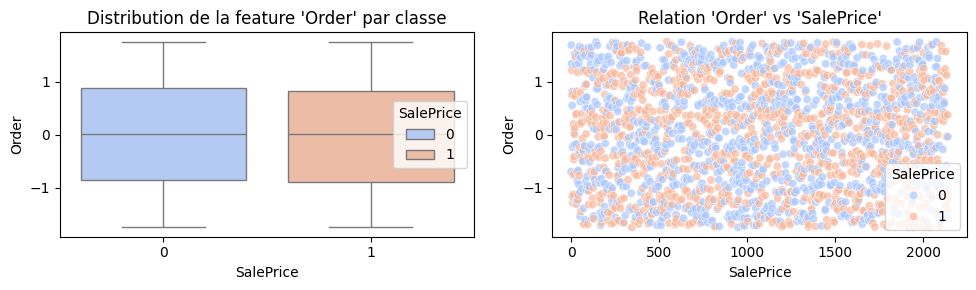

PID vs SalePrice : -0.18


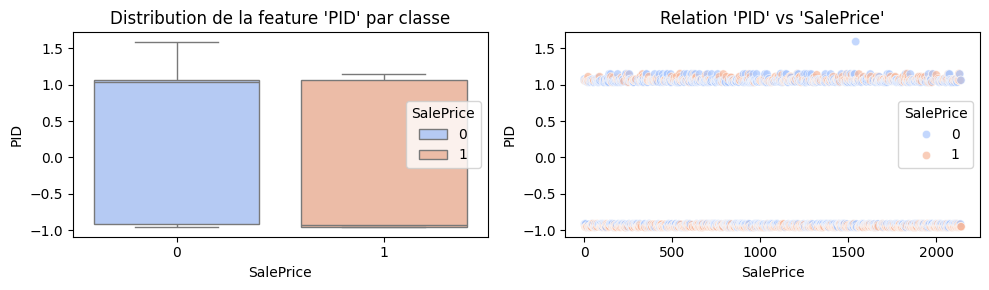

MS SubClass vs SalePrice : -0.01


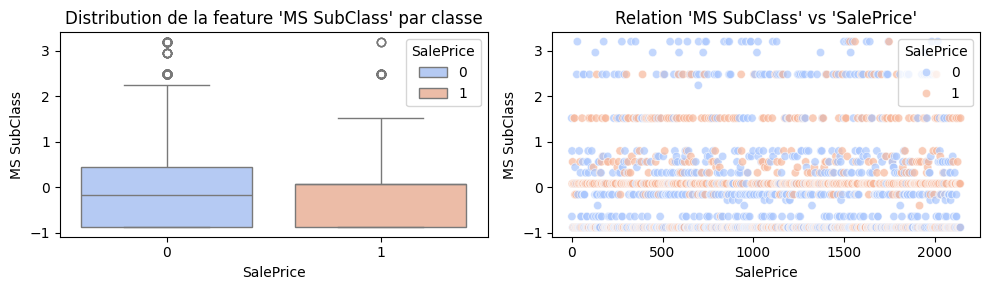

Lot Area vs SalePrice : 0.20


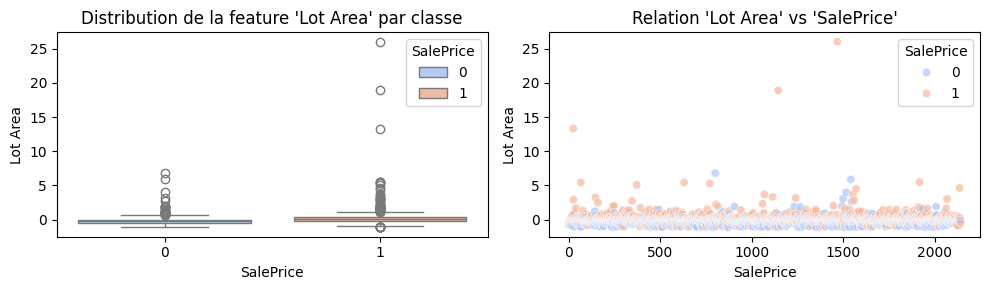

Overall Qual vs SalePrice : 0.68


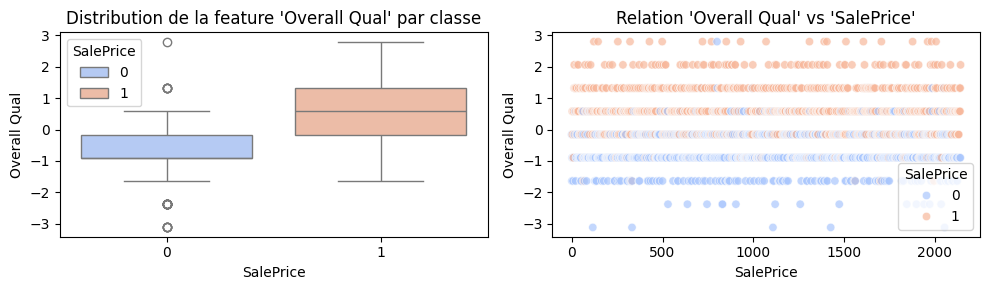

Overall Cond vs SalePrice : -0.19


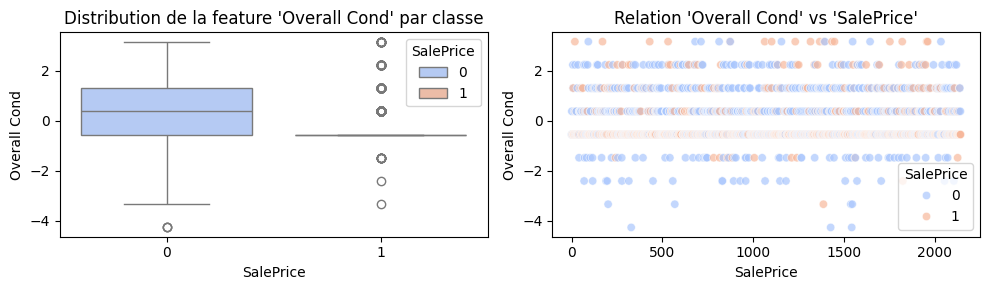

Year Built vs SalePrice : 0.59


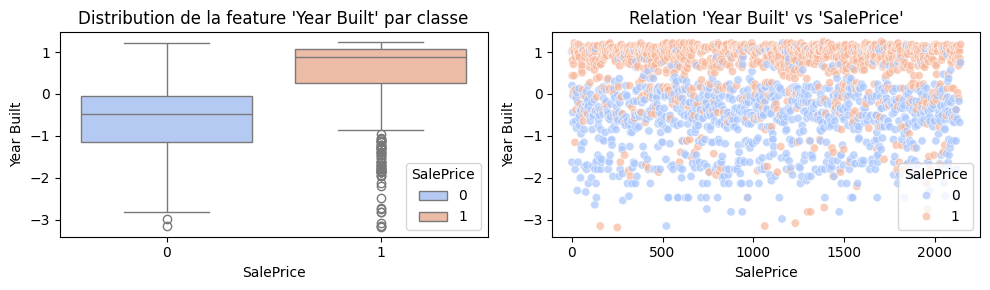

Year Remod/Add vs SalePrice : 0.56


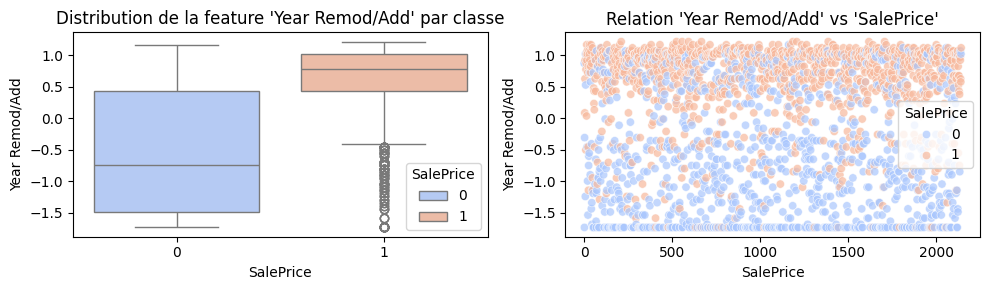

Mas Vnr Area vs SalePrice : 0.29


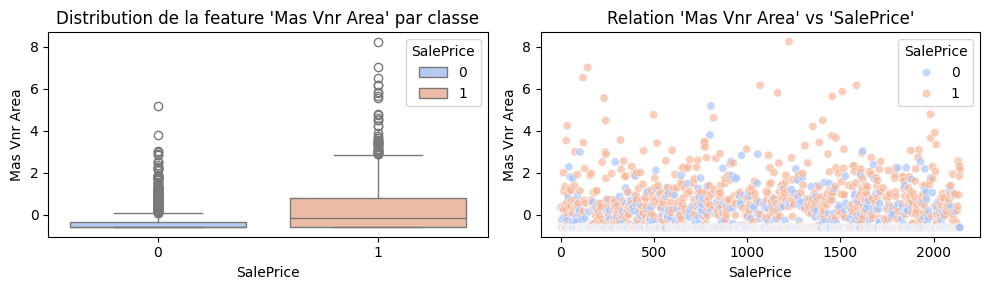

BsmtFin SF 1 vs SalePrice : 0.21


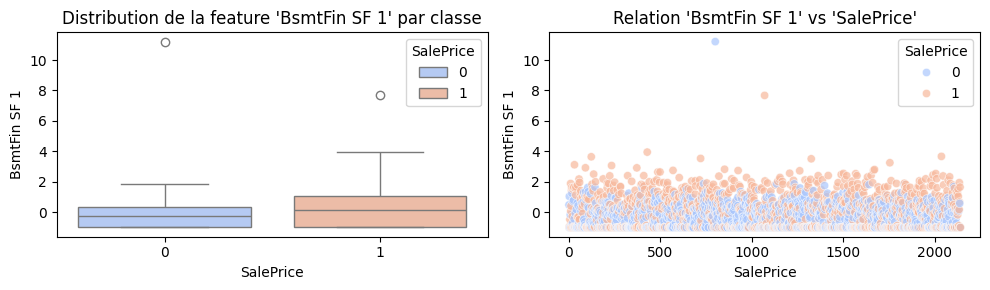

BsmtFin SF 2 vs SalePrice : -0.02


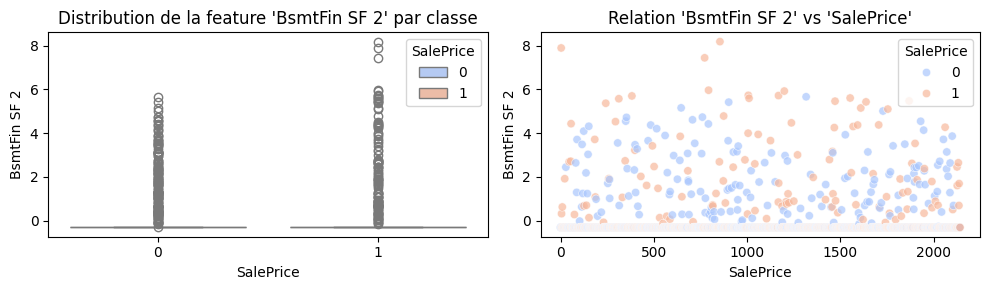

Bsmt Unf SF vs SalePrice : 0.20


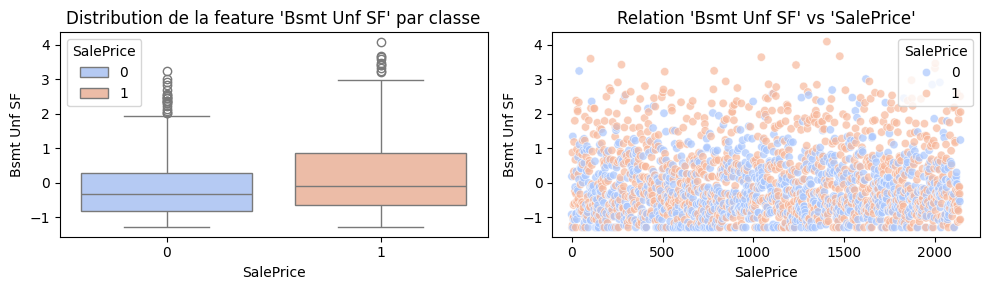

Total Bsmt SF vs SalePrice : 0.43


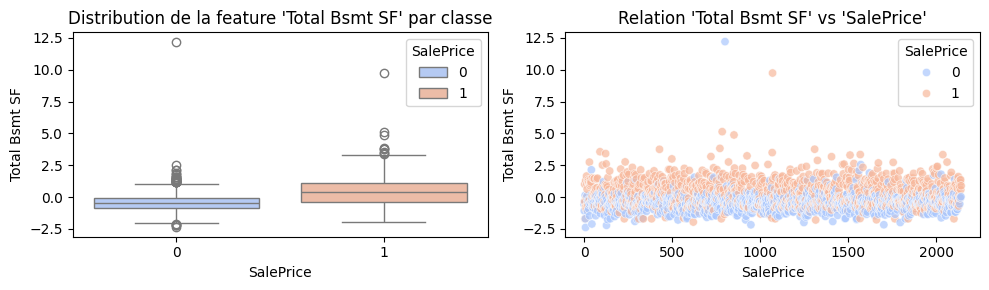

1st Flr SF vs SalePrice : 0.45


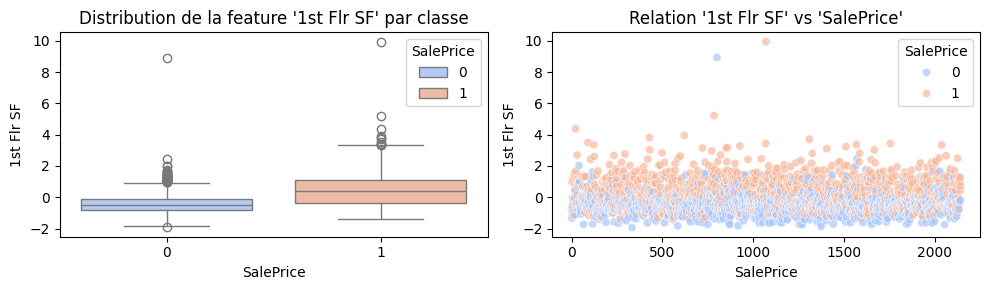

2nd Flr SF vs SalePrice : 0.29


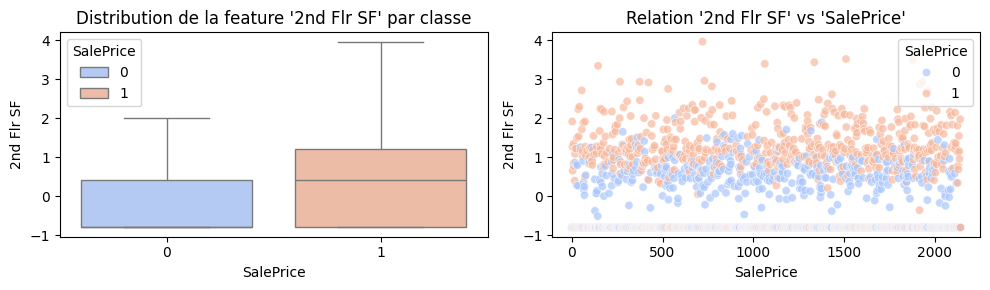

Low Qual Fin SF vs SalePrice : -0.04


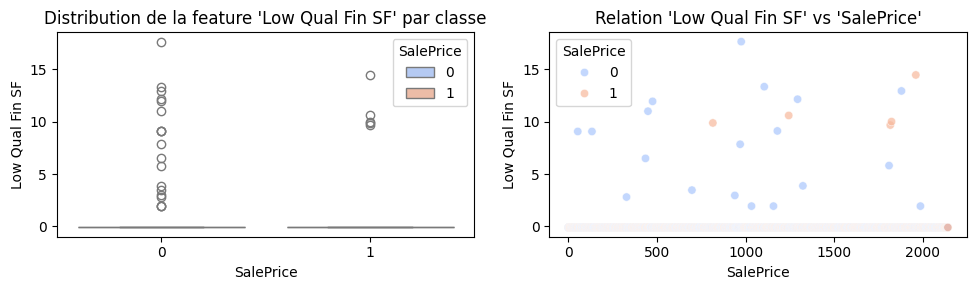

Gr Liv Area vs SalePrice : 0.59


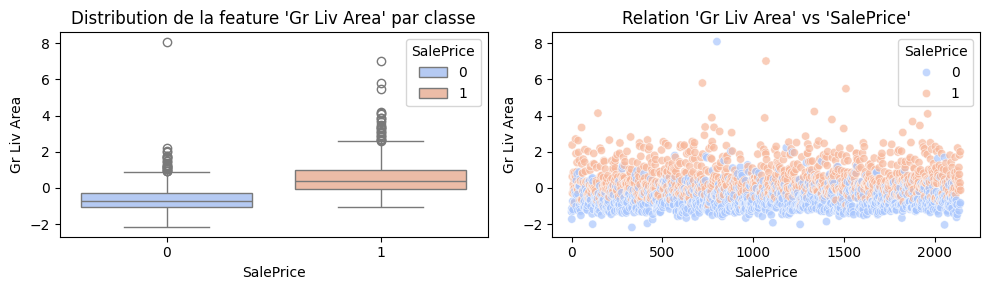

Bsmt Full Bath vs SalePrice : 0.13


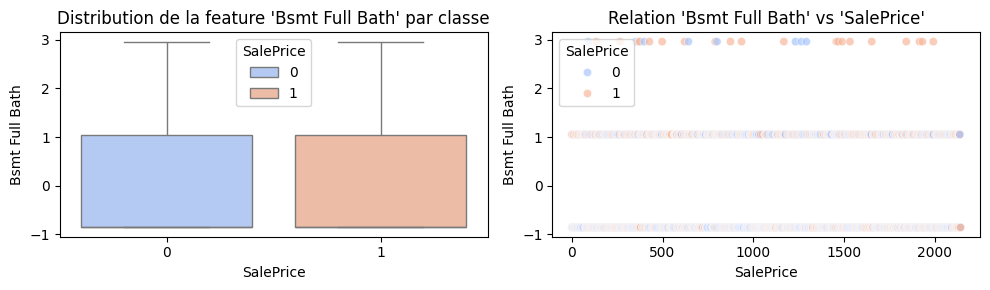

Bsmt Half Bath vs SalePrice : -0.03


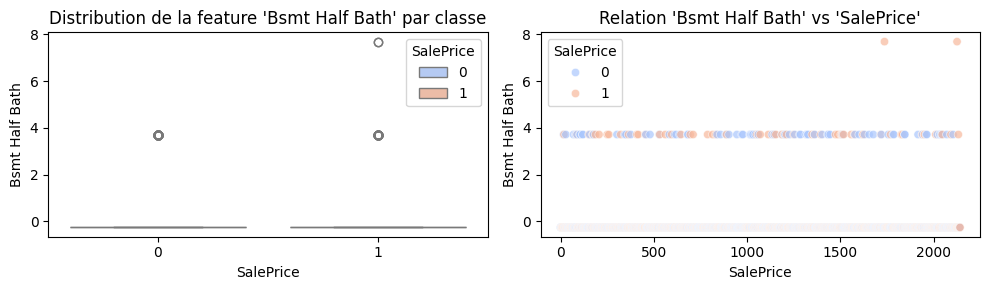

Full Bath vs SalePrice : 0.64


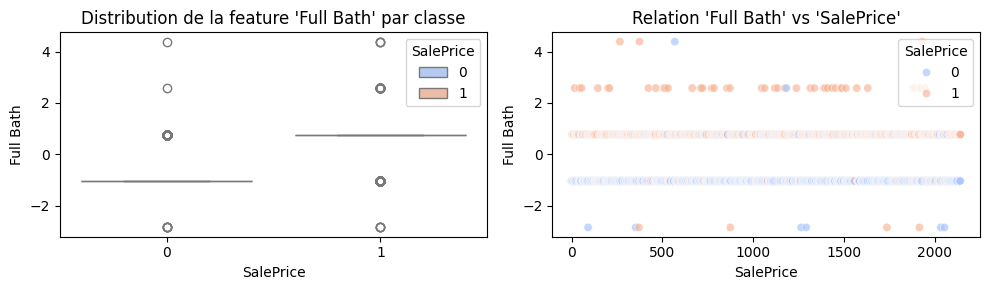

Half Bath vs SalePrice : 0.30


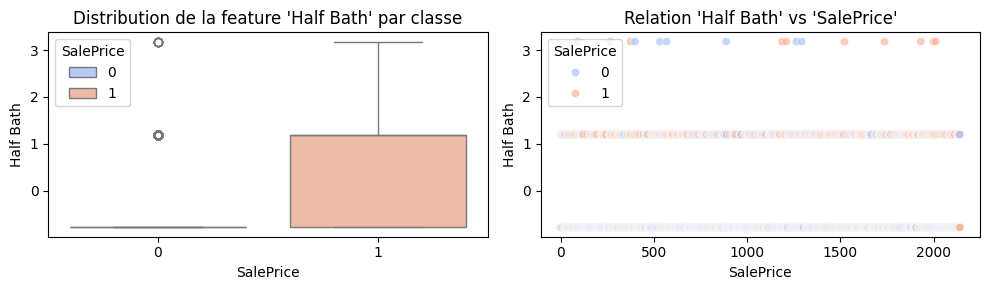

Bedroom AbvGr vs SalePrice : 0.14


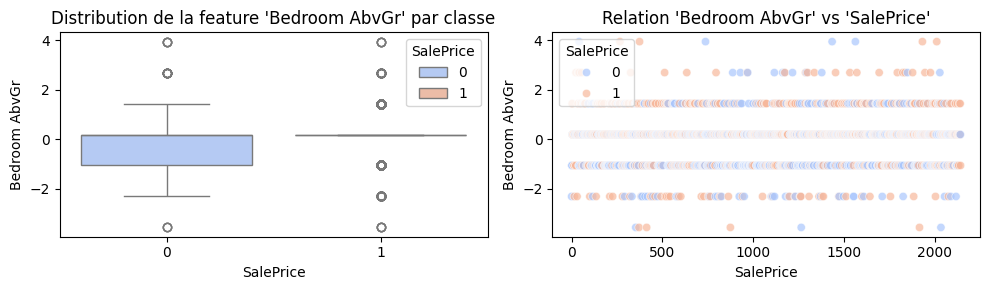

Kitchen AbvGr vs SalePrice : -0.09


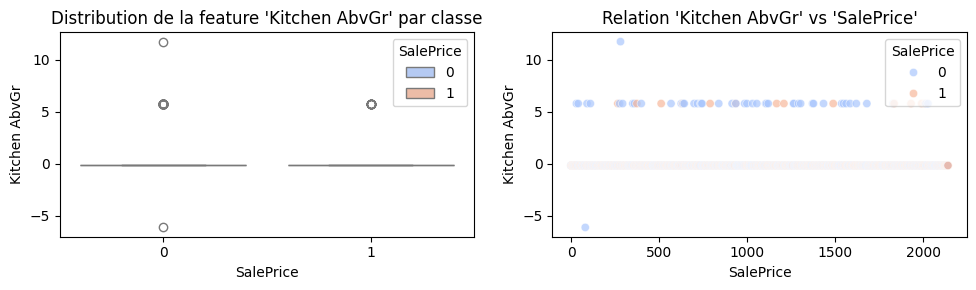

TotRms AbvGrd vs SalePrice : 0.42


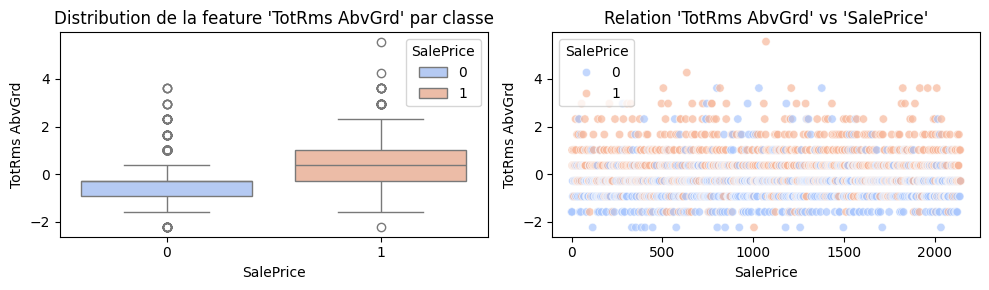

Fireplaces vs SalePrice : 0.39


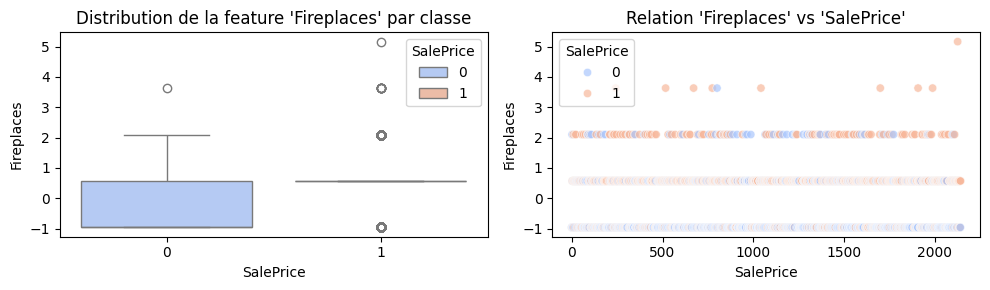

Garage Yr Blt vs SalePrice : 0.55


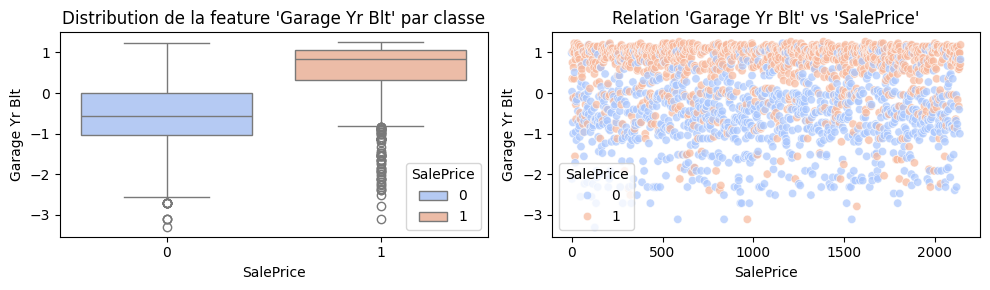

Garage Cars vs SalePrice : 0.57


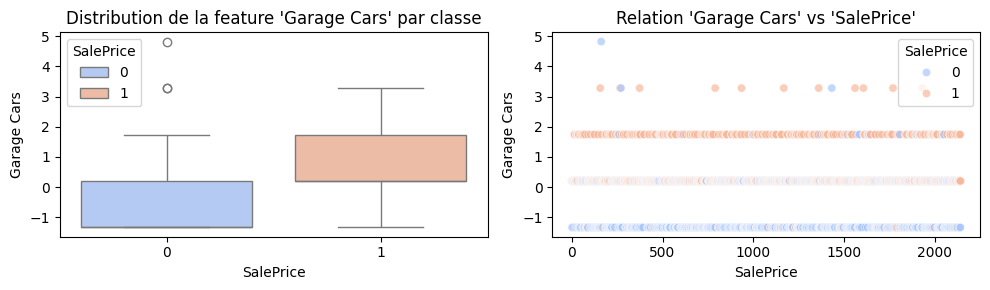

Garage Area vs SalePrice : 0.49


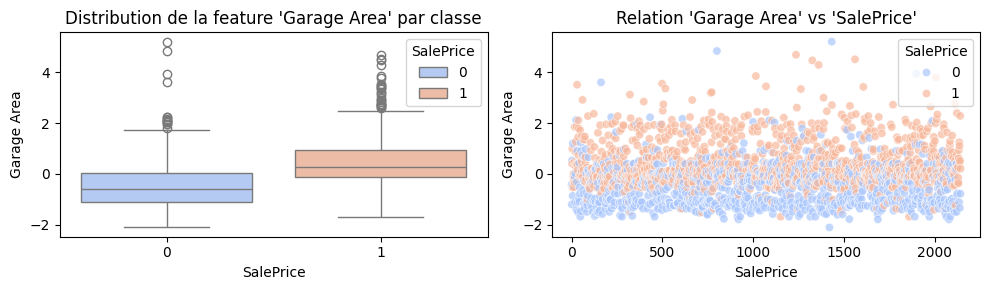

Wood Deck SF vs SalePrice : 0.27


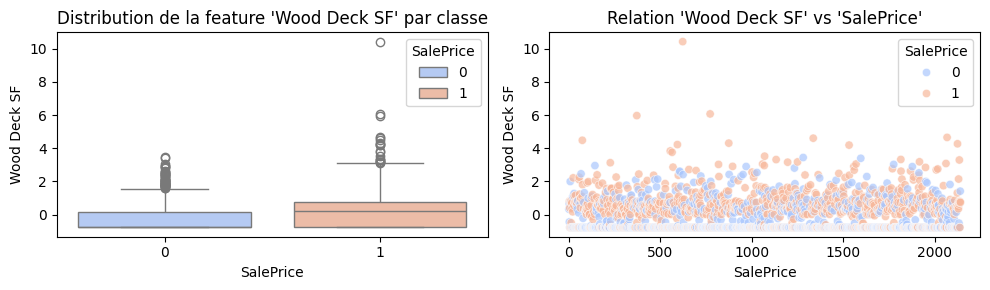

Open Porch SF vs SalePrice : 0.30


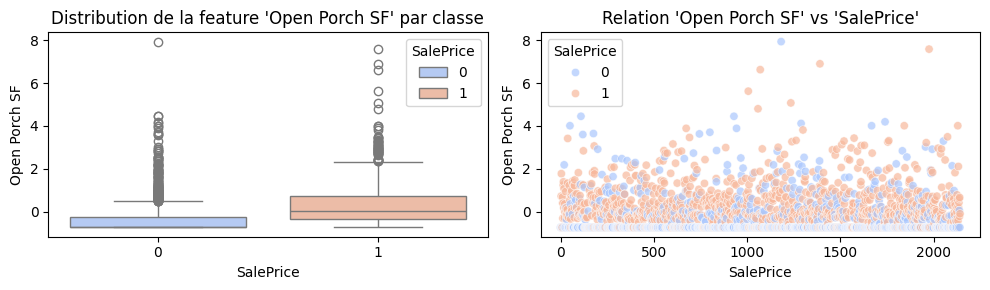

Enclosed Porch vs SalePrice : -0.13


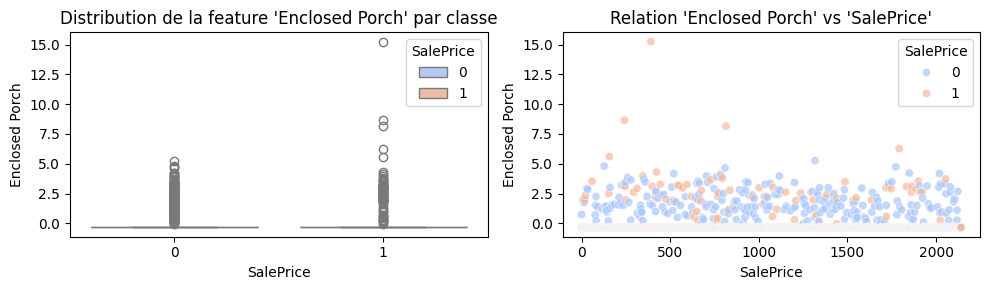

3Ssn Porch vs SalePrice : 0.03


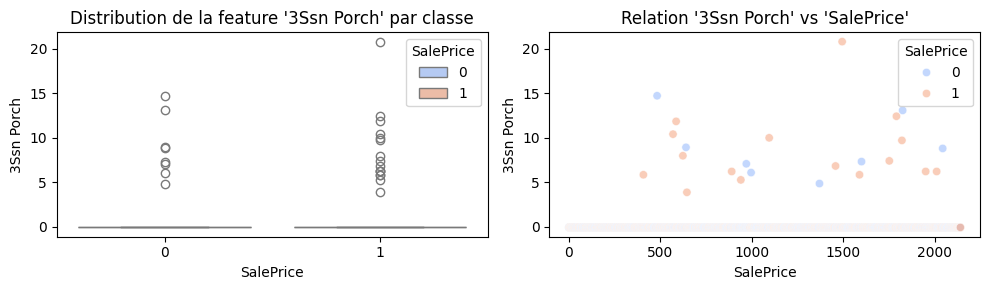

Screen Porch vs SalePrice : 0.05


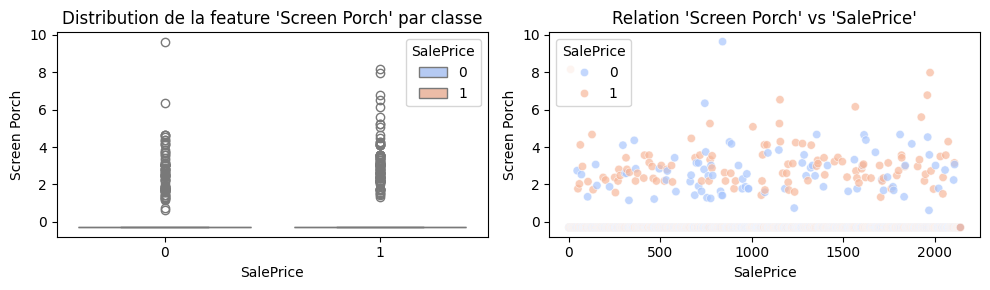

Pool Area vs SalePrice : 0.04


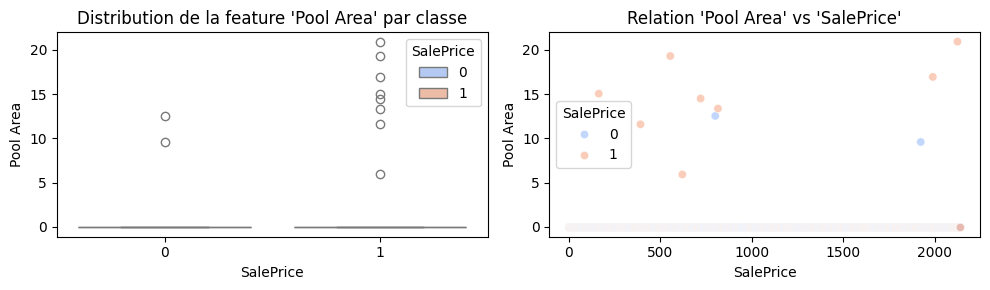

Misc Val vs SalePrice : 0.01


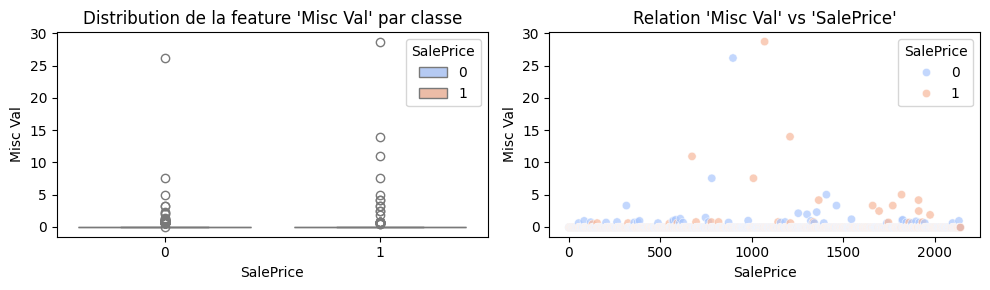

Mo Sold vs SalePrice : 0.03


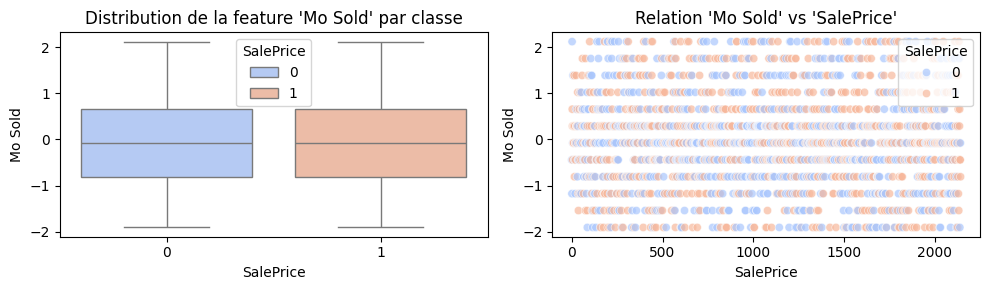

Yr Sold vs SalePrice : -0.00


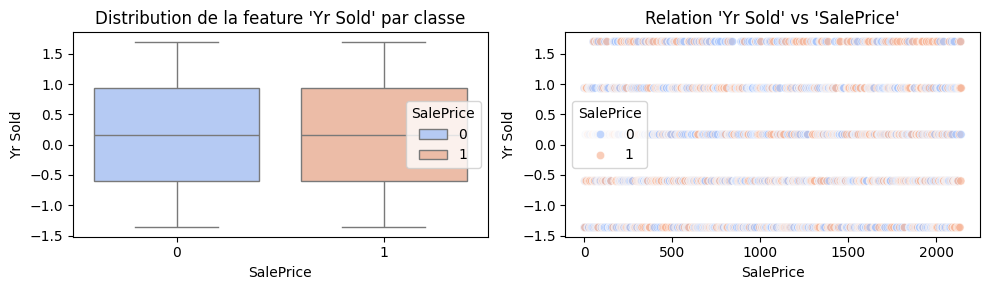

MS Zoning_FV vs SalePrice : 0.16


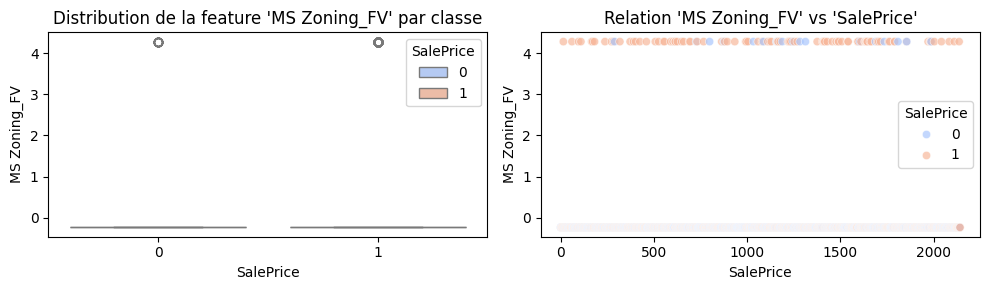

MS Zoning_I (all) vs SalePrice : -0.02


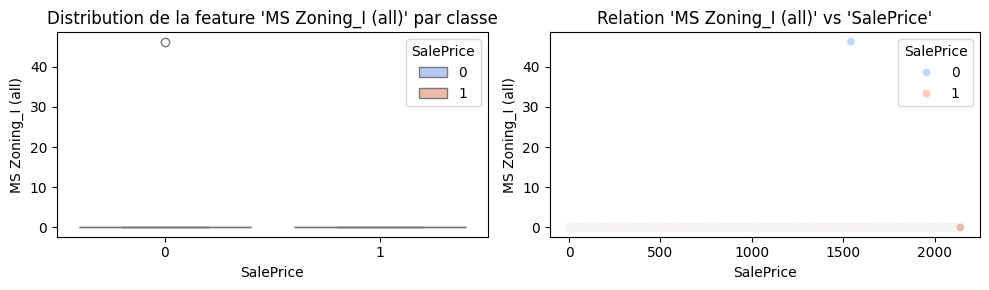

MS Zoning_RH vs SalePrice : -0.06


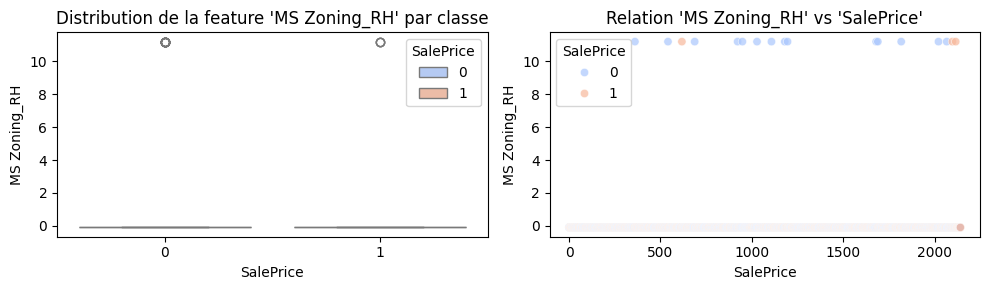

MS Zoning_RL vs SalePrice : 0.23


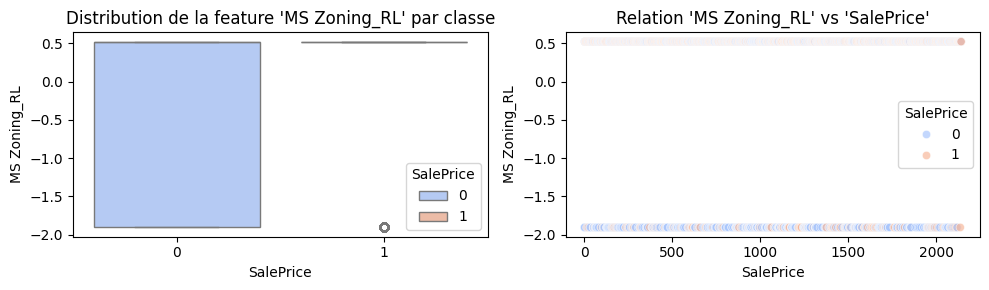

MS Zoning_RM vs SalePrice : -0.33


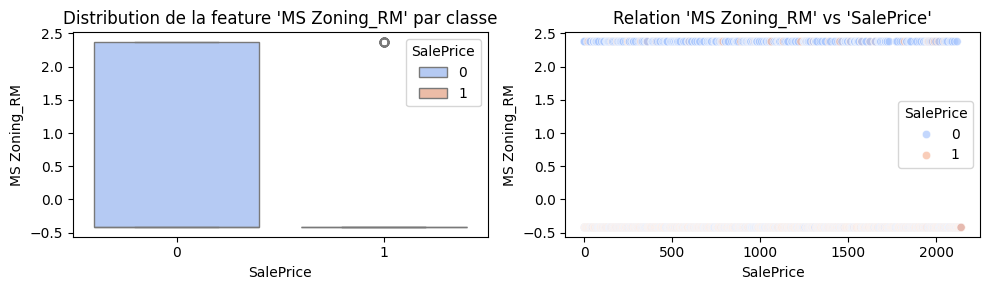

Street_Pave vs SalePrice : 0.04


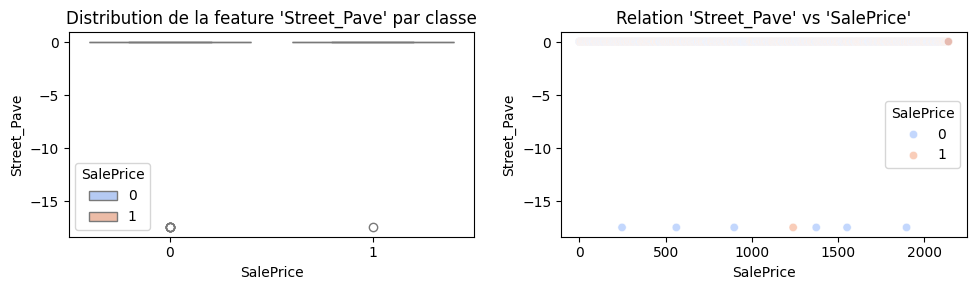

Lot Shape_IR2 vs SalePrice : 0.11


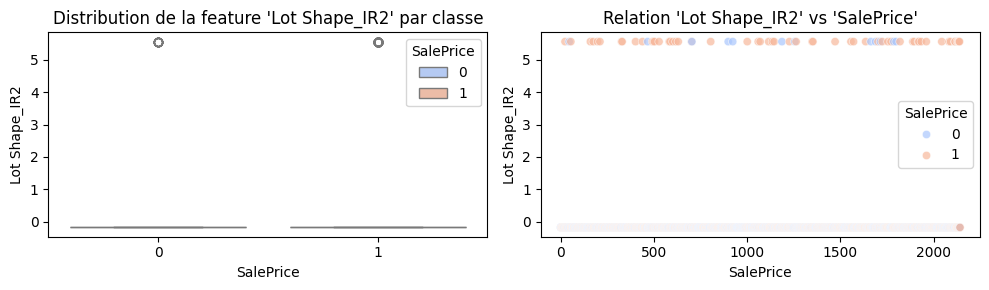

Lot Shape_IR3 vs SalePrice : 0.04


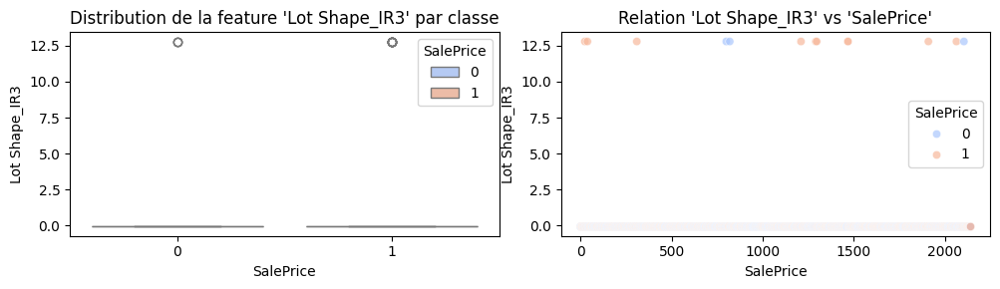

Lot Shape_Reg vs SalePrice : -0.31


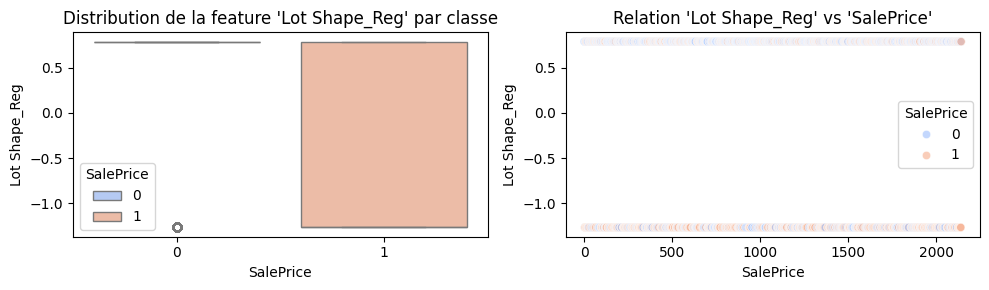

Land Contour_HLS vs SalePrice : 0.09


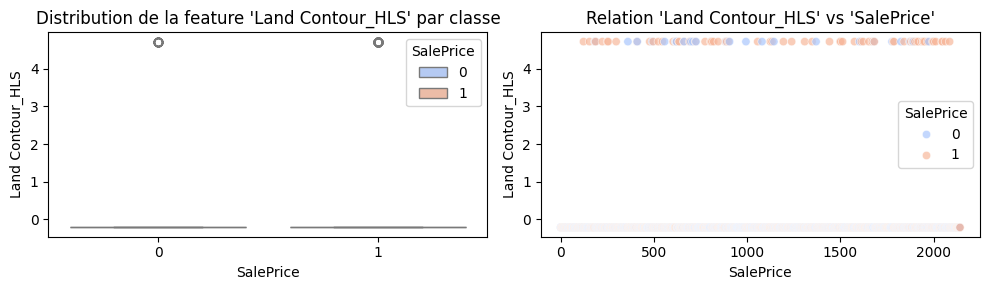

Land Contour_Low vs SalePrice : 0.04


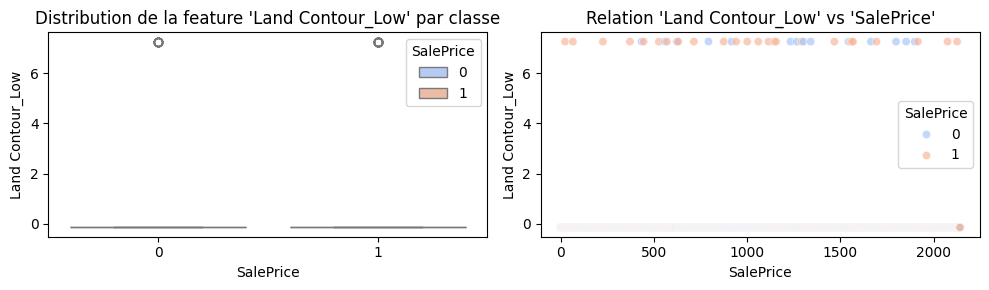

Land Contour_Lvl vs SalePrice : -0.04


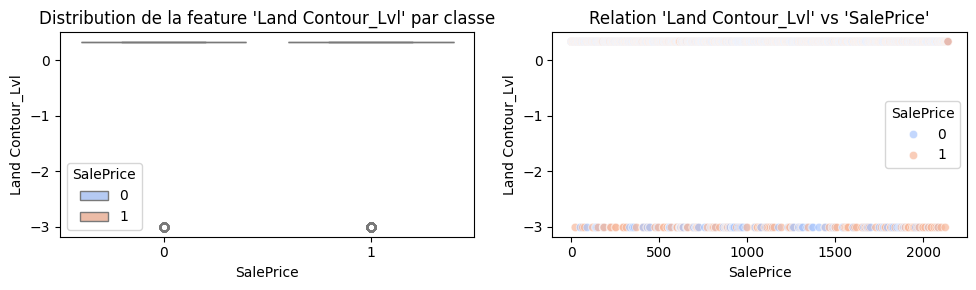

Utilities_NoSeWa vs SalePrice : -0.02


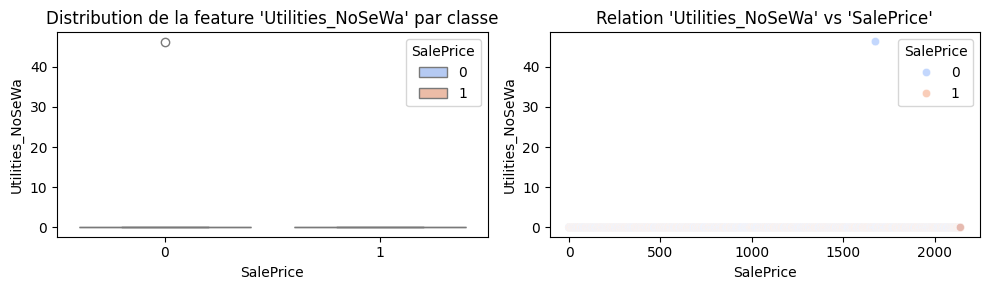

Utilities_NoSewr vs SalePrice : -0.02


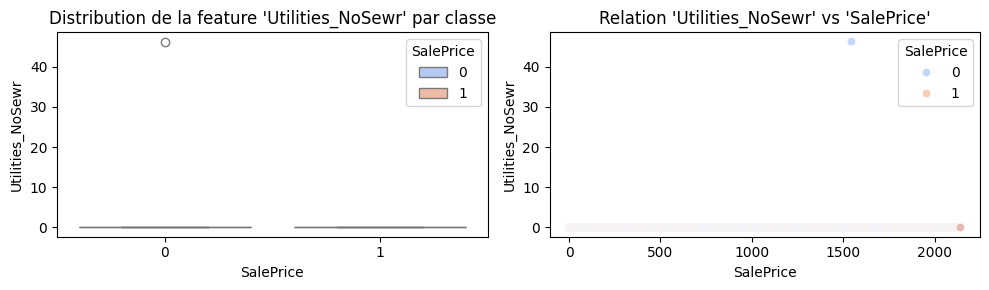

Lot Config_CulDSac vs SalePrice : 0.11


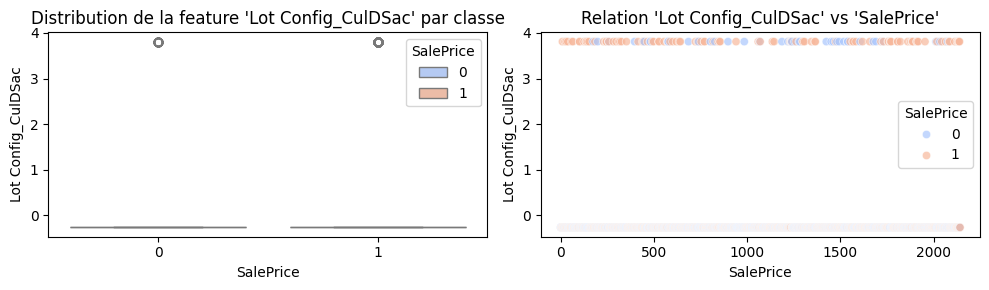

Lot Config_FR2 vs SalePrice : -0.01


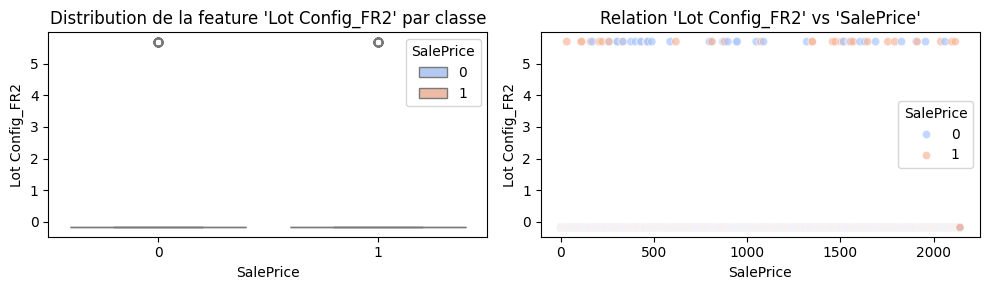

Lot Config_FR3 vs SalePrice : 0.02


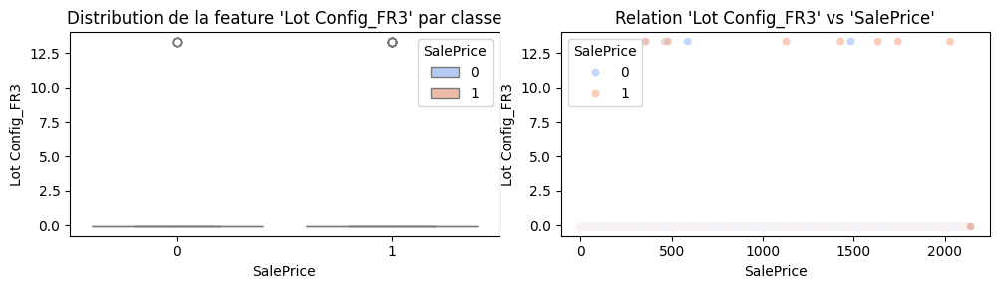

Lot Config_Inside vs SalePrice : -0.04


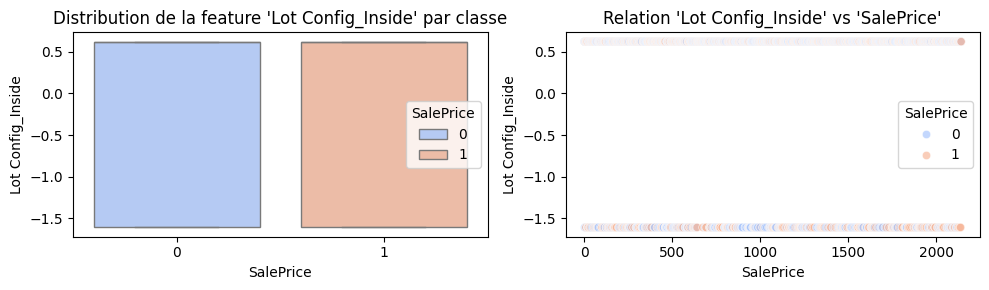

Land Slope_Mod vs SalePrice : 0.05


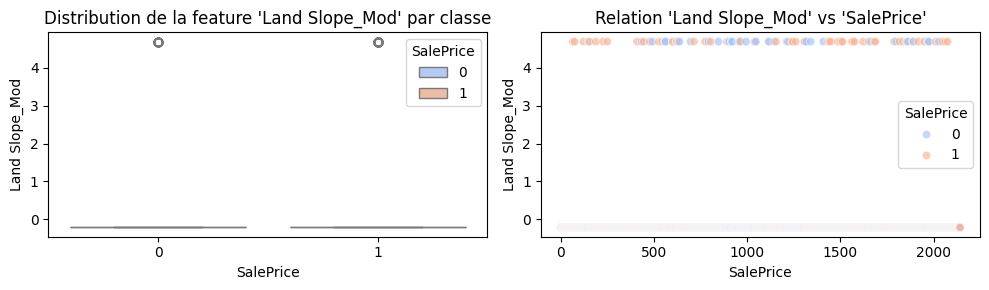

Land Slope_Sev vs SalePrice : 0.02


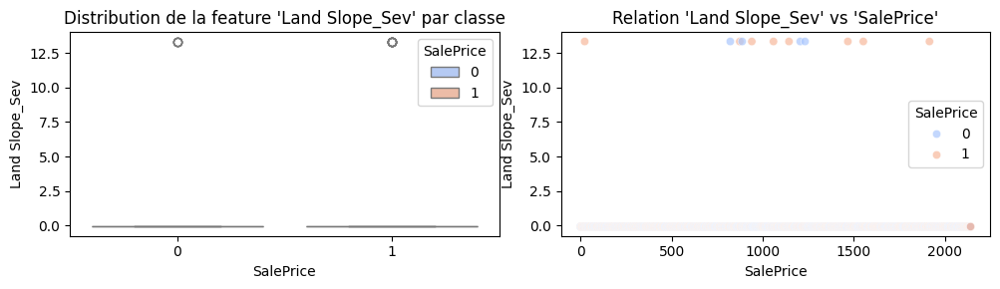

Neighborhood_Blueste vs SalePrice : -0.04


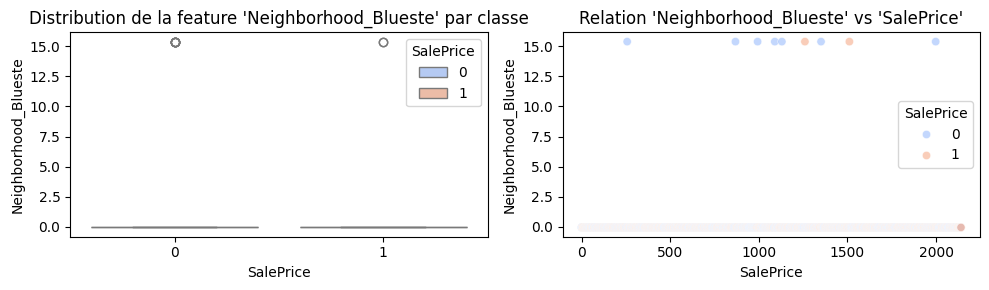

Neighborhood_BrDale vs SalePrice : -0.10


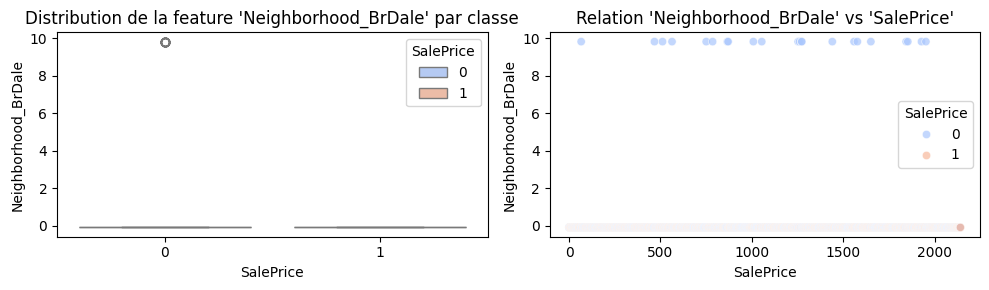

Neighborhood_BrkSide vs SalePrice : -0.15


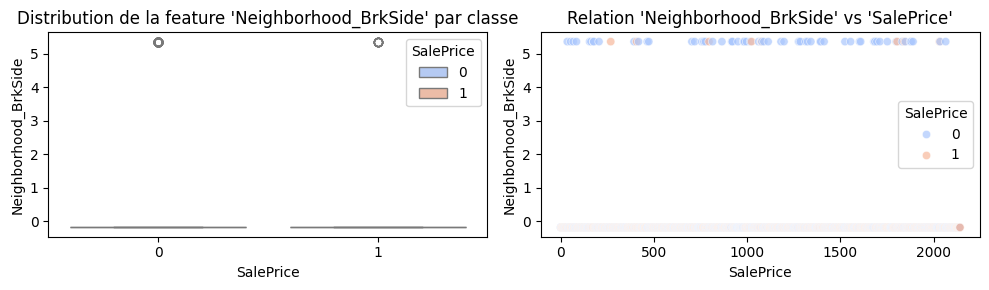

Neighborhood_ClearCr vs SalePrice : 0.06


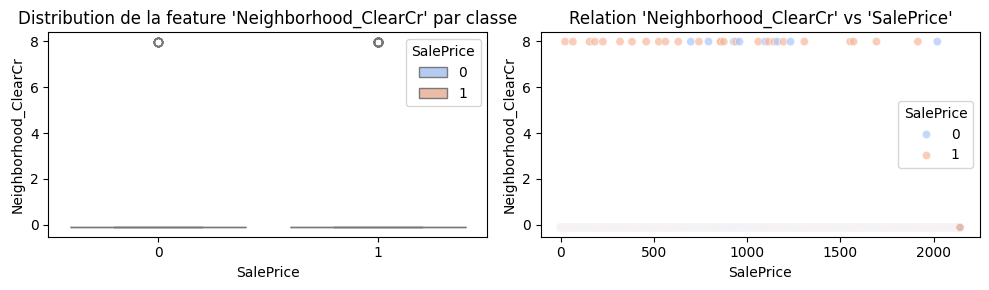

Neighborhood_CollgCr vs SalePrice : 0.16


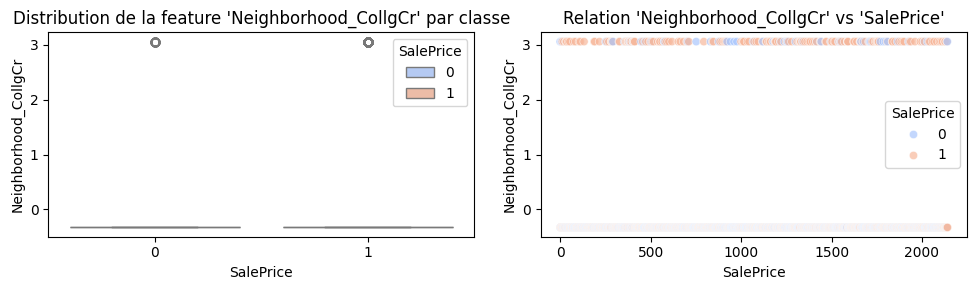

Neighborhood_Crawfor vs SalePrice : 0.08


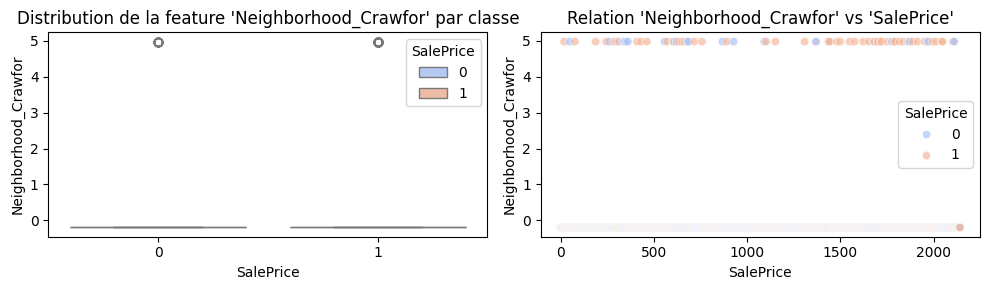

Neighborhood_Edwards vs SalePrice : -0.17


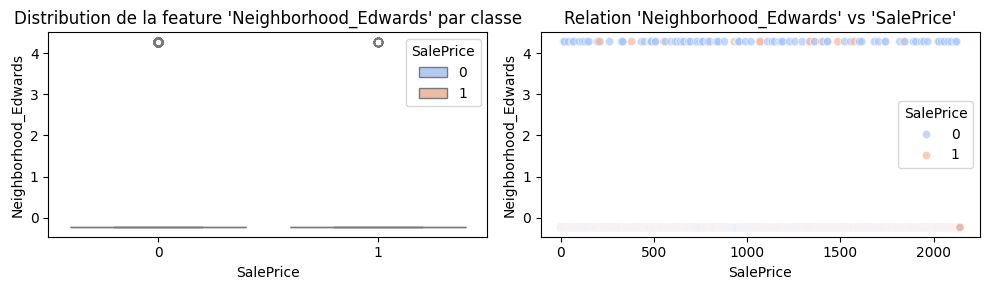

Neighborhood_Gilbert vs SalePrice : 0.19


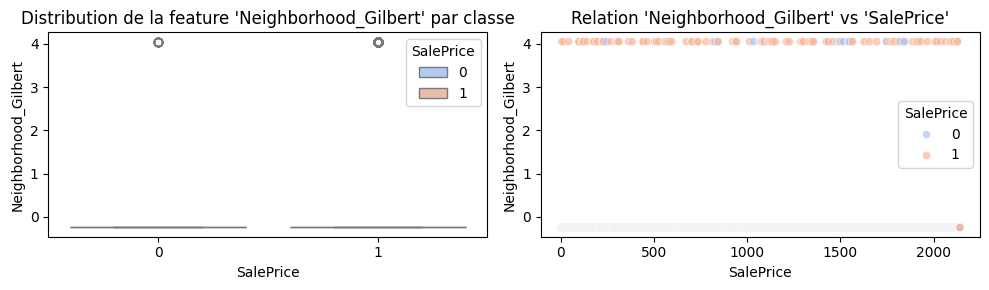

Neighborhood_Greens vs SalePrice : 0.04


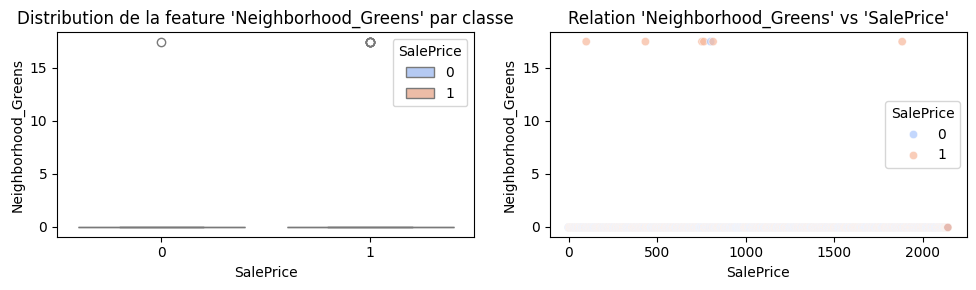

Neighborhood_GrnHill vs SalePrice : 0.02


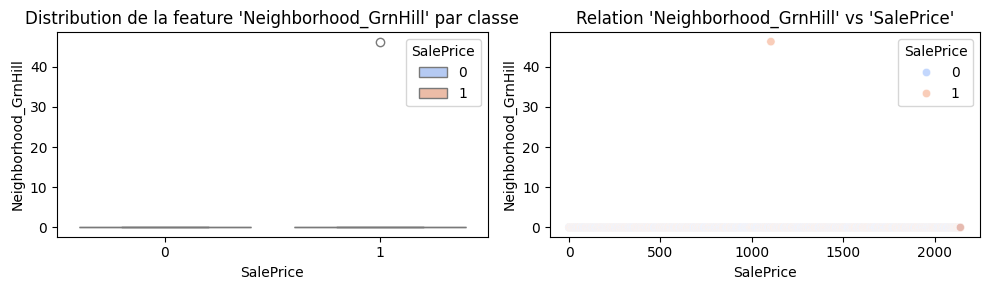

Neighborhood_IDOTRR vs SalePrice : -0.15


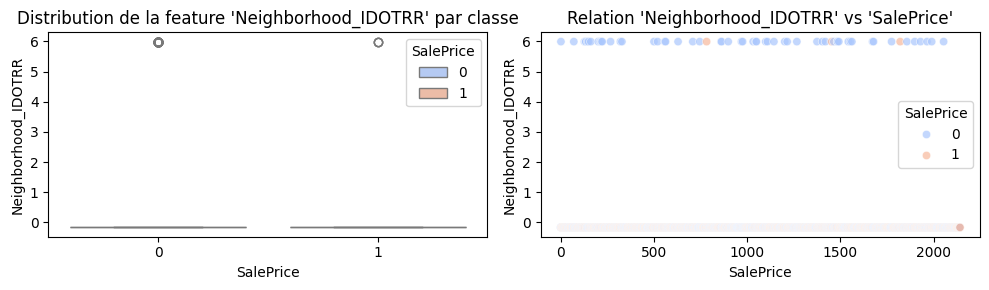

Neighborhood_Landmrk vs SalePrice : -0.02


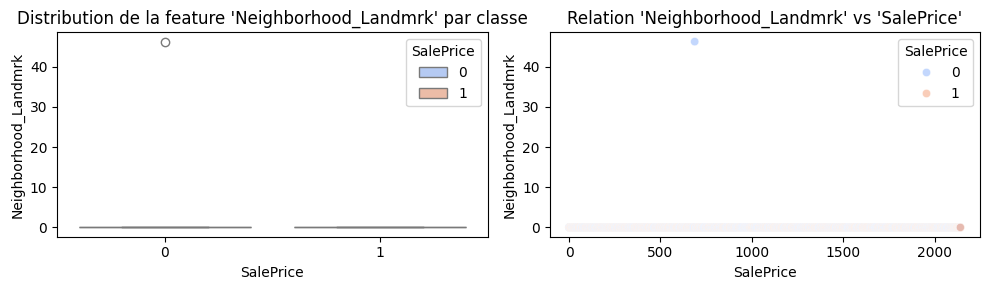

Neighborhood_MeadowV vs SalePrice : -0.10


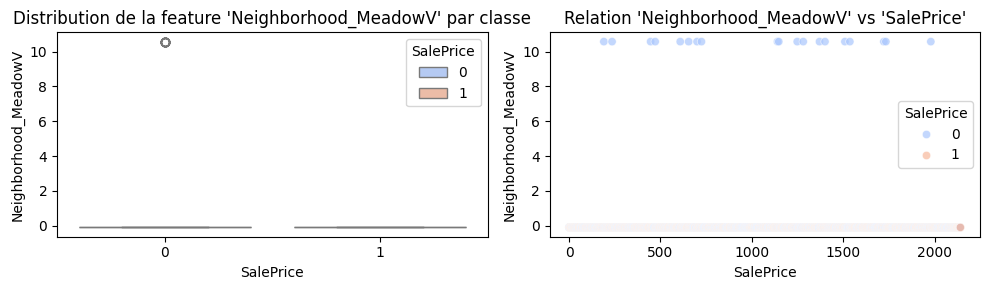

Neighborhood_Mitchel vs SalePrice : -0.06


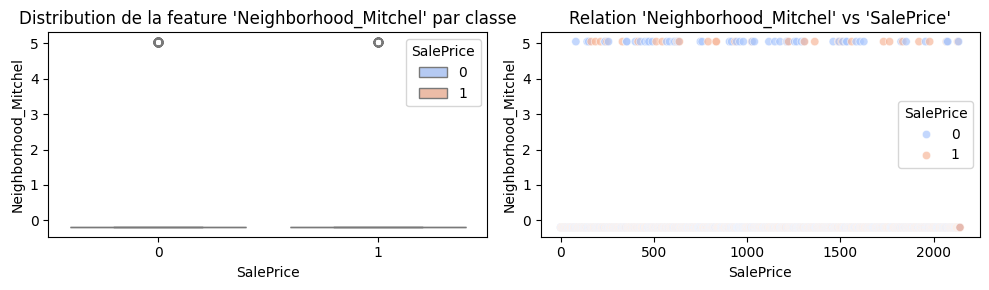

Neighborhood_NAmes vs SalePrice : -0.29


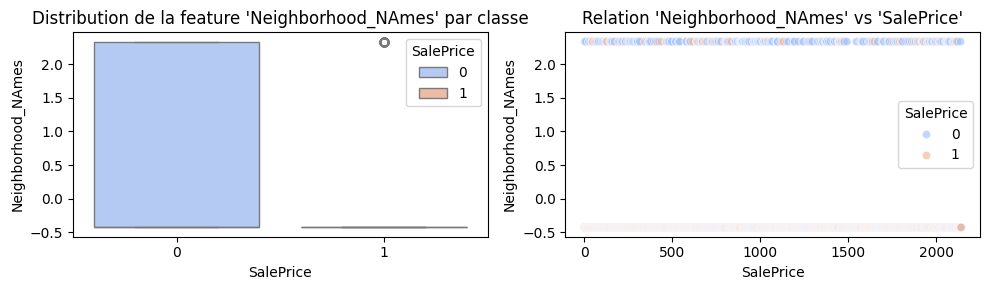

Neighborhood_NPkVill vs SalePrice : -0.09


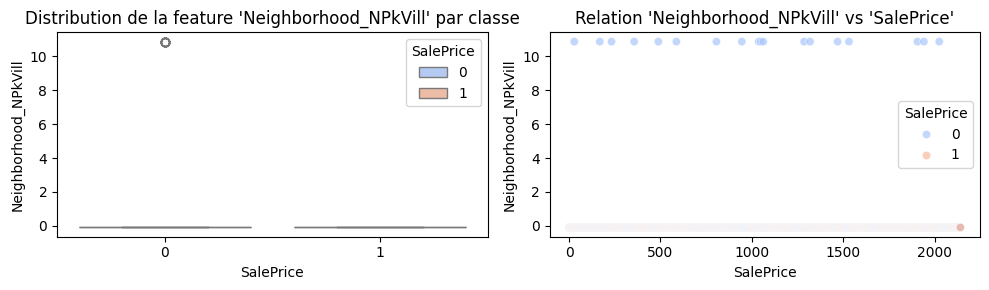

Neighborhood_NWAmes vs SalePrice : 0.09


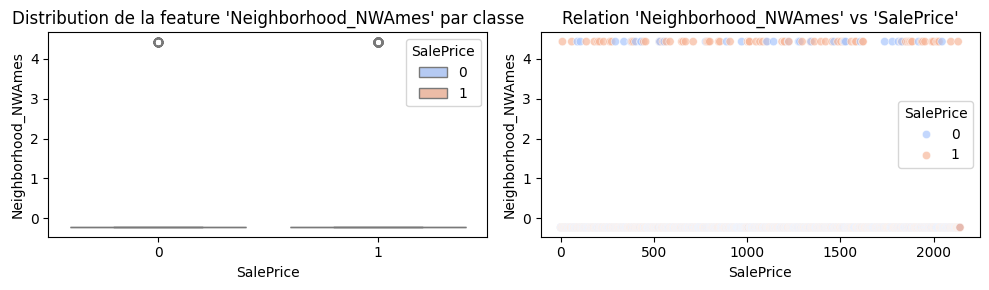

Neighborhood_NoRidge vs SalePrice : 0.16


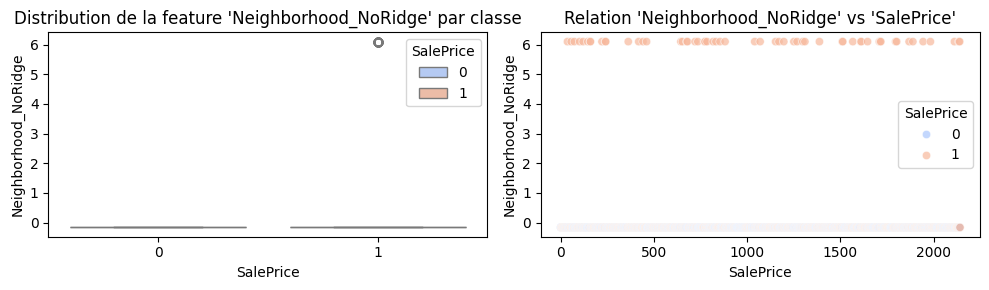

Neighborhood_NridgHt vs SalePrice : 0.25


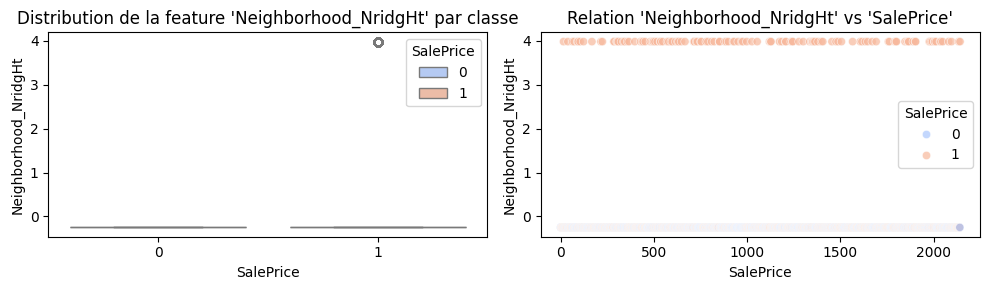

Neighborhood_OldTown vs SalePrice : -0.23


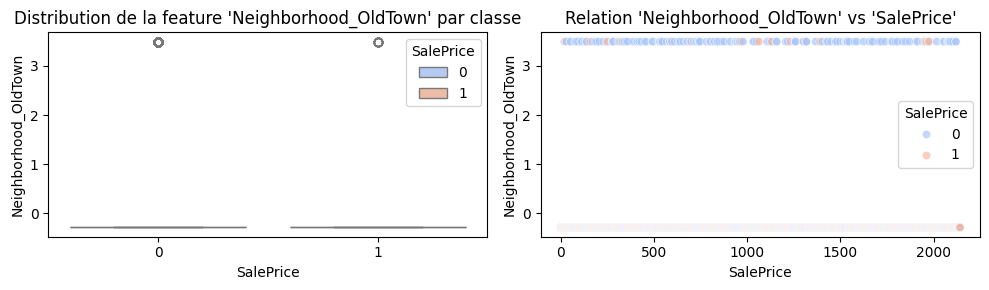

Neighborhood_SWISU vs SalePrice : -0.07


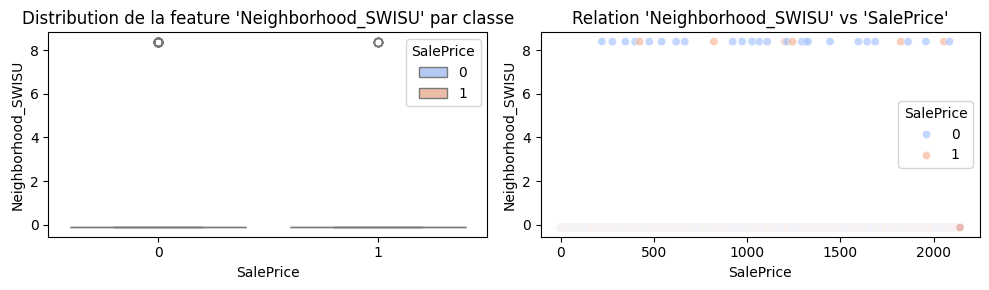

Neighborhood_Sawyer vs SalePrice : -0.19


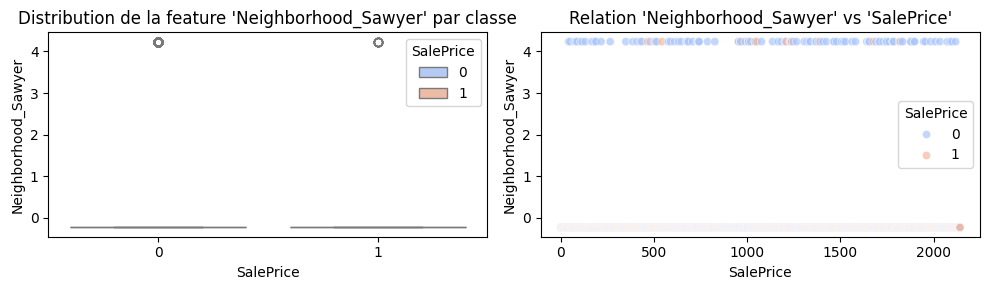

Neighborhood_SawyerW vs SalePrice : 0.09


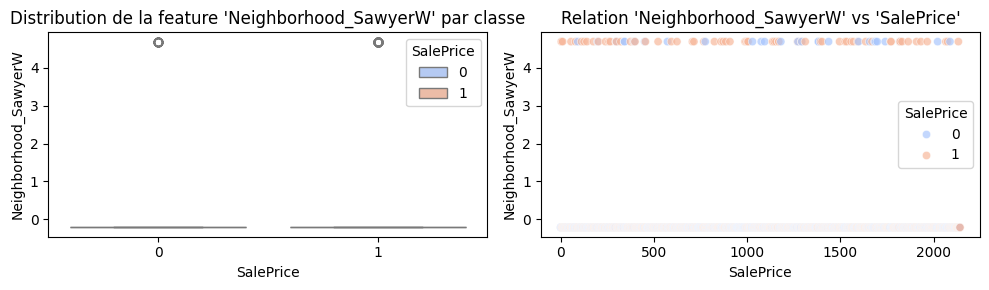

Neighborhood_Somerst vs SalePrice : 0.19


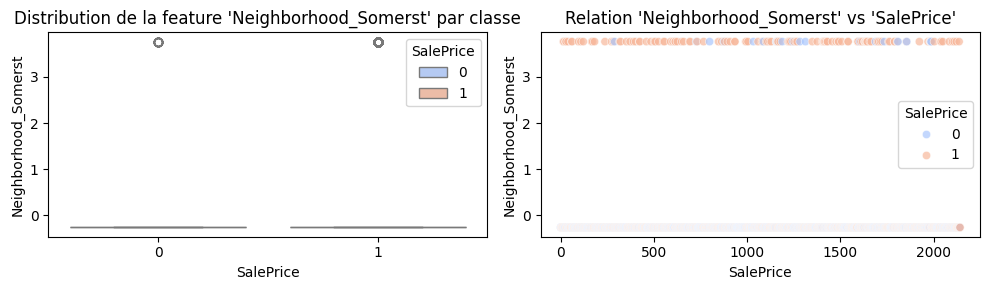

Neighborhood_StoneBr vs SalePrice : 0.13


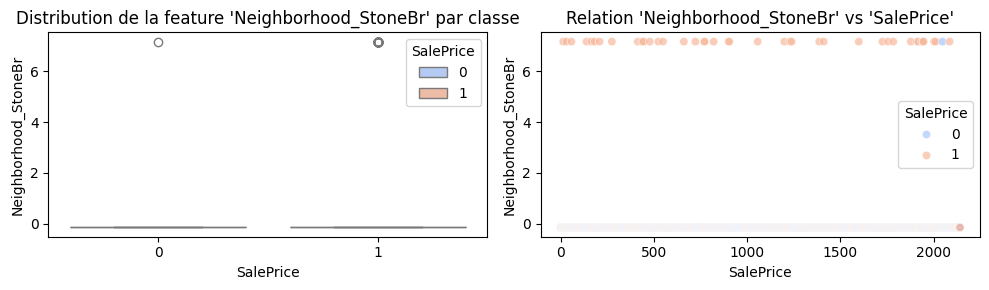

Neighborhood_Timber vs SalePrice : 0.15


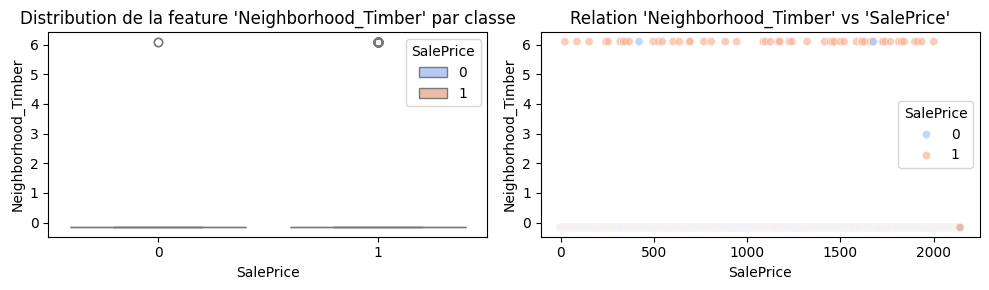

Neighborhood_Veenker vs SalePrice : 0.09


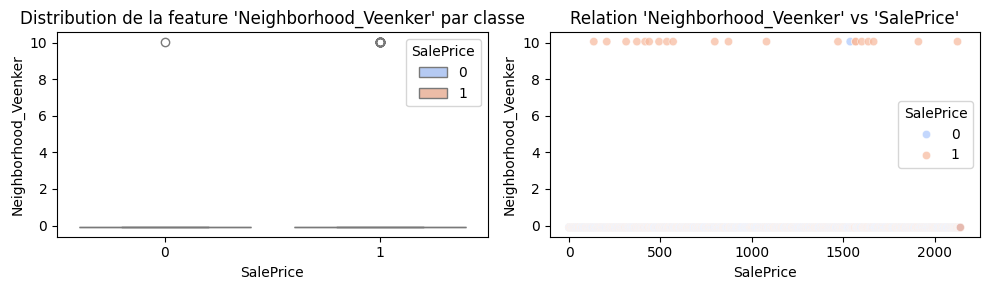

Condition 1_Feedr vs SalePrice : -0.11


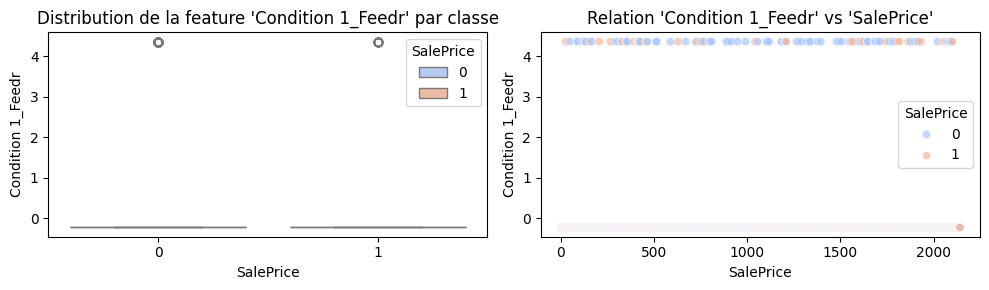

Condition 1_Norm vs SalePrice : 0.11


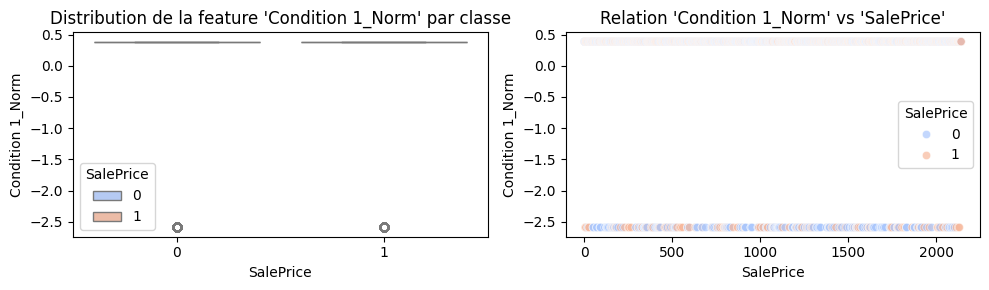

Condition 1_PosA vs SalePrice : 0.08


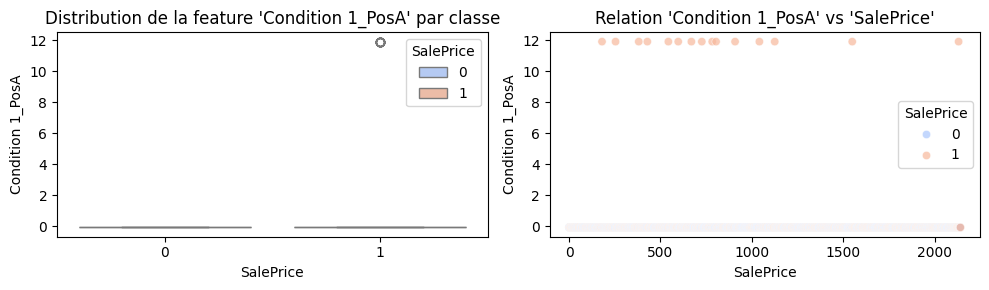

Condition 1_PosN vs SalePrice : 0.06


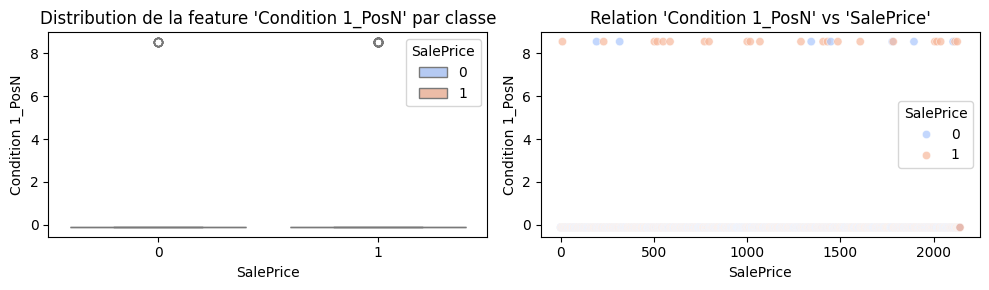

Condition 1_RRAe vs SalePrice : -0.07


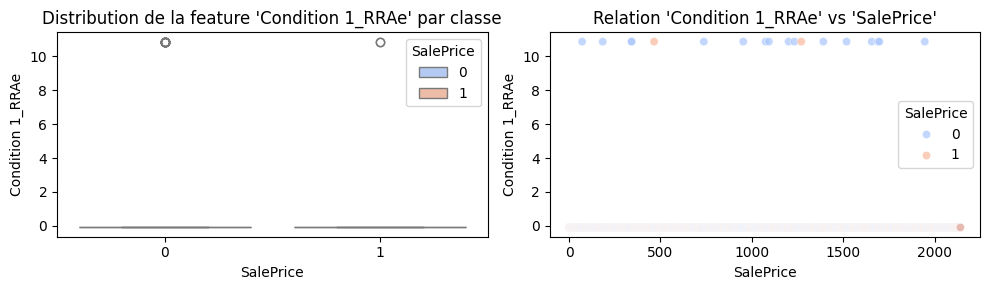

Condition 1_RRAn vs SalePrice : -0.00


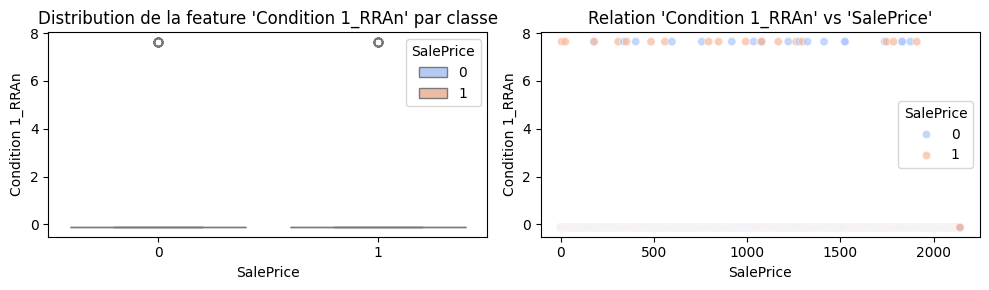

Condition 1_RRNe vs SalePrice : -0.00


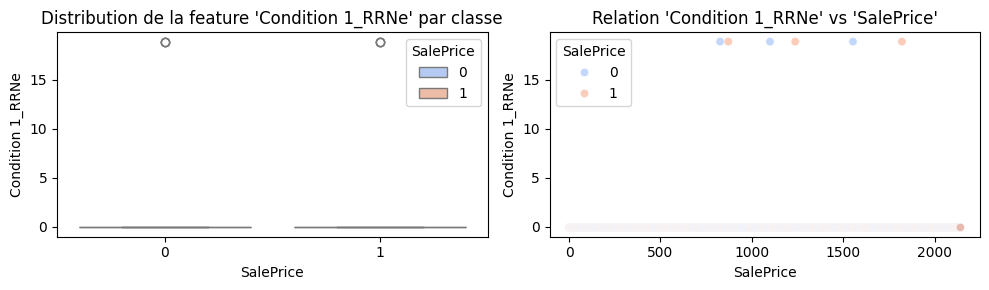

Condition 1_RRNn vs SalePrice : -0.00


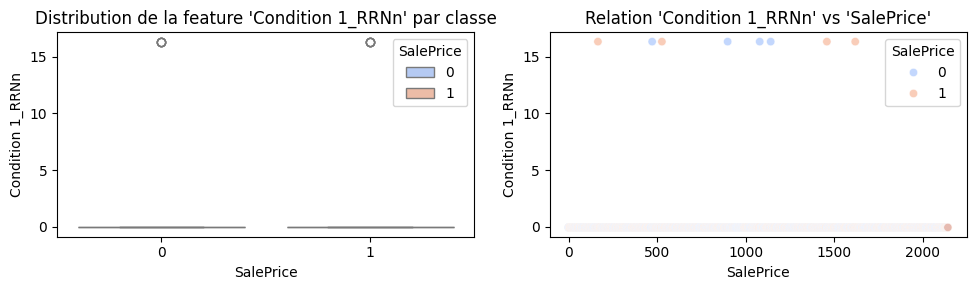

Condition 2_Feedr vs SalePrice : -0.05


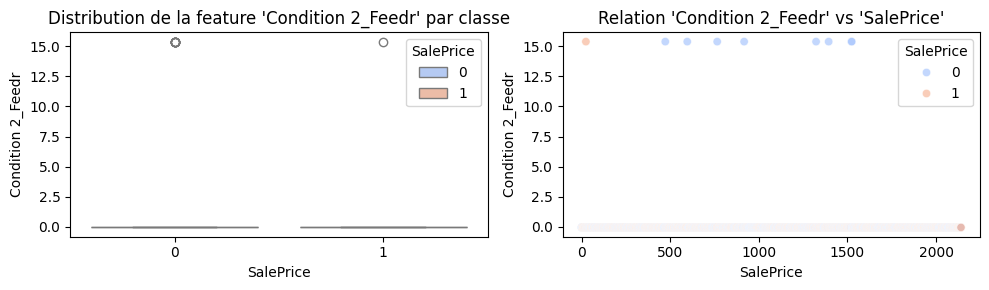

Condition 2_Norm vs SalePrice : 0.03


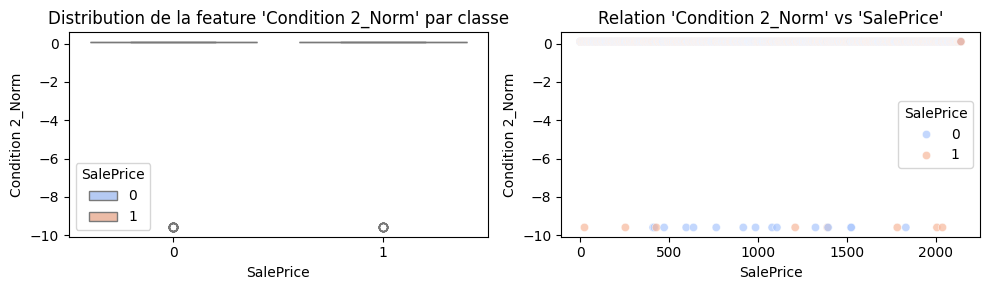

Condition 2_PosA vs SalePrice : 0.04


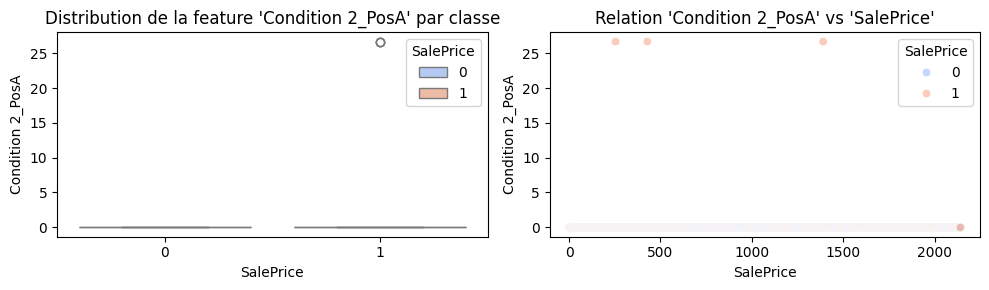

Condition 2_PosN vs SalePrice : 0.04


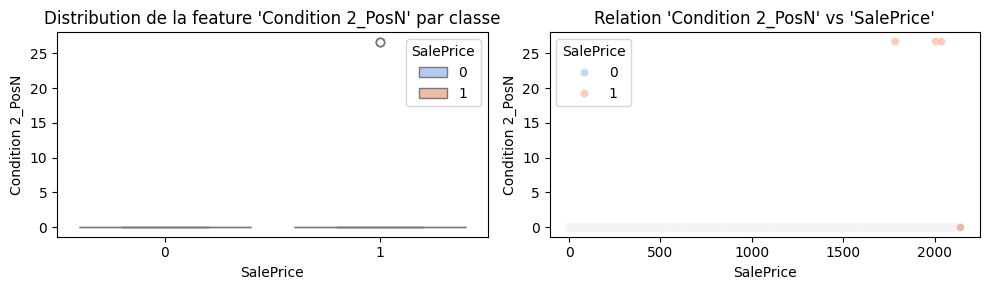

Condition 2_RRAe vs SalePrice : 0.02


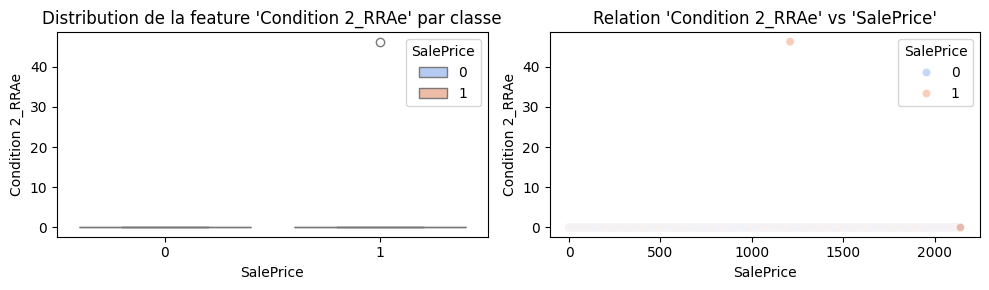

Condition 2_RRAn vs SalePrice : -0.02


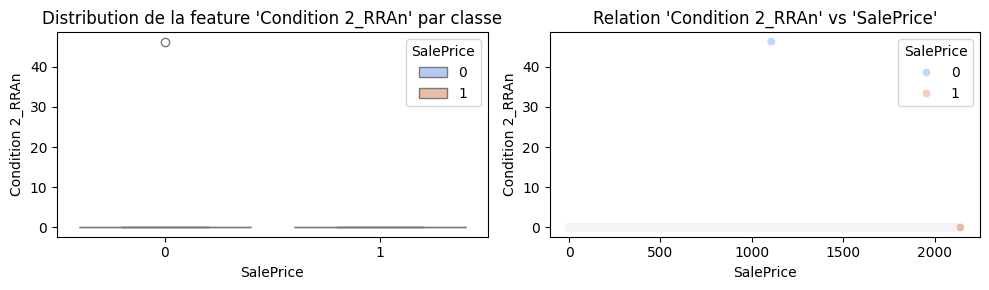

Condition 2_RRNn vs SalePrice : -0.03


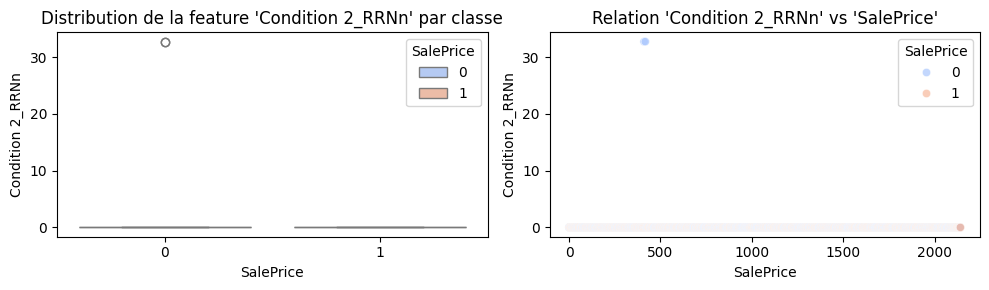

Bldg Type_2fmCon vs SalePrice : -0.10


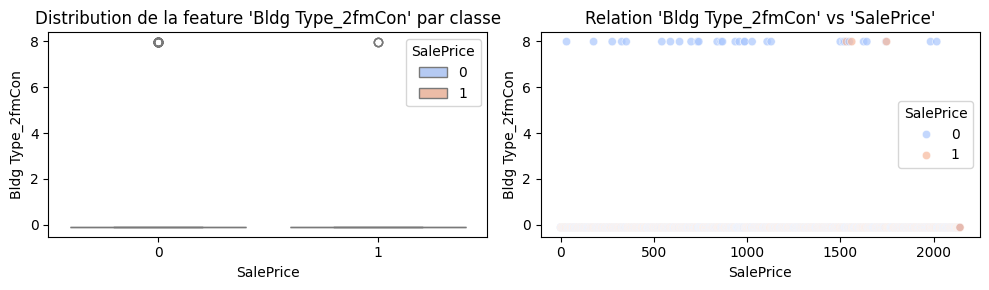

Bldg Type_Duplex vs SalePrice : -0.07


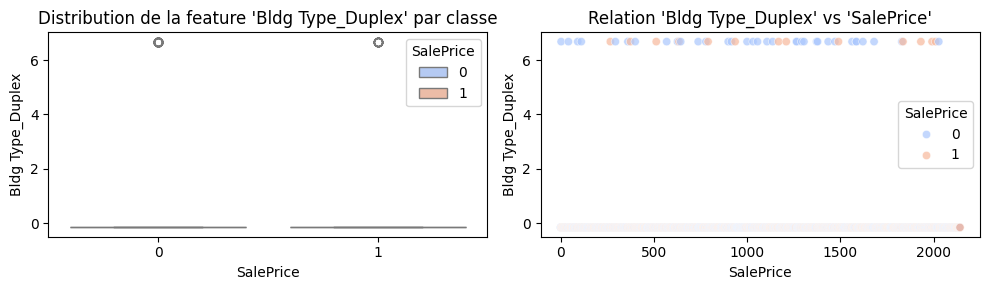

Bldg Type_Twnhs vs SalePrice : -0.09


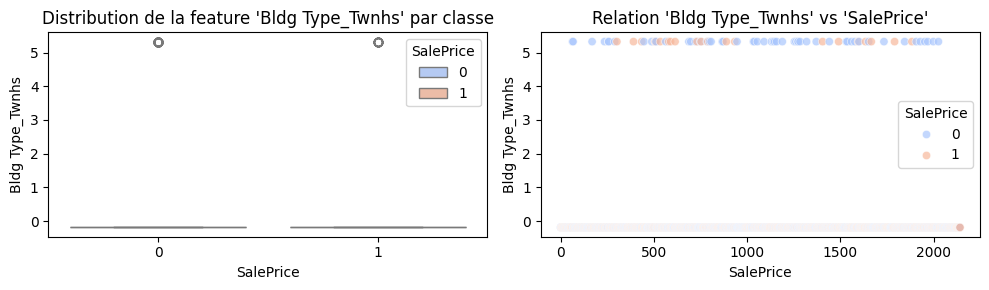

Bldg Type_TwnhsE vs SalePrice : 0.06


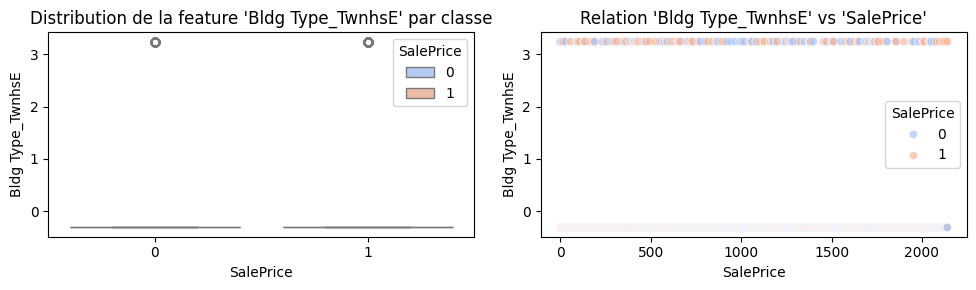

House Style_1.5Unf vs SalePrice : -0.08


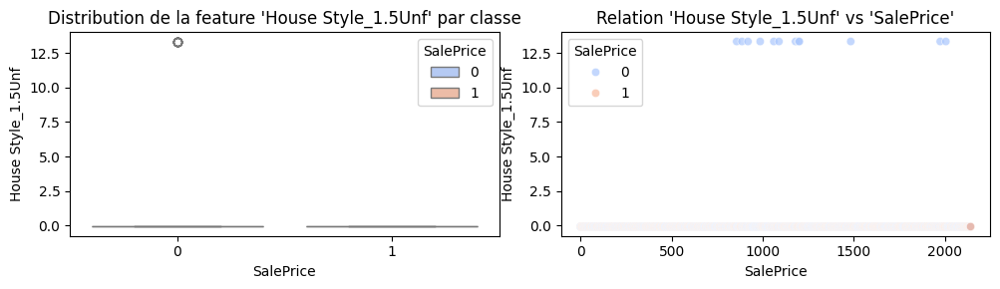

House Style_1Story vs SalePrice : -0.09


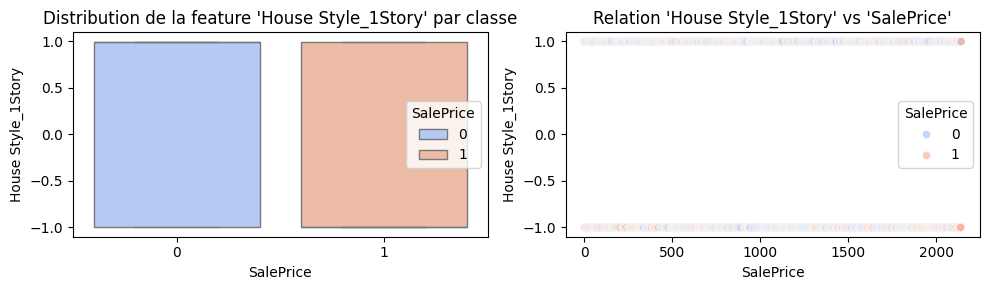

House Style_2.5Fin vs SalePrice : 0.03


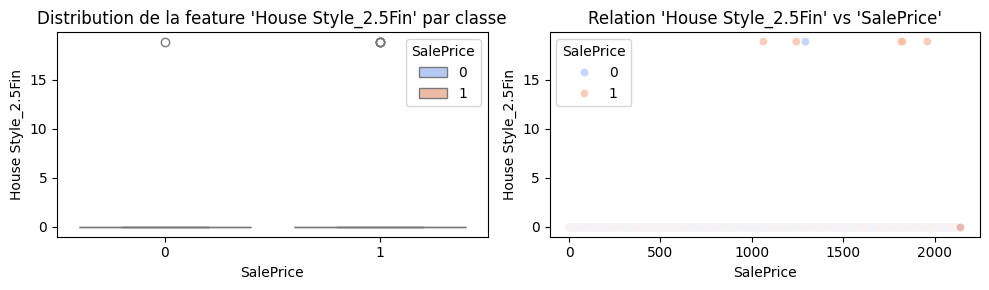

House Style_2.5Unf vs SalePrice : -0.02


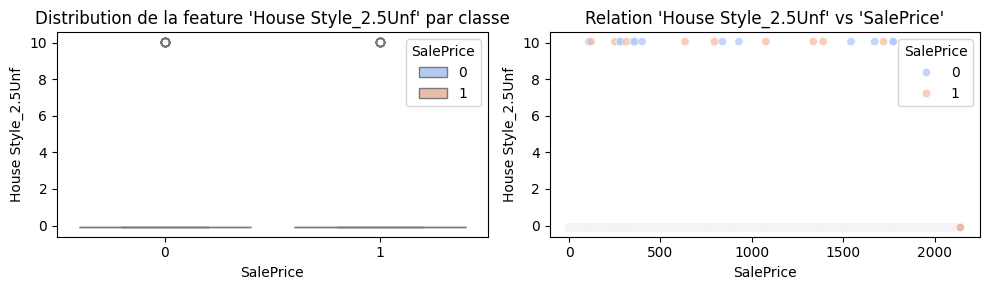

House Style_2Story vs SalePrice : 0.28


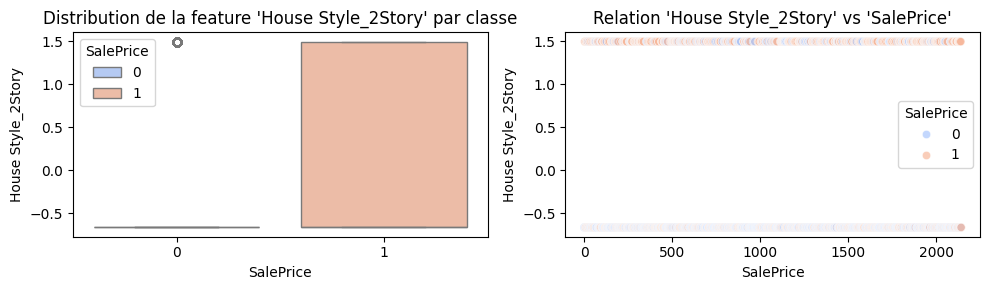

House Style_SFoyer vs SalePrice : -0.09


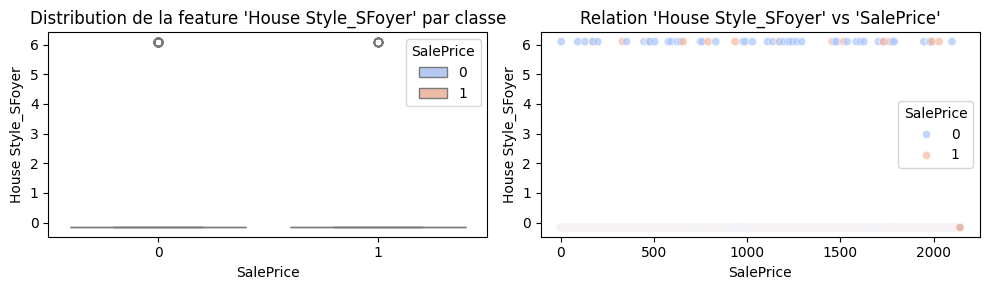

House Style_SLvl vs SalePrice : 0.00


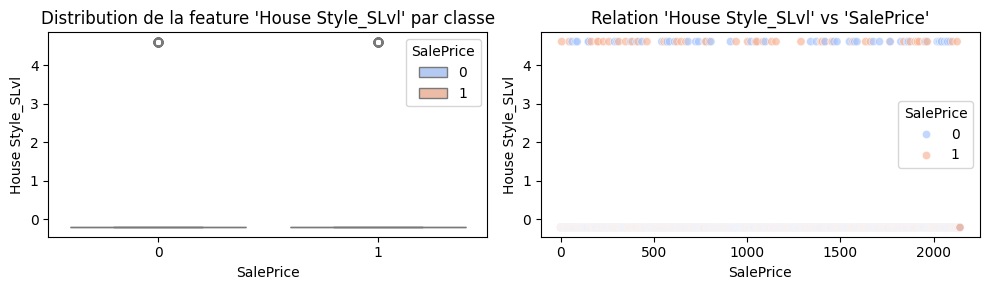

Roof Style_Gable vs SalePrice : -0.07


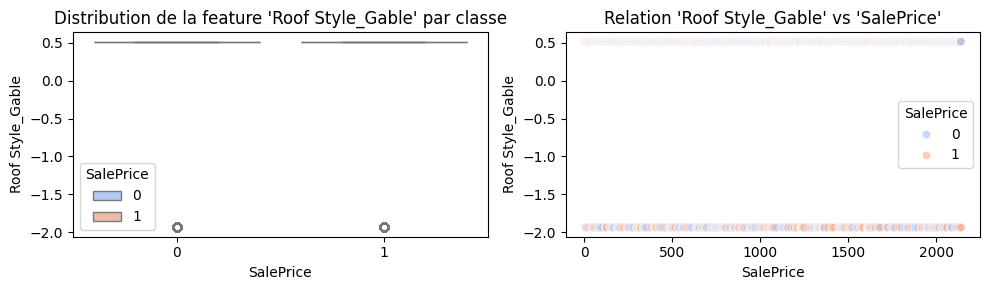

Roof Style_Gambrel vs SalePrice : -0.05


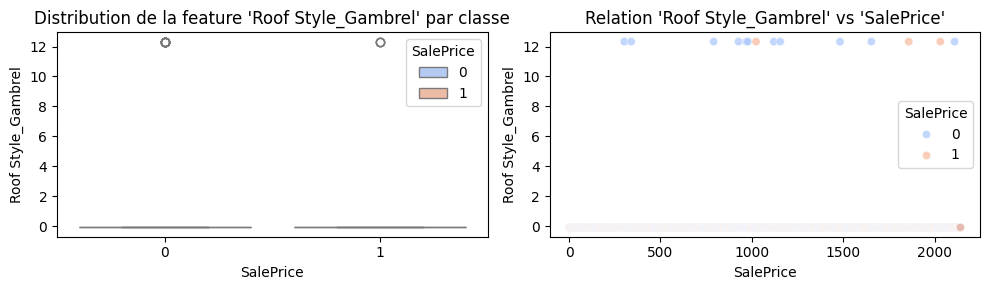

Roof Style_Hip vs SalePrice : 0.07


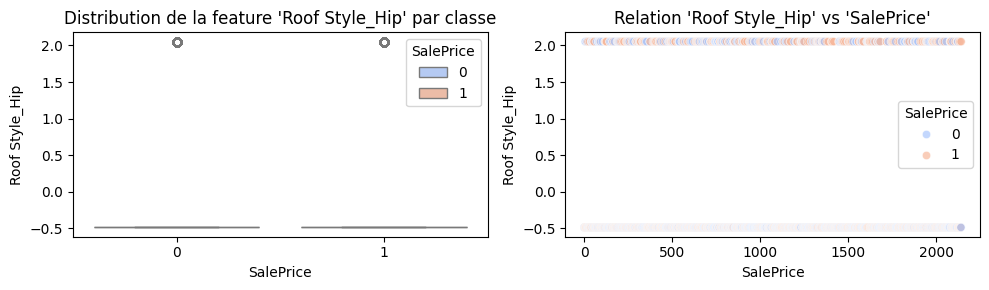

Roof Style_Mansard vs SalePrice : 0.01


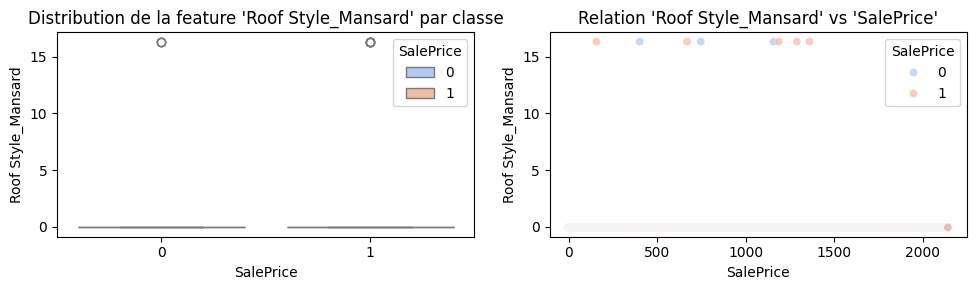

Roof Style_Shed vs SalePrice : 0.02


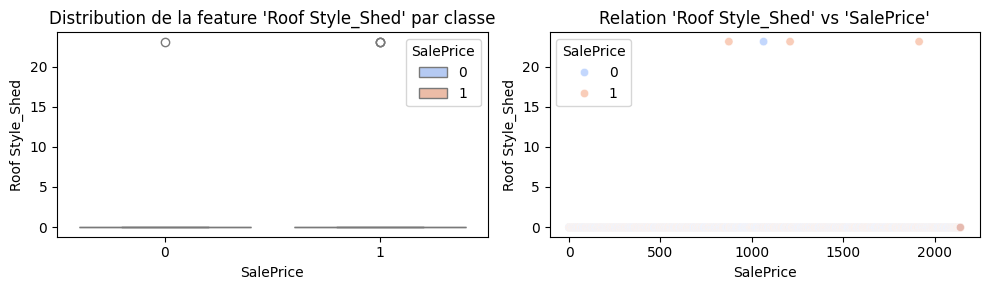

Roof Matl_CompShg vs SalePrice : -0.06


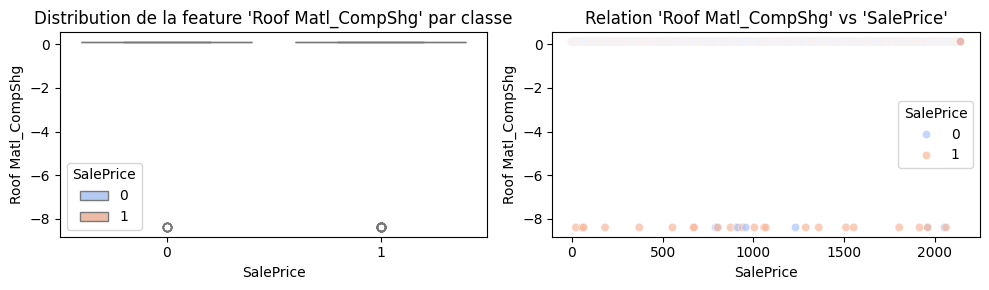

Roof Matl_Membran vs SalePrice : 0.02


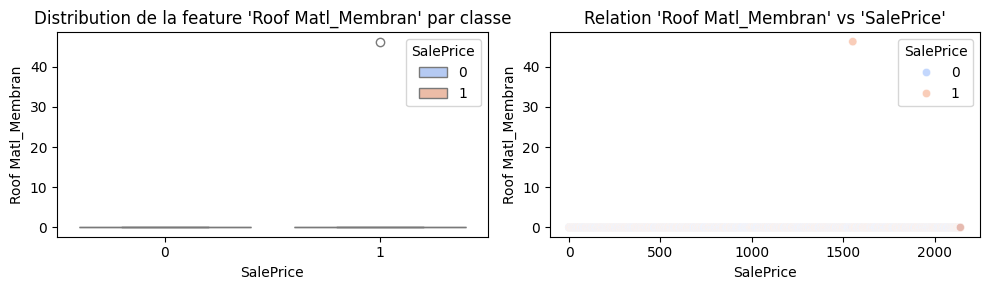

Roof Matl_Metal vs SalePrice : 0.02


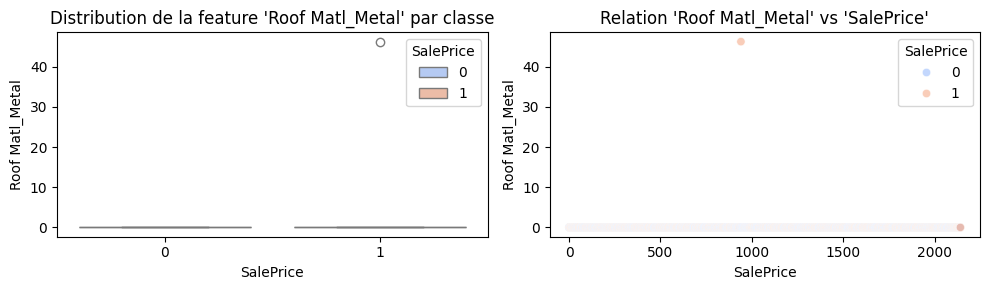

Roof Matl_Roll vs SalePrice : -0.02


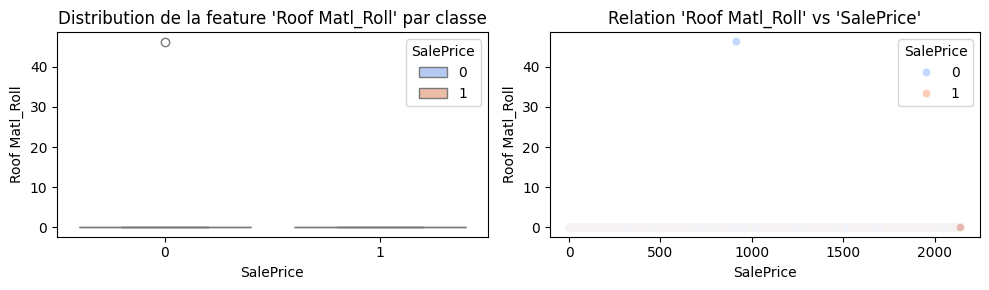

Roof Matl_Tar&Grv vs SalePrice : 0.02


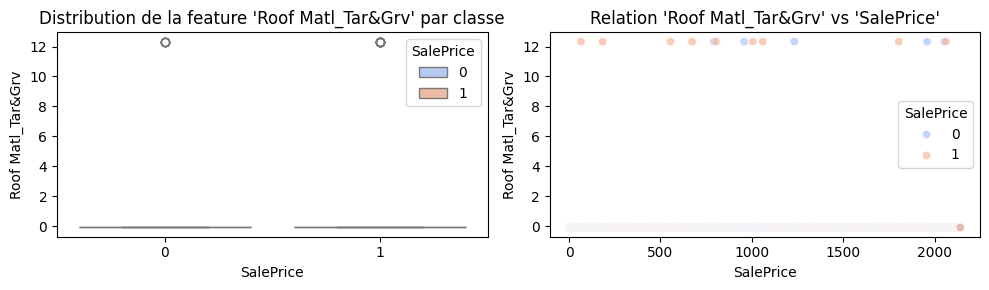

Roof Matl_WdShake vs SalePrice : 0.06


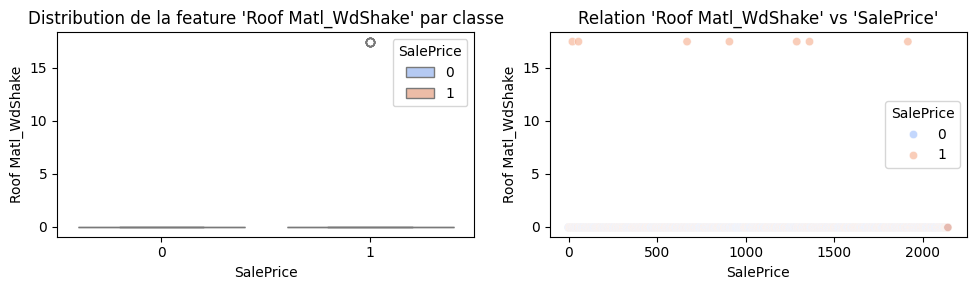

Roof Matl_WdShngl vs SalePrice : 0.05


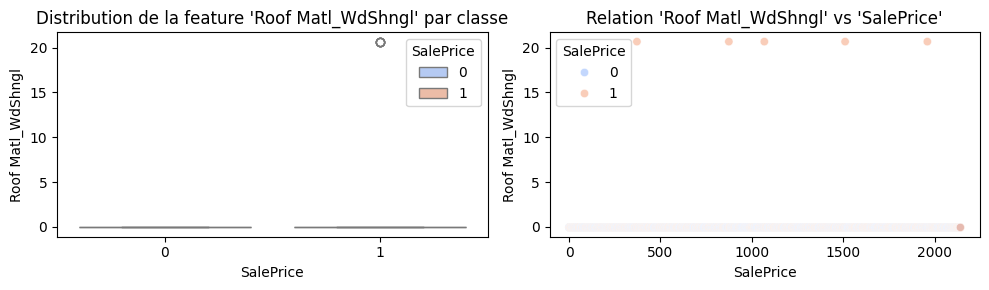

Exterior 1st_BrkComm vs SalePrice : -0.00


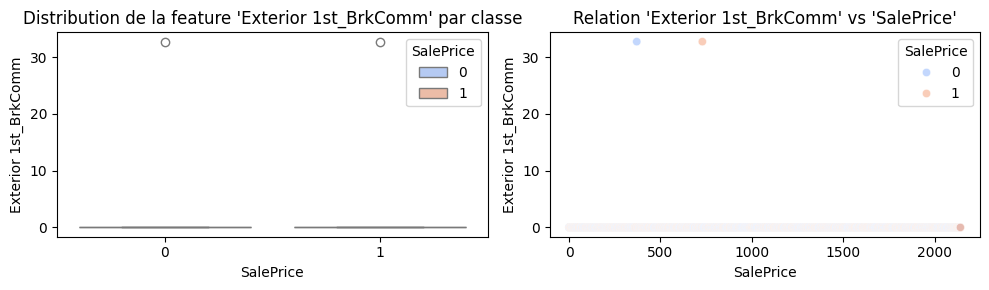

Exterior 1st_BrkFace vs SalePrice : 0.02


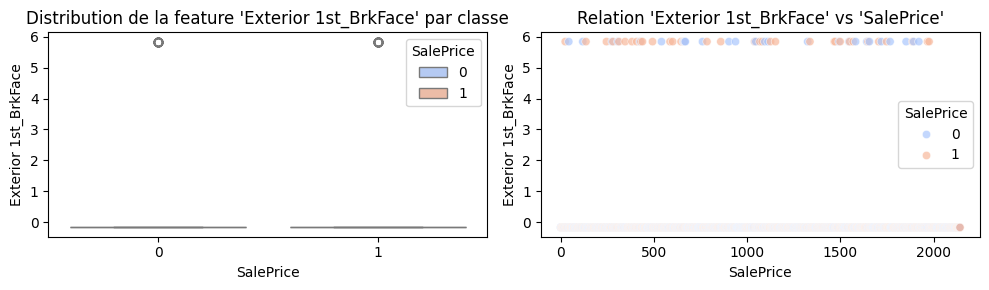

Exterior 1st_CBlock vs SalePrice : -0.02


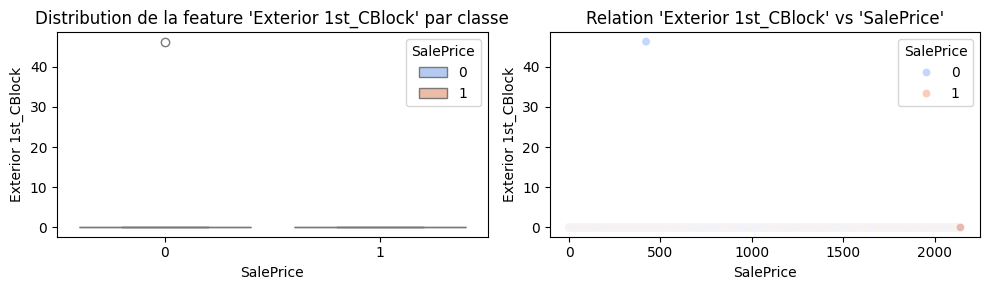

Exterior 1st_CemntBd vs SalePrice : 0.09


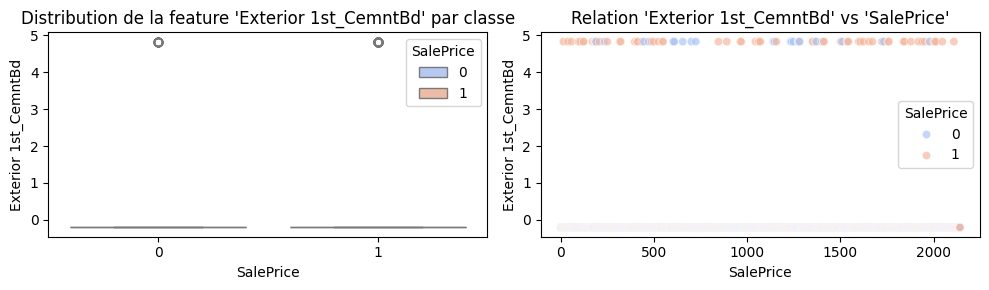

Exterior 1st_HdBoard vs SalePrice : -0.11


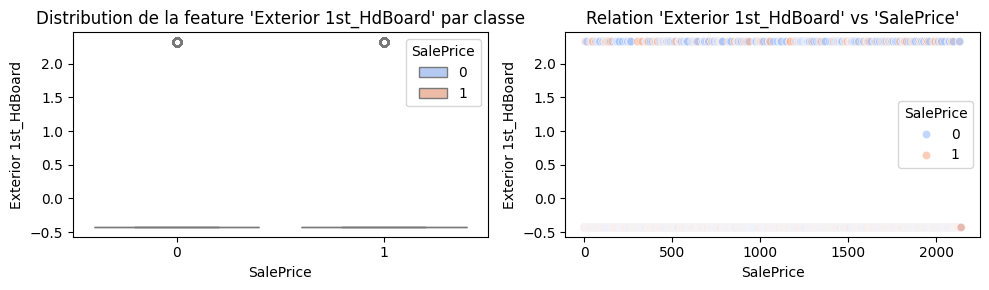

Exterior 1st_ImStucc vs SalePrice : 0.02


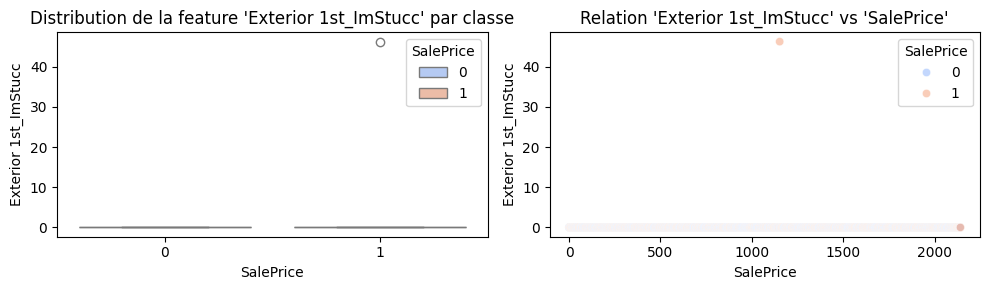

Exterior 1st_MetalSd vs SalePrice : -0.20


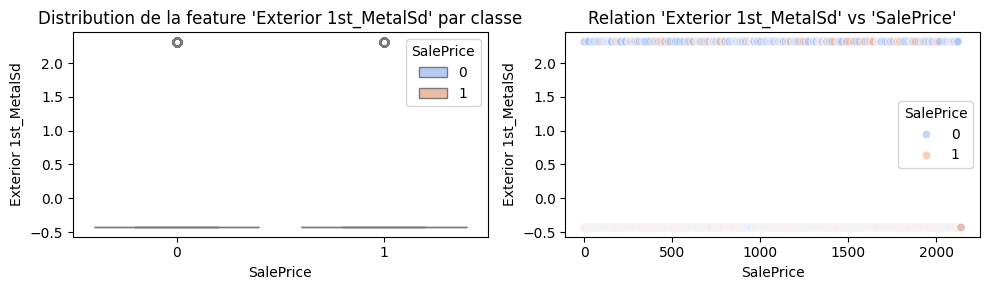

Exterior 1st_Plywood vs SalePrice : -0.04


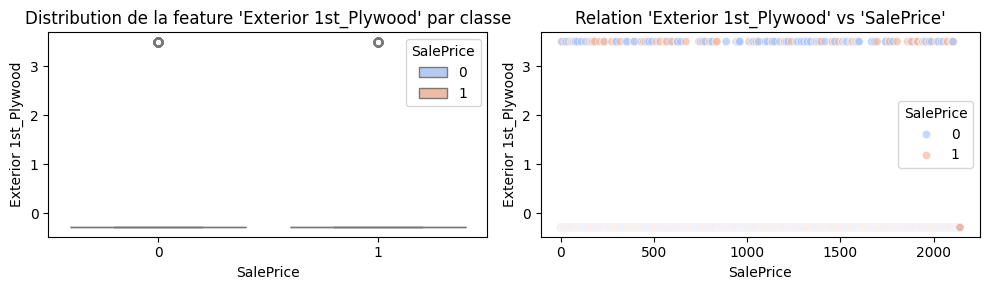

Exterior 1st_Stone vs SalePrice : 0.03


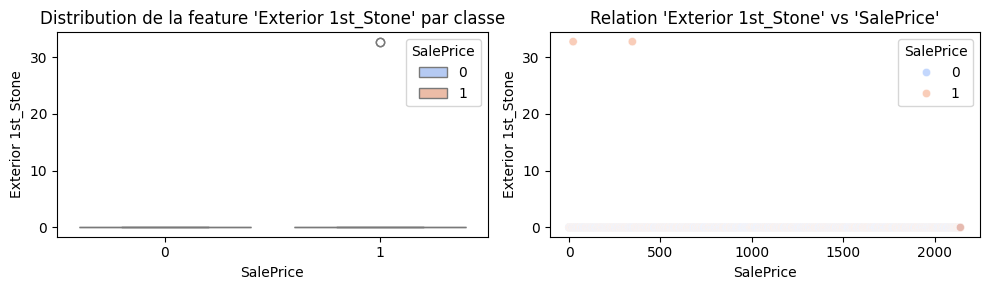

Exterior 1st_Stucco vs SalePrice : -0.06


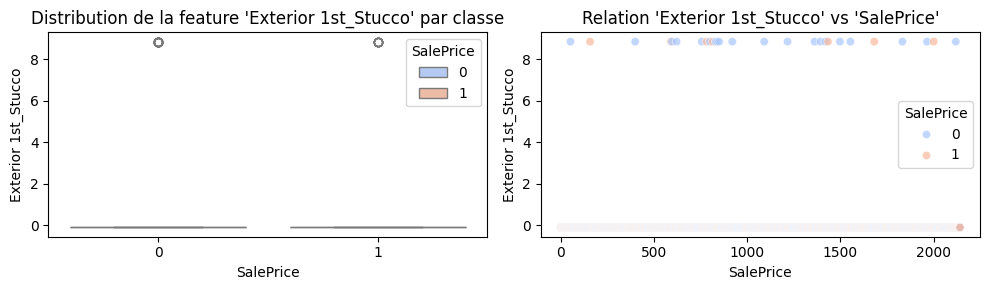

Exterior 1st_VinylSd vs SalePrice : 0.40


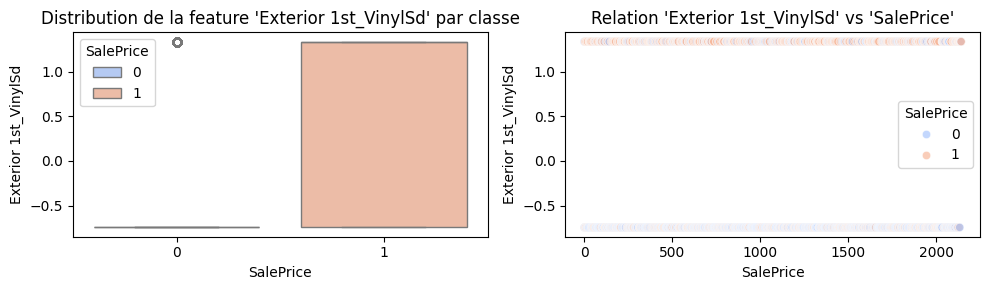

Exterior 1st_Wd Sdng vs SalePrice : -0.19


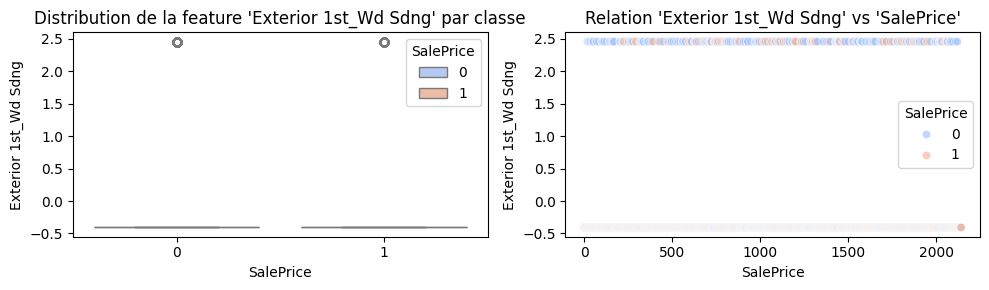

Exterior 1st_WdShing vs SalePrice : -0.04


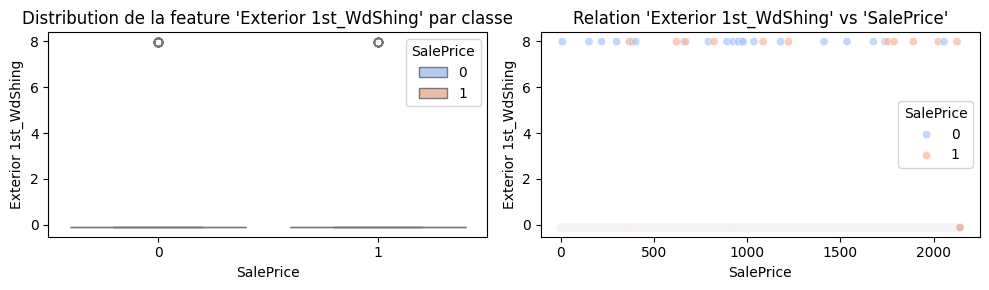

Exterior 2nd_AsphShn vs SalePrice : -0.00


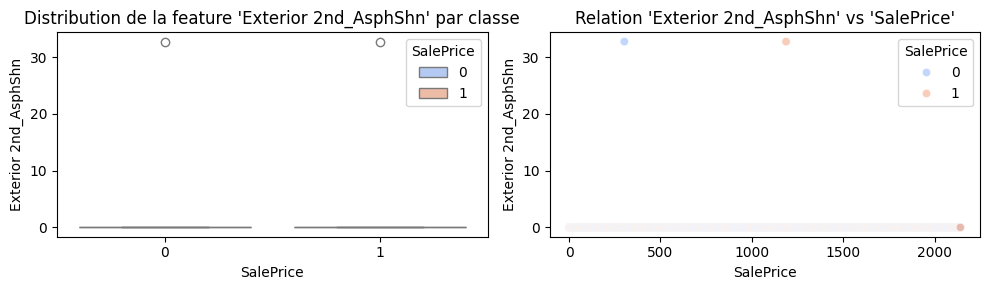

Exterior 2nd_Brk Cmn vs SalePrice : -0.08


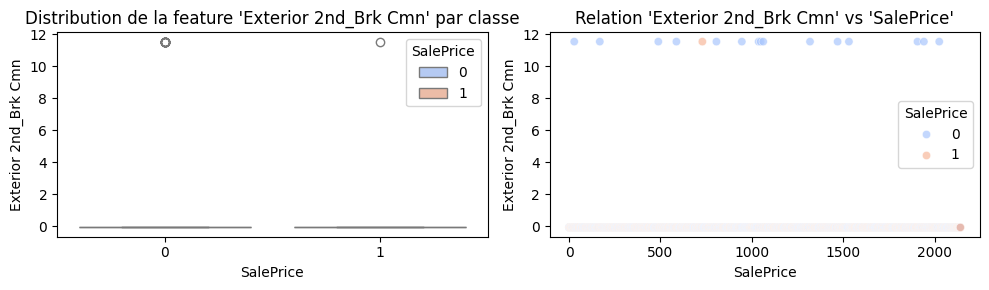

Exterior 2nd_BrkFace vs SalePrice : -0.01


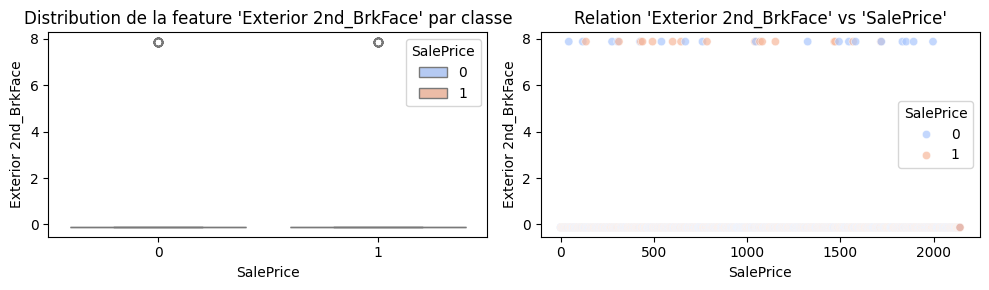

Exterior 2nd_CBlock vs SalePrice : -0.02


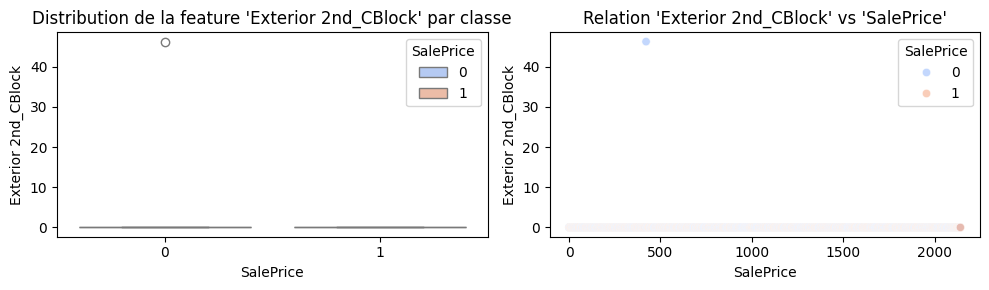

Exterior 2nd_CmentBd vs SalePrice : 0.09


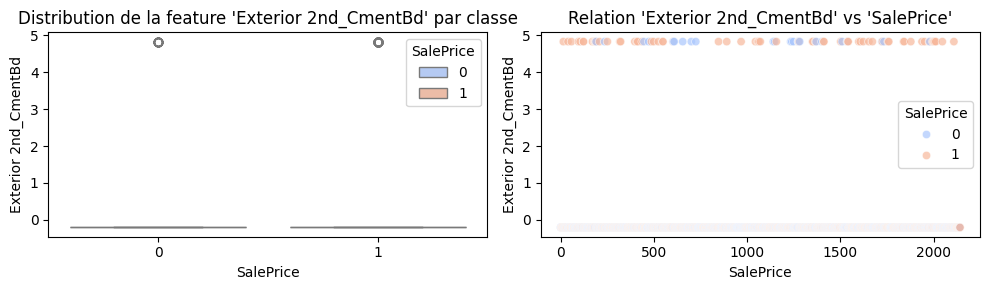

Exterior 2nd_HdBoard vs SalePrice : -0.09


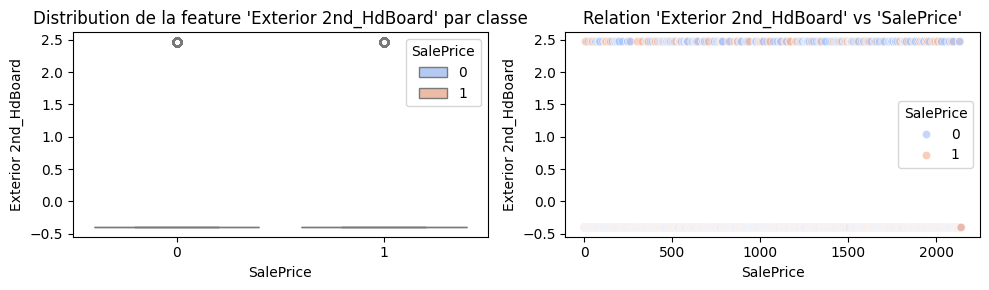

Exterior 2nd_ImStucc vs SalePrice : 0.01


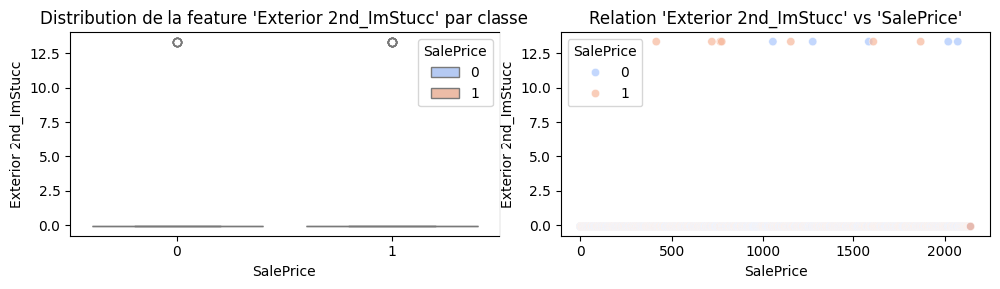

Exterior 2nd_MetalSd vs SalePrice : -0.20


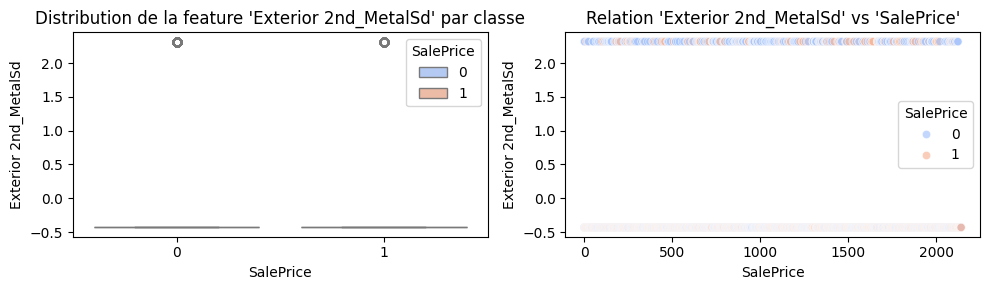

Exterior 2nd_Other vs SalePrice : 0.02


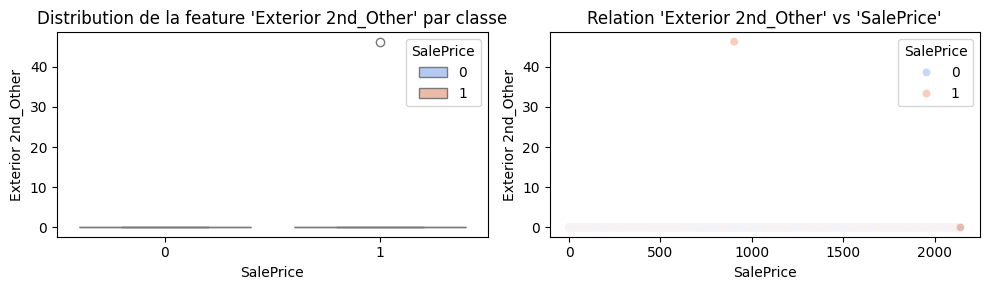

Exterior 2nd_Plywood vs SalePrice : -0.04


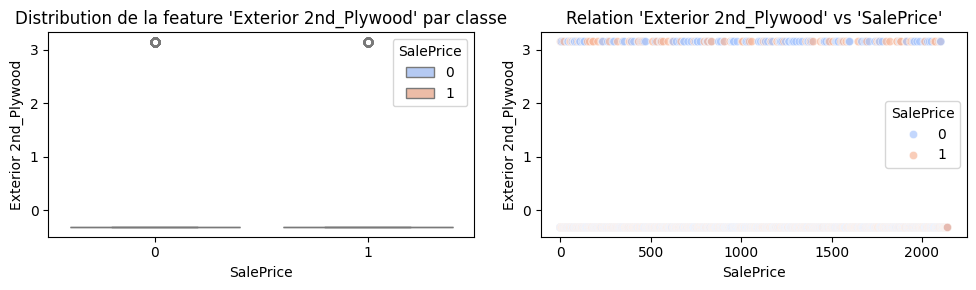

Exterior 2nd_Stone vs SalePrice : 0.03


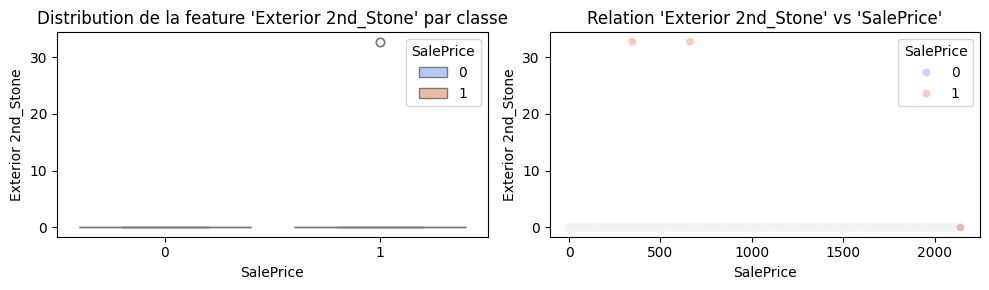

Exterior 2nd_Stucco vs SalePrice : -0.04


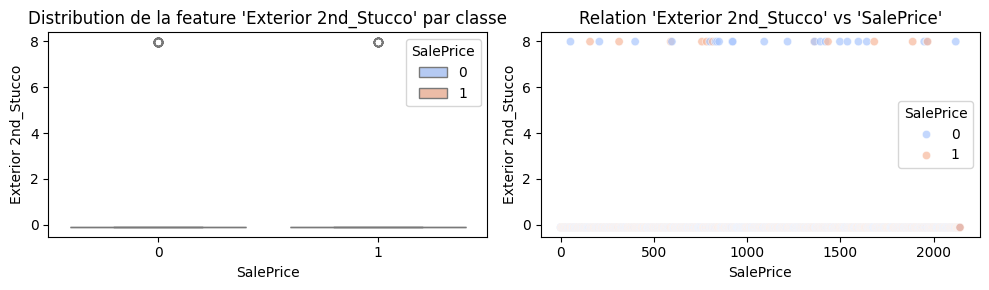

Exterior 2nd_VinylSd vs SalePrice : 0.40


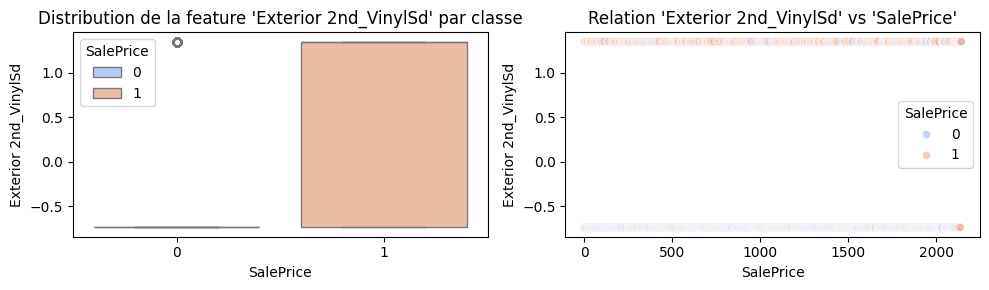

Exterior 2nd_Wd Sdng vs SalePrice : -0.19


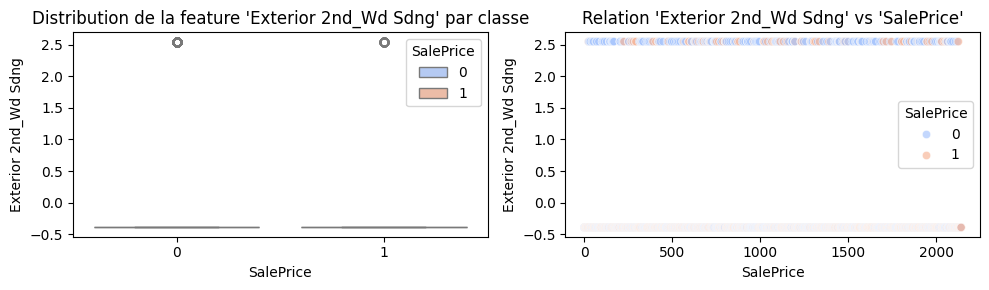

Exterior 2nd_Wd Shng vs SalePrice : -0.04


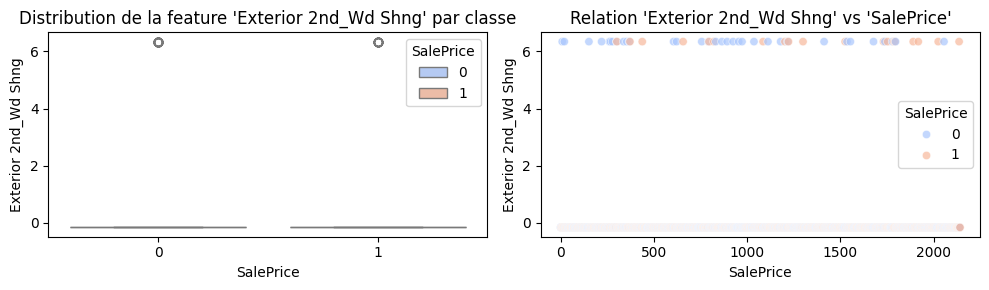

Exter Qual_Fa vs SalePrice : -0.08


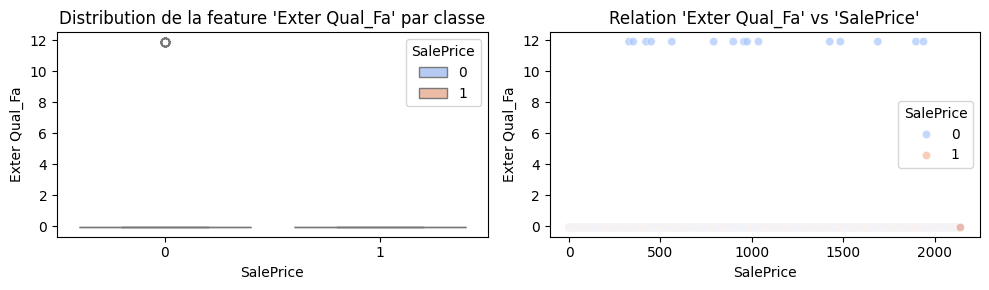

Exter Qual_Gd vs SalePrice : 0.57


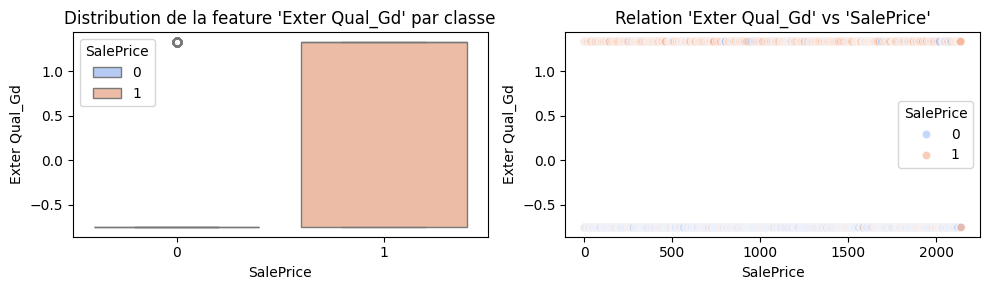

Exter Qual_TA vs SalePrice : -0.61


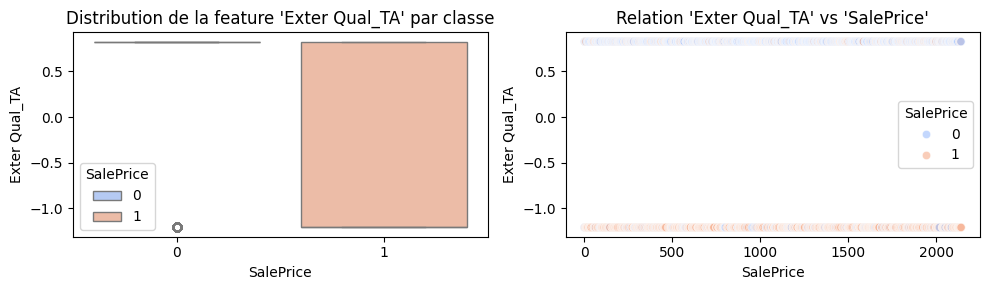

Exter Cond_Fa vs SalePrice : -0.08


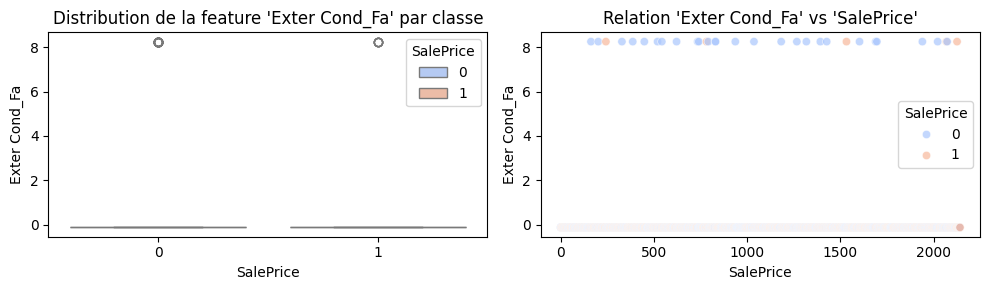

Exter Cond_Gd vs SalePrice : -0.06


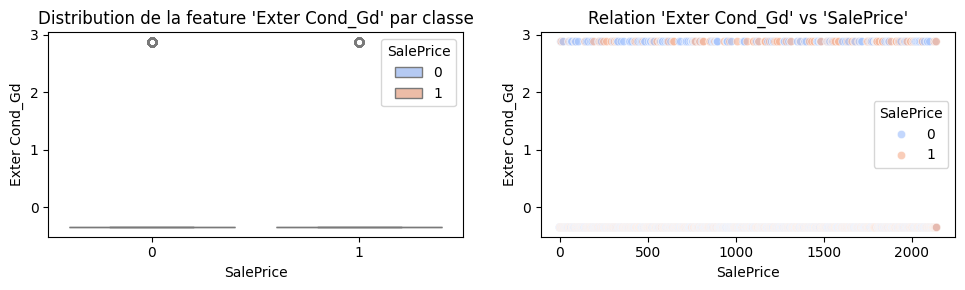

Exter Cond_Po vs SalePrice : -0.02


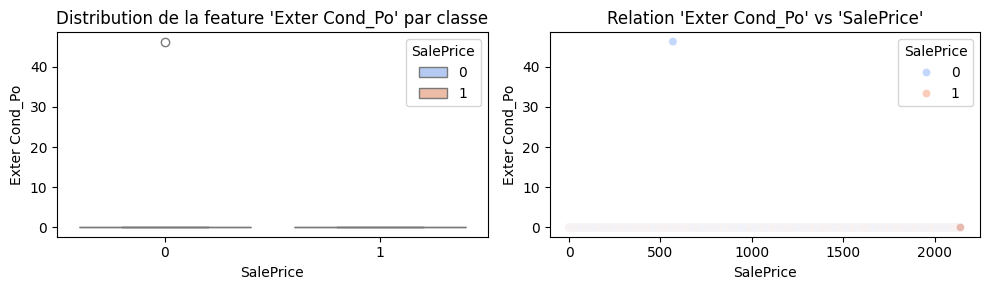

Exter Cond_TA vs SalePrice : 0.09


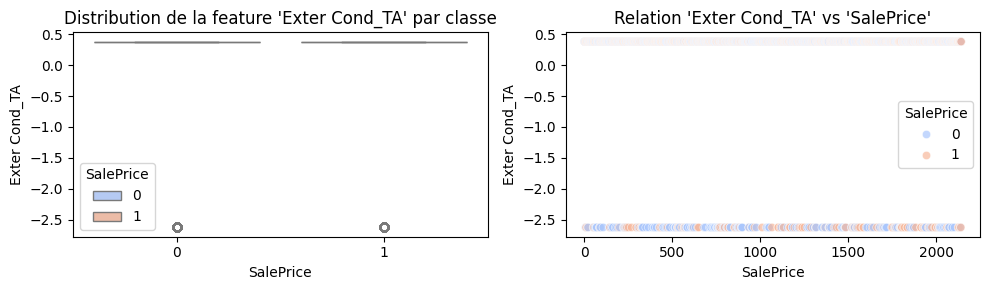

Foundation_CBlock vs SalePrice : -0.43


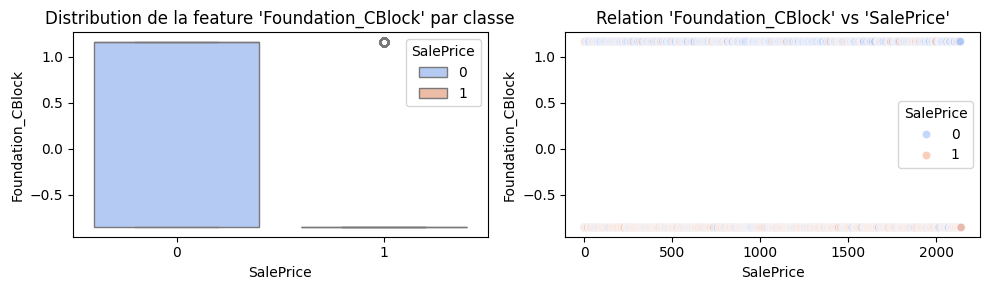

Foundation_PConc vs SalePrice : 0.58


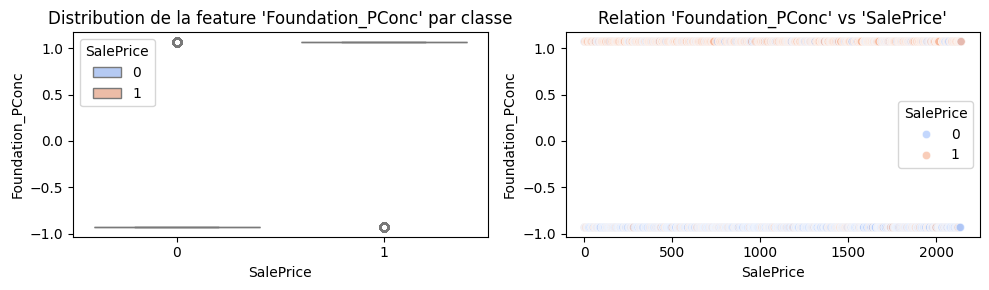

Foundation_Stone vs SalePrice : -0.03


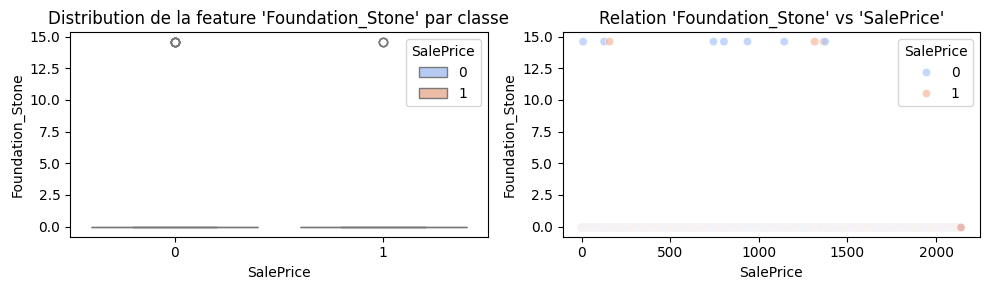

Foundation_Wood vs SalePrice : -0.01


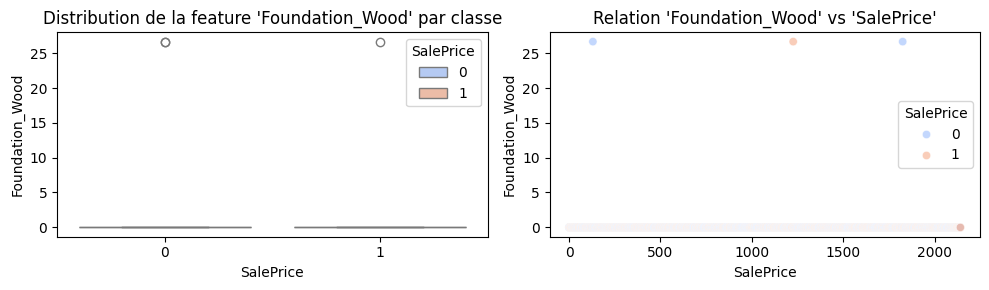

Bsmt Qual_Fa vs SalePrice : -0.15


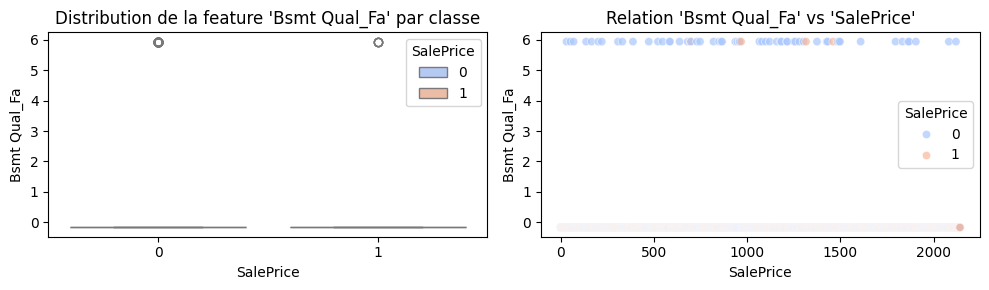

Bsmt Qual_Gd vs SalePrice : 0.43


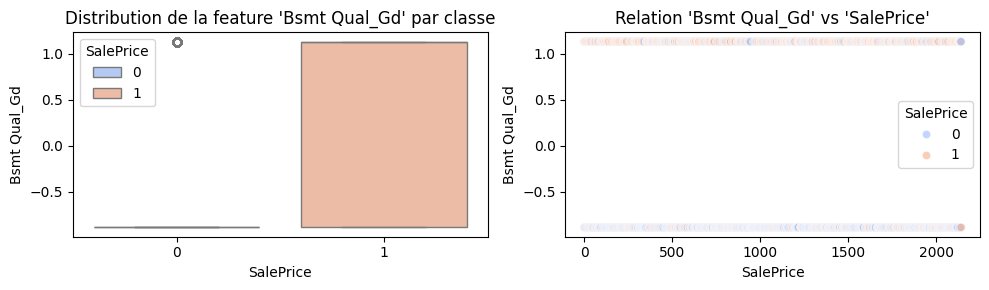

Bsmt Qual_Po vs SalePrice : -0.03


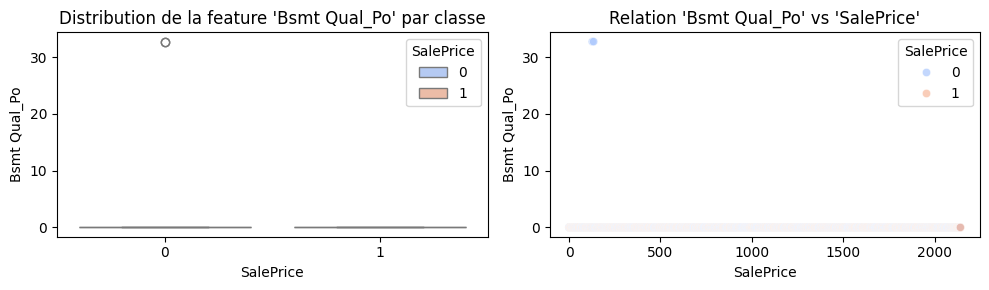

Bsmt Qual_TA vs SalePrice : -0.56


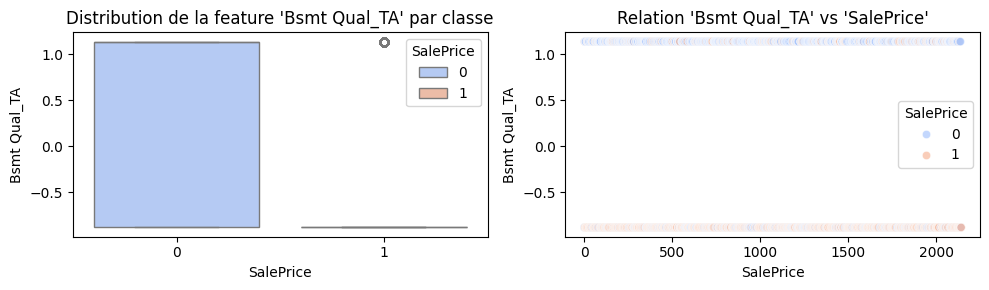

Bsmt Cond_Fa vs SalePrice : -0.13


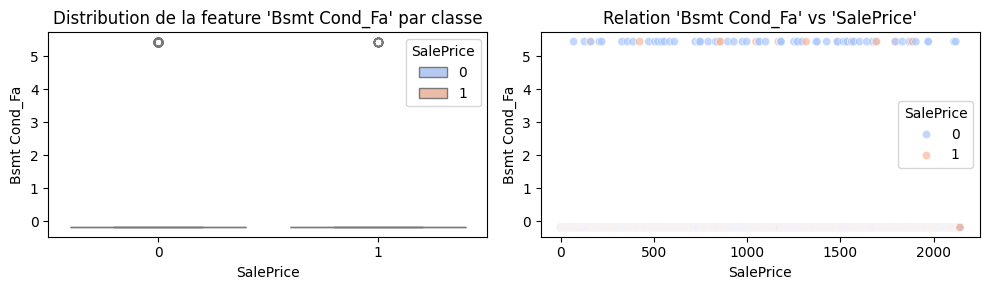

Bsmt Cond_Gd vs SalePrice : 0.08


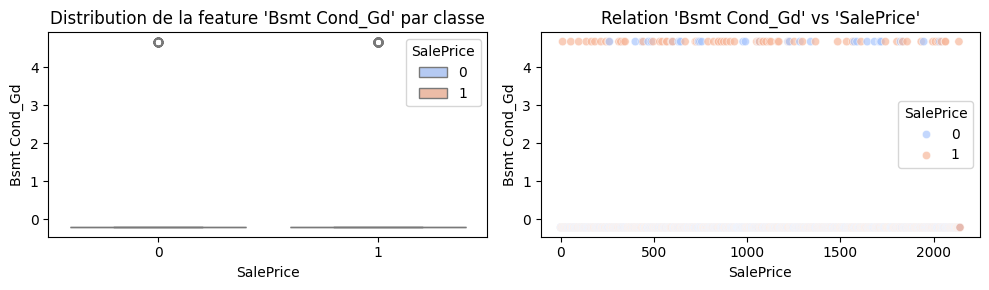

Bsmt Cond_Po vs SalePrice : -0.02


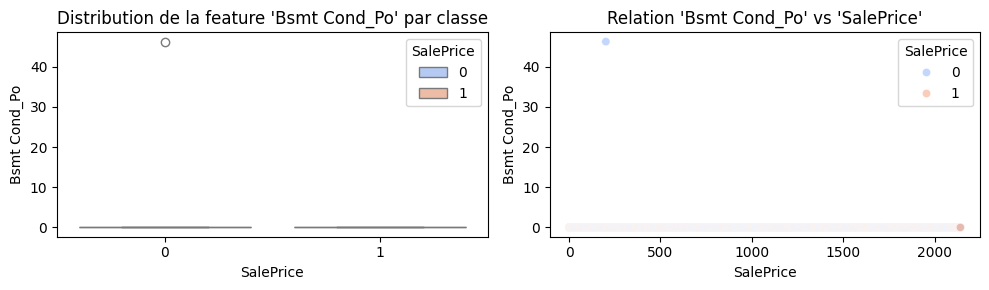

Bsmt Cond_TA vs SalePrice : 0.03


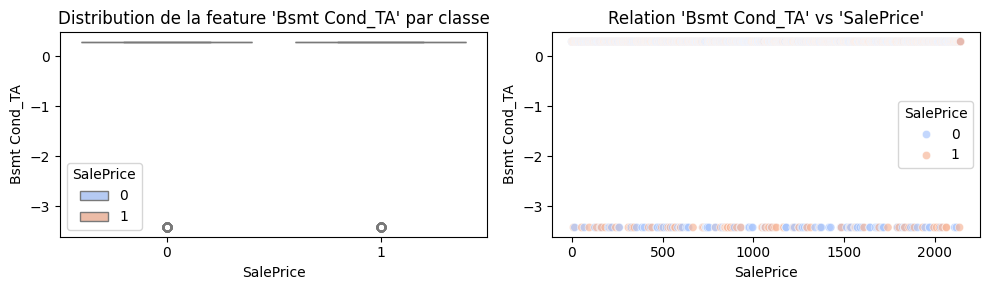

Bsmt Exposure_Gd vs SalePrice : 0.23


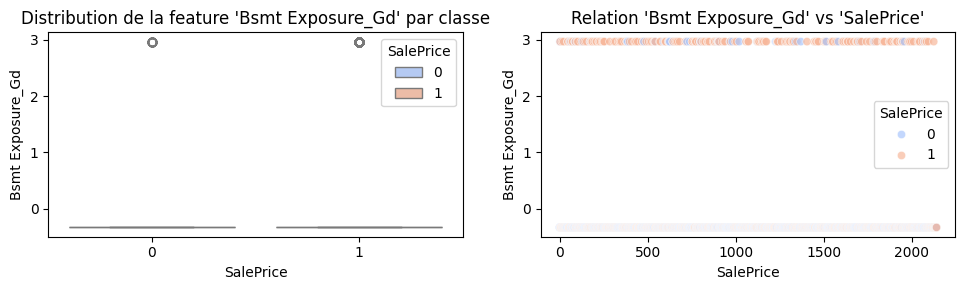

Bsmt Exposure_Mn vs SalePrice : 0.03


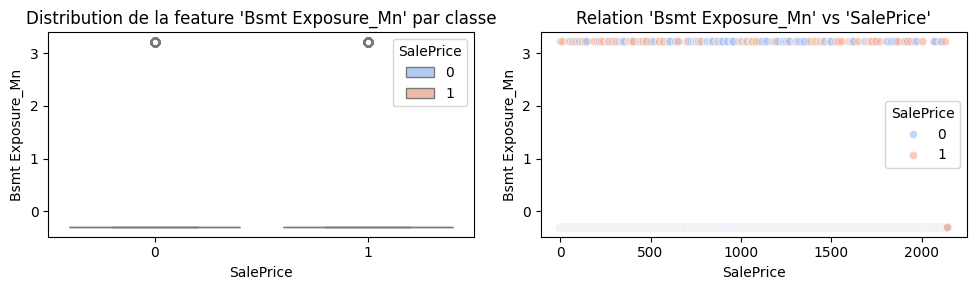

Bsmt Exposure_No vs SalePrice : -0.25


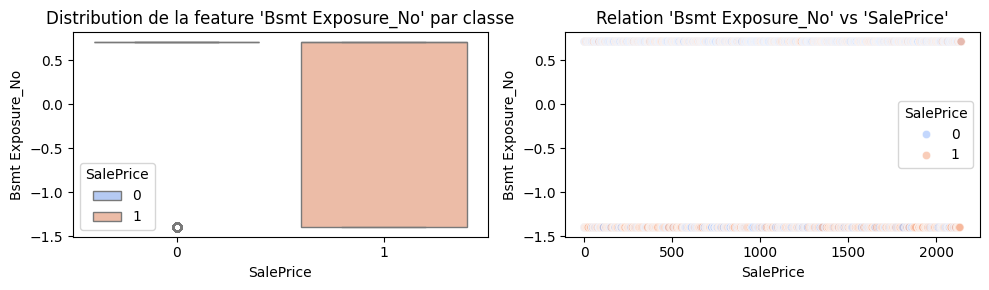

BsmtFin Type 1_BLQ vs SalePrice : -0.17


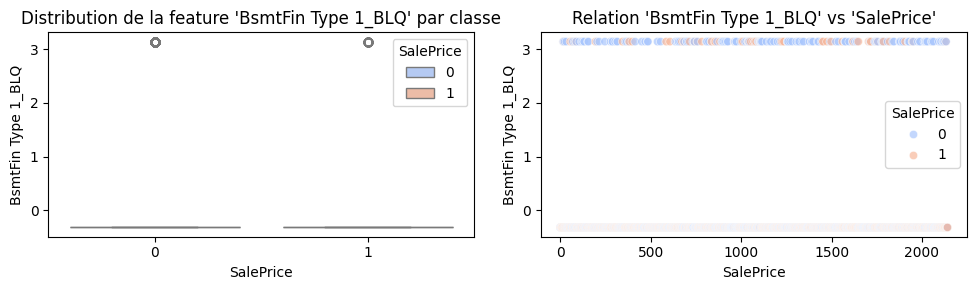

BsmtFin Type 1_GLQ vs SalePrice : 0.41


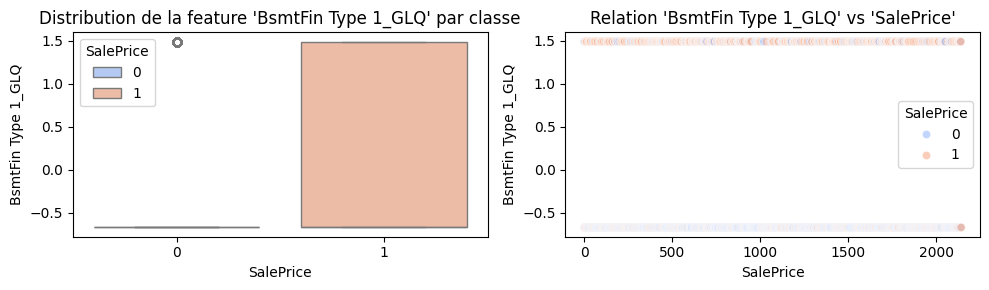

BsmtFin Type 1_LwQ vs SalePrice : -0.08


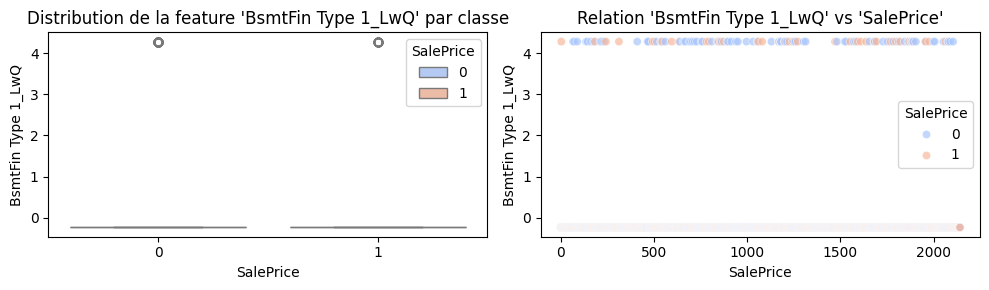

BsmtFin Type 1_Rec vs SalePrice : -0.25


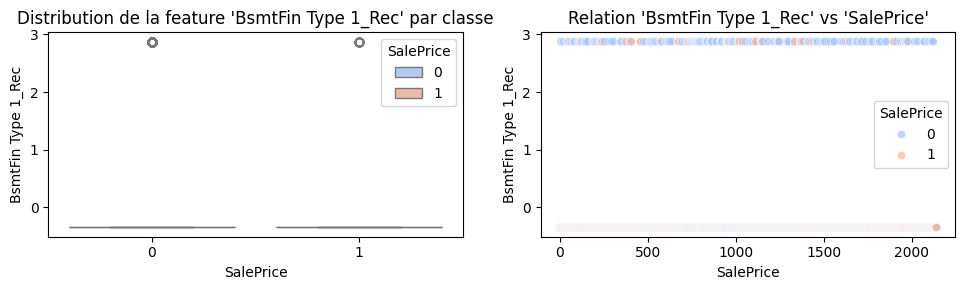

BsmtFin Type 1_Unf vs SalePrice : -0.01


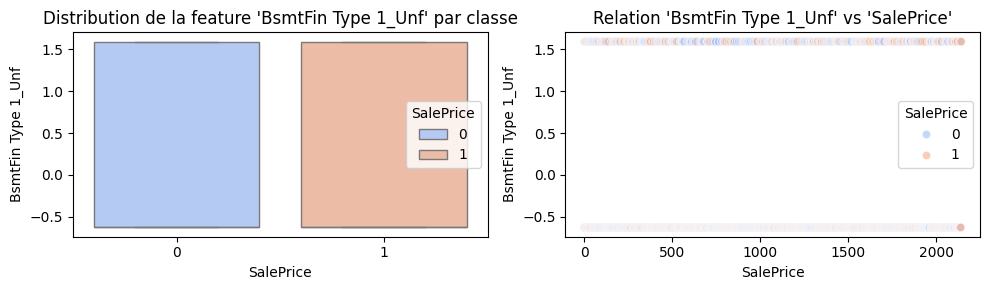

BsmtFin Type 2_BLQ vs SalePrice : -0.06


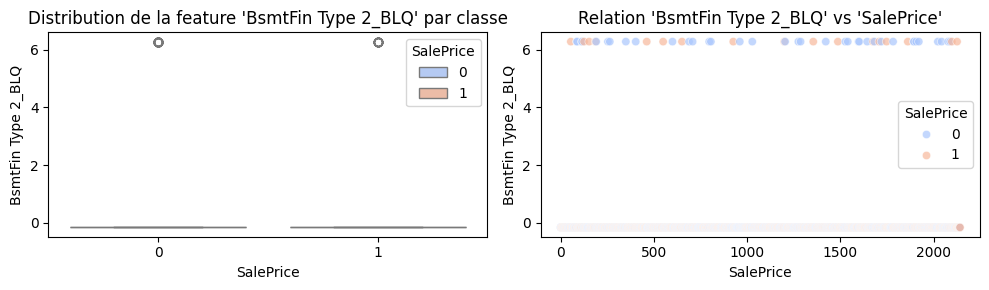

BsmtFin Type 2_GLQ vs SalePrice : 0.03


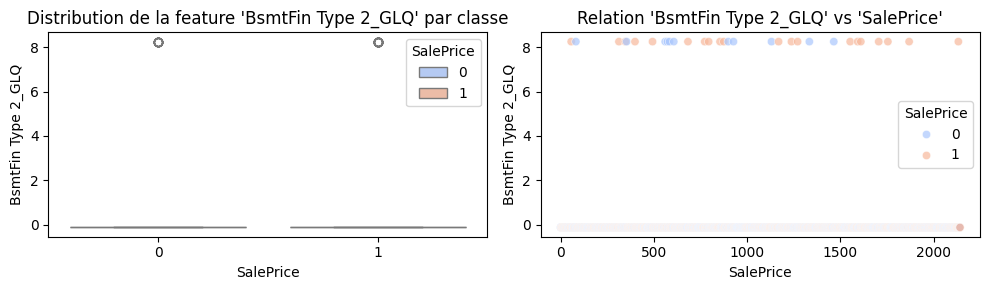

BsmtFin Type 2_LwQ vs SalePrice : -0.03


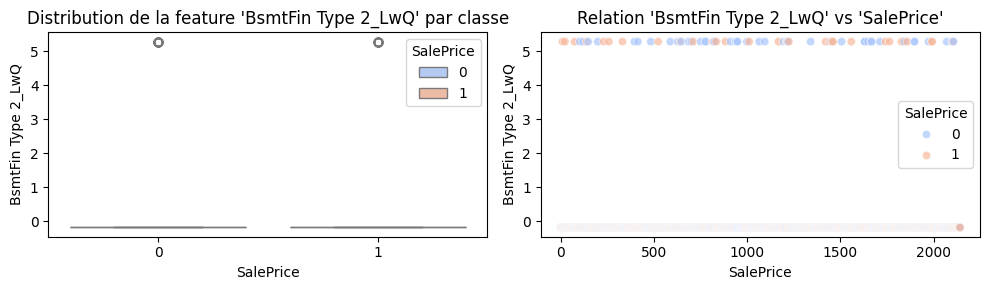

BsmtFin Type 2_Rec vs SalePrice : -0.05


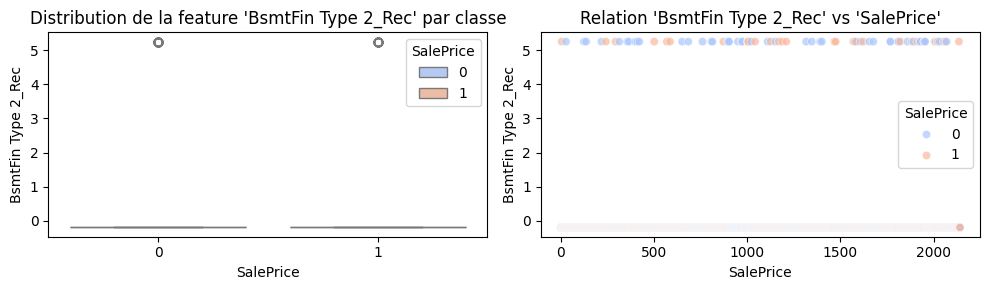

BsmtFin Type 2_Unf vs SalePrice : 0.06


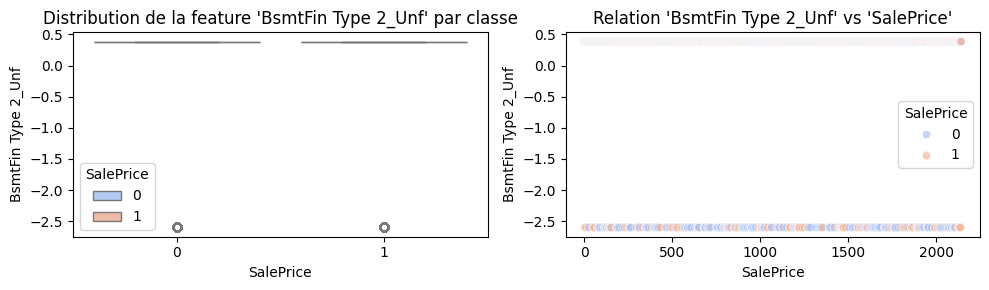

Heating_GasW vs SalePrice : -0.03


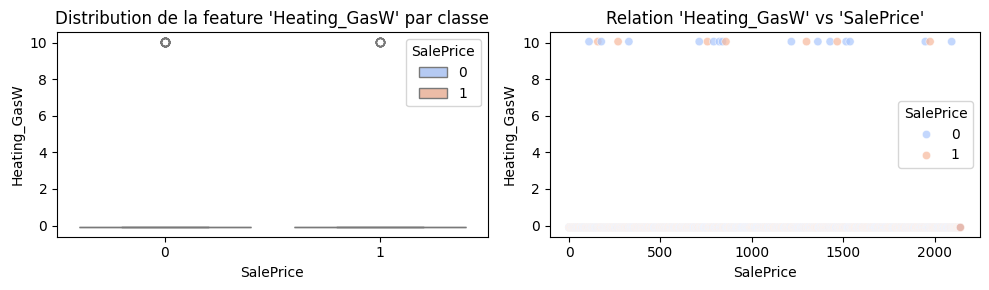

Heating_Grav vs SalePrice : -0.02


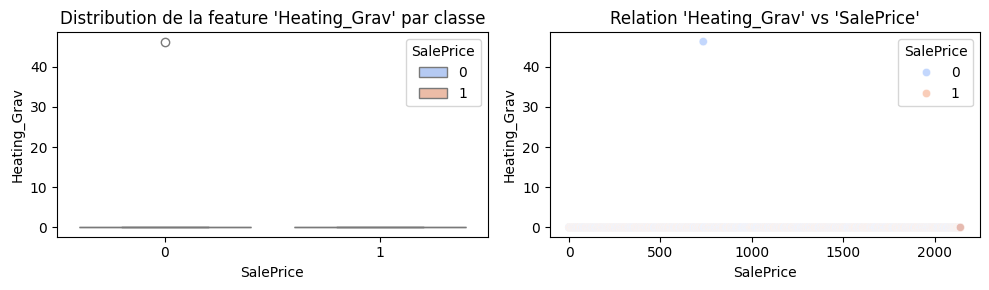

Heating_OthW vs SalePrice : -0.02


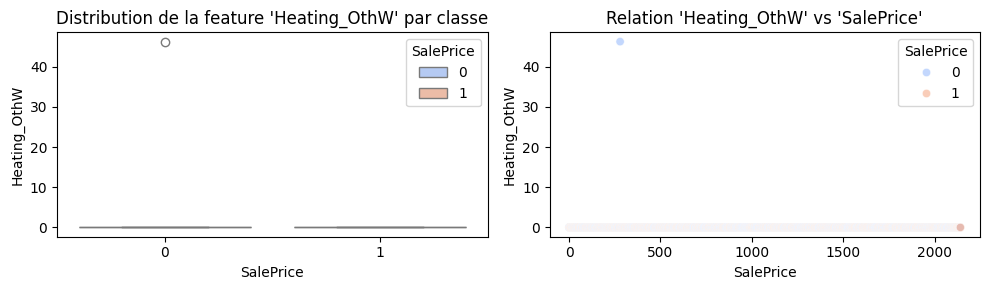

Heating QC_Fa vs SalePrice : -0.08


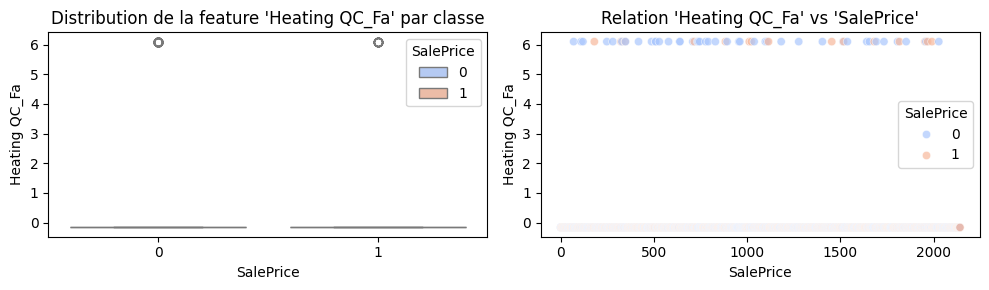

Heating QC_Gd vs SalePrice : -0.10


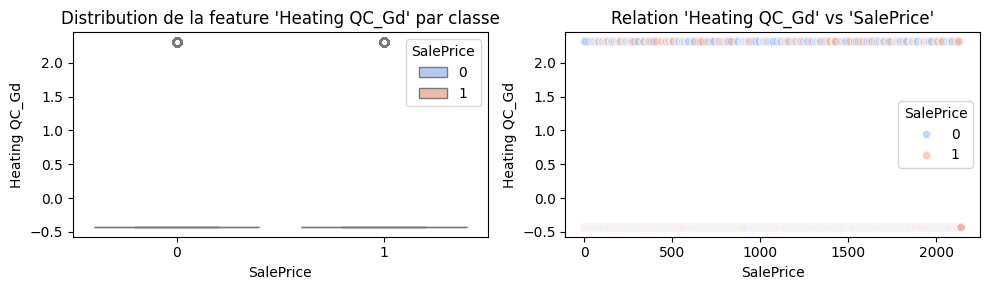

Heating QC_Po vs SalePrice : -0.03


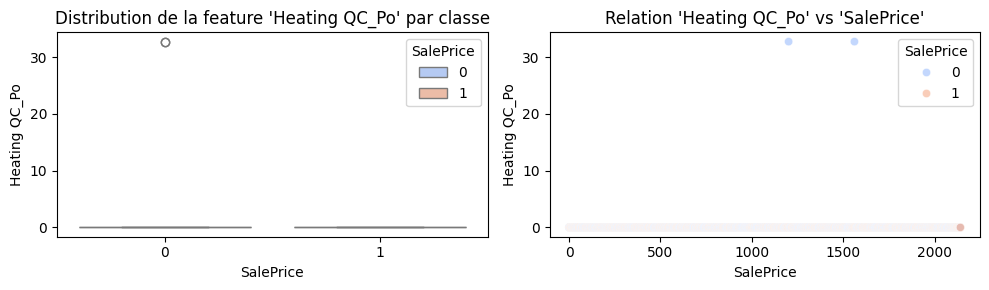

Heating QC_TA vs SalePrice : -0.38


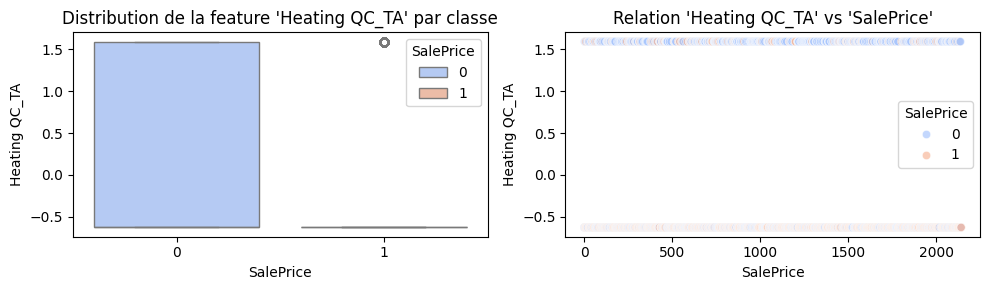

Central Air_Y vs SalePrice : 0.19


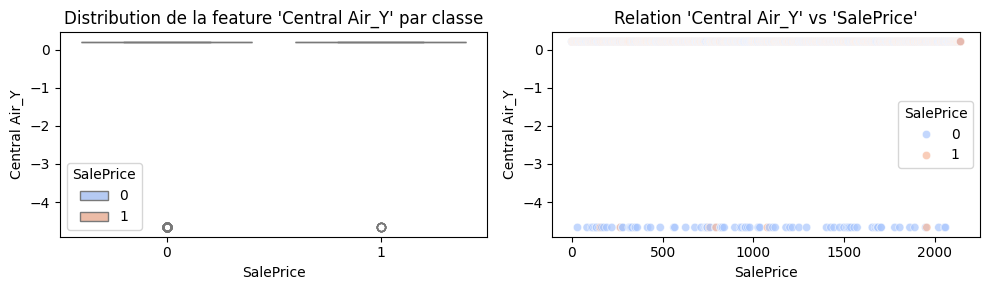

Electrical_FuseF vs SalePrice : -0.10


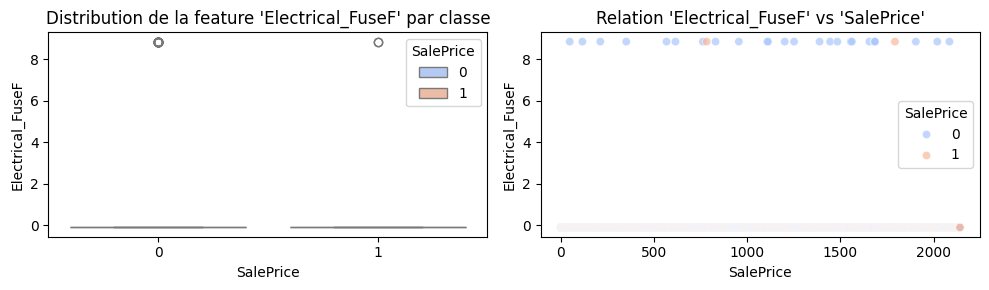

Electrical_FuseP vs SalePrice : -0.05


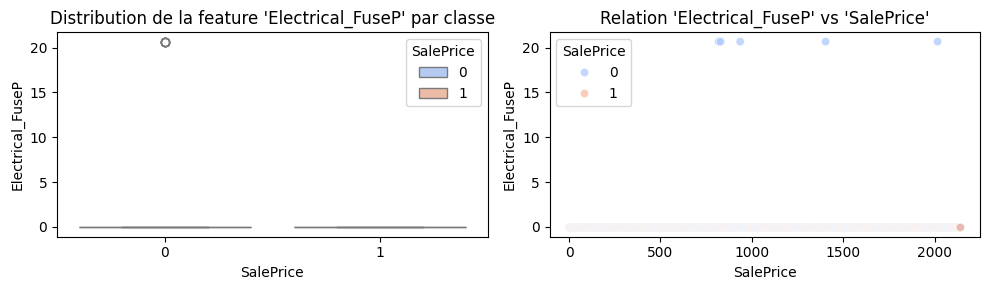

Electrical_Mix vs SalePrice : -0.02


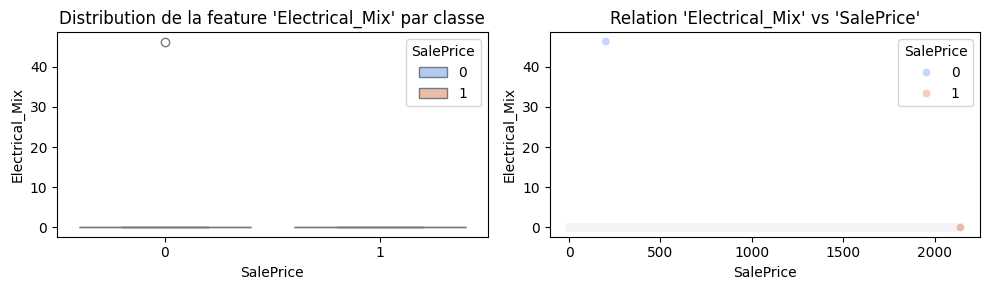

Electrical_SBrkr vs SalePrice : 0.25


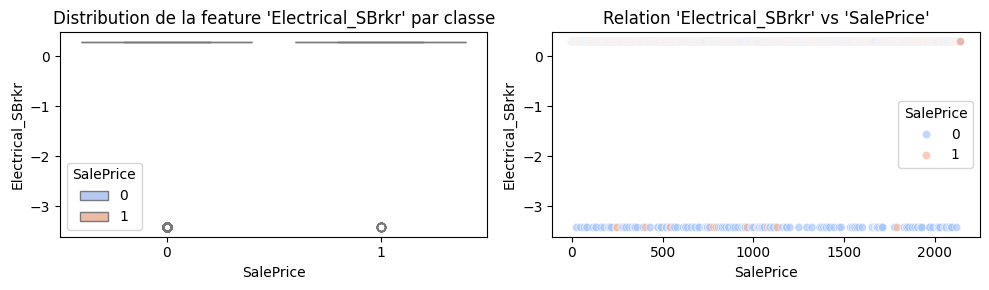

Kitchen Qual_Fa vs SalePrice : -0.12


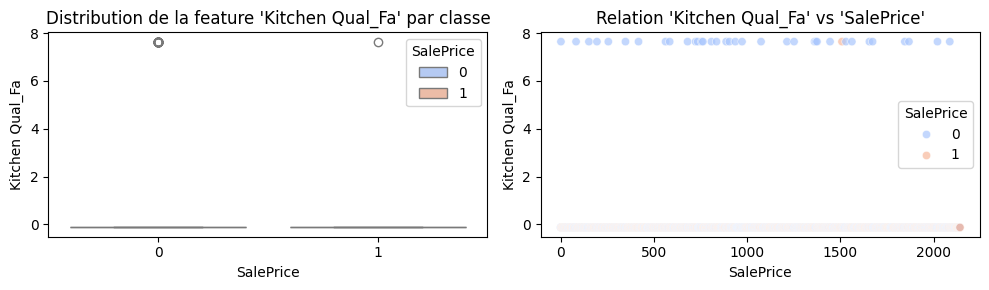

Kitchen Qual_Gd vs SalePrice : 0.46


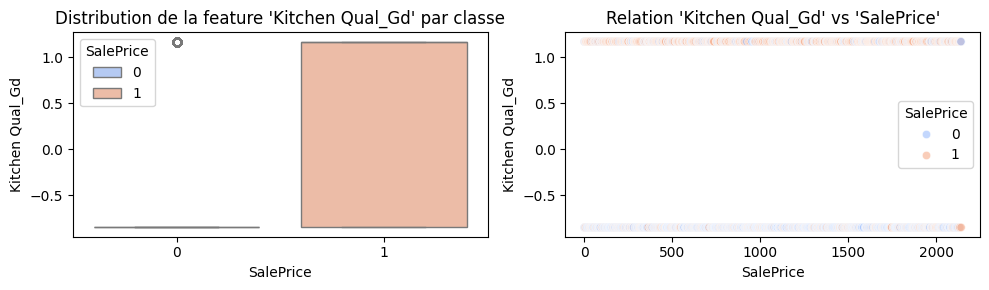

Kitchen Qual_Po vs SalePrice : -0.02


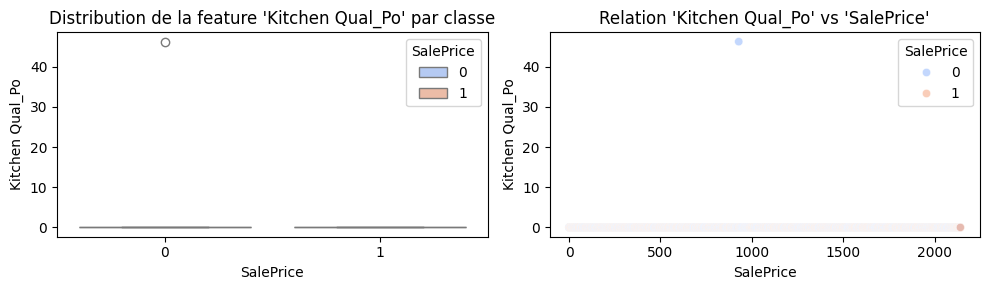

Kitchen Qual_TA vs SalePrice : -0.55


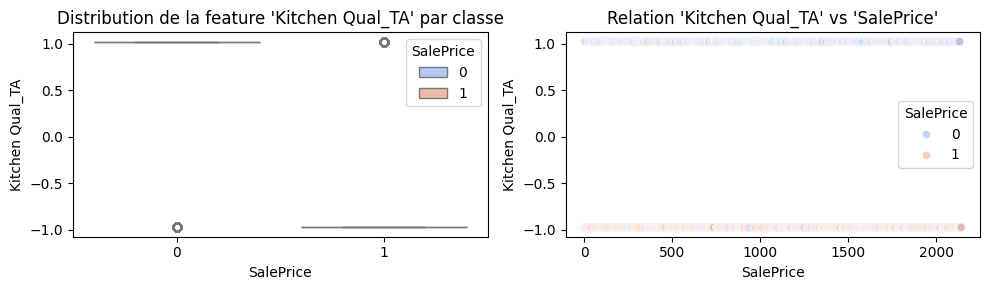

Functional_Maj2 vs SalePrice : -0.04


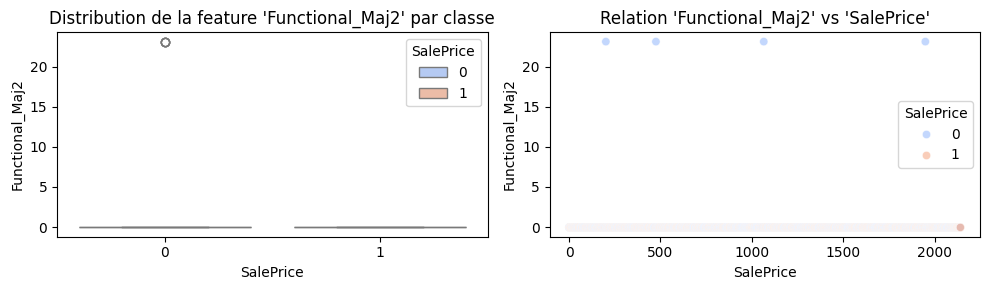

Functional_Min1 vs SalePrice : -0.05


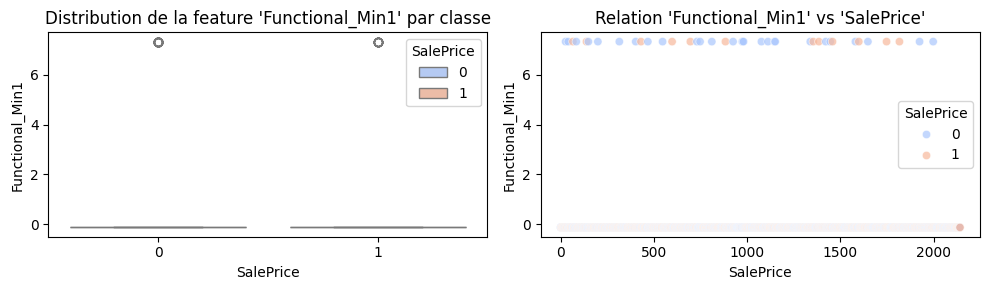

Functional_Min2 vs SalePrice : -0.03


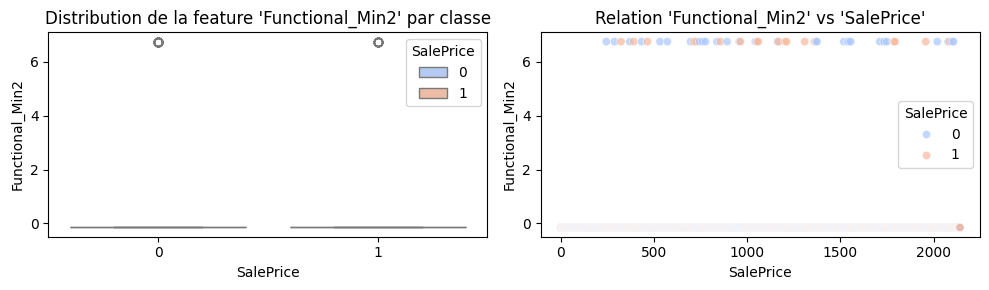

Functional_Mod vs SalePrice : -0.04


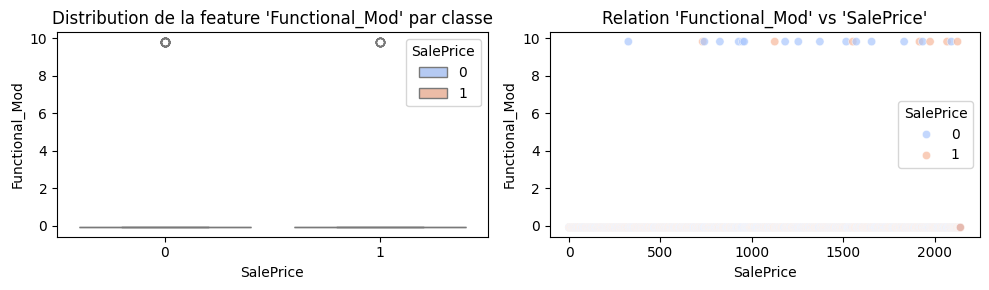

Functional_Sal vs SalePrice : -0.02


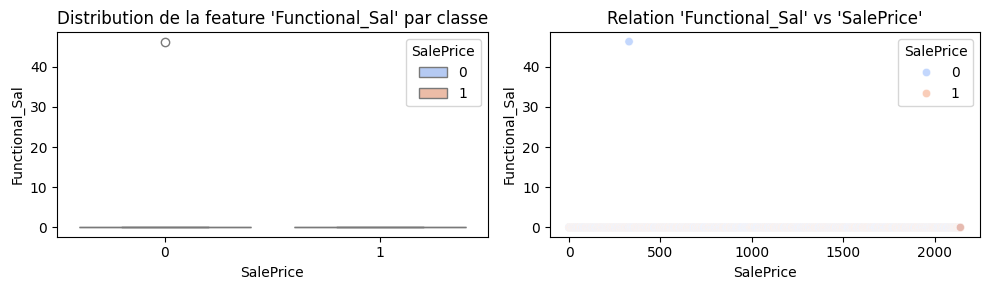

Functional_Sev vs SalePrice : -0.02


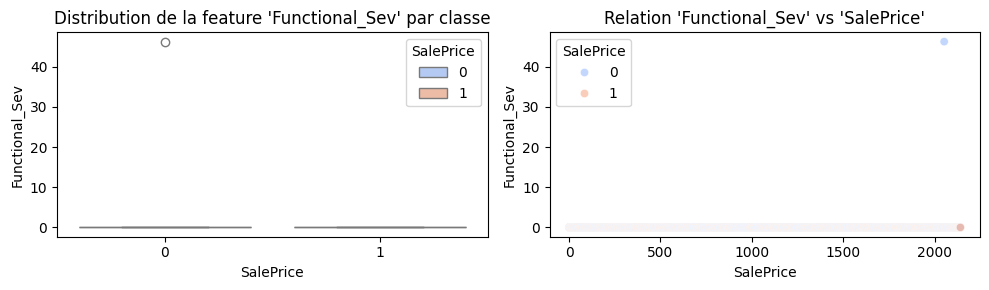

Functional_Typ vs SalePrice : 0.09


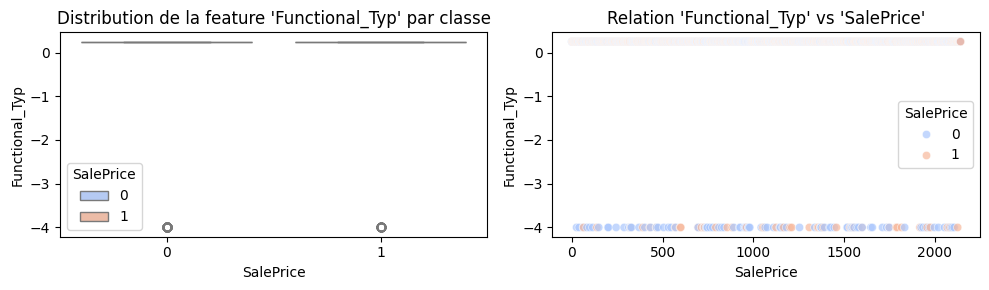

Garage Type_Attchd vs SalePrice : 0.36


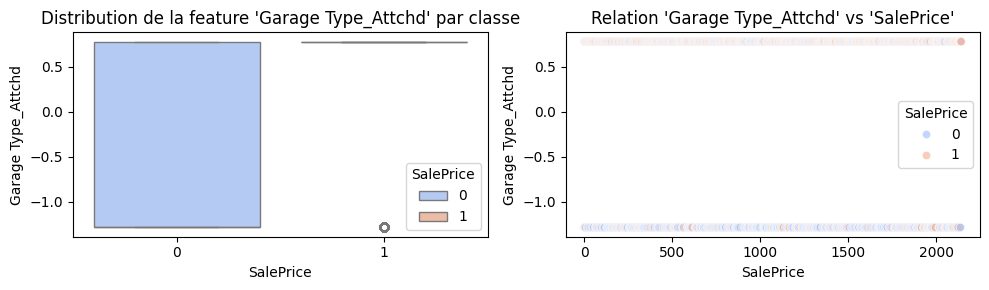

Garage Type_Basment vs SalePrice : -0.07


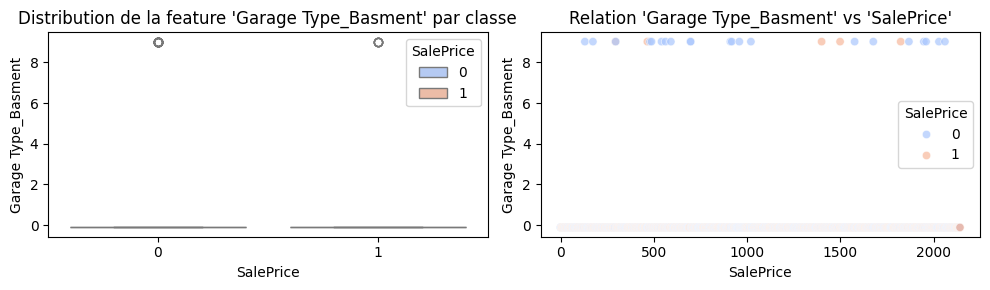

Garage Type_BuiltIn vs SalePrice : 0.21


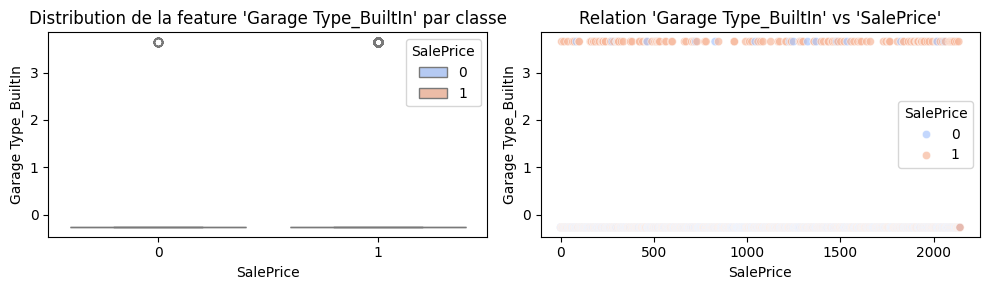

Garage Type_CarPort vs SalePrice : -0.08


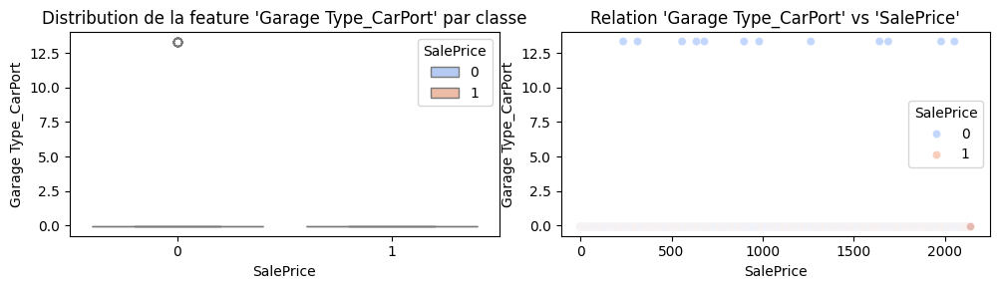

Garage Type_Detchd vs SalePrice : -0.47


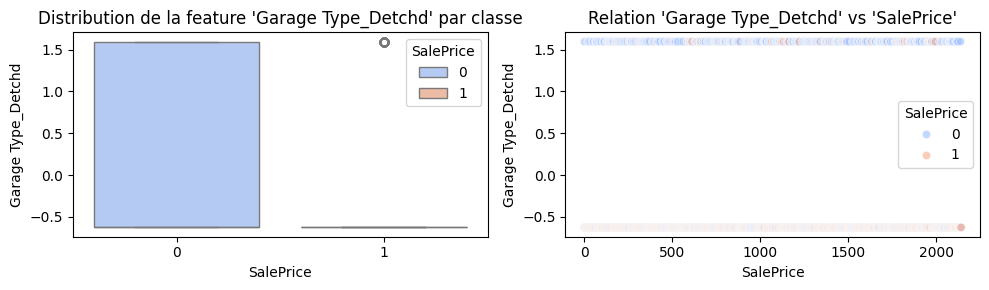

Garage Finish_RFn vs SalePrice : 0.25


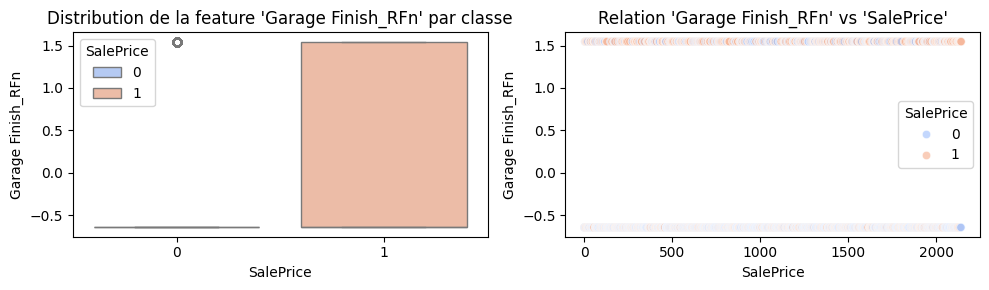

Garage Finish_Unf vs SalePrice : -0.56


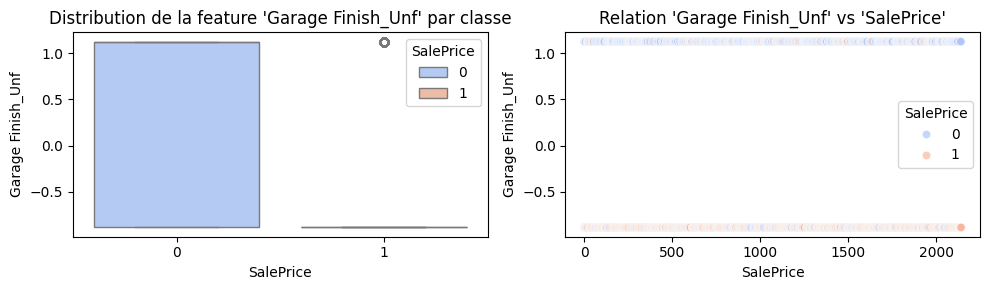

Garage Qual_Fa vs SalePrice : -0.18


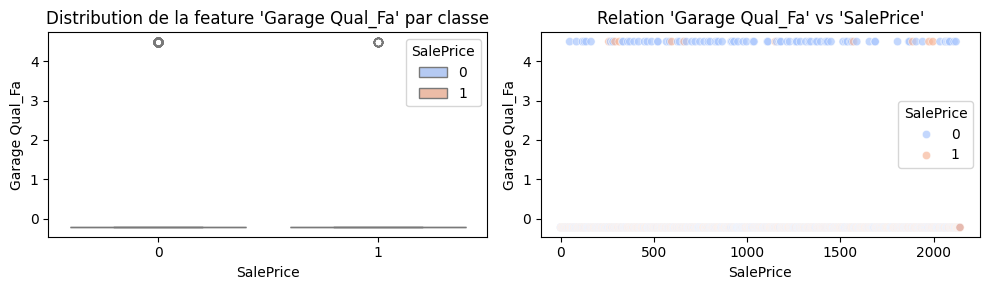

Garage Qual_Gd vs SalePrice : 0.05


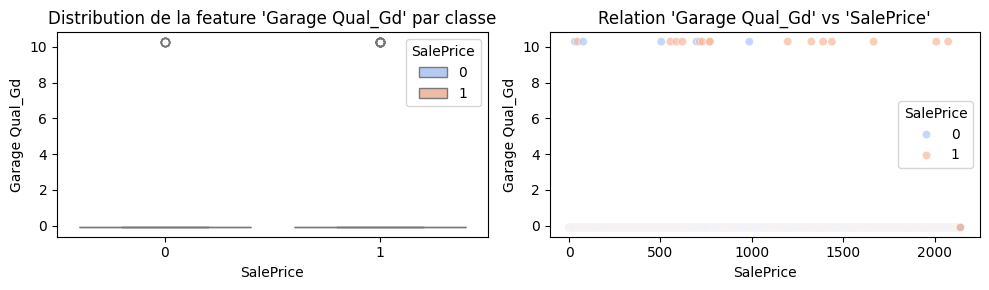

Garage Qual_Po vs SalePrice : -0.04


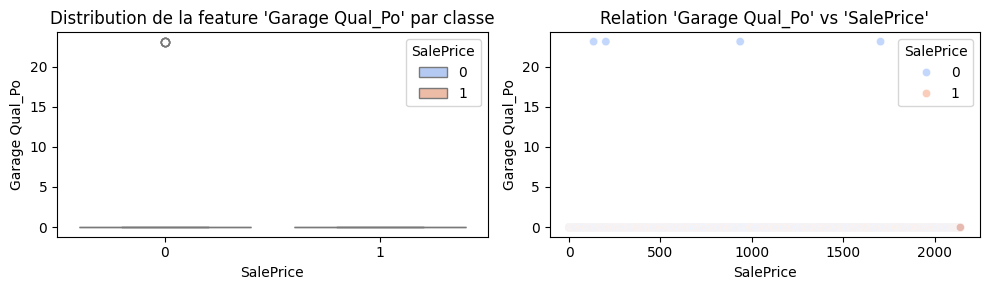

Garage Qual_TA vs SalePrice : 0.15


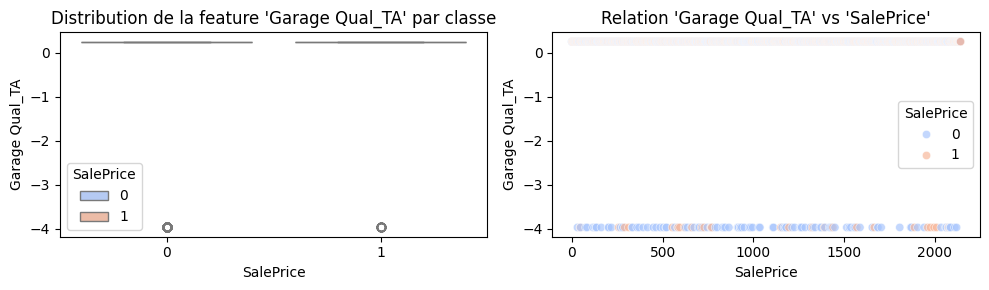

Garage Cond_Fa vs SalePrice : -0.15


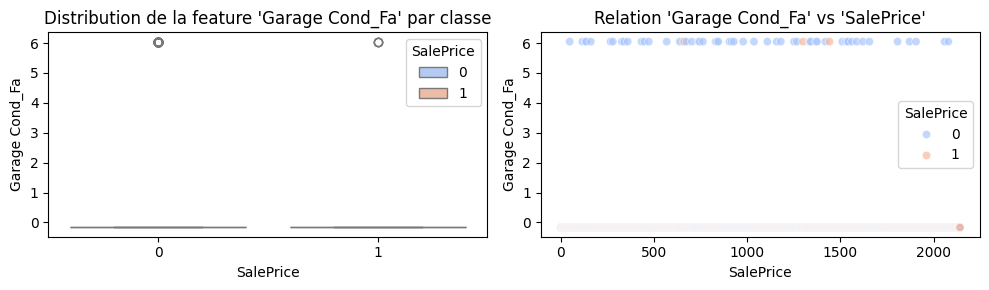

Garage Cond_Gd vs SalePrice : -0.01


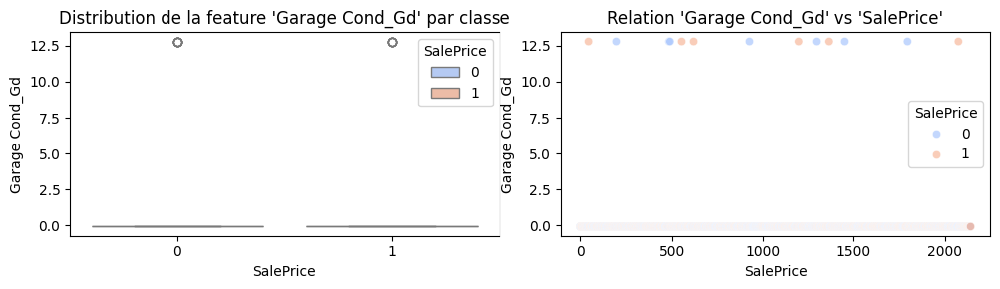

Garage Cond_Po vs SalePrice : -0.06


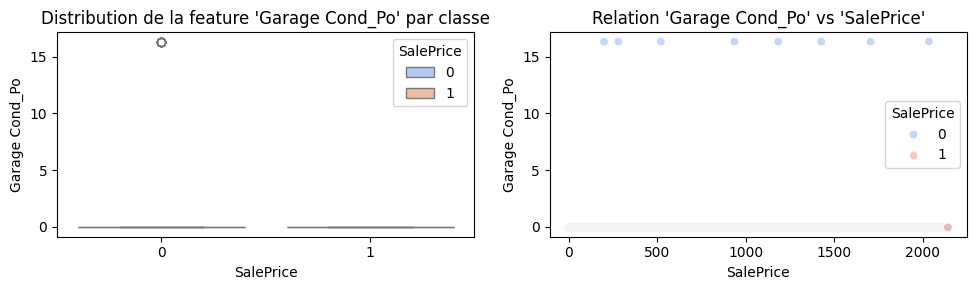

Garage Cond_TA vs SalePrice : 0.15


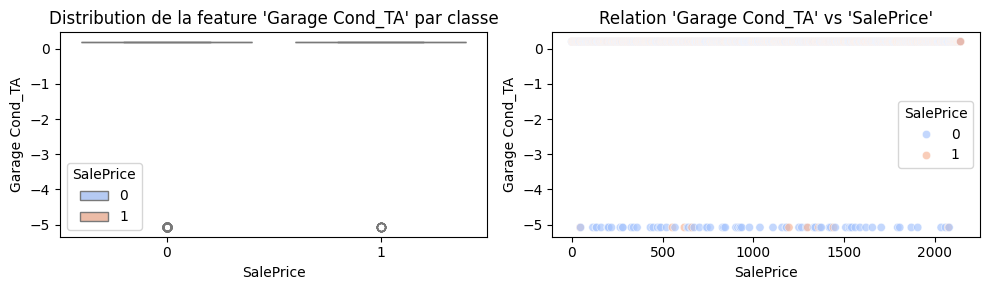

Paved Drive_P vs SalePrice : -0.09


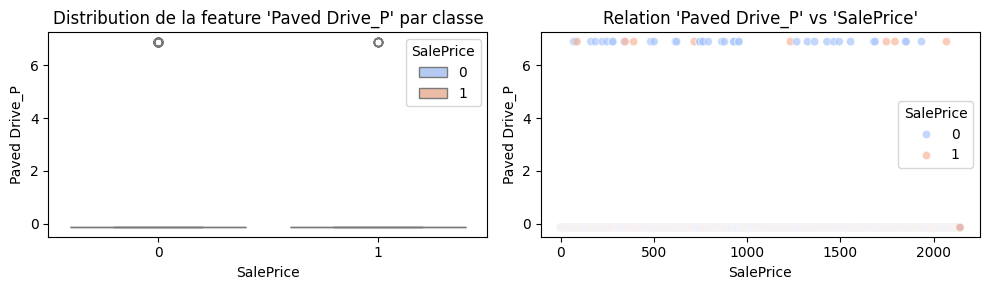

Paved Drive_Y vs SalePrice : 0.20


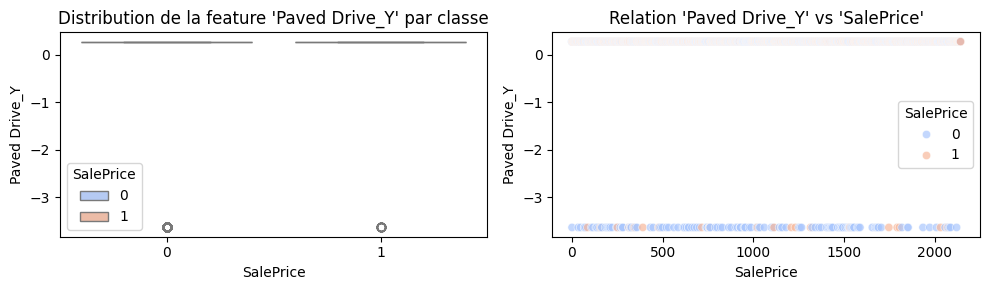

Sale Type_CWD vs SalePrice : -0.00


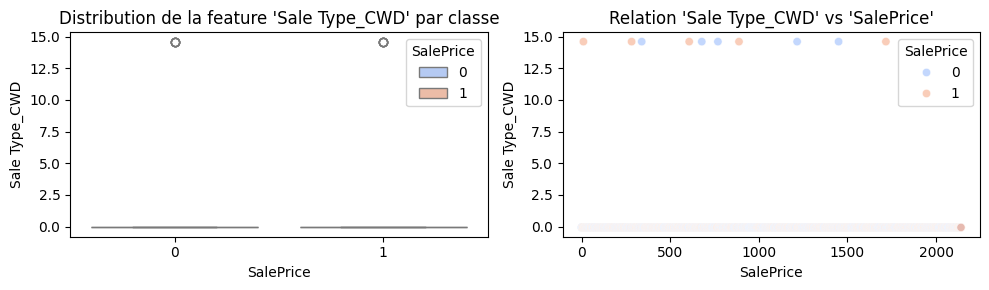

Sale Type_Con vs SalePrice : 0.02


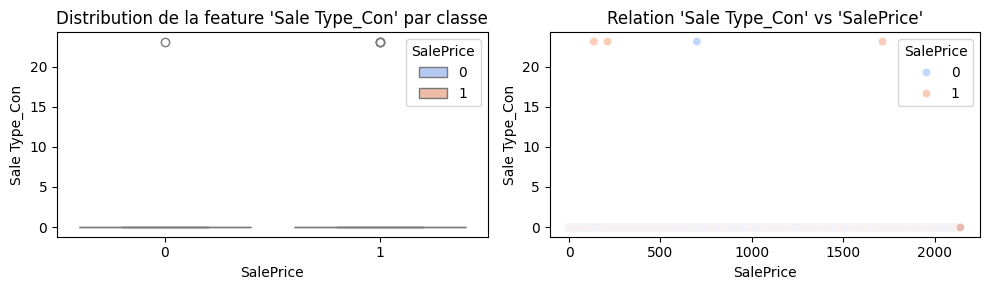

Sale Type_ConLD vs SalePrice : -0.04


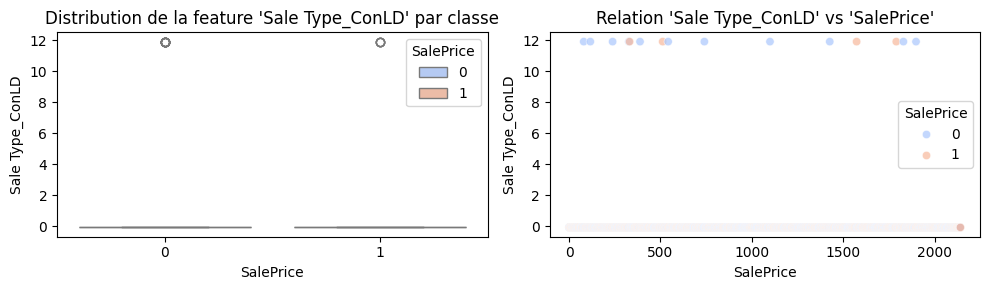

Sale Type_ConLI vs SalePrice : -0.03


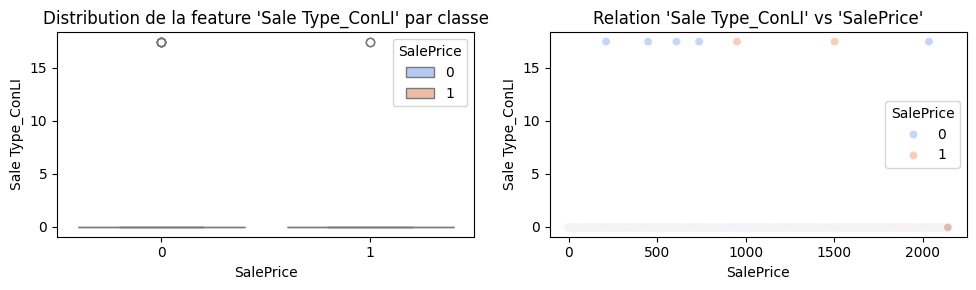

Sale Type_ConLw vs SalePrice : -0.02


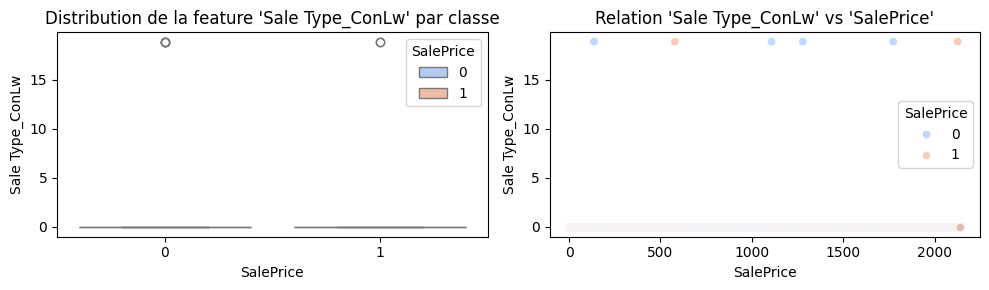

Sale Type_New vs SalePrice : 0.26


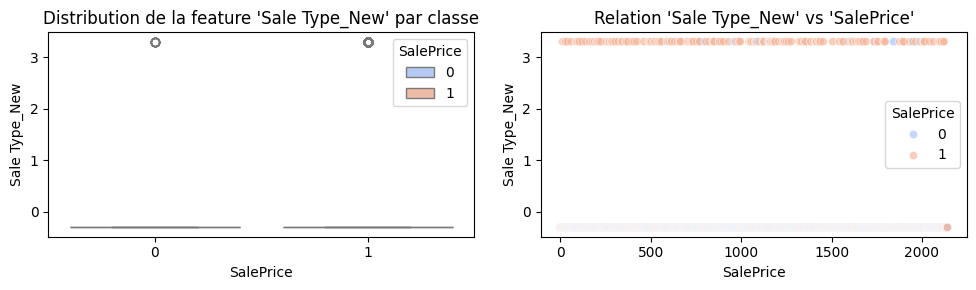

Sale Type_Oth vs SalePrice : -0.03


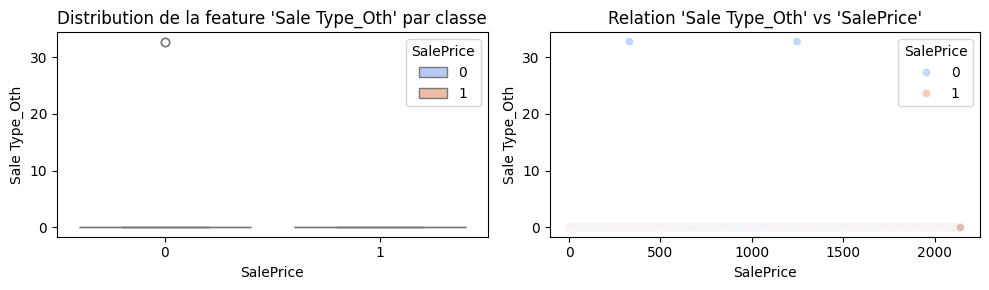

Sale Type_VWD vs SalePrice : -0.02


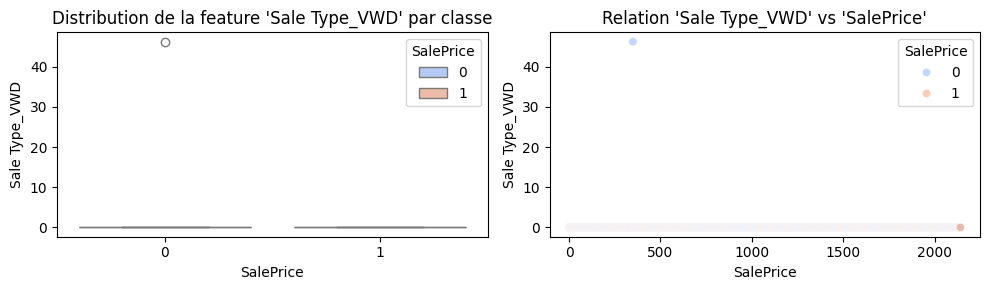

Sale Type_WD  vs SalePrice : -0.13


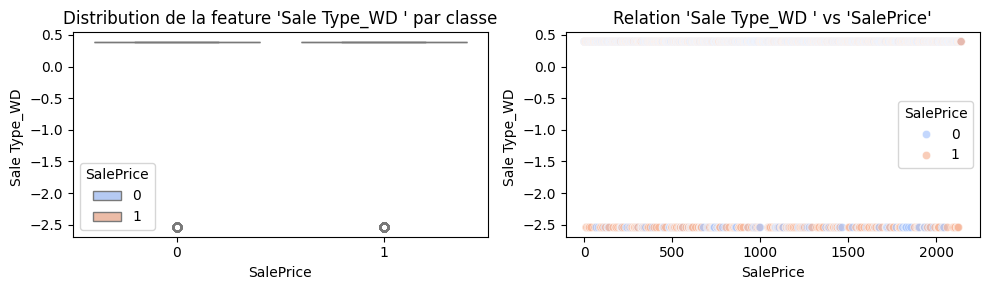

Sale Condition_AdjLand vs SalePrice : -0.05


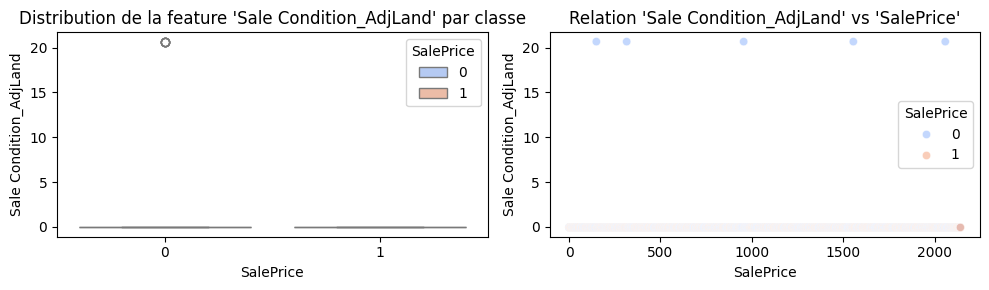

Sale Condition_Alloca vs SalePrice : -0.02


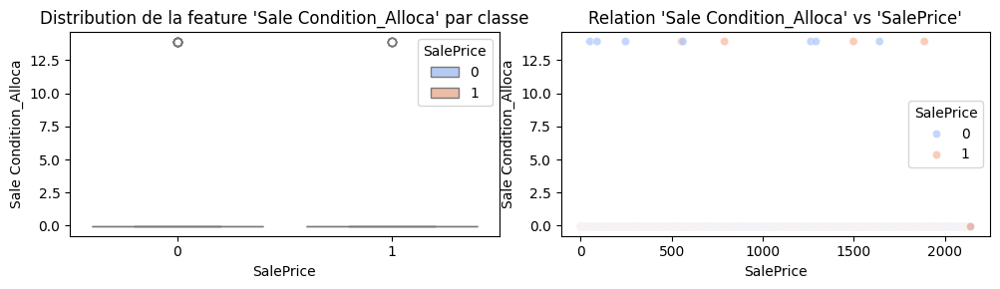

Sale Condition_Family vs SalePrice : -0.04


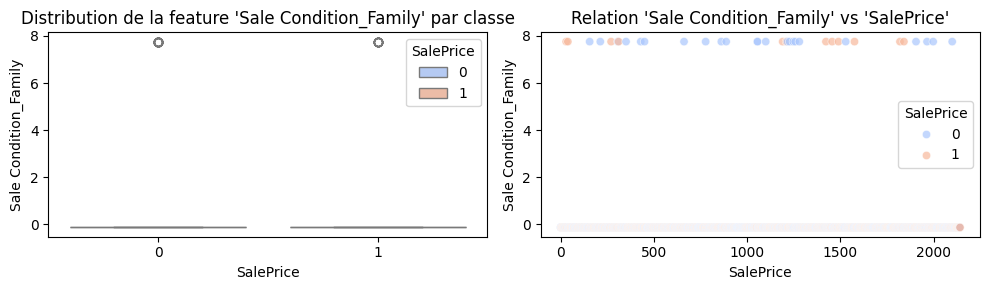

Sale Condition_Normal vs SalePrice : -0.09


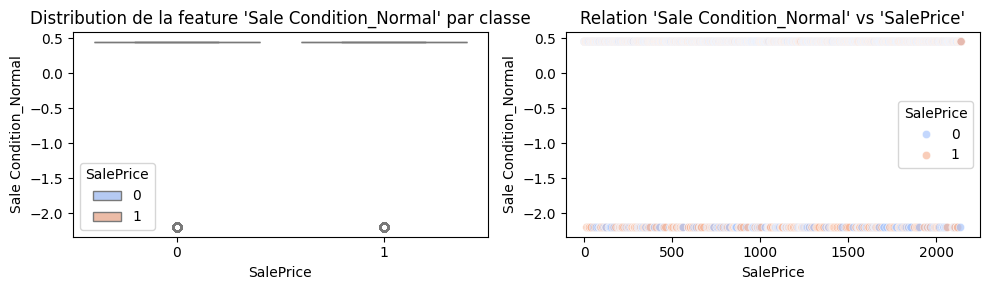

Sale Condition_Partial vs SalePrice : 0.25


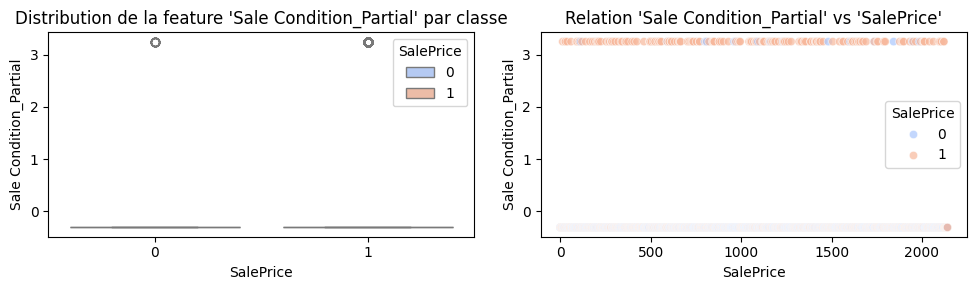

In [154]:
# Visualisation des variables
features = [col for col in data_train_class.columns if col != 'SalePrice']
target = 'SalePrice'

for var in features:
    # Corrélation Variable~Cible
    corr_value = data_train_class[[var, target]].corr().iloc[0, 1]
    print(f'{var} vs {target} : {corr_value:.2f}')

    # Figure : Boxplot+Scatter
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 3))

    # Boxplot de la distribution de la variable selon les classes
    sns.boxplot(data=data_train_class, x=target, y=var, hue=target, palette="coolwarm", ax=axes[0])
    axes[0].set_title(f"Distribution de la feature '{var}' par classe", fontsize=12)
    axes[0].set_xlabel(target, fontsize=10)
    axes[0].set_ylabel(var, fontsize=10)

    # Nuage de points Variable~Cible
    sns.scatterplot(data=data_train_class, x=range(len(data_train_class)), y=var, hue=target, palette='coolwarm', ax=axes[1], alpha=0.7)
    # sns.scatterplot(data=data_train_class, x=target, y=var, hue=target, palette="viridis", ax=axes[1], alpha=0.7)
    axes[1].set_title(f"Relation '{var}' vs '{target}'", fontsize=12)
    axes[1].set_xlabel(target, fontsize=10)
    axes[1].set_ylabel(var, fontsize=10)
    
    plt.tight_layout()
    plt.show()


In [155]:
# Calcul des corrélations avec la cible
correlations = data_train_class.corr()
correlations = correlations['SalePrice'].sort_values(key=abs, ascending=False)
print(correlations)

SalePrice               1.000000
Overall Qual            0.682804
Full Bath               0.639098
Exter Qual_TA          -0.613229
Gr Liv Area             0.591118
                          ...   
Sale Type_CWD          -0.000703
Condition 1_RRNn       -0.000629
Condition 1_RRNe       -0.000544
Exterior 2nd_AsphShn   -0.000314
Exterior 1st_BrkComm   -0.000314
Name: SalePrice, Length: 237, dtype: float64


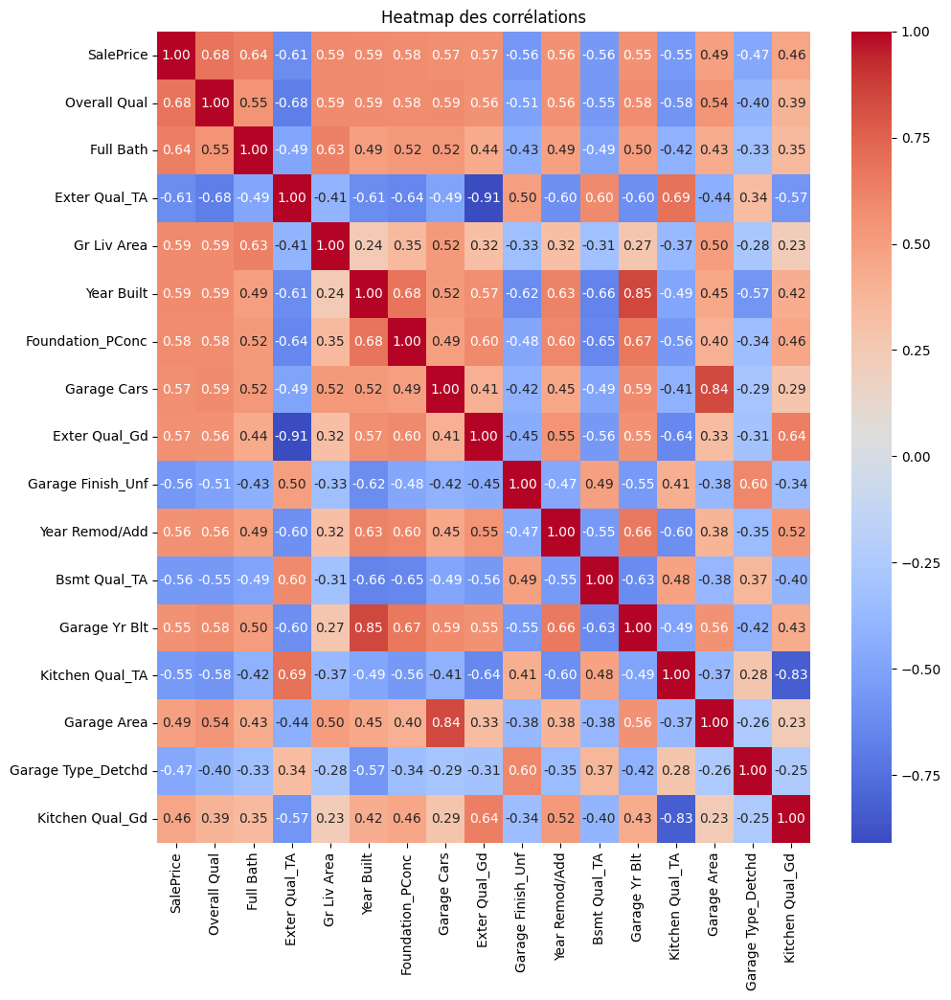

In [156]:
# Filtre des variables dont la corrélation avec SalePrice est sup à +/-0.6
correlations_filtered = correlations[correlations.abs() > 0.45]
variables_to_plot = correlations_filtered.index
correlation_matrix_filtered = data_train_class[variables_to_plot].corr()

# Création de la heatmap
plt.figure(figsize=(11, 11))
sns.heatmap(correlation_matrix_filtered, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Heatmap des corrélations')
plt.show()

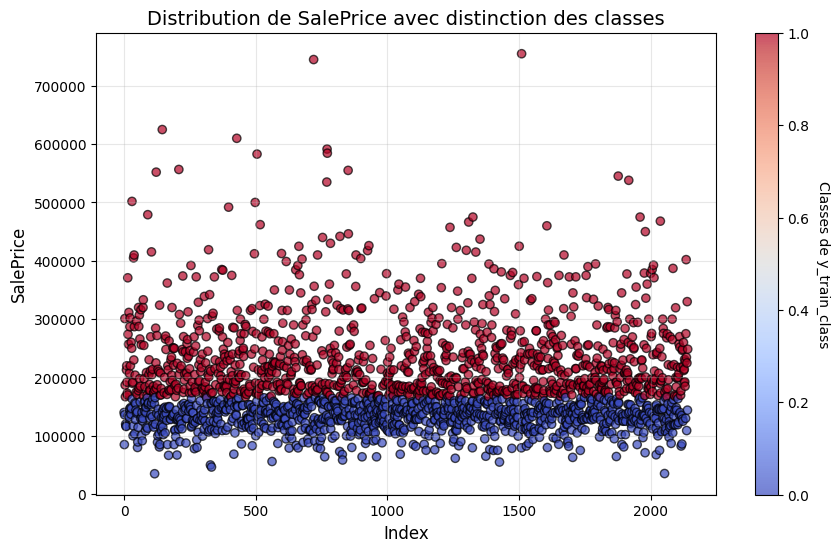

In [157]:
# Nuage de points de SalePrice
plt.figure(figsize=(10, 6))
scatter = plt.scatter(range(len(y_train_reg)), y_train_reg, c=y_train_class, cmap='coolwarm', alpha=0.7, edgecolor='k')

# Ajouter une barre de couleur pour la légende
cbar = plt.colorbar(scatter)
cbar.set_label('Classes de y_train_class', rotation=270, labelpad=15)

# Titres et légendes
plt.title('Distribution de SalePrice avec distinction des classes', fontsize=14)
plt.xlabel('Index', fontsize=12)
plt.ylabel('SalePrice', fontsize=12)
plt.grid(alpha=0.3)

plt.show()


## Modèles de classification

### Régression logistique

Le modèle de régression logistique a été entraîné sur les données d'apprentissage normalisées (`X_train_scaled`, `y_train_class`). Ce modèle est couramment utilisé pour les problèmes de classification binaire, où il cherche à établir une relation linéaire entre les variables explicatives et la probabilité d'appartenir à une classe.  

In [158]:
# Fitting du modèle
LgR = LogisticRegression(random_state=rs)
start_time = time.time() # Démarrer le chronomètre
LgR.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Prédiction et évaluation
y_lgr = LgR.predict(X_test_scaled)
accuracy_lgr = accuracy_score(y_test_class, y_lgr)
precision_lgr = precision_score(y_test_class, y_lgr)
auc_lgr = roc_auc_score(y_test_class, y_lgr)
time_lgr = end_time - start_time

print("-- REGRESSION LOGISTIQUE --")
print(f"Accuracy : {accuracy_lgr:.3f}")
print(f"Précision : {precision_lgr:.3f}")
print(f"AUC : {auc_lgr:.3f}")
print(f"Temps d'entraînement : {time_lgr:.3f} secondes")


-- REGRESSION LOGISTIQUE --
Accuracy : 0.914
Précision : 0.889
AUC : 0.915
Temps d'entraînement : 0.043 secondes


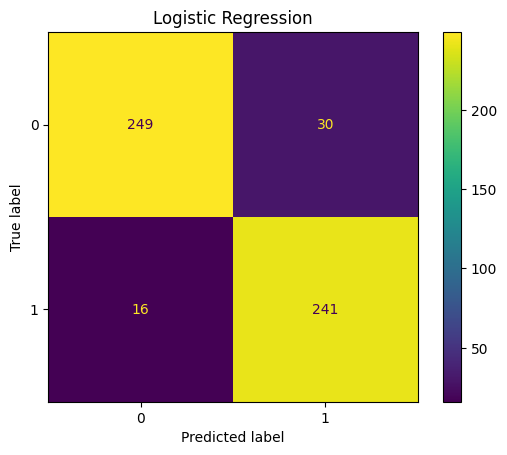

In [159]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_lgr)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('Logistic Regression')
plt.show()


Le graphique présente une matrice de confusion pour le modèle de régression logistique. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 249 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 30 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 16 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 241 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle de régression logistique a une bonne performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Cependant, il y a quelques erreurs de classification, en particulier 30 faux positifs et 16 faux négatifs. Cela suggère que le modèle pourrait être amélioré, par exemple en ajustant le seuil de décision ou en explorant des techniques pour mieux équilibrer les classes si elles sont déséquilibrées.

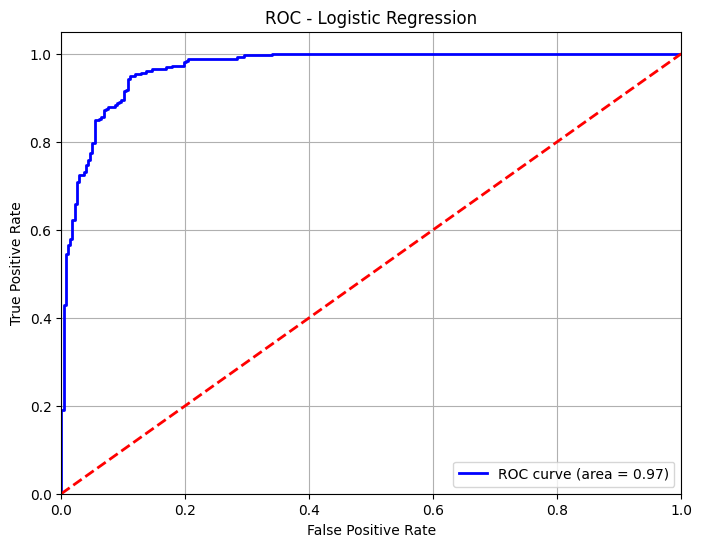

In [160]:
# Courbe ROC
y_proba = LgR.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - Logistic Regression')
plt.legend(loc="lower right")
plt.grid()
plt.show()


Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle de régression logistique. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.97**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle de régression logistique est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### Ridge

Le modèle Ridge Classifier a été entraîné sur les données d'apprentissage normalisées (`X_train_scaled`, `y_train_class`). Ce modèle est une variante de la régression logistique qui utilise une régularisation L2 pour éviter le surajustement, ce qui le rend particulièrement utile lorsque les données présentent une multicolinéarité.  

In [161]:
# Fitting du modèle
Ridge_class = RidgeClassifier(random_state=rs)
start_time = time.time() # Démarrer le chronomètre
Ridge_class.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Prédiction et évaluation
y_ridge = Ridge_class.predict(X_test_scaled)
accuracy_ridge = accuracy_score(y_test_class, y_ridge)
precision_ridge = precision_score(y_test_class, y_ridge)
auc_ridge = roc_auc_score(y_test_class, y_ridge)
time_ridge = end_time - start_time

print("-- RIDGE CLASSIFIER --")
print(f"Accuracy : {accuracy_ridge:.3f}")
print(f"Précision : {precision_ridge:.3f}")
print(f"AUC : {auc_ridge:.3f}")
print(f"Temps d'entraînement : {time_ridge:.3f} secondes")

-- RIDGE CLASSIFIER --
Accuracy : 0.903
Précision : 0.887
AUC : 0.903
Temps d'entraînement : 0.013 secondes


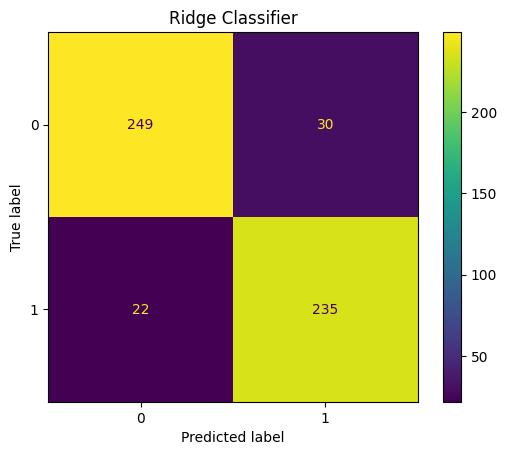

In [162]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_ridge)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('Ridge Classifier')
plt.show()

Le graphique présente une matrice de confusion pour le modèle Ridge Classifier. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 249 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 30 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 22 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 235 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle Ridge Classifier a une bonne performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Cependant, il y a quelques erreurs de classification, en particulier 30 faux positifs et 22 faux négatifs. Cela suggère que le modèle pourrait être amélioré, par exemple en ajustant le seuil de décision ou en explorant des techniques pour mieux équilibrer les classes si elles sont déséquilibrées.

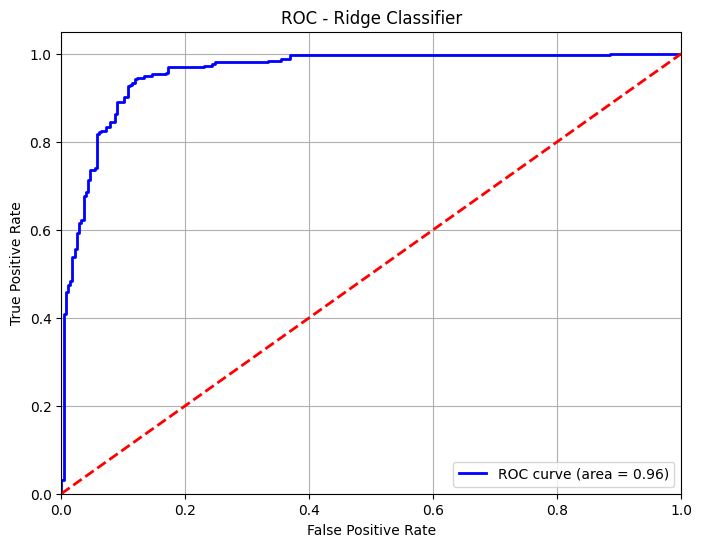

In [163]:
# Courbe ROC
y_proba = Ridge_class.decision_function(X_test_scaled)
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - Ridge Classifier')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle Ridge Classifier. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.96**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle Ridge Classifier est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### Lasso

Le modèle Lasso Classifier, basé sur une régression logistique avec régularisation L1, a été entraîné sur les données d'apprentissage normalisées (`X_train_scaled`, `y_train_class`). La régularisation L1 permet de sélectionner automatiquement les variables les plus importantes en réduisant certains coefficients à zéro, ce qui rend le modèle plus interprétable et moins sujet au surajustement. 

In [164]:
# Fitting du modèle
Lasso_class = LogisticRegression(random_state=rs, penalty='l1', solver='liblinear')
start_time = time.time() # Démarrer le chronomètre
Lasso_class.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Prédiction et évaluation
y_lasso = Lasso_class.predict(X_test_scaled)
accuracy_lasso = accuracy_score(y_test_class, y_lasso)
precision_lasso = precision_score(y_test_class, y_lasso)
auc_lasso = roc_auc_score(y_test_class, y_lasso)
time_lasso = end_time - start_time

print("-- LASSO CLASSIFIER --")
print(f"Accuracy : {accuracy_lasso:.3f}")
print(f"Précision : {precision_lasso:.3f}")
print(f"AUC : {auc_lasso:.3f}")
print(f"Temps d'entraînement : {time_lasso:.3f} secondes")

-- LASSO CLASSIFIER --
Accuracy : 0.920
Précision : 0.893
AUC : 0.921
Temps d'entraînement : 1.569 secondes


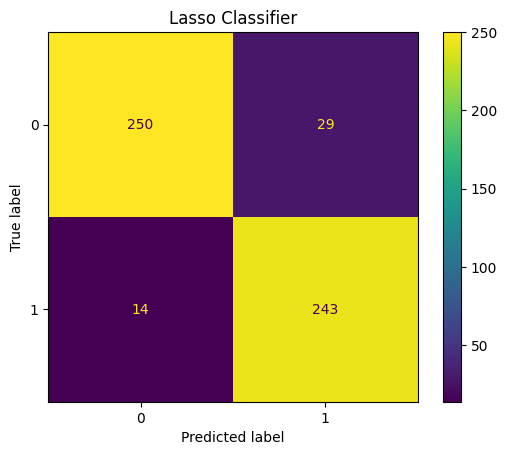

In [165]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_lasso)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('Lasso Classifier')
plt.show()


Le graphique présente une matrice de confusion pour le modèle Lasso Classifier. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 250 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 14 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 14 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 243 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle Lasso Classifier a une excellente performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Le nombre de faux positifs et de faux négatifs est relativement faible, ce qui suggère que le modèle est bien équilibré et capable de distinguer efficacement entre les classes. Cela confirme que la régularisation L1 a permis de sélectionner les variables les plus pertinentes, tout en maintenant une bonne performance prédictive.

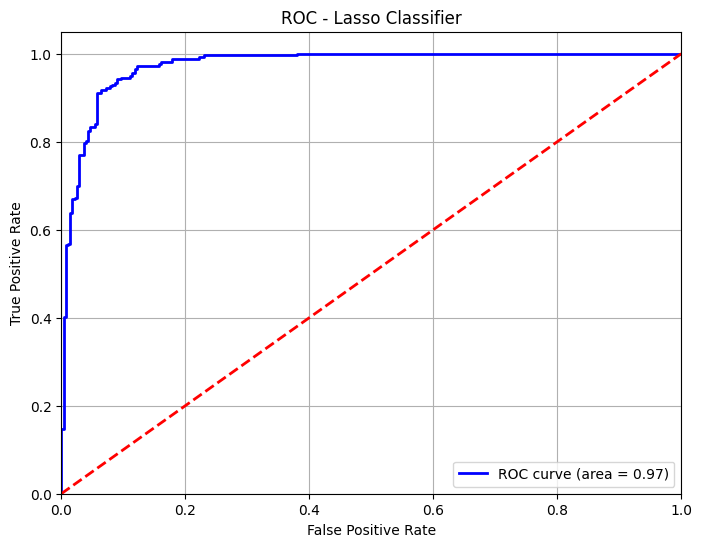

In [166]:
# Courbe ROC
y_proba = Lasso_class.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - Lasso Classifier')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle Lasso Classifier. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.97**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle Lasso Classifier est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### Arbre de décision

Le modèle d'arbre de décision a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. Les hyperparamètres testés incluent la profondeur maximale de l'arbre (`max_depth`), le nombre minimal d'échantillons requis pour diviser un nœud (`min_samples_split`) et le nombre minimal d'échantillons requis pour être une feuille (`min_samples_leaf`).

In [167]:
# Définir la grille d'hyperparamètres
param_grid = {
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 10, 20],
    'min_samples_leaf': [1, 10, 15, 20, 25]
}

# Utiliser GridSearchCV pour trouver les meilleurs hyperparamètres
grid_search_tree = GridSearchCV(estimator=DecisionTreeClassifier(random_state=rs), param_grid=param_grid, cv=5, scoring='accuracy')
start_time = time.time() # Démarrer le chronomètre
grid_search_tree.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Afficher les meilleurs hyperparamètres
print("-- ARBRE DE DECISION AVEC GRID SEARCH --")
print(f"Meilleurs paramètres : {grid_search_tree.best_params_}")

# Utiliser les meilleurs hyperparamètres pour le modèle final
Tree_class = grid_search_tree.best_estimator_

# Prédiction et évaluation
y_tree = Tree_class.predict(X_test_scaled)
accuracy_tree = accuracy_score(y_test_class, y_tree)
precision_tree = precision_score(y_test_class, y_tree)
auc_tree = roc_auc_score(y_test_class, y_tree)
time_tree = end_time - start_time

print(f"Accuracy : {accuracy_tree:.3f}")
print(f"Précision : {precision_tree:.3f}")
print(f"AUC : {auc_tree:.3f}")
print(f"Temps d'entraînement : {time_tree:.3f} secondes")


-- ARBRE DE DECISION AVEC GRID SEARCH --
Meilleurs paramètres : {'max_depth': None, 'min_samples_leaf': 20, 'min_samples_split': 2}
Accuracy : 0.875
Précision : 0.874
AUC : 0.875
Temps d'entraînement : 9.415 secondes


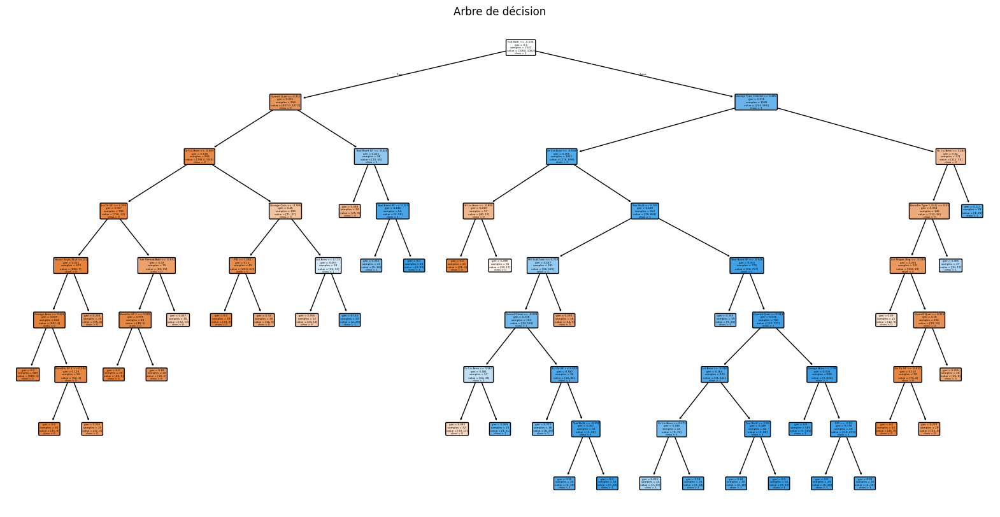

In [168]:
# Affichage de l'arbre
plt.figure(figsize=(20, 10))
plot_tree(Tree_class, filled=True, feature_names=X_train.columns, class_names=['0', '1'], rounded=True)
plt.title('Arbre de décision')
plt.show()

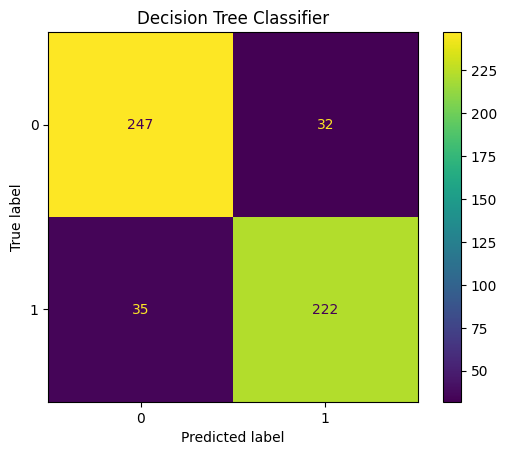

In [169]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_tree)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('Decision Tree Classifier')
plt.show()


Le graphique présente une matrice de confusion pour le modèle d'arbre de décision (Decision Tree Classifier). La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 247 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 32 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 35 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 222 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle d'arbre de décision a une bonne performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Cependant, il y a quelques erreurs de classification, en particulier 32 faux positifs et 35 faux négatifs. Cela suggère que le modèle pourrait être amélioré, par exemple en ajustant davantage les hyperparamètres ou en explorant des techniques pour mieux équilibrer les classes si elles sont déséquilibrées.

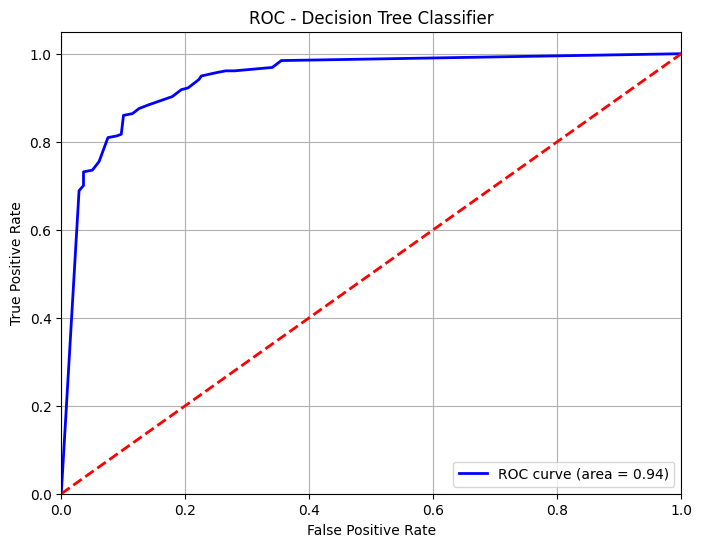

In [170]:
# Courbe ROC
y_proba = Tree_class.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - Decision Tree Classifier')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle d'arbre de décision (Decision Tree Classifier). La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.94**, ce qui indique une très bonne capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une excellente performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle d'arbre de décision est performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné. Cependant, il pourrait être intéressant d'explorer des modèles plus complexes ou des techniques d'ensemble pour améliorer encore les performances, en particulier pour réduire les faux positifs et les faux négatifs.

### Forêt aléatoire

Le modèle Random Forest a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. Les hyperparamètres testés incluent le nombre d'arbres (`n_estimators`), la profondeur maximale des arbres (`max_depth`), le nombre minimal d'échantillons requis pour diviser un nœud (`min_samples_split`), le nombre minimal d'échantillons requis pour être une feuille (`min_samples_leaf`) et le nombre maximal de features à considérer pour chaque split (`max_features`).  


In [171]:
# Définition des hyperparamètres à tester
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

# Recherche des meilleurs hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(estimator=RandomForestClassifier(random_state=rs), param_grid=param_grid, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
start_time = time.time() # Démarrer le chronomètre
grid_search.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Affichage des meilleurs hyperparamètres
print(f"Meilleurs hyperparamètres : {grid_search.best_params_}")

# Utilisation du meilleur modèle
RF = grid_search.best_estimator_

# Prédiction et évaluation
y_rf = RF.predict(X_test_scaled)
accuracy_rf = accuracy_score(y_test_class, y_rf)
precision_rf = precision_score(y_test_class, y_rf)
auc_rf = roc_auc_score(y_test_class, y_rf)
time_rf = end_time - start_time

print("-- RANDOM FOREST --")
print(f"Accuracy : {accuracy_rf:.3f}")
print(f"Precision : {precision_rf:.3f}")
print(f"AUC : {auc_rf:.3f}")
print(f"Temps d'entraînement : {time_rf:.3f} secondes")


Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Meilleurs hyperparamètres : {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 100}
-- RANDOM FOREST --
Accuracy : 0.924
Precision : 0.919
AUC : 0.923
Temps d'entraînement : 49.461 secondes


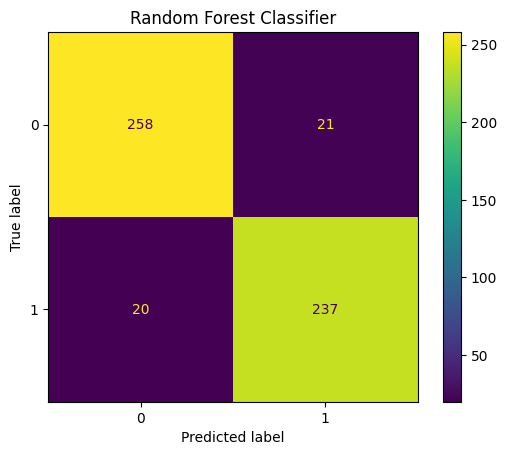

In [172]:
# Affichage de la matrice de confusion
cm = confusion_matrix(y_test_class, y_rf)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('Random Forest Classifier')
plt.show()


Le graphique présente une matrice de confusion pour le modèle Random Forest Classifier. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 258 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 21 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 20 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 237 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle Random Forest Classifier a une excellente performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Le nombre de faux positifs et de faux négatifs est relativement faible, ce qui suggère que le modèle est bien équilibré et capable de distinguer efficacement entre les classes. Cela confirme que le Random Forest est un modèle robuste pour ce jeu de données.

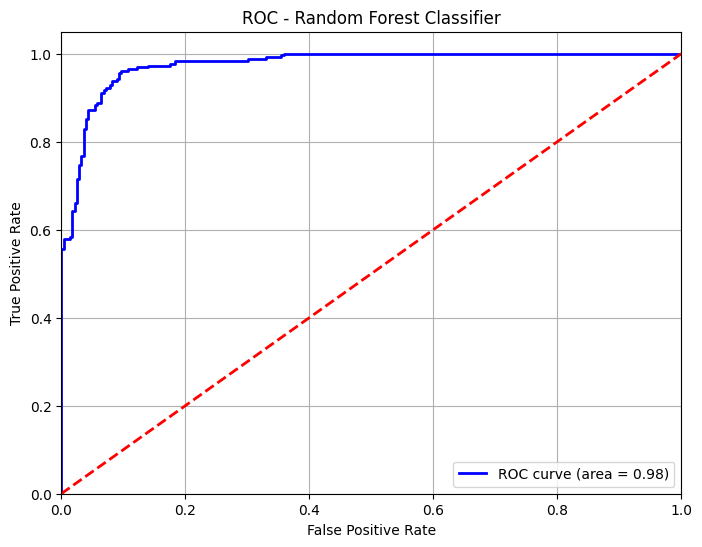

In [173]:
# Courbe ROC
y_proba = RF.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - Random Forest Classifier')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle Random Forest Classifier. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.98**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle Random Forest Classifier est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### K plus proches voisins

Le modèle K-Nearest Neighbors (KNN) a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. Les hyperparamètres testés incluent le nombre de voisins (`n_neighbors`) et la méthode de pondération (`weights`), qui peut être soit `uniform` (tous les voisins ont le même poids) soit `distance` (les voisins plus proches ont un poids plus élevé).  

In [174]:
# Définition des hyperparamètres à tester
param_grid = {
    'n_neighbors': [3, 5, 11, 15], 
    'weights': ['uniform', 'distance']
}

# Recherche des meilleurs hyperparamètres
grid_search = GridSearchCV(estimator=KNeighborsClassifier(), param_grid=param_grid, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
start_time = time.time() # Démarrer le chronomètre
grid_search.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Affichage des meilleurs hyperparamètres
print(f"Meilleurs hyperparamètres : {grid_search.best_params_}")

# Utilisation du meilleur modèle
KNN = grid_search.best_estimator_

# Prédiction et évaluation
y_knn = KNN.predict(X_test_scaled)
accuracy_knn = accuracy_score(y_test_class, y_knn)
precision_knn = precision_score(y_test_class, y_knn)
auc_knn = roc_auc_score(y_test_class, y_knn)
time_knn = end_time - start_time

print("-- KNN --")
print(f"Accuracy : {accuracy_knn:.3f}")
print(f"Précision : {precision_knn:.3f}")
print(f"AUC : {auc_knn:.3f}")
print(f"Temps d'entraînement : {time_knn:.3f} secondes")


Fitting 5 folds for each of 8 candidates, totalling 40 fits
Meilleurs hyperparamètres : {'n_neighbors': 11, 'weights': 'distance'}
-- KNN --
Accuracy : 0.888
Précision : 0.902
AUC : 0.887
Temps d'entraînement : 0.498 secondes


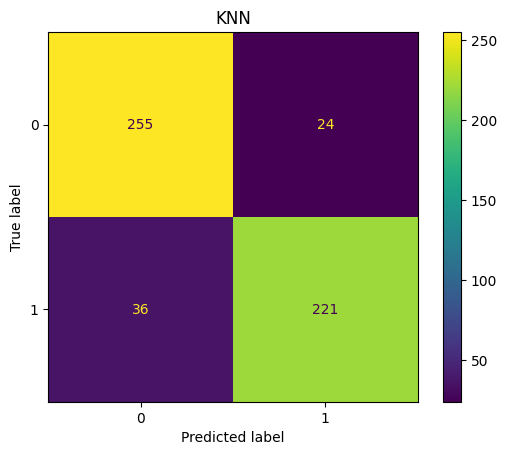

In [175]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_knn)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('KNN')
plt.show()

Le graphique présente une matrice de confusion pour le modèle K-Nearest Neighbors (KNN). La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 250 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 25 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 24 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 221 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle KNN a une bonne performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Cependant, il y a quelques erreurs de classification, en particulier 25 faux positifs et 24 faux négatifs. Cela suggère que le modèle pourrait être amélioré, par exemple en ajustant davantage les hyperparamètres ou en explorant des techniques pour mieux équilibrer les classes si elles sont déséquilibrées.


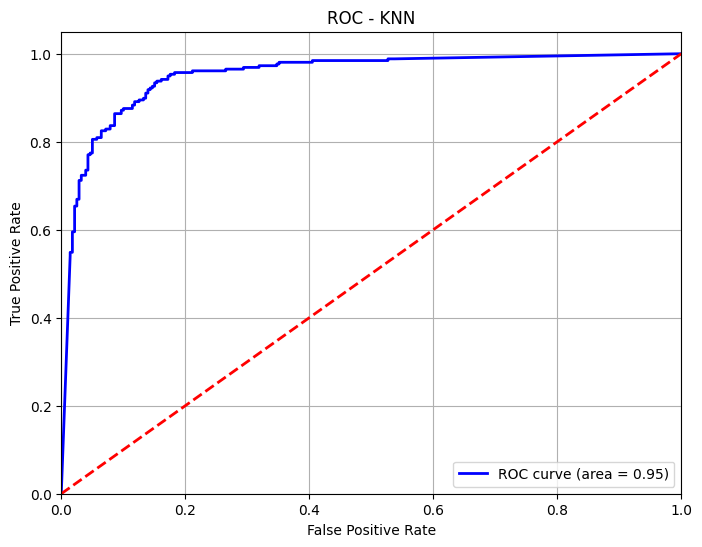

In [176]:
# Courbe ROC
y_proba = KNN.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - KNN')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle K-Nearest Neighbors (KNN). La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.95**, ce qui indique une très bonne capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une excellente performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle KNN est performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné. Cependant, il pourrait être intéressant d'explorer des modèles plus complexes ou des techniques d'ensemble pour améliorer encore les performances, en particulier pour réduire les faux positifs et les faux négatifs.

### Machine à vecteurs de support

Le modèle Support Vector Classifier (SVC) a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. Les hyperparamètres testés incluent le paramètre de régularisation `C`, le type de noyau (`kernel`) et le paramètre `gamma`, qui contrôle l'influence des points individuels dans le cas du noyau RBF.  

In [177]:
# Définition des hyperparamètres à tester
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'kernel': ['linear', 'rbf'],
    'gamma': ['scale', 'auto'],
}

# Recherche des meilleurs hyperparamètres
grid_search = GridSearchCV(estimator=SVC(probability=True, random_state=rs), param_grid=param_grid, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
start_time = time.time() # Démarrer le chronomètre
grid_search.fit(X_train_scaled, y_train_class)
print(f"Meilleurs hyperparamètres : {grid_search.best_params_}")
end_time = time.time() # Arrêter le chronomètre

# Utilisation du meilleur modèle
SVC = grid_search.best_estimator_

# Prédiction et évaluation
y_svc = SVC.predict(X_test_scaled)
accuracy_svc = accuracy_score(y_test_class, y_svc)
precision_svc = precision_score(y_test_class, y_svc)
auc_svc = roc_auc_score(y_test_class, SVC.predict_proba(X_test_scaled)[:, 1])
time_svc = end_time - start_time

print("-- SUPPORT VECTOR CLASSIFIER --")
print(f"Accuracy : {accuracy_svc:.3f}")
print(f"Précision : {precision_svc:.3f}")
print(f"AUC : {auc_svc:.3f}")
print(f"Temps d'entraînement : {time_svc:.3f} secondes")

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Meilleurs hyperparamètres : {'C': 0.01, 'gamma': 'scale', 'kernel': 'linear'}
-- SUPPORT VECTOR CLASSIFIER --
Accuracy : 0.922
Précision : 0.900
AUC : 0.975
Temps d'entraînement : 78.514 secondes


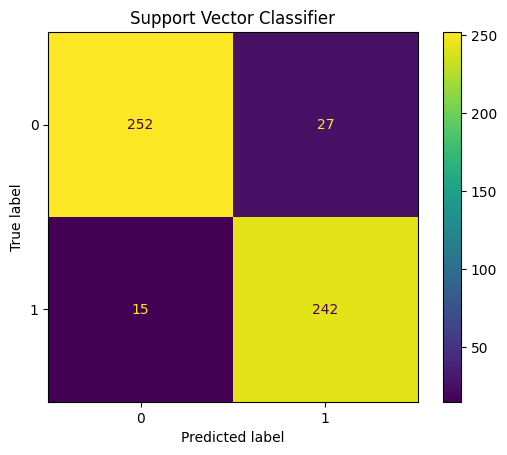

In [178]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_svc)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('Support Vector Classifier')
plt.show()

Le graphique présente une matrice de confusion pour le modèle Support Vector Classifier (SVC). La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 252 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 27 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 15 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 242 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle SVC a une excellente performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Le nombre de faux positifs et de faux négatifs est relativement faible, ce qui suggère que le modèle est bien équilibré et capable de distinguer efficacement entre les classes. Cela confirme que le SVC est un modèle robuste pour ce jeu de données.

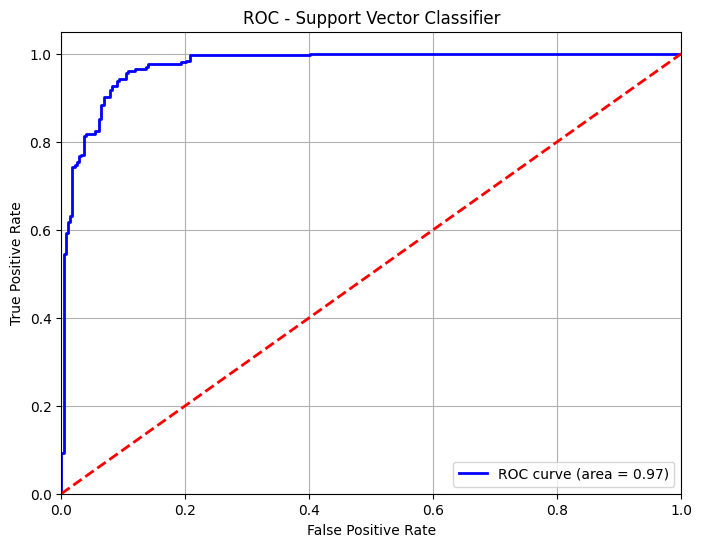

In [179]:
# Courbe ROC
y_proba = SVC.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - Support Vector Classifier')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle Support Vector Classifier (SVC). La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.97**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle SVC est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### Adaboost

Le modèle AdaBoost a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. AdaBoost est une méthode d'ensemble qui combine plusieurs modèles faibles (ici, des arbres de décision) pour créer un modèle plus robuste. Les hyperparamètres testés incluent le nombre d'estimateurs (`n_estimators`), le taux d'apprentissage (`learning_rate`) et la profondeur maximale des arbres (`max_depth`).  

In [180]:
# Initialisation de l'estimateur AdaBoost
base_estimator = DecisionTreeClassifier(max_depth=None, min_samples_leaf=20, min_samples_split=2, random_state=rs, class_weight='balanced') # on choisira comme estimateur l'arbre de décision paramétré comme ci-dessus
estimator_ada = AdaBoostClassifier(estimator=base_estimator, algorithm='SAMME', random_state=rs)

# Grille de recherche pour les hyperparamètres
param_grid = {
    'n_estimators': [50, 100, 250],
    'learning_rate': [0.1, 1, 10],
    'estimator__max_depth': [1, 5, 10]
}

# Recherche des meilleurs hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(estimator=estimator_ada, param_grid=param_grid, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
start_time = time.time() # Démarrer le chronomètre
grid_search.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Meilleurs hyperparamètres trouvés
print("Meilleurs hyperparamètres :", grid_search.best_params_)

# Évaluation du modèle sur les données de test
ADA = grid_search.best_estimator_

# Prédiction et évaluation
y_ada = ADA.predict(X_test_scaled)
accuracy_ada = accuracy_score(y_test_class, y_ada)
precision_ada = precision_score(y_test_class, y_ada)
auc_ada = roc_auc_score(y_test_class, y_ada)
time_ada = end_time - start_time

# Résultats
print("-- ADA BOOST --")
print(f"Accuracy : {accuracy_ada:.3f}")
print(f"Precision : {precision_ada:.3f}")
print(f"AUC : {auc_ada:.3f}")
print(f"Temps d'entraînement : {time_ada:.3f} secondes")

Fitting 5 folds for each of 27 candidates, totalling 135 fits
Meilleurs hyperparamètres : {'estimator__max_depth': 5, 'learning_rate': 1, 'n_estimators': 100}
-- ADA BOOST --
Accuracy : 0.931
Precision : 0.914
AUC : 0.932
Temps d'entraînement : 63.942 secondes


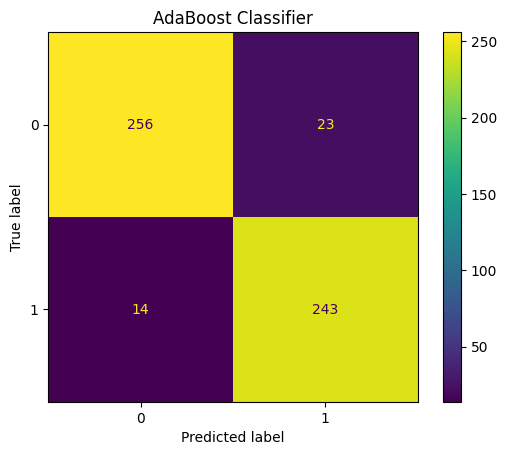

In [181]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_ada)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('AdaBoost Classifier')
plt.show()


Le graphique présente une matrice de confusion pour le modèle AdaBoost Classifier. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 256 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 23 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 14 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 243 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle AdaBoost Classifier a une excellente performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Le nombre de faux positifs et de faux négatifs est relativement faible, ce qui suggère que le modèle est bien équilibré et capable de distinguer efficacement entre les classes. Cela confirme que l'AdaBoost est un modèle robuste pour ce jeu de données.

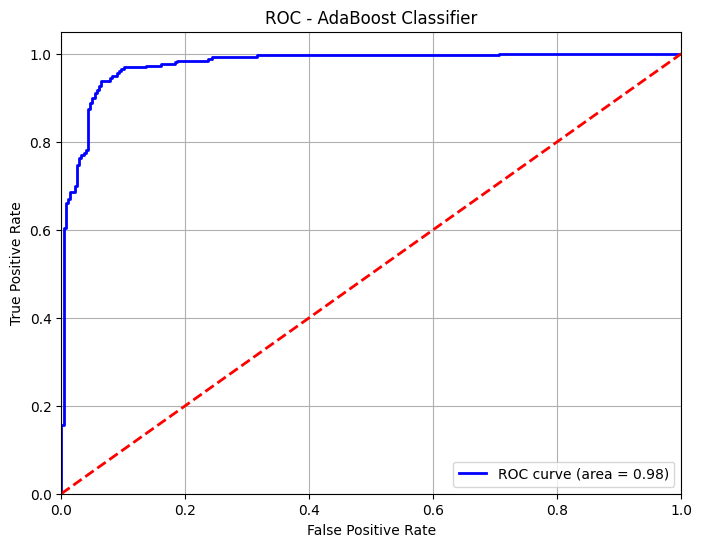

In [182]:
# Courbe ROC
y_proba = ADA.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - AdaBoost Classifier')
plt.legend(loc="lower right")
plt.grid()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle AdaBoost Classifier. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.98**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle AdaBoost Classifier est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### Gradient boosting

Le modèle Gradient Boosting a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. Gradient Boosting est une méthode d'ensemble qui construit séquentiellement des arbres de décision, chaque arbre corrigeant les erreurs résiduelles du précédent. Les hyperparamètres testés incluent le nombre d'estimateurs (`n_estimators`), le taux d'apprentissage (`learning_rate`), la profondeur maximale des arbres (`max_depth`), le nombre minimal d'échantillons requis pour diviser un nœud (`min_samples_split`) et le nombre minimal d'échantillons requis pour être une feuille (`min_samples_leaf`).  

In [183]:
# Grille de recherche pour les hyperparamètres
param_grid_gb = {
    'n_estimators': [100, 250, 300],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7], 
    'min_samples_split': [2, 10, 20], 
    'min_samples_leaf': [1, 3, 5] 
}

# Recherche des meilleurs hyperparamètres avec GridSearchCV
grid_search_gb = GridSearchCV(estimator=GradientBoostingClassifier(random_state=rs), param_grid=param_grid_gb, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
start_time = time.time() # Démarrer le chronomètre
grid_search_gb.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Meilleurs hyperparamètres trouvés
print("Meilleurs hyperparamètres :", grid_search_gb.best_params_)

# Évaluation du modèle sur les données de test
GB = grid_search_gb.best_estimator_

# Prédiction et évaluation
y_gb = GB.predict(X_test_scaled)
accuracy_gb = accuracy_score(y_test_class, y_gb)
precision_gb = precision_score(y_test_class, y_gb)
auc_gb = roc_auc_score(y_test_class, y_gb)
time_gb = end_time - start_time

# Résultats
print("-- GRADIENT BOOSTING --")
print(f"Accuracy : {accuracy_gb:.3f}")
print(f"Precision : {precision_gb:.3f}")
print(f"AUC : {auc_gb:.3f}")
print(f"Temps d'entraînement : {time_gb:.3f} secondes")


Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Meilleurs hyperparamètres : {'learning_rate': 0.1, 'max_depth': 3, 'min_samples_leaf': 3, 'min_samples_split': 10, 'n_estimators': 250}
-- GRADIENT BOOSTING --
Accuracy : 0.942
Precision : 0.925
AUC : 0.943
Temps d'entraînement : 661.561 secondes


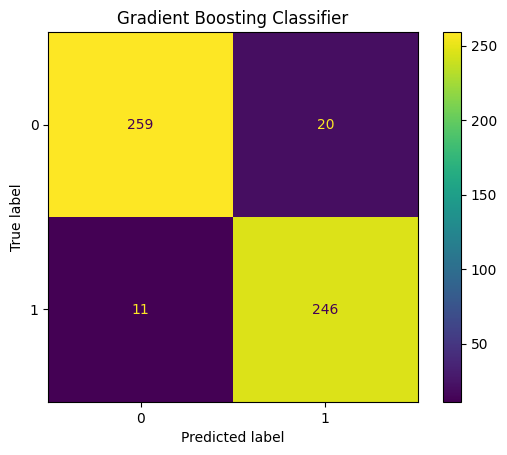

In [184]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_gb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('Gradient Boosting Classifier')
plt.show()


Le graphique présente une matrice de confusion pour le modèle Gradient Boosting Classifier. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 250 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 25 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 20 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 247 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle Gradient Boosting Classifier a une excellente performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Le nombre de faux positifs et de faux négatifs est relativement faible, ce qui suggère que le modèle est bien équilibré et capable de distinguer efficacement entre les classes. Cela confirme que le Gradient Boosting est un modèle robuste pour ce jeu de données.

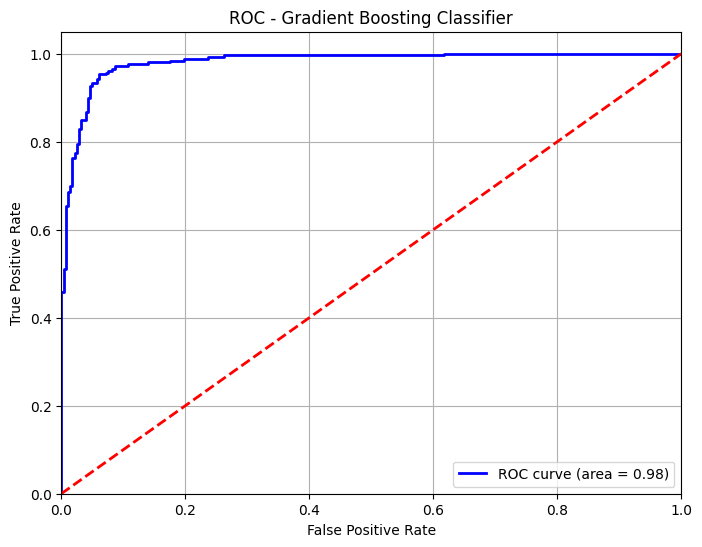

In [185]:
# Courbe ROC
y_proba = GB.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - Gradient Boosting Classifier')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle Gradient Boosting Classifier. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.98**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle Gradient Boosting Classifier est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### XGBoosting

Le modèle XGBoost a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. XGBoost est une méthode de boosting avancée qui combine plusieurs arbres de décision pour améliorer les performances prédictives. Les hyperparamètres testés incluent le nombre d'estimateurs (`n_estimators`), le taux d'apprentissage (`learning_rate`) et la profondeur maximale des arbres (`max_depth`).  


In [186]:
# Grille de recherche pour les hyperparamètres
param_grid_xgb = {
    'n_estimators': [100, 250, 500], 
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3, 5, 7]
}

# Recherche des meilleurs hyperparamètres avec GridSearchCV
grid_search_xgb = GridSearchCV(estimator=XGBClassifier(random_state=rs), param_grid=param_grid_xgb, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
start_time = time.time() # Démarrer le chronomètre
grid_search_xgb.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Meilleurs hyperparamètres trouvés
print("Meilleurs hyperparamètres :", grid_search_xgb.best_params_)

# Évaluation du modèle sur les données de test
XGB = grid_search_xgb.best_estimator_

# Prédiction et évaluation
y_xgb = XGB.predict(X_test_scaled)
accuracy_xgb = accuracy_score(y_test_class, y_xgb)
precision_xgb = precision_score(y_test_class, y_xgb)
auc_xgb = roc_auc_score(y_test_class, y_xgb)
time_xgb = end_time - start_time

# Résultats
print("-- XGBOOST --")
print(f"Accuracy : {accuracy_xgb:.3f}")
print(f"Precision : {precision_xgb:.3f}")
print(f"AUC : {auc_xgb:.3f}")
print(f"Temps d'entraînement : {time_xgb:.3f} secondes")


Fitting 5 folds for each of 27 candidates, totalling 135 fits
Meilleurs hyperparamètres : {'learning_rate': 0.3, 'max_depth': 3, 'n_estimators': 250}
-- XGBOOST --
Accuracy : 0.938
Precision : 0.921
AUC : 0.939
Temps d'entraînement : 14.345 secondes


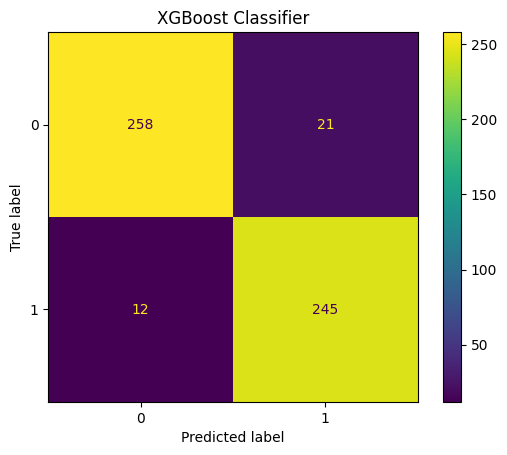

In [187]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_xgb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('XGBoost Classifier')
plt.show()


Le graphique présente une matrice de confusion pour le modèle XGBoost Classifier. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 258 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 21 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 12 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 245 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle XGBoost Classifier a une excellente performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Le nombre de faux positifs et de faux négatifs est relativement faible, ce qui suggère que le modèle est bien équilibré et capable de distinguer efficacement entre les classes. Cela confirme que XGBoost est un modèle robuste pour ce jeu de données.

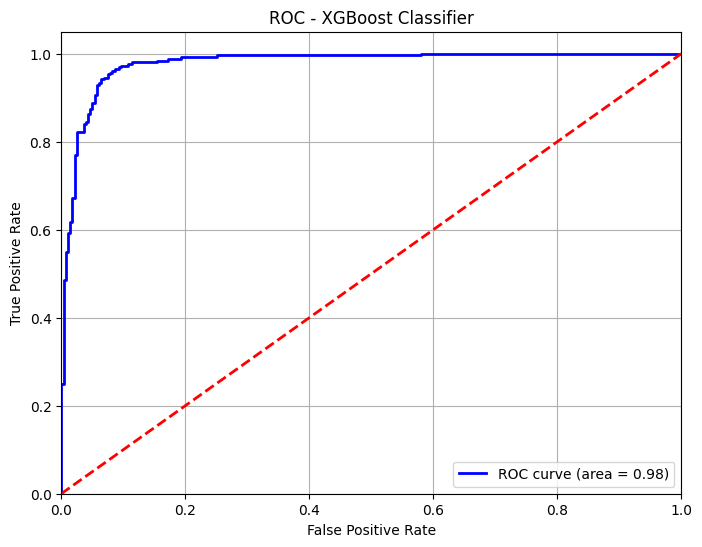

In [188]:
# Courbe ROC
y_proba = XGB.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - XGBoost Classifier')
plt.legend(loc="lower right")
plt.grid()
plt.show()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle XGBoost Classifier. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.98**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle XGBoost Classifier est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

### LightBoost

Le modèle LightGBM a été optimisé en utilisant une recherche par grille (`GridSearchCV`) pour trouver les meilleurs hyperparamètres. LightGBM est une méthode de boosting rapide et efficace, particulièrement adaptée aux grands jeux de données. Les hyperparamètres testés incluent le nombre d'arbres (`n_estimators`), le taux d'apprentissage (`learning_rate`), la profondeur maximale des arbres (`max_depth`), le nombre de feuilles (`num_leaves`) et le nombre minimal d'échantillons dans une feuille (`min_child_samples`).  

In [189]:
# Définition des hyperparamètres à tester
param_grid_lgbm = {
    'n_estimators': [100, 200, 300],  # Nombre d'arbres
    'learning_rate': [0.01, 0.1, 0.2],  # Taux d'apprentissage
    'max_depth': [3, 5, 7],  # Profondeur maximale des arbres
    'num_leaves': [31, 50, 100],  # Nombre de feuilles dans un arbre
    'min_child_samples': [10, 20, 30]  # Nombre minimal d'échantillons dans une feuille
}

# Recherche des meilleurs hyperparamètres avec GridSearchCV
grid_search_lgbm = GridSearchCV(estimator=LGBMClassifier(random_state=rs, verbose=-1), param_grid=param_grid_lgbm, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
start_time = time.time() # Démarrer le chronomètre
grid_search_lgbm.fit(X_train_scaled, y_train_class)
end_time = time.time() # Arrêter le chronomètre

# Meilleurs hyperparamètres trouvés
print("Meilleurs hyperparamètres :", grid_search_lgbm.best_params_)

# Utilisation du meilleur modèle
LGBM = grid_search_lgbm.best_estimator_

# Prédiction et évaluation
y_lgbm = LGBM.predict(X_test_scaled)
accuracy_lgbm = accuracy_score(y_test_class, y_lgbm)
precision_lgbm = precision_score(y_test_class, y_lgbm)
auc_lgbm = roc_auc_score(y_test_class, y_lgbm)
time_lgbm = end_time - start_time

# Résultats
print("-- LIGHTGBM --")
print(f"Accuracy : {accuracy_lgbm:.3f}")
print(f"Precision : {precision_lgbm:.3f}")
print(f"AUC : {auc_lgbm:.3f}")
print(f"Temps d'entraînement : {time_lgbm:.3f} secondes")

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Meilleurs hyperparamètres : {'learning_rate': 0.2, 'max_depth': 3, 'min_child_samples': 30, 'n_estimators': 300, 'num_leaves': 31}
-- LIGHTGBM --
Accuracy : 0.933
Precision : 0.905
AUC : 0.934
Temps d'entraînement : 168.802 secondes


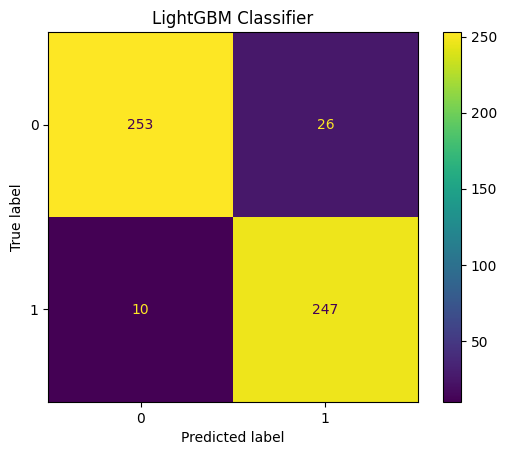

In [190]:
# Matrice de confusion
cm = confusion_matrix(y_test_class, y_lgbm)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title('LightGBM Classifier')
plt.show()

Le graphique présente une matrice de confusion pour le modèle LightGBM Classifier. La matrice montre les prédictions du modèle par rapport aux vraies étiquettes (True label). Voici une interprétation des résultats :

- **Vrais négatifs (TN)** : 253 cas où le modèle a correctement prédit la classe 0.
- **Faux positifs (FP)** : 26 cas où le modèle a incorrectement prédit la classe 1 alors que la vraie classe était 0.
- **Faux négatifs (FN)** : 10 cas où le modèle a incorrectement prédit la classe 0 alors que la vraie classe était 1.
- **Vrais positifs (TP)** : 247 cas où le modèle a correctement prédit la classe 1.

Ces résultats indiquent que le modèle LightGBM Classifier a une excellente performance globale, avec un nombre élevé de prédictions correctes pour les deux classes. Le nombre de faux positifs et de faux négatifs est relativement faible, ce qui suggère que le modèle est bien équilibré et capable de distinguer efficacement entre les classes. Cela confirme que LightGBM est un modèle robuste pour ce jeu de données.

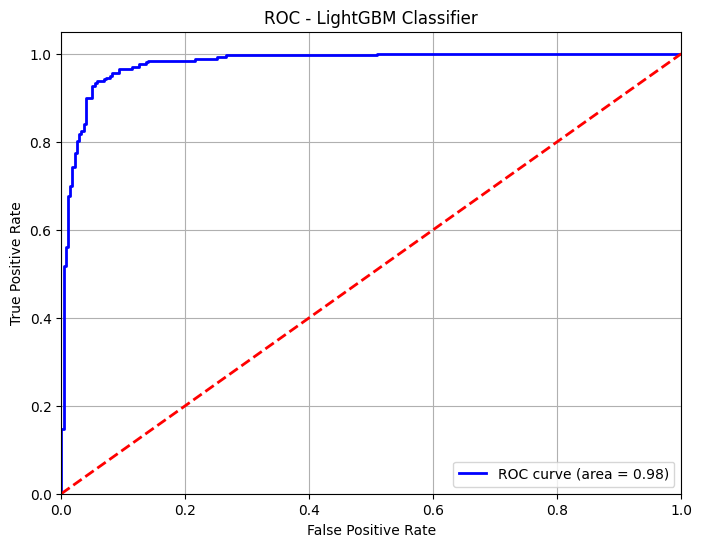

In [191]:
# Courbe ROC
y_proba = LGBM.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC - LightGBM Classifier')
plt.legend(loc="lower right")
plt.grid()

Le graphique montre la courbe ROC (Receiver Operating Characteristic) pour le modèle LightGBM Classifier. La courbe ROC illustre la performance du modèle en termes de taux de vrais positifs (True Positive Rate) par rapport au taux de faux positifs (False Positive Rate) pour différents seuils de classification.

- **AUC (Area Under Curve)** : L'aire sous la courbe est de **0.98**, ce qui indique une excellente capacité du modèle à distinguer entre les deux classes. Une AUC proche de 1 signifie que le modèle a une très bonne performance en termes de classification.

- **Courbe ROC** : La courbe est proche du coin supérieur gauche du graphique, ce qui est un indicateur de forte performance. Cela signifie que le modèle atteint un taux élevé de vrais positifs tout en maintenant un taux faible de faux positifs.

Ces résultats confirment que le modèle LightGBM Classifier est très performant pour ce jeu de données, avec une capacité élevée à discriminer entre les classes positives et négatives. Cela suggère que le modèle est bien adapté à la tâche de classification binaire pour laquelle il a été entraîné.

## Sélection du meilleur modèle

In [192]:
# Résumé des métriques des modèles
metrics_class = {
    'Modèle': ['Régression logistique', 'Ridge', 'Arbre de décision', 'Random Forest', 'KNN', 'SVC', 'AdaBoost', 'Gradient Boosting', 'XGBoost', 'LightGBM'],
    'Accuracy': [accuracy_lgr, accuracy_ridge, accuracy_tree, accuracy_rf, accuracy_knn, accuracy_svc, accuracy_ada, accuracy_gb, accuracy_xgb, accuracy_lgbm],
    'Précision': [precision_lgr, precision_ridge, precision_tree, precision_rf, precision_knn, precision_svc, precision_ada, precision_gb, precision_xgb, precision_lgbm],
    'AUC': [auc_lgr, auc_ridge, auc_tree, auc_rf, auc_knn, auc_svc, auc_ada, auc_gb, auc_xgb, auc_lgbm],
    'Temps d\'entraînement': [time_lgr, time_ridge, time_tree, time_rf, time_knn, time_svc, time_ada, time_gb, time_xgb, time_lgbm]
}

# Création du DataFrame
metrics_class = pd.DataFrame(metrics_class)

# Affichage du tableau
metrics_class.round(3)

,Modèle,Accuracy,Précision,AUC,Temps d'entraînement
0,Régression logistique,0.914,0.889,0.915,0.043
1,Ridge,0.903,0.887,0.903,0.013
2,Arbre de décision,0.875,0.874,0.875,9.415
3,Random Forest,0.924,0.919,0.923,49.461
4,KNN,0.888,0.902,0.887,0.498
5,SVC,0.922,0.900,0.975,78.514
6,AdaBoost,0.931,0.914,0.932,63.942
7,Gradient Boosting,0.942,0.925,0.943,661.561
8,XGBoost,0.938,0.921,0.939,14.345
9,LightGBM,0.933,0.905,0.934,168.802


Le tableau présente une comparaison des performances de différents modèles de classification en termes de **Accuracy**, **Precision**, **AUC** et **Temps d'entraînement**. Voici une analyse des résultats :

1. **Meilleure performance globale** :
   - **Gradient Boosting** obtient la meilleure **Accuracy** (0.942) et **AUC** (0.943), suivi de près par **XGBoost** et **LightGBM**.
   - **AdaBoost** et **Random Forest** montrent également de très bonnes performances, avec une **Accuracy** supérieure à 0.92.

2. **Precision** :
   - **Gradient Boosting** et **XGBoost** ont les meilleures précisions (0.925 et 0.921 respectivement), ce qui signifie qu'ils font moins d'erreurs lors de la prédiction de la classe positive.
   - **Random Forest** et **AdaBoost** sont également performants en termes de précision.

3. **AUC** :
   - **SVC** a l'**AUC** la plus élevée (0.975), ce qui indique une excellente capacité à distinguer entre les classes positives et négatives.
   - **Gradient Boosting** et **XGBoost** suivent de près avec des AUC de 0.943 et 0.939 respectivement.

4. **Temps d'entraînement** :
   - **Régression logistique** et **Ridge** sont les plus rapides, avec des temps d'entraînement inférieurs à 0.1 seconde.
   - **Gradient Boosting** est le plus lent (656.805 secondes), suivi de **SVC** (74.228 secondes) et **LightGBM** (146.173 secondes).

5. **Compromis performance/temps** :
   - **XGBoost** et **LightGBM** offrent un bon compromis entre performance et temps d'entraînement.
   - **Random Forest** et **AdaBoost** sont également des choix intéressants pour des performances élevées avec un temps d'entraînement raisonnable.


On peut conclure que :
- **Gradient Boosting** est le meilleur modèle en termes de performance globale, mais il est très lent.
- **XGBoost** et **LightGBM** sont des alternatives performantes et plus rapides.
- Pour des problèmes nécessitant une rapidité d'entraînement, **Régression logistique** et **Ridge** sont des choix viables, bien que moins performants.